# CODEX analyses

In this notebook we demonstrate how mosna can be used to analyze spatiallly resolved omics data.  
The data used is from the publication by [Phillips et al., Nature Comm., 2023](https://doi.org/10.1038/s41467-021-26974-6) "Immune cell topography predicts response to PD-1 blockade in cutaneous T cell lymphoma".  
Here 70 Tumor MicroArray spots from 14 advanced Cutaneous T cell lymphomas (CTCL) patients enrolled in a pembrolizumab clinical trial were processed with the [CODEX](https://doi.org/10.1016/j.cell.2020.07.005) method to produce maps of numerous proteins and study the relationship between cell types in tumors with respect to immunotherapy.  

## Imports and data loading

In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=DeprecationWarning)
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
from time import time
import joblib
from pathlib import Path
from time import time
from tqdm import tqdm
import copy
import matplotlib as mpl
import napari
import colorcet as cc
import composition_stats as cs
from sklearn.impute import KNNImputer

from tysserand import tysserand as ty
from mosna import mosna

import matplotlib as mpl
mpl.rcParams["figure.facecolor"] = 'white'
mpl.rcParams["axes.facecolor"] = 'white'
mpl.rcParams["savefig.facecolor"] = 'white'
plt.style.use('seaborn-v0_8-poster') #'seaborn-v0_8-notebook'

In [2]:
# If need to reload modules after their modification
from importlib import reload
ty = reload(ty)
mosna = reload(mosna)

In [3]:
RUN_LONG = False

### Objects data

Load files that contains all the detected objects (the cells) across all samples and clinical data.  
Data is available from the editor, for convenience it is avaible here too:  
https://drive.google.com/drive/folders/1At8G89p4xFDm5OkLB-CRqsbWUoeLEjWZ?usp=sharing

In [4]:
data_dir = Path("../data/raw/CODEX_CTCL")
try:
    objects_path = data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.parquet"
    obj = pd.read_parquet(data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.parquet")
except FileNotFoundError:
    objects_path = data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.xlsx"
    obj = pd.read_excel(objects_path, skiprows=2)
    # for latter use
    obj.to_parquet(data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.parquet")
obj

,Count,EventCount,Index in File,ClusterID,FileName,ClusterName,Spots,Patients,Groups,FOXP3,...,PD-1+CD8+,CD4+Tcells,PD-1+tumor,CD8+Tcells,Ki67+CD4+,Ki-67+Tregs,ICOS+Tregs,IDO+Tregs,Ki67+tumor,original_index
0,0,1,60,33987,reg001,B cells,1,1,1,0.692403,...,0,0,0,0,0,0,0,0,0,0
1,1,1,94,33987,reg001,B cells,1,1,1,8.094747,...,0,0,0,0,0,0,0,0,0,1
2,2,1,198,33987,reg001,B cells,1,1,1,4.110389,...,0,0,0,0,0,0,0,0,0,2
3,3,1,284,33987,reg001,B cells,1,1,1,0.000000,...,0,0,0,0,0,0,0,0,0,3
4,4,1,298,33987,reg001,B cells,1,1,1,2.937673,...,0,0,0,0,0,0,0,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117165,116917,1,633,33981,reg066,vasculature,66,14,4,84.269714,...,0,0,0,0,0,0,0,0,0,116917
117166,116918,1,677,33981,reg066,vasculature,66,14,4,56.425945,...,0,0,0,0,0,0,0,0,0,116918
117167,116919,1,681,33981,reg066,vasculature,66,14,4,63.152092,...,0,0,0,0,0,0,0,0,0,116919
117168,116920,1,705,33981,reg066,vasculature,66,14,4,66.873306,...,0,0,0,0,0,0,0,0,0,116920


In [5]:
# sample_cols = obj.columns[:10]
obj.rename(columns={'X': 'x', 'Y': 'y', 'Z':'z', 'ClusterName': 'cell type'}, inplace=True)
patient_col = 'Patients'
sample_col = 'FileName'
group_col = 'Groups'
pos_cols = ['x', 'y']
pheno_col = 'cell type'  # unique columns with all cell types
sample_cols = [sample_col, pheno_col, patient_col, 'Spots' ,group_col]
marker_cols = obj.columns[9:67]
marker_cols = [x for x in marker_cols if x != 'HOECHST1:Cyc_1_ch_1']
# pos_cols = obj.columns[69:76]
# slices are 5µm thick, so data is pseudo-2D, including z leads to spatial networks reconstruction artifacts
cell_type_cols = list(obj.columns[75:96]) # one-hot encoded cell types
marker_posit_cols = list(obj.columns[100:-1])
all_cols = sample_cols + marker_cols + pos_cols + cell_type_cols + marker_posit_cols
net_cols = pos_cols + [pheno_col] + cell_type_cols + marker_cols
nb_clusters = obj[pheno_col].unique().size

In [6]:
with pd.option_context('display.max_rows', 40):
    print(obj[pheno_col].value_counts())

cell type
tumor cells                     38499
epithelium                      18182
macrophages (M1>M2)             13800
stroma                          11210
Tregs                            7733
vasculature                      5404
CD8+ T cells                     5350
macrophages (M1=M2)              4426
B cells                          2205
macrophages (M2>M1)              1859
Langerhans cells                 1744
CD4+ T cells                     1647
tumor cells, intraepithelial     1316
lymphatics                        783
plasma cells                      725
mast cells                        619
nerves                            572
neutrophils                       430
IDO+ stromal cells                237
CLA+ leukocytes                   218
DCs, CD11c+                       211
Name: count, dtype: int64


In [7]:
obj.shape

(117170, 121)

In [8]:
# Select only pre-treatment samples
obj = obj.loc[obj[group_col] < 3, :]
obj.index = np.arange(len(obj))
obj[group_col].unique()

array([1, 2])

In [9]:
# Show number of cells per sample
pd.set_option('display.max_rows', 500)
obj[[sample_col, patient_col, group_col, 'Count', 'Spots']].groupby([patient_col, group_col, 'Spots', sample_col]).count()

Count
Patients Groups Spots FileName       
1        1      1     reg001     1301
                2     reg002     2324
2        1      5     reg005      112
                6     reg006      603
3        2      9     reg009     2334
                10    reg010     1970
4        2      13    reg013     1765
                14    reg014     1270
5        1      17    reg017      558
                18    reg018      458
6        2      21    reg021     2483
                22    reg022     2325
7        2      25    reg025      144
                26    reg026      257
8        2      29    reg029     1916
                30    reg030     1909
                31    reg031     1102
9        1      35    reg035     2053
                36    reg036      618
10       1      39    reg039     1225
                40    reg040     1317
11       1      41    reg041     1105
                42    reg042      385
12       2      45    reg045     1914
                46    reg046      808
13       1      51    reg051     1082
                52    reg052     1707
14       2      57    reg057     1166
                58    reg058     1854

In [10]:
pd.set_option('display.max_rows', 10)

### Response status pre/post treatment

In [11]:
code_groups = {
  1: 'Responder, pre-treatment',
  2: 'Non-responder, pre-treatment',
  3: 'Responder, post-treatment',
  4: 'Non-responder, post-treatment',
} 

In [12]:
status_path = data_dir / "41467_2021_26974_MOESM5_ESM - Patients_spots_conditons.xlsx"
status = pd.read_excel(status_path, skiprows=2, usecols=[patient_col, group_col, 'Spots'])
# samples 5, 25, 36, 37, 40, 44 are missing
# now inferred from updated data at https://static-content.springer.com/esm/art%3A10.1038%2Fs41467-021-26974-6/MediaObjects/41467_2021_26974_MOESM1_ESM.pdf
updated_data = [
    # [patient_col, group_col, 'Spots']
    [2, 1, 5],
    [7, 2, 25],
    [9, 1, 36],
    [9, 3, 37],
    [10, 1, 40],
    [11, 3, 44],
    ]
status = pd.concat([status, pd.DataFrame(updated_data, columns=status.columns)], axis=0)
status = status.loc[status[group_col] < 3, :]

status[sample_col] = status['Spots'].apply(lambda x: f'reg{x:03}')
pd.set_option('display.max_rows', 10)

if sample_col in status.columns:
    status.index = status[sample_col]
    status.drop(columns=[sample_col], inplace=True)
    status.index.name = sample_col
status.sort_values('Spots')

,Patients,Groups,Spots
FileName,,,
reg001,1,1,1
reg002,1,1,2
reg005,2,1,5
reg006,2,1,6
reg009,3,2,9
...,...,...,...
reg046,12,2,46
reg051,13,1,51
reg052,13,1,52


In [13]:
# When status had too many missing values after first data release:
# we make a status dataframe from the objects dataframe
status = obj[[sample_col, patient_col, group_col, 'Count', 'Spots']].groupby([patient_col, group_col, 'Spots', sample_col]).count().reset_index()
if sample_col in status.columns:
    status.index = status[sample_col]
    status.drop(columns=[sample_col], inplace=True)
    status.index.name = sample_col

# Drop sample with too few cells
# net_size_threshold = 300
net_size_threshold = 0    # no filtering
status = status.loc[status['Count'] >= net_size_threshold, :]
# status.drop(columns=['Count'], inplace=True)

# update the `object` dataframe
uniq_filenames = set(status.index)
obj = obj.query("FileName in @uniq_filenames")

pd.set_option('display.max_rows', 10)
status

,Patients,Groups,Spots,Count
FileName,,,,
reg001,1,1,1,1301
reg002,1,1,2,2324
reg005,2,1,5,112
reg006,2,1,6,603
reg009,3,2,9,2334
...,...,...,...,...
reg046,12,2,46,808
reg051,13,1,51,1082
reg052,13,1,52,1707


### Survival data

In [14]:
survival_path = data_dir / "cohort_response.ods"
surv = pd.read_excel(survival_path)
surv.index = surv['Patient ID']
surv.drop(columns=['Patient ID'], inplace=True)
surv.index.name = patient_col
surv

,Age at screening (years),Gender,Diagnosis,Disease Stage,Prior therapies,Response status,Biopsy timepoints,CO2 (weeks),Response / progression time (weeks),EOT time (weeks),Death time (weeks),Follow-up time (weeks)
Patients,,,,,,,,,,,,
1,76.14,Male,MF,IIIA,3,Responder,"Pre, EOT",NaN,NaN,104.0,NaN,142
2,60.59,Male,MF,IIIB,4,Responder,"Pre, EOT",NaN,NaN,104.0,NaN,151
3,52.01,Male,SS,IVA,3,Non-responder,"Pre, EOT",NaN,NaN,98.0,98.0,98
4,85.14,Female,SS,IVA,4,Non-responder,"Pre, EOT",NaN,NaN,104.0,142.0,142
5,75.24,Male,MF,IIB,6,Responder,"Pre, EOT",NaN,NaN,104.0,NaN,103
6,46.74,Male,MF,IVA,9,Non-responder,"Pre, CO2, EOT",3.0,NaN,25.0,NaN,25
7,46.71,Female,MF,IIIB,3,Non-responder,"Pre, EOT",NaN,NaN,9.0,NaN,9
8,67.44,Male,SS,IIIB,1,Non-responder,"Pre, EOT",NaN,NaN,104.0,121.0,121
9,77.65,Female,SS,IVA,6,Responder,"Pre, CO2, EOT",3.0,NaN,71.0,NaN,71


## Spatial networks reconstruction

### Load samples of one patient

We will have a look at the spatial networks of the 2 samples pre-treatment of the first patient to check they seem "correct", i.e. not over nor under connected.

In [15]:
# make common color mapper
cycle_cmap = False

nodes_labels = obj[pheno_col]
uniq = pd.Series(nodes_labels).value_counts().index

if nodes_labels is not None:
    nb_clust = nodes_labels.max()
    uniq = pd.Series(nodes_labels).value_counts().index

    # choose colormap
    clusters_cmap = mosna.make_cluster_cmap(uniq)
    # make color mapper
    # series to sort by decreasing order
    n_colors = len(clusters_cmap)
    celltypes_color_mapper = {x: clusters_cmap[i % n_colors] for i, x in enumerate(uniq)}

processing sample reg001
there are 5/1301 nodes with < 3 edges
processing sample reg002
there are 2/2324 nodes with < 3 edges


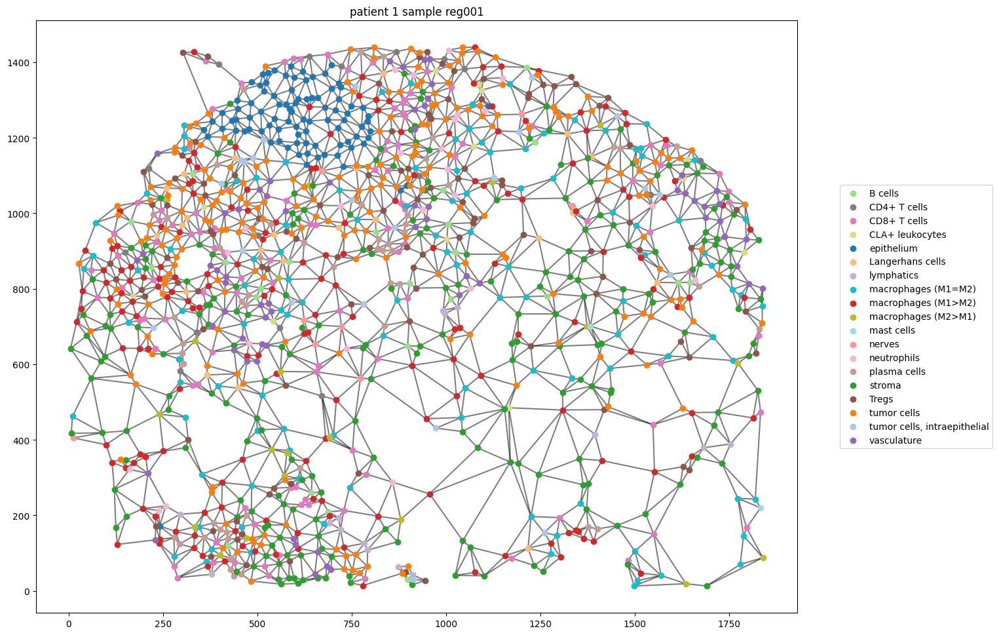

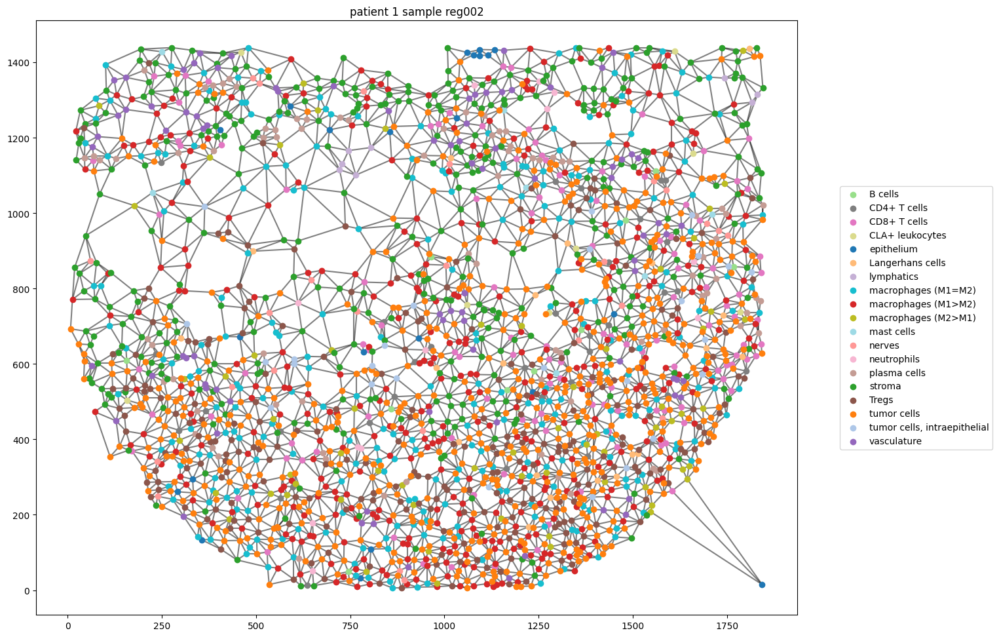

In [23]:
patient_id = 1  # that's our patient
select_patient = obj[patient_col] == patient_id
samples = obj.loc[select_patient, sample_col].unique()  # look for the several samples per patient
for sample_id in samples:
    print("processing sample {}".format(sample_id))
    select_sample = obj[sample_col] == sample_id
    nodes = obj.loc[select_patient & select_sample, all_cols]
    coords = nodes[pos_cols].values
    pairs = ty.build_delaunay(coords)
    # we want to avoid isolated cells, so we link them to their 3 closest neighbors
    pairs = ty.link_solitaries(coords, pairs, method='delaunay', min_neighbors=3)

    fig, ax = ty.plot_network(coords, pairs, labels=nodes[pheno_col],
                              color_mapper=celltypes_color_mapper, 
                              legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.05, 0.5)})
    plt.title(f"patient {patient_id} sample {sample_id}")

### All samples network reconstruction

#### Plot spatial networks

In [16]:
processed_dir = Path('../data/processed/CODEX_CTCL')

In [17]:
# Choose optimal distance threshold for edge trimming

trim_dist = 200 # or 'percentile_size'
min_neighbors = 3 # number of nearest nodes to connect for each unconneted node

save_dir = processed_dir / f"pretreatment_samples_networks_xy_choose_distance_trim_dist-{trim_dist}_solitary-{min_neighbors}"
save_dir.mkdir(parents=True, exist_ok=True)

# 'interesting' networks
samples_dst = [
    "reg001",
    "reg006",
    "reg040",
    "reg042",
    "reg051",
    "reg058",
]

k_sol = 0 

if RUN_LONG:
    for sample_id in samples_dst:
        print(f"    processing filename {sample_id}")
        select_sample = obj[sample_col] == sample_id
        nodes = obj.loc[select_sample, all_cols]
        coords = nodes[pos_cols].values
        pairs = ty.build_delaunay(
            coords, 
            node_adaptive_trimming=True, 
            n_edges=3, 
            trim_dist_ratio=2,
            min_dist=0, 
            trim_dist=trim_dist,
            )
        print("    ", end="")

        if min_neighbors > 0:
            pairs = ty.link_solitaries(
                coords, 
                pairs, 
                min_neighbors=min_neighbors,
                )
        distances = ty.distance_neighbors(coords, pairs)

        fig, ax = ty.plot_network_distances(
            coords, pairs, distances, labels=nodes[pheno_col],
            legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.2, 0.5)}
            )
        plt.axis('off');
        title = f"network_distances_sample-{sample_id}"
        plt.savefig(dir_fig_save / f'{title}.jpg', bbox_inches='tight', facecolor='white')
        plt.show()

In [17]:
trim_dist = 200 # or 'percentile_size'
min_neighbors = 3 # number of nearest nodes to connect for each unconneted node

reconst_dir = processed_dir / f"pretreatment_samples_networks_xy_min_size-{net_size_threshold}_solitary-{min_neighbors}"
save_dir = reconst_dir / "figures"
save_dir.mkdir(parents=True, exist_ok=True)
edges_dir = reconst_dir
nodes_dir = reconst_dir

In [18]:
if RUN_LONG:
    for patient_id in obj[patient_col].unique():
        print(f"processing patient {patient_id}")
        select_patient = obj[patient_col] == patient_id
        samples = obj.loc[select_patient, sample_col].unique()  # look for the several samples per patient
        for sample_id in samples:
            print(f"    processing sample {sample_id}")
            select_sample = obj[sample_col] == sample_id
            nodes = obj.loc[select_patient & select_sample, all_cols]
            coords = nodes[pos_cols].values
            pairs = ty.build_delaunay(
                coords, 
                node_adaptive_trimming=True, 
                n_edges=3, 
                trim_dist_ratio=2,
                min_dist=0, 
                trim_dist=trim_dist,
                )
            
            if min_neighbors > 0:
                pairs = ty.link_solitaries(
                    coords, 
                    pairs, 
                    min_neighbors=min_neighbors,
                    )

            fig, ax = ty.plot_network(coords, pairs, labels=nodes[pheno_col],
                                      color_mapper=celltypes_color_mapper, 
                                      legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.05, 0.5)})
            plt.axis('off');
            title = f"patient {patient_id} sample {sample_id}_network_delaunay"
            plt.savefig(save_dir / f'{title}.jpg', bbox_inches='tight', facecolor='white')
            plt.show()

#### Merge all samples

In [19]:
uniq_patients = obj[patient_col].unique()
uniq_samples = obj[sample_col].unique()
n_uniq_patients = len(uniq_patients)
n_uniq_samples = len(uniq_samples)

In [20]:
# if RUN_LONG:
#     edges_all = pd.DataFrame(data=None, columns=['source', 'target'])
#     # number of nodes previously seen
#     nb_nodes = 0
#     for sample_id in obj[patient_col].unique():
#         print(f"processing sample {sample_id}")
#         select_sample = obj[patient_col] == sample_id
#         filenames = obj.loc[select_sample, sample_col].unique()
#         for filename in filenames:
#             print("    processing filename {}".format(filename))
#             select_file = obj[sample_col] == filename
#             nodes = obj.loc[select_sample & select_file, all_cols]
#             coords = nodes[pos_cols].values
#             pairs = ty.build_delaunay(
#                 coords, 
#                 node_adaptive_trimming=True, 
#                 n_edges=3, 
#                 trim_dist_ratio=2,
#                 min_dist=0, 
#                 trim_dist=trim_dist,
#                 )
#             if min_neighbors > 0:
#                 pairs = ty.link_solitaries(
#                     coords, 
#                     pairs, 
#                     min_neighbors=min_neighbors,
#                     )

#             # increase ids in pairs by the number of nodes in all previously loaded networks
#             pairs = pairs + nb_nodes
#             edges = pd.DataFrame(data=pairs, columns=['source', 'target'])
#             edges[sample_col] = filename
#             # update number of nodes for next network
#             nb_nodes = nb_nodes + coords.shape[0]
#             edges_all = pd.concat([edges_all, edges], ignore_index=True)
#     edges_all.to_csv(reconst_dir / 'sample_all-edges.csv', index=False)
# else:
#     edges_all = pd.read_csv(reconst_dir / 'sample_all-edges.csv')

In [21]:
# or save in separate file for convenience
if RUN_LONG:
    for i, patient_id in enumerate(uniq_patients):
        print(f"processing patient {patient_id} {i+1}/{n_uniq_patients}")
        select_patient = obj[patient_col] == patient_id
        samples = obj.loc[select_patient, sample_col].unique()
        for j, sample_id in enumerate(samples):
            print(f"    processing sample {sample_id} {i+j+1}/{n_uniq_samples}")
            select_sample = obj[sample_col] == sample_id
            nodes = obj.loc[select_patient & select_sample, net_cols]
            coords = nodes[pos_cols].values
            pairs = ty.build_delaunay(
                coords, 
                node_adaptive_trimming=True, 
                n_edges=3, 
                trim_dist_ratio=2,
                min_dist=0, 
                trim_dist=trim_dist,
                )
            if min_neighbors > 0:
                pairs = ty.link_solitaries(
                    coords, 
                    pairs, 
                    min_neighbors=min_neighbors,
                    )

            edges = pd.DataFrame(data=pairs, columns=['source', 'target'])
            edges.to_parquet(edges_dir / f'edges_patient-{patient_id}_sample-{sample_id}.parquet', index=False)

            nodes.to_parquet(nodes_dir / f'nodes_patient-{patient_id}_sample-{sample_id}.parquet', index=False)

### Data transfomation and batch correction

#### CLR transformation

In [29]:
plt.style.use('seaborn-v0_8-notebook')

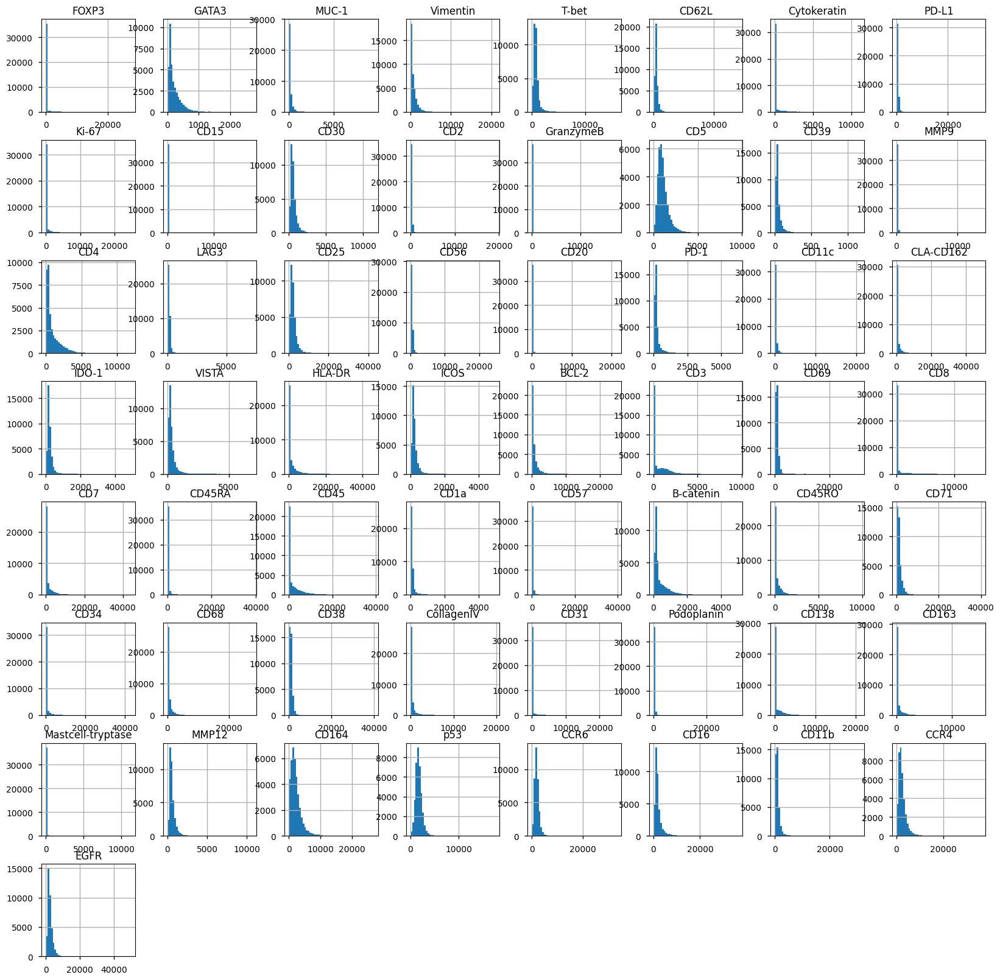

In [26]:
obj[marker_cols].hist(bins=50, figsize=(20, 20));

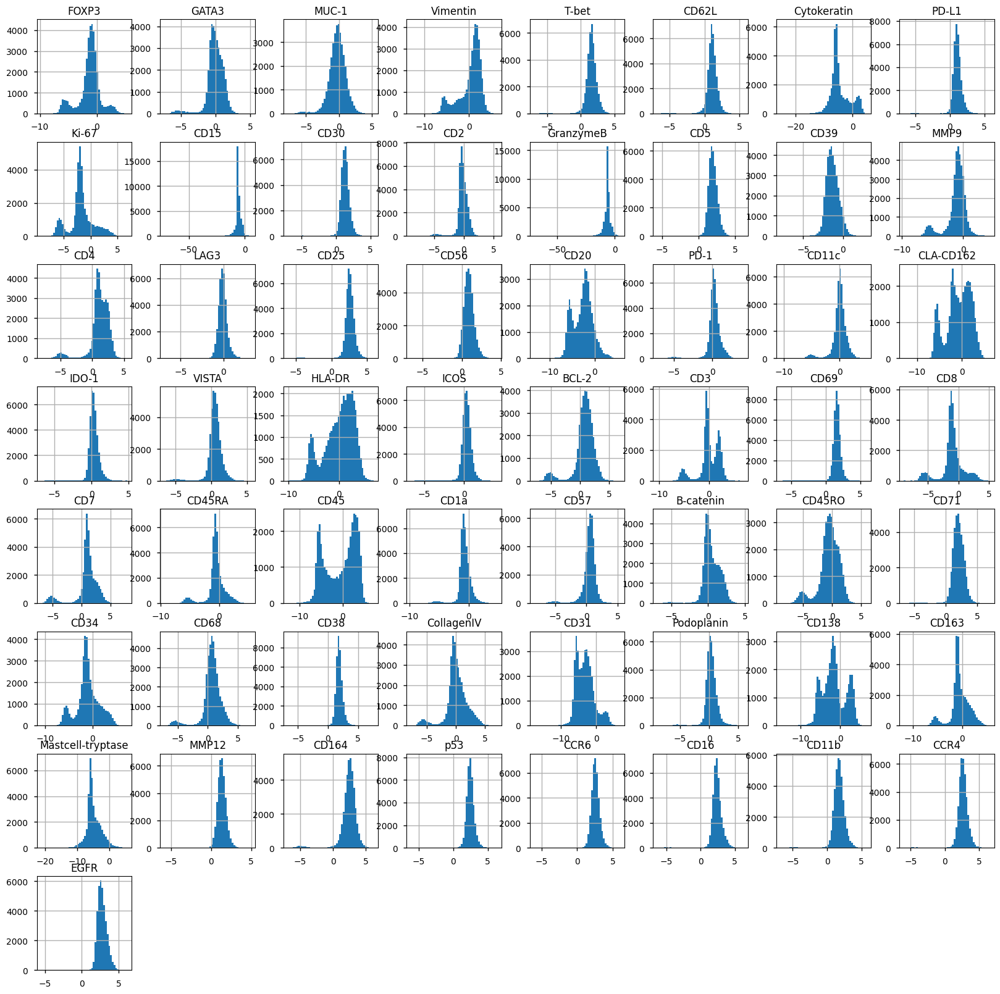

In [27]:
obj_transfo = mosna.transform_data(
    data=obj, 
    groups=sample_col,
    use_cols=marker_cols,
    method='clr')

obj_transfo[marker_cols].hist(bins=50, figsize=(20, 20));

In [22]:
nodes_dir = mosna.transform_nodes(
    nodes_dir=nodes_dir,
    id_level_1='patient',
    id_level_2='sample', 
    use_cols=marker_cols,
    method='clr',
    save_dir='auto',
)

### Batch corrrection

#### make UMAP before batch correction

In [23]:
nodes_agg = mosna.aggregate_nodes(
    nodes_dir=nodes_dir,
    use_cols=marker_cols,
)

In [24]:
nodes_agg

,FOXP3,GATA3,MUC-1,Vimentin,T-bet,CD62L,Cytokeratin,PD-L1,Ki-67,CD15,...,MMP12,CD164,p53,CCR6,CD16,CD11b,CCR4,EGFR,patient,sample
0,-0.577643,0.303034,0.927949,-0.254543,0.851944,0.591799,-1.014143,1.522339,-0.601958,-2.251974,...,0.549218,0.289326,0.940971,1.641375,2.708796,0.289944,1.133214,1.207078,2,reg005
1,-4.033218,-2.332929,-2.044272,-0.798900,1.159985,-0.364916,-2.081535,1.967116,-2.880154,-4.608071,...,-1.465241,-0.273685,0.690325,0.419829,3.193155,-0.119408,3.098539,2.993863,2,reg005
2,-2.048273,-0.115249,0.215023,1.319041,1.894499,1.112348,-7.542443,1.253748,-1.996564,-6.372283,...,1.589725,3.393049,2.506503,2.419743,3.357358,2.663107,1.966820,2.683260,2,reg005
3,-1.421894,-0.095094,-0.589580,2.310676,1.796479,1.071387,-4.040258,1.084849,-2.450859,-7.075460,...,1.448667,3.458985,2.235682,2.178291,3.532978,2.236924,2.129429,2.647542,2,reg005
4,-1.072511,-0.551604,-0.770388,2.945916,1.797972,1.306224,-5.360121,1.162806,1.800443,-12.737854,...,0.825002,2.849466,2.392137,1.541138,3.435253,2.266494,1.887595,3.061349,2,reg005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38060,-0.149549,-1.043051,-2.003256,0.789330,0.380304,0.097740,-1.599680,0.585397,-2.324107,-2.378211,...,0.805515,1.117501,1.683828,1.661990,2.008904,1.183713,1.755553,1.850817,3,reg009
38061,0.250702,-1.129898,1.303055,1.391171,1.605707,1.185920,-6.081461,1.128793,-1.979856,-6.081461,...,1.319780,2.731213,2.775572,2.700915,2.659446,1.916965,2.706461,2.963308,3,reg009
38062,-0.508385,-0.081507,2.071783,0.256330,0.813486,0.784149,-7.157277,0.774346,0.957699,-7.157277,...,0.739428,1.866181,2.027164,1.918900,1.718823,0.974998,2.344081,1.826326,3,reg009
38063,0.925035,-0.753774,-2.943654,2.362044,2.032106,1.283706,-5.719733,1.141324,-5.719733,-4.729417,...,1.531272,1.507729,3.161583,2.694277,3.807474,2.364732,2.845351,3.155808,3,reg009


In [25]:
embed_viz, _ = mosna.get_reducer(nodes_agg[marker_cols], nodes_dir)

Loading reducer object and reduced coordinates


In [26]:
fig_step = '01_processing'

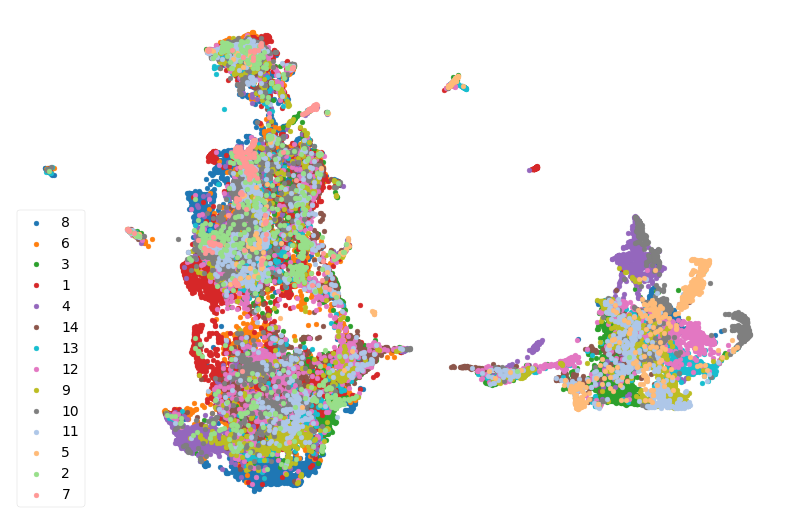

In [30]:
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_agg['patient'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    )
plt.savefig(save_dir / f'{fig_step}-UMAP_before_batch_correction_per_patient.jpg', bbox_inches='tight', facecolor='white')

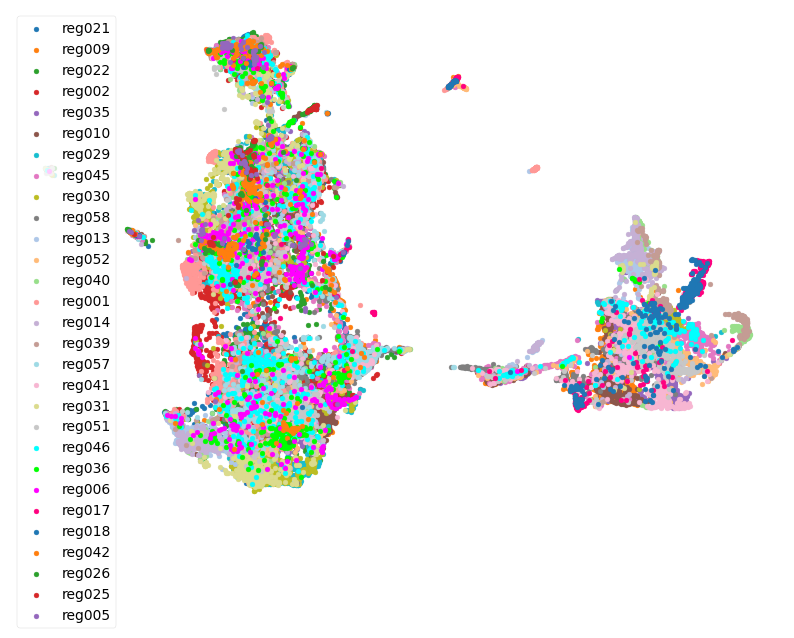

In [31]:
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_agg['sample'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    )
plt.savefig(save_dir / f'{fig_step}-UMAP_before_batch_correction_per_sample.jpg', bbox_inches='tight', facecolor='white')

#### Perform batch correction

In [32]:
nodes_dir, nodes_corr = mosna.batch_correct_nodes(
    nodes_dir=nodes_dir,
    use_cols=marker_cols,
    batch_key='patient',
    return_nodes=True,
    )

In [33]:
embed_viz, _ = mosna.get_reducer(nodes_corr[marker_cols], nodes_dir, random_state=0)

Loading reducer object and reduced coordinates


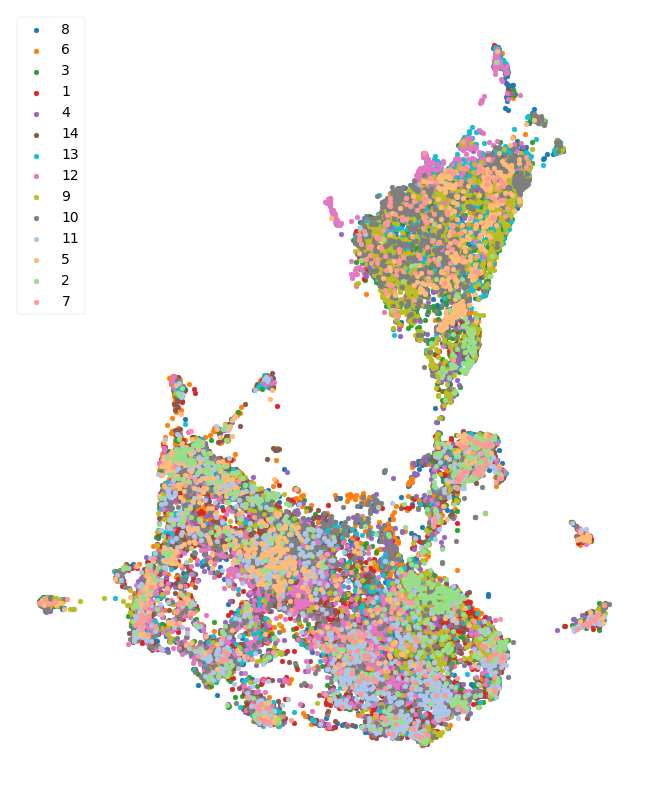

In [35]:
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_corr['patient'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    )
plt.savefig(save_dir / f'{fig_step}-UMAP_after_batch_correction_per_patient.jpg', bbox_inches='tight', facecolor='white')

## Response groups characteristics and survival analysis

We will look at what variables define or explain response to therapy or longer survival.  
For this, we will start with the simplest statistics, like proportions of cell types or marker-positive cells, and we will gradulally increase the complexity of variables, looking at interactions between cell types and finally discovering spatial neighborhoods, or "niches", potentially predictive of response to therapy.

### Cell types proportions

In [77]:
group_names = {1: 'Responder', 2:'Non-responder'}
fig_step = "02_cell_types_proportions"

In [78]:
# we add attributes to nodes to color network figures
nodes_all = obj[pos_cols + [pheno_col]].copy()
nodes_all = nodes_all.join(pd.get_dummies(obj[pheno_col]))
uniq_phenotypes = nodes_all[pheno_col].unique() 

In [79]:
# here we don't use `sample_col` but `patient_col` in the group / unstack procedure to aggregate 
# statistics per patient and condition (before / after treatment) rather than per sample.

count_types = obj[[patient_col, group_col, 'Count']].join(nodes_all[pheno_col]).groupby([patient_col, group_col, pheno_col]).count().unstack()
count_types.columns = count_types.columns.droplevel()
count_types = count_types.fillna(value=0).astype(int)
# count_types.index.name = 'sample'
count_types.to_csv(save_dir / 'count_types_per_patient_per_condition.csv')
count_types

,cell type,B cells,CD4+ T cells,CD8+ T cells,CLA+ leukocytes,"DCs, CD11c+",IDO+ stromal cells,Langerhans cells,Tregs,epithelium,lymphatics,...,macrophages (M1>M2),macrophages (M2>M1),mast cells,nerves,neutrophils,plasma cells,stroma,tumor cells,"tumor cells, intraepithelial",vasculature
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,34,50,229,20,0,0,42,350,112,23,...,545,83,9,33,36,133,582,777,48,149
2,1,6,3,5,3,0,0,12,15,6,5,...,71,64,3,6,1,4,203,155,2,95
3,2,2,208,186,14,0,2,130,99,1759,24,...,397,39,33,17,0,4,328,546,274,86
4,2,178,20,45,0,0,0,16,9,901,7,...,202,10,12,9,0,4,356,987,5,186
5,1,0,0,1,0,0,0,5,6,913,0,...,17,2,2,3,0,1,34,7,1,18
6,2,83,200,693,15,0,3,95,357,11,102,...,809,43,20,5,26,35,679,1157,22,255
7,2,0,0,0,0,0,0,1,0,0,3,...,16,0,5,150,0,0,180,3,0,32
8,2,24,42,39,14,0,0,9,38,338,45,...,174,730,1,49,69,31,871,2081,8,306
9,1,2,19,51,2,0,0,11,9,1041,4,...,129,11,29,11,0,0,354,751,12,168


In [80]:
plt.style.use('seaborn-v0_8-poster')

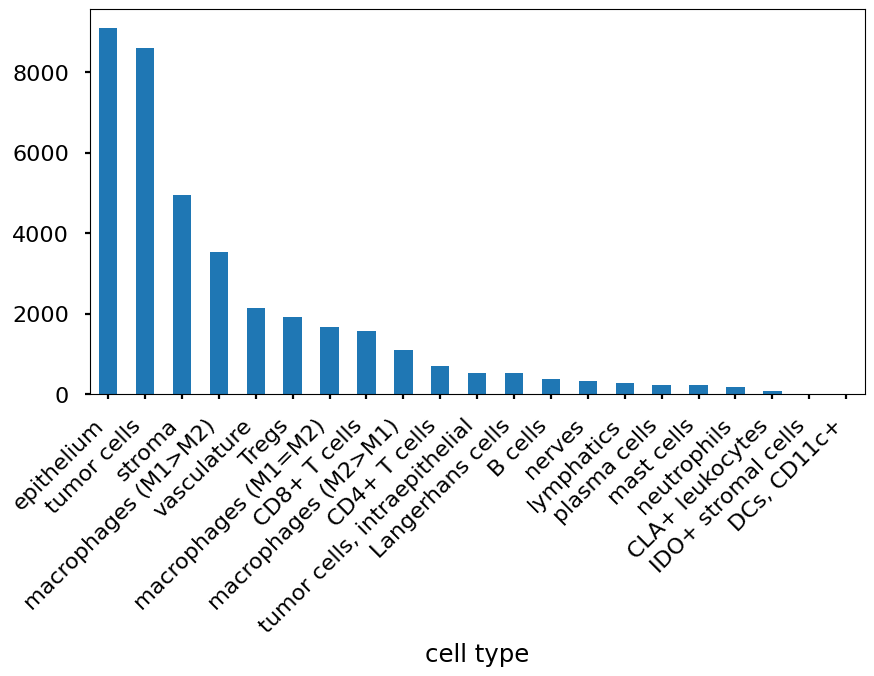

In [81]:
total_count_types = count_types.sum().sort_values(ascending=False)
ax = total_count_types.plot.bar(figsize=(10, 5))
plt.xticks(rotation=45, ha='right');
plt.savefig(save_dir / f'{fig_step}-cell_types_counts.jpg', bbox_inches='tight', facecolor='white', dpi=600)

Instead of counts we use proportions of cell types per patient and condition.

In [82]:
prop_types = count_types.div(count_types.sum(axis=1), axis=0)
prop_types

,cell type,B cells,CD4+ T cells,CD8+ T cells,CLA+ leukocytes,"DCs, CD11c+",IDO+ stromal cells,Langerhans cells,Tregs,epithelium,lymphatics,...,macrophages (M1>M2),macrophages (M2>M1),mast cells,nerves,neutrophils,plasma cells,stroma,tumor cells,"tumor cells, intraepithelial",vasculature
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,0.009379,0.013793,0.063172,0.005517,0.000000,0.000000,0.011586,0.096552,0.030897,0.006345,...,0.150345,0.022897,0.002483,0.009103,0.009931,0.036690,0.160552,0.214345,0.013241,0.041103
2,1,0.008392,0.004196,0.006993,0.004196,0.000000,0.000000,0.016783,0.020979,0.008392,0.006993,...,0.099301,0.089510,0.004196,0.008392,0.001399,0.005594,0.283916,0.216783,0.002797,0.132867
3,2,0.000465,0.048327,0.043216,0.003253,0.000000,0.000465,0.030204,0.023002,0.408690,0.005576,...,0.092240,0.009061,0.007667,0.003950,0.000000,0.000929,0.076208,0.126859,0.063662,0.019981
4,2,0.058649,0.006590,0.014827,0.000000,0.000000,0.000000,0.005272,0.002965,0.296870,0.002306,...,0.066557,0.003295,0.003954,0.002965,0.000000,0.001318,0.117298,0.325206,0.001647,0.061285
5,1,0.000000,0.000000,0.000984,0.000000,0.000000,0.000000,0.004921,0.005906,0.898622,0.000000,...,0.016732,0.001969,0.001969,0.002953,0.000000,0.000984,0.033465,0.006890,0.000984,0.017717
6,2,0.017263,0.041597,0.144135,0.003120,0.000000,0.000624,0.019759,0.074251,0.002288,0.021215,...,0.168261,0.008943,0.004160,0.001040,0.005408,0.007280,0.141223,0.240641,0.004576,0.053037
7,2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.002494,0.000000,0.000000,0.007481,...,0.039900,0.000000,0.012469,0.374065,0.000000,0.000000,0.448878,0.007481,0.000000,0.079800
8,2,0.004871,0.008524,0.007916,0.002841,0.000000,0.000000,0.001827,0.007713,0.068602,0.009133,...,0.035316,0.148163,0.000203,0.009945,0.014004,0.006292,0.176781,0.422367,0.001624,0.062107
9,1,0.000749,0.007113,0.019094,0.000749,0.000000,0.000000,0.004118,0.003370,0.389742,0.001498,...,0.048297,0.004118,0.010857,0.004118,0.000000,0.000000,0.132535,0.281168,0.004493,0.062898


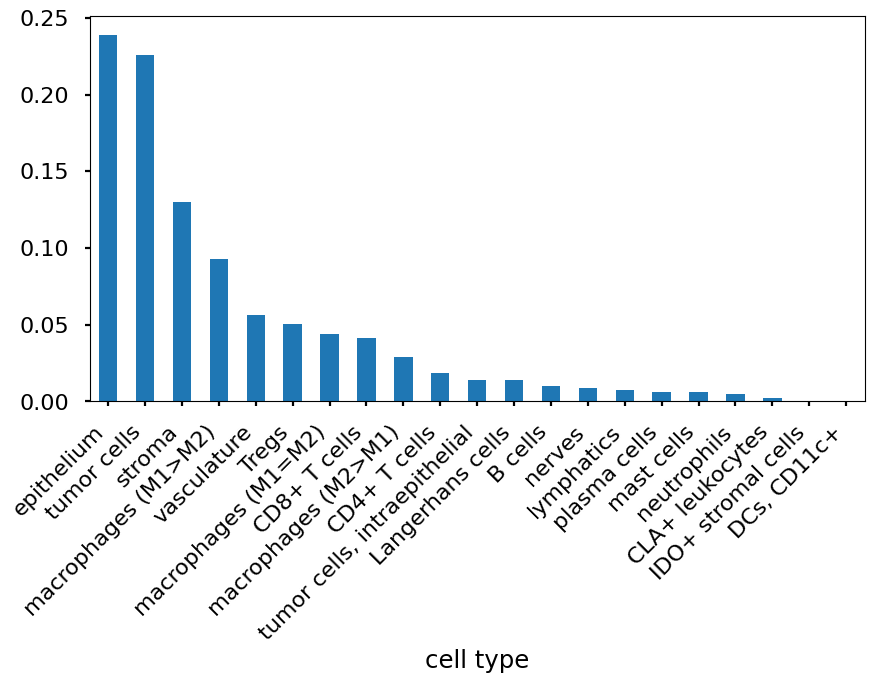

In [83]:
total_prop_types = total_count_types / total_count_types.sum()
ax = total_prop_types.plot.bar(figsize=(10, 5))
plt.xticks(rotation=45, ha='right');
plt.savefig(save_dir / f'{fig_step}-cell_types_proportions.jpg', bbox_inches='tight', facecolor='white', dpi=600)

In [84]:
total_prop_types

cell type
epithelium                      0.239012
tumor cells                     0.225667
stroma                          0.130120
macrophages (M1>M2)             0.092473
vasculature                     0.056220
Tregs                           0.050230
macrophages (M1=M2)             0.044135
CD8+ T cells                    0.041272
macrophages (M2>M1)             0.029213
CD4+ T cells                    0.018285
tumor cells, intraepithelial    0.014107
Langerhans cells                0.013766
B cells                         0.009799
nerves                          0.008801
lymphatics                      0.007724
plasma cells                    0.006069
mast cells                      0.005858
neutrophils                     0.004729
CLA+ leukocytes                 0.002286
IDO+ stromal cells              0.000184
DCs, CD11c+                     0.000053
dtype: float64

In [85]:
pvals = mosna.find_DE_markers(prop_types, group_ref=1, group_tgt=2, group_var=group_col)
pvals

,pval,pval_corr
IDO+ stromal cells,0.075413,0.988974
lymphatics,0.128205,0.988974
CD4+ T cells,0.141282,0.988974
tumor cells,0.259324,0.996411
epithelium,0.317599,0.996411
CD8+ T cells,0.382867,0.996411
vasculature,0.455711,0.996411
B cells,0.481721,0.996411
macrophages (M1=M2),0.534965,0.996411
Langerhans cells,0.620047,0.996411


There are 0 significant variables in `pval`


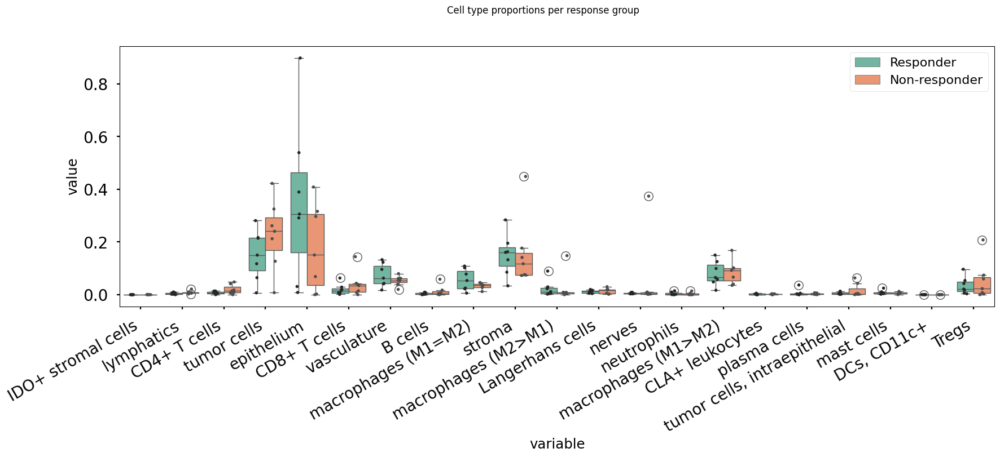

In [86]:
fig, ax = mosna.plot_distrib_groups(
    prop_types, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=-1, 
    multi_ind_to_col=True,
    group_names=group_names,
    )
fig.suptitle("Cell type proportions per response group", y=1.0);
plt.savefig(save_dir / f'{fig_step}-distributions_per_response_group.jpg', bbox_inches='tight', facecolor='white', dpi=600)

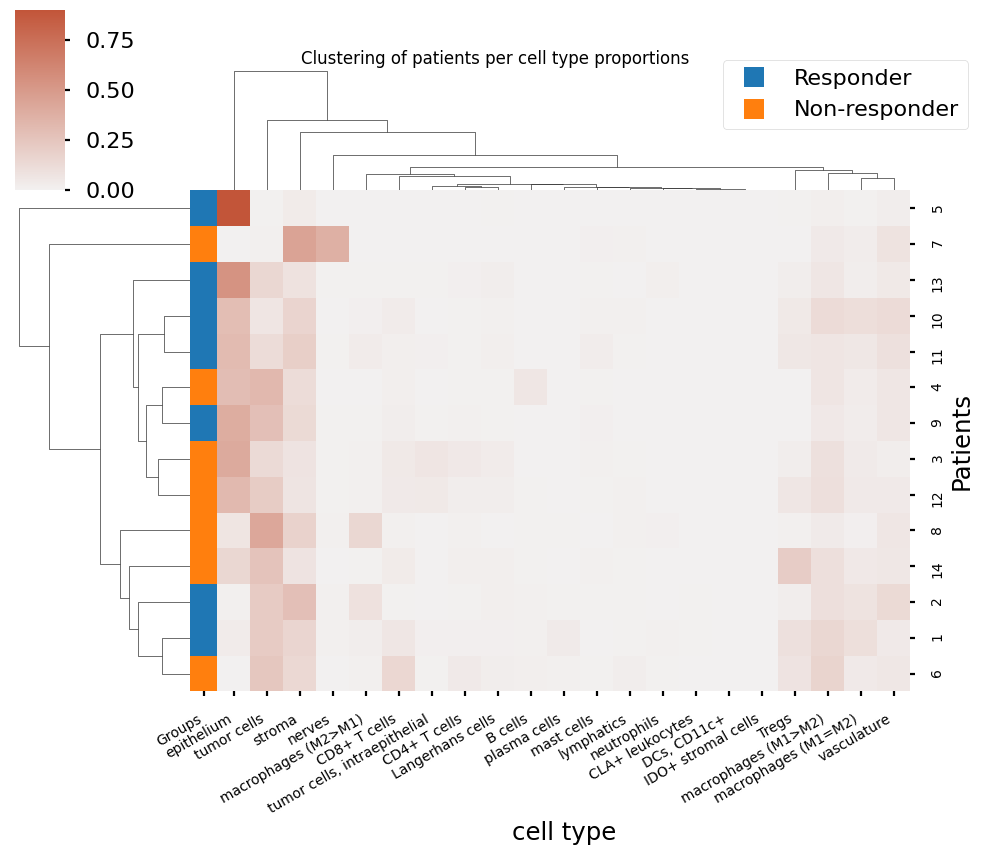

In [87]:
g = mosna.plot_heatmap(
    prop_types.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    group_names=group_names,
    cbar_pos=(0.02, 0.86, 0.05, 0.18),
    legend_opt = {'loc': 'lower right', 'bbox_to_anchor': (1.1, 1.1)},
    )
title = "Clustering of patients per cell type proportions"
g.fig.suptitle(title, y=1.0);
plt.savefig(save_dir / f"{fig_step}-{'_'.join(title.split(' '))}.jpg", bbox_inches='tight', facecolor='white', dpi=600)

Because some variables have generally higher values than others, that give them more weight to compare samples.  
To compensate for this effect we should standardize values per variable.

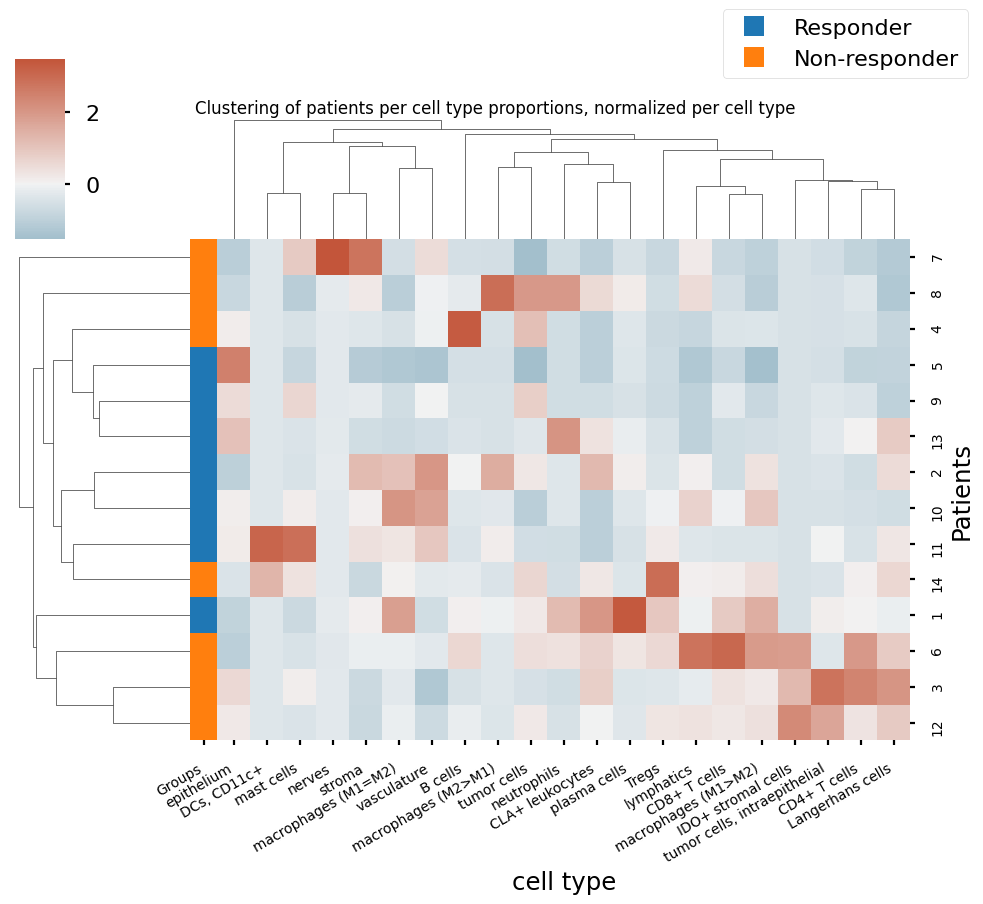

In [88]:
g = mosna.plot_heatmap(
    prop_types.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    group_names=group_names,
    cbar_pos=(0.02, 0.86, 0.05, 0.18),
    legend_opt = {'loc': 'lower right', 'bbox_to_anchor': (1.1, 1.3)},
    )
title = "Clustering of patients per cell type proportions, normalized per cell type"
g.fig.suptitle(title, y=1.0);
plt.savefig(save_dir / f"{fig_step}-{'_'.join(title.split(' '))}.jpg", bbox_inches='tight', facecolor='white', dpi=600)

In [89]:
# With this dataset, when we filter networks without enough nodes
# we can't split patients in 5 groups having at least one occurrence
# of both groups (one patient of group 2 is deleted).

if net_size_threshold == 300:
    cv_train = 4
    cv_adapt = False
    cv_max = 4
else:
    cv_train = 5
    cv_adapt = False
    cv_max = 5

        training failed
        training failed with cv <= 5
Training took 2.957s


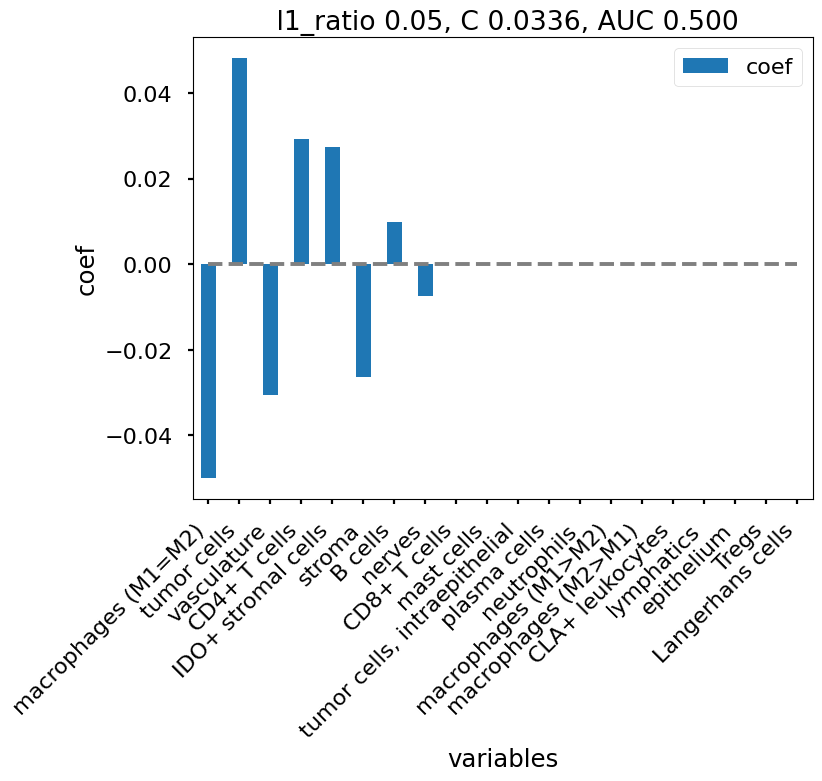

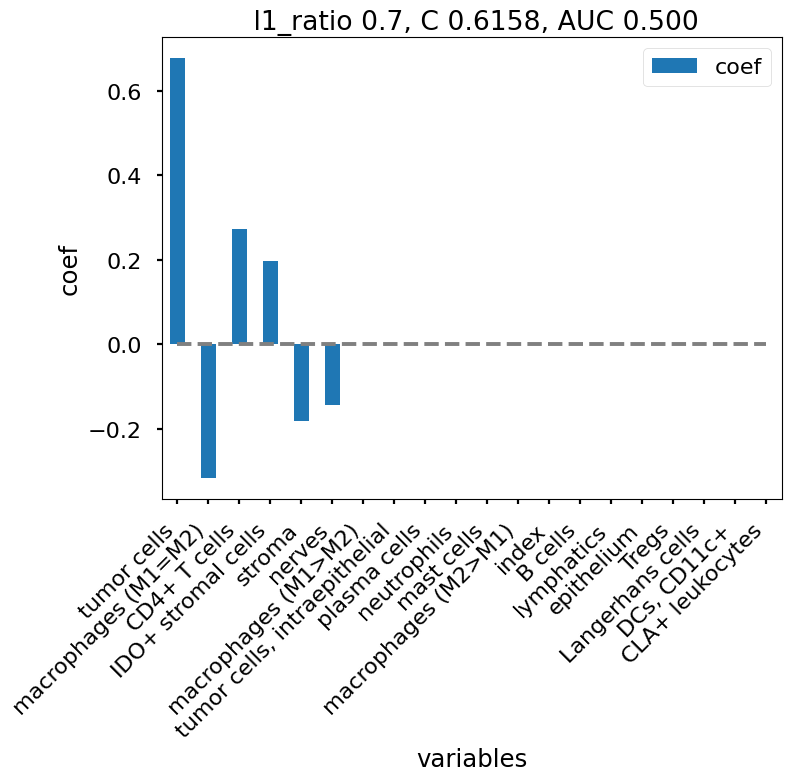

In [90]:
models = mosna.logistic_regression(
    prop_types.reset_index(),
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    figsize=(8,6),
    save_plot_figures=True,
    dir_save=save_dir,
    str_prefix=f'{fig_step}_',
    )

Cell types proportions are not significantly associated with response / non response in samples before treatment.  
But `mosna` can find composed variables potentially related to response of patients:

### Ratio of cell type proportions

In [91]:
# `find_DE_markers` can make composite variables, but we do it beforehand to reuse them
composed_variables = mosna.make_composed_variables(prop_types, method='ratio', order=1)
prop_types_comp = pd.concat([prop_types, composed_variables], axis=1)
pvals = mosna.find_DE_markers(prop_types_comp, group_ref=1, group_tgt=2, group_var=group_col)

In [92]:
pvals.head(20)

,pval,pval_corr
lymphatics / macrophages (M1=M2),0.004079,0.696813
lymphatics / vasculature,0.026224,0.696813
lymphatics / macrophages (M2>M1),0.040692,0.696813
tumor cells / vasculature,0.053030,0.696813
IDO+ stromal cells / epithelium,0.053349,0.696813
IDO+ stromal cells / macrophages (M2>M1),0.053349,0.696813
"IDO+ stromal cells / tumor cells, intraepithelial",0.053349,0.696813
CD8+ T cells / IDO+ stromal cells,0.053349,0.696813
IDO+ stromal cells / Tregs,0.053349,0.696813
lymphatics / stroma,0.072844,0.696813


There are 3 significant variables in `pval`


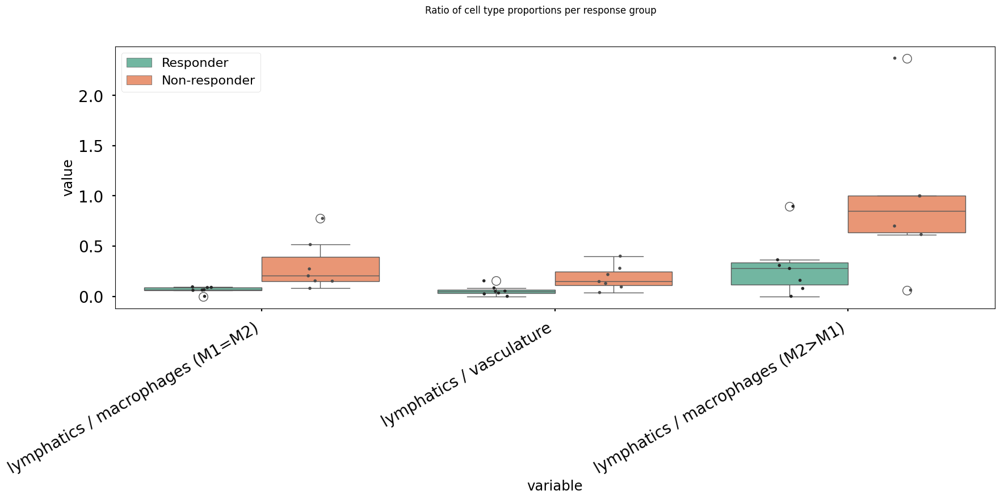

In [93]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    group_names=group_names,
    )
fig.suptitle("Ratio of cell type proportions per response group", y=1.0);
plt.savefig(save_dir / f'{fig_step}-distributions_of_ratios_per_response_group.jpg', bbox_inches='tight', facecolor='white', dpi=600)

In [96]:
# we need to clean-up data for further analyses and visualizations
# otherwise some visualization tools and ML models break with NaN
prop_types_comp_cleaned, select_finite = mosna.clean_data(
    prop_types_comp, 
    method='mixed',
    thresh=0.9,
    )

There are 315 non finite values (9.7%)
Imputing data


In [97]:
pvals_cleaned = mosna.find_DE_markers(prop_types_comp_cleaned, group_ref=1, group_tgt=2, group_var=group_col)
pvals_cleaned.head(10)

,pval,pval_corr
lymphatics / macrophages (M1=M2),0.004079,0.829539
lymphatics / vasculature,0.026224,0.829539
IDO+ stromal cells / Tregs,0.030721,0.829539
IDO+ stromal cells / epithelium,0.030721,0.829539
IDO+ stromal cells / macrophages (M2>M1),0.030721,0.829539
"IDO+ stromal cells / tumor cells, intraepithelial",0.030721,0.829539
tumor cells / vasculature,0.053030,0.829539
lymphatics / macrophages (M2>M1),0.055017,0.829539
lymphatics / stroma,0.072844,0.829539
CD4+ T cells / macrophages (M2>M1),0.072844,0.829539


There are 6 significant variables in `pval`


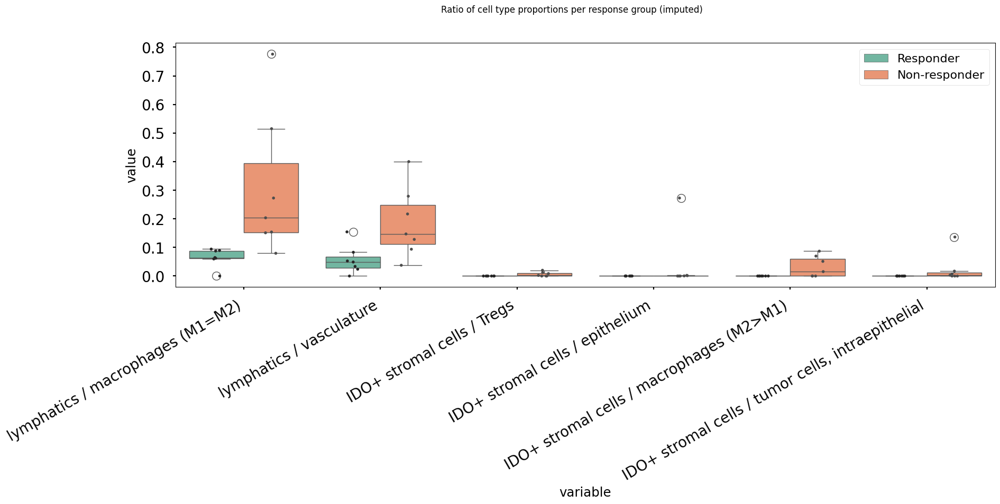

In [98]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals_cleaned, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    group_names=group_names,
    )
fig.suptitle("Ratio of cell type proportions per response group (imputed)", y=1.0);
plt.savefig(save_dir / f'{fig_step}-distributions_of_ratios_per_response_group_after_imputation.jpg', bbox_inches='tight', facecolor='white', dpi=600)

There are 6 significant variables in `pval`


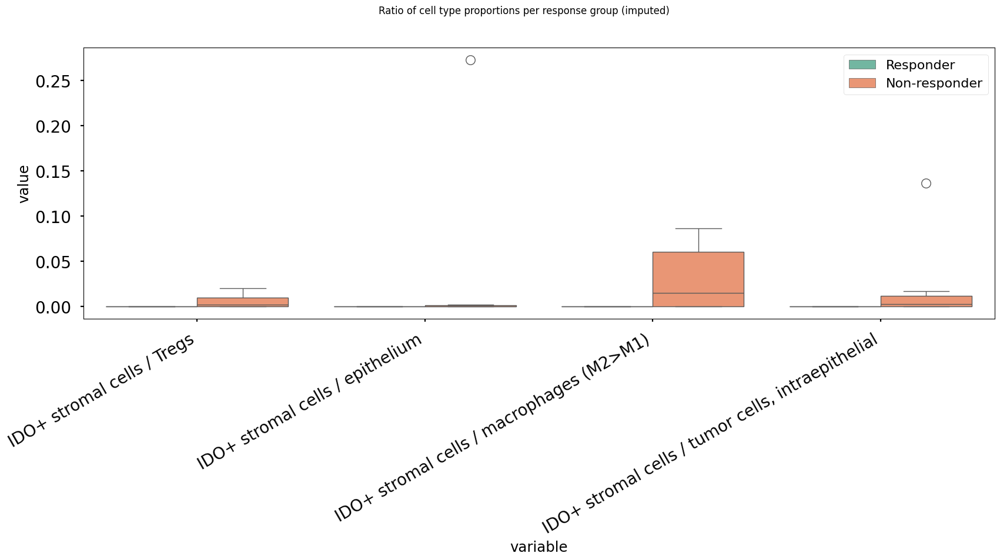

In [99]:
# ignore the first 2 composed variables as their representation hide other distributions

exclude_vars = [
    'lymphatics / macrophages (M1=M2)',
    'lymphatics / vasculature',
]

fig, ax = mosna.plot_distrib_groups(
    prop_types_comp_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals_cleaned, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    exclude_vars=exclude_vars,
    add_points=False,
    group_names=group_names,
    )
fig.suptitle("Ratio of cell type proportions per response group (imputed)", y=1.0);
plt.savefig(save_dir / f'{fig_step}-distributions_of_ratios_per_response_group_after_imputation_selected.jpg', bbox_inches='tight', facecolor='white', dpi=600)

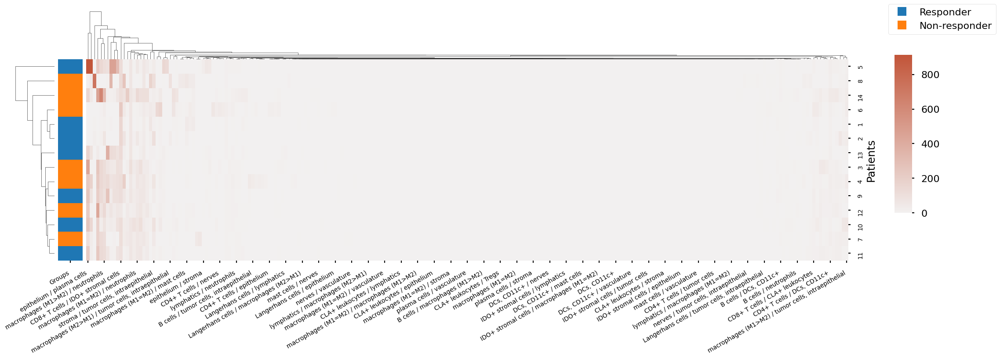

In [103]:
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(20, 12),
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=[0.05, 0.2],
    );
plt.savefig(save_dir / f'{fig_step}-clustering_on_ratios.jpg', bbox_inches='tight', facecolor='white', dpi=600)

In [46]:
# We can't display the dendrogram with values normalized per variable, as some non finite values are produced and make seaborn crash.  

# best_pval_names = pvals_cleaned.loc[pvals_cleaned['pval'] < 0.05, :].index
# # or to select only 20 variables:
# # best_pval_names = pvals.head(20).index
# mosna.plot_heatmap(
#     prop_types_comp_cleaned.reset_index(), 
#     obs_labels=patient_col, 
#     group_var=group_col, 
#     groups=[1, 2],
#     z_score=1,
#     figsize=(20, 12),
#     )

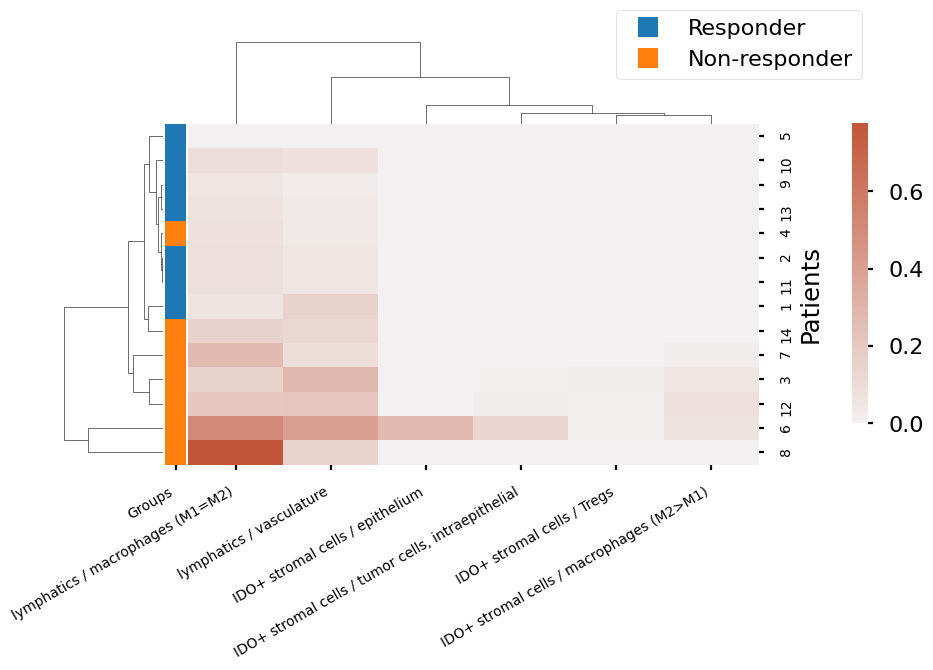

In [109]:
best_pval_names = pvals_cleaned.loc[pvals_cleaned['pval'] < 0.05, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(8, 10),
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=[0.15, 0.2],
    );
plt.savefig(save_dir / f'{fig_step}-clustering_on_ratios_selected.jpg', bbox_inches='tight', facecolor='white', dpi=600)

Training took 3.347s


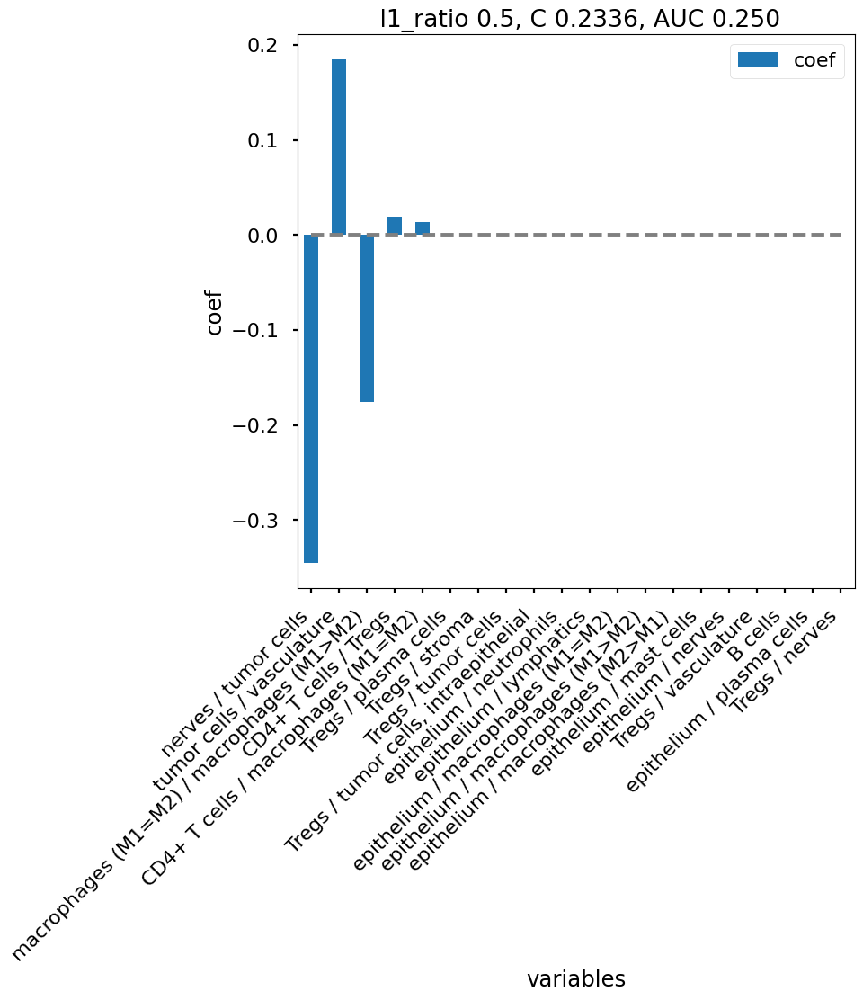

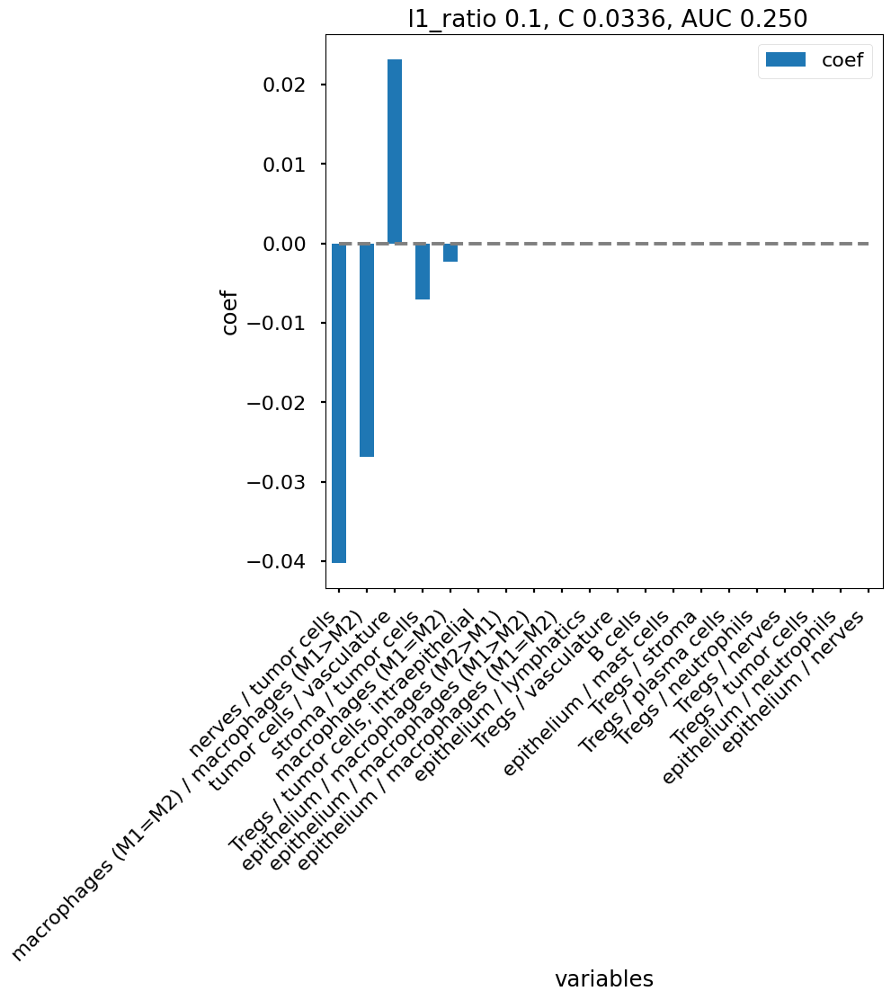

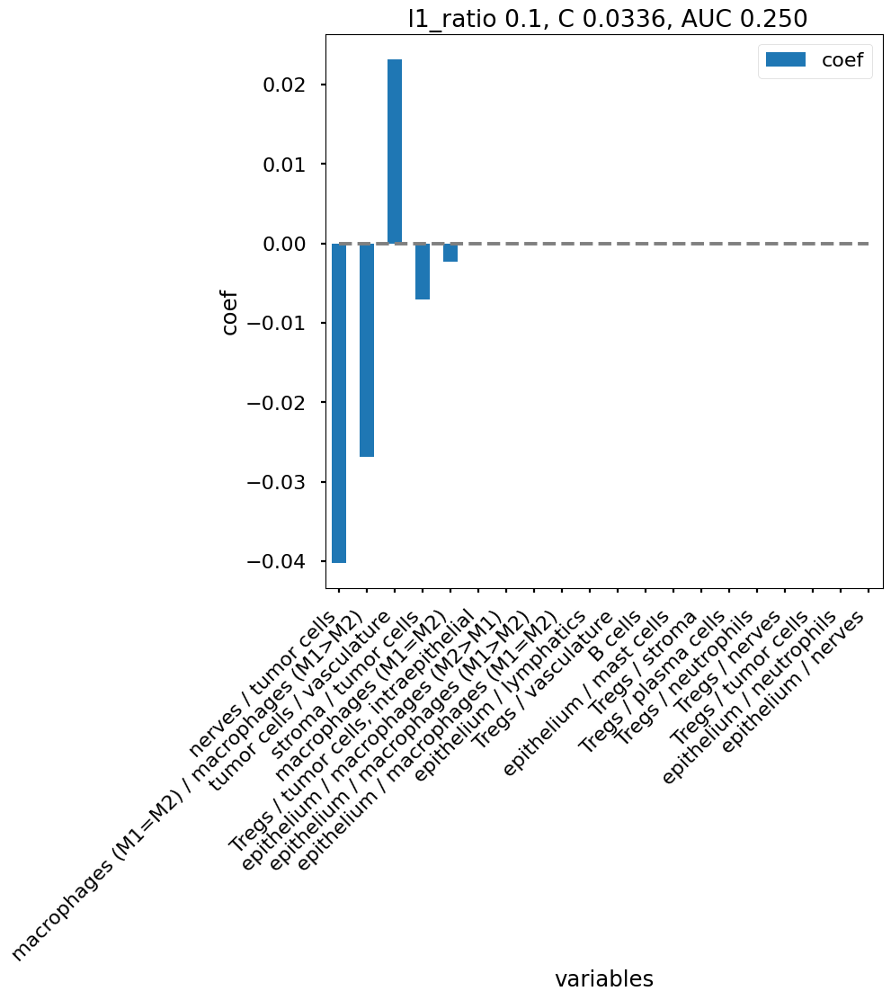

In [110]:
# Train ML model with all variables

models = mosna.logistic_regression(
    prop_types_comp_cleaned,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    save_plot_figures=True,
    dir_save=save_dir,
    str_prefix=f'{fig_step}_on_ratios_',
    )

Training took 3.083s


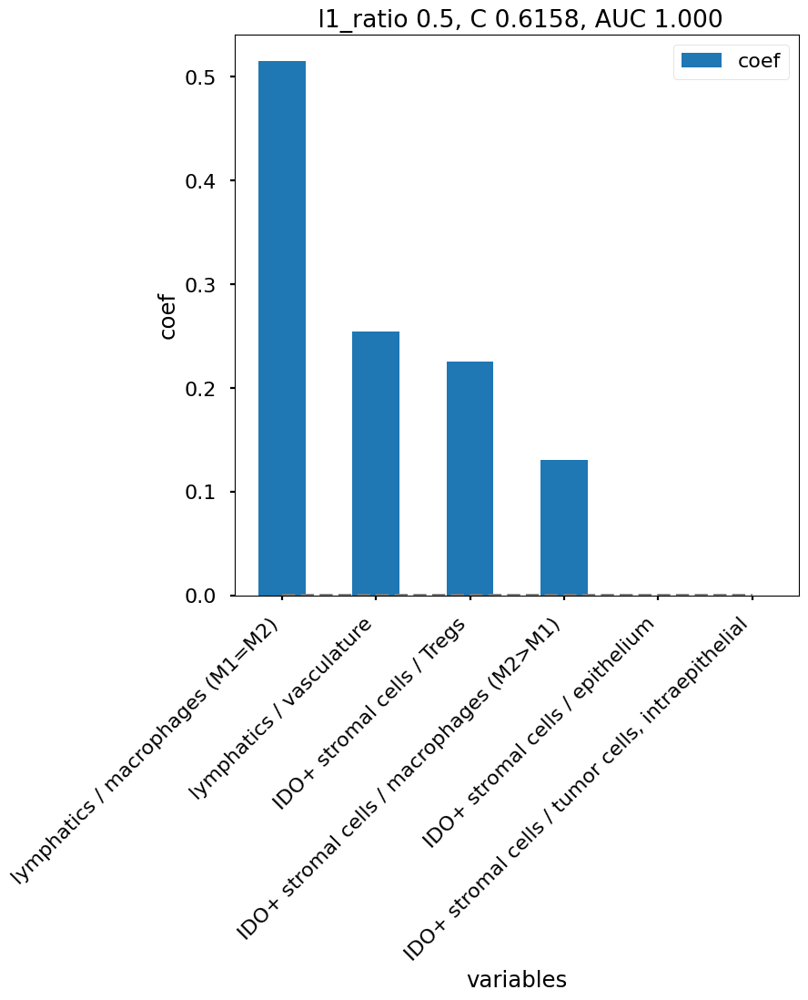

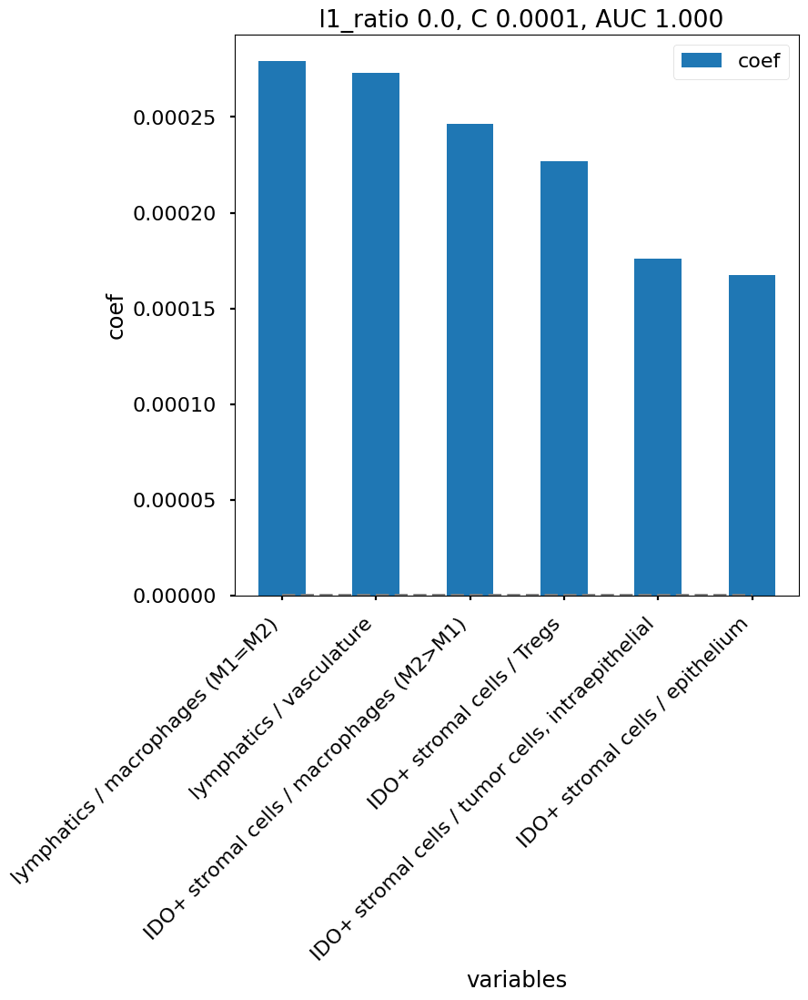

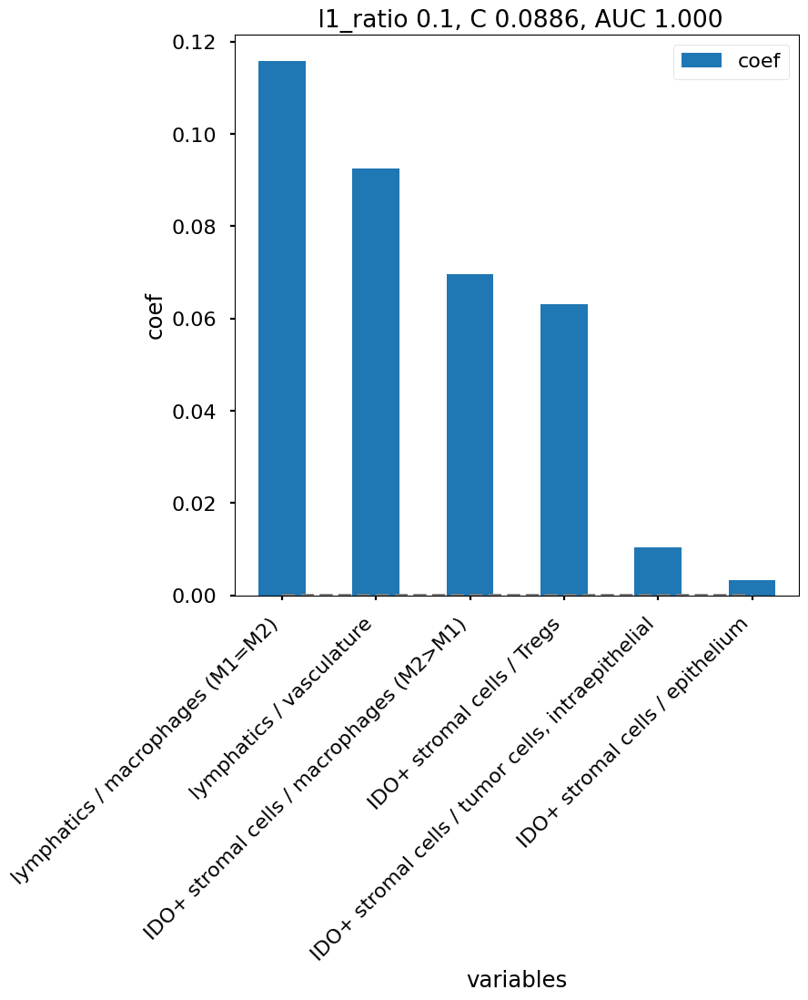

In [111]:
# Train ML model with best variables only

models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    save_plot_figures=True,
    dir_save=save_dir,
    str_prefix=f'{fig_step}_on_ratios_selected_',
    )

### Proportions of cell type proportions

Simple ratios can be problematic as they can lead to extreme values, such as in the case of x/0. To avoid that, we use proportions instead, i.e. a / (a + b), so all values are between 0 and 1.

In [112]:
# `find_DE_markers` can make composite variables, but we do it beforehand to reuse them
composed_variables = mosna.make_composed_variables(prop_types, method='proportion', order=1)
prop_types_comp = pd.concat([prop_types, composed_variables], axis=1)
pvals = mosna.find_DE_markers(prop_types_comp, group_ref=1, group_tgt=2, group_var=group_col)

In [113]:
pvals.head(20)

,pval,pval_corr
lymphatics / ( lymphatics + macrophages (M1=M2) ),0.004079,0.696813
lymphatics / ( lymphatics + vasculature ),0.026224,0.696813
lymphatics / ( lymphatics + macrophages (M2>M1) ),0.040692,0.696813
tumor cells / ( tumor cells + vasculature ),0.053030,0.696813
IDO+ stromal cells / ( IDO+ stromal cells + epithelium ),0.053349,0.696813
IDO+ stromal cells / ( IDO+ stromal cells + macrophages (M2>M1) ),0.053349,0.696813
"IDO+ stromal cells / ( IDO+ stromal cells + tumor cells, intraepithelial )",0.053349,0.696813
CD8+ T cells / ( CD8+ T cells + IDO+ stromal cells ),0.053349,0.696813
IDO+ stromal cells / ( IDO+ stromal cells + Tregs ),0.053349,0.696813
lymphatics / ( lymphatics + stroma ),0.072844,0.696813


There are 3 significant variables in `pval`


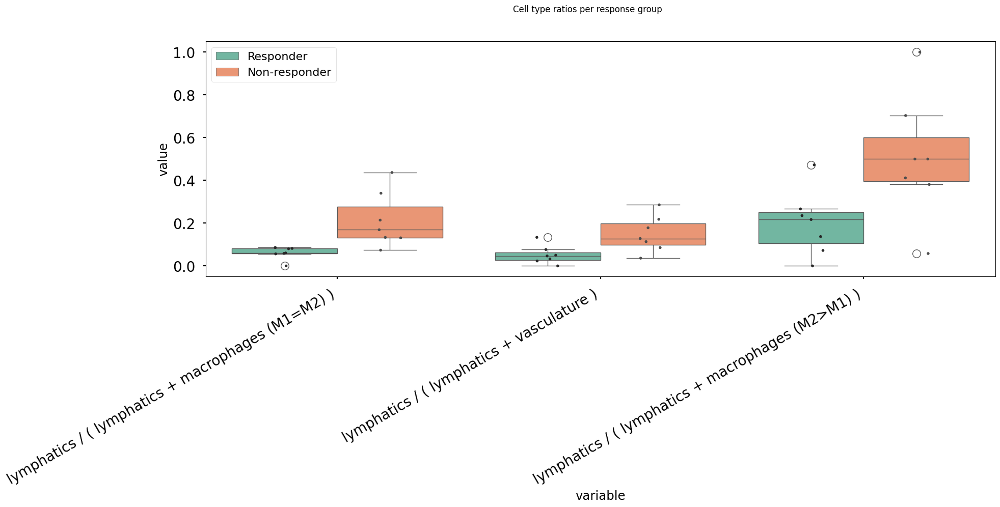

In [114]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    group_names=group_names,
    )
fig.suptitle("Cell type ratios per response group", y=1.0);
plt.savefig(save_dir / f'{fig_step}-distributions_of_ratios_per_response_group.jpg', bbox_inches='tight', facecolor='white', dpi=600)

In [115]:
# we need to clean-up data for further analyses and visualizations
# otherwise some visualization tools and ML models break with NaN

# with proportions of variables there are 3x fewer NaNs
prop_types_comp_cleaned, select_finite = mosna.clean_data(
    prop_types_comp, 
    method='mixed',
    thresh=0.9,
    )

There are 113 non finite values (3.5%)
Imputing data


In [116]:
pvals_cleaned = mosna.find_DE_markers(prop_types_comp_cleaned, group_ref=1, group_tgt=2, group_var=group_col)
pvals_cleaned.head(10)

,pval,pval_corr
lymphatics / ( lymphatics + macrophages (M1=M2) ),0.004079,0.829539
lymphatics / ( lymphatics + vasculature ),0.026224,0.829539
lymphatics / ( lymphatics + macrophages (M2>M1) ),0.040692,0.829539
tumor cells / ( tumor cells + vasculature ),0.053030,0.829539
lymphatics / ( lymphatics + macrophages (M1>M2) ),0.072844,0.829539
nerves / ( nerves + tumor cells ),0.072844,0.829539
lymphatics / ( lymphatics + stroma ),0.072844,0.829539
IDO+ stromal cells / ( IDO+ stromal cells + Tregs ),0.075413,0.829539
CD8+ T cells / ( CD8+ T cells + IDO+ stromal cells ),0.075413,0.829539
IDO+ stromal cells / ( IDO+ stromal cells + vasculature ),0.075413,0.829539


In [117]:
# Here there is no additional significant variable after data imputation, so we don't plot anything

# fig, ax = mosna.plot_distrib_groups(
#     prop_types_comp_cleaned, 
#     group_var=group_col,
#     groups=[1, 2], 
#     pval_data=pvals_cleaned, 
#     pval_col='pval', 
#     max_cols=20, 
#     multi_ind_to_col=True,
#     )

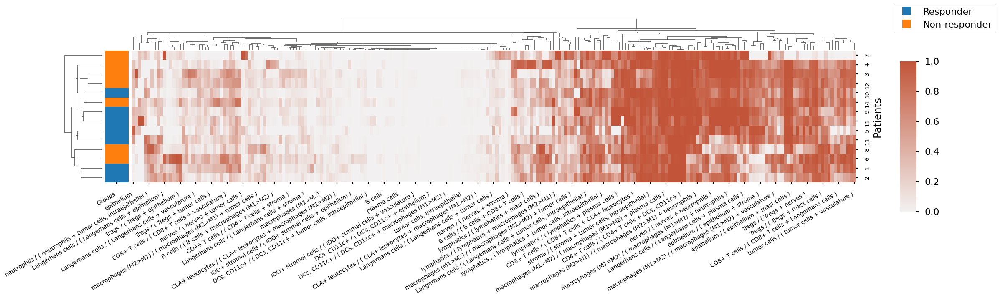

In [119]:
reload(mosna)
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(20, 12),
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=[0.05, 0.2],
    );
plt.savefig(save_dir / f'{fig_step}-clustering_on_ratios_imputed.jpg', bbox_inches='tight', facecolor='white', dpi=600)

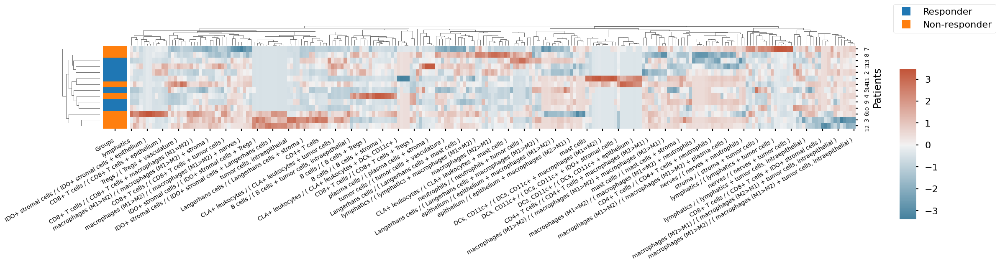

In [121]:
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    figsize=(20, 12),
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=[0.05, 0.2],
    );
plt.savefig(save_dir / f'{fig_step}-clustering_on_ratios_imputed_zscored.jpg', bbox_inches='tight', facecolor='white', dpi=600)

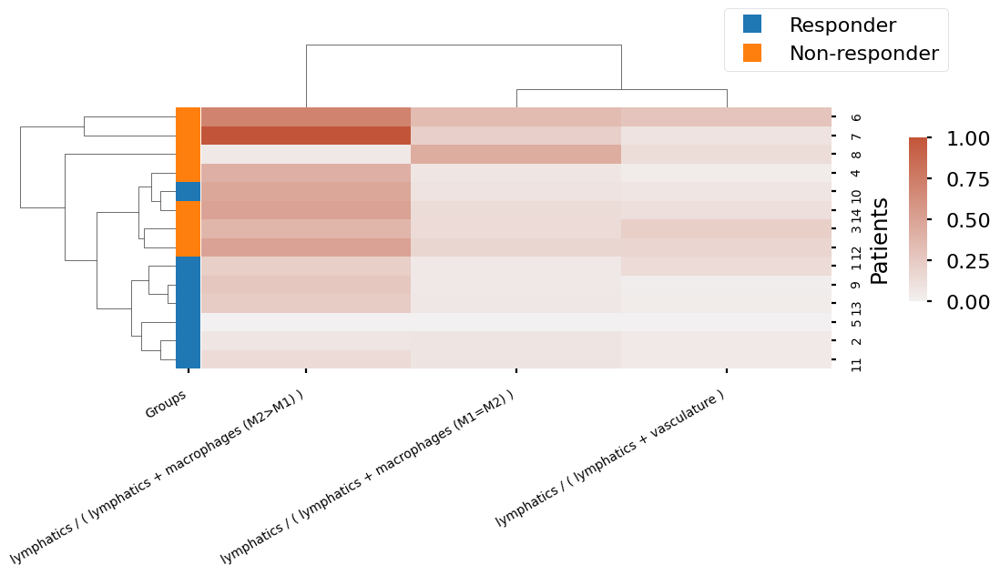

In [122]:
best_pval_names = pvals_cleaned.loc[pvals_cleaned['pval'] < 0.05, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(10, 10),
    group_names=group_names,
    cbar_pos=(1, 0.7, 0.02, 0.18),
    # fontsize=15,
    );
plt.savefig(save_dir / f'{fig_step}-clustering_on_ratios_imputed_selected.jpg', bbox_inches='tight', facecolor='white', dpi=600)

Training took 3.651s


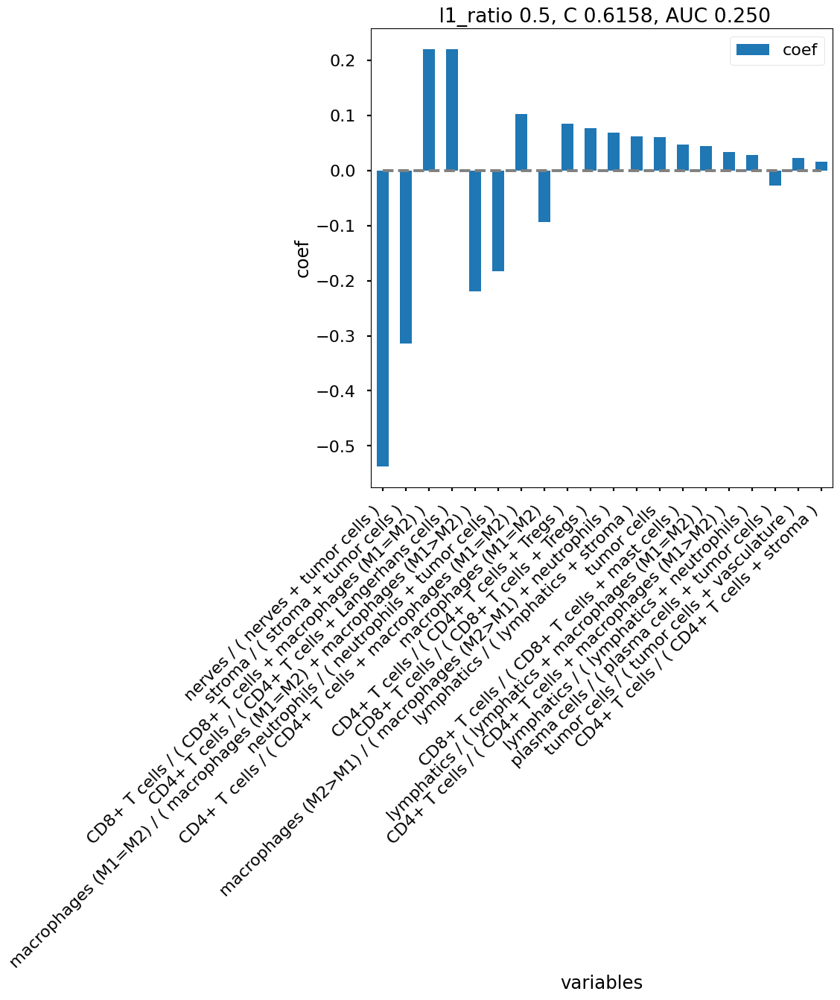

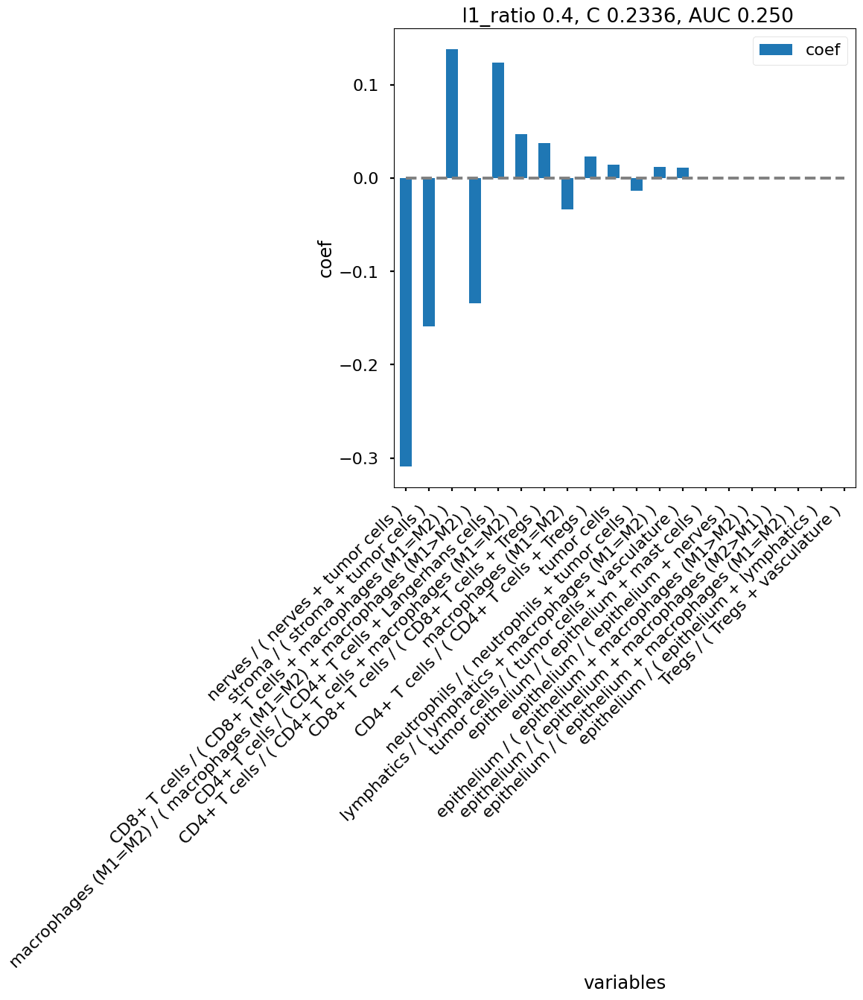

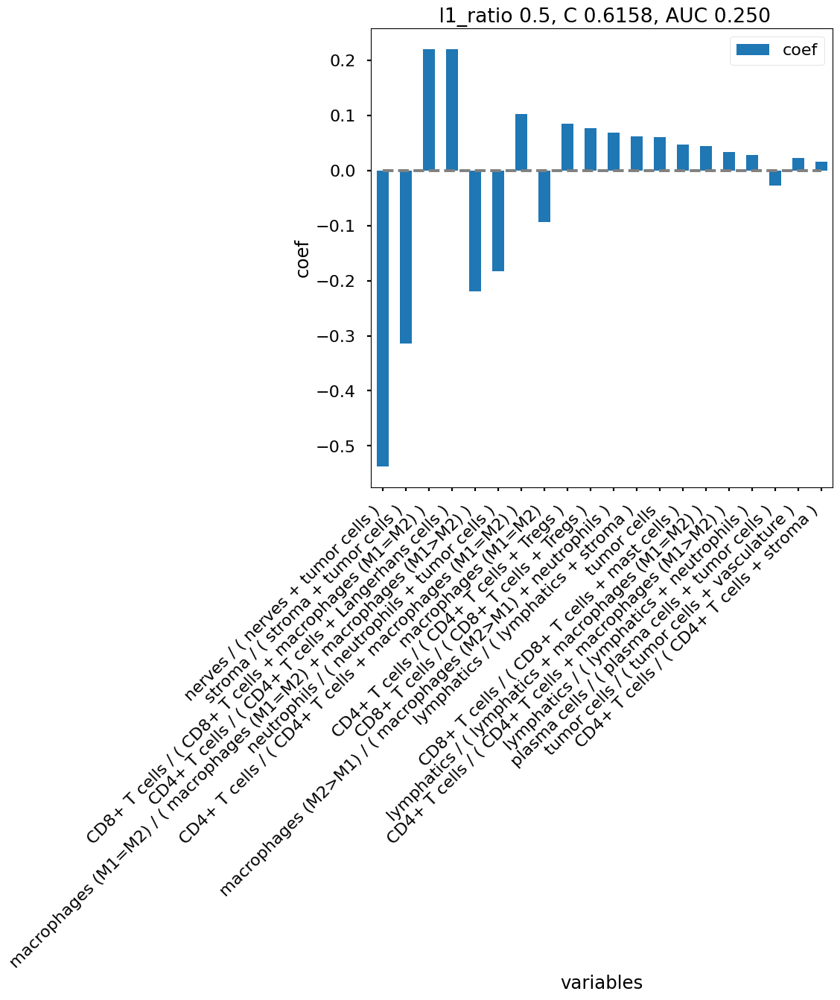

In [123]:
# Train ML model with all variables

models = mosna.logistic_regression(
    prop_types_comp_cleaned,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    save_plot_figures=True,
    dir_save=save_dir,
    str_prefix=f'{fig_step}_on_ratios2_',
    )

Training took 3.051s


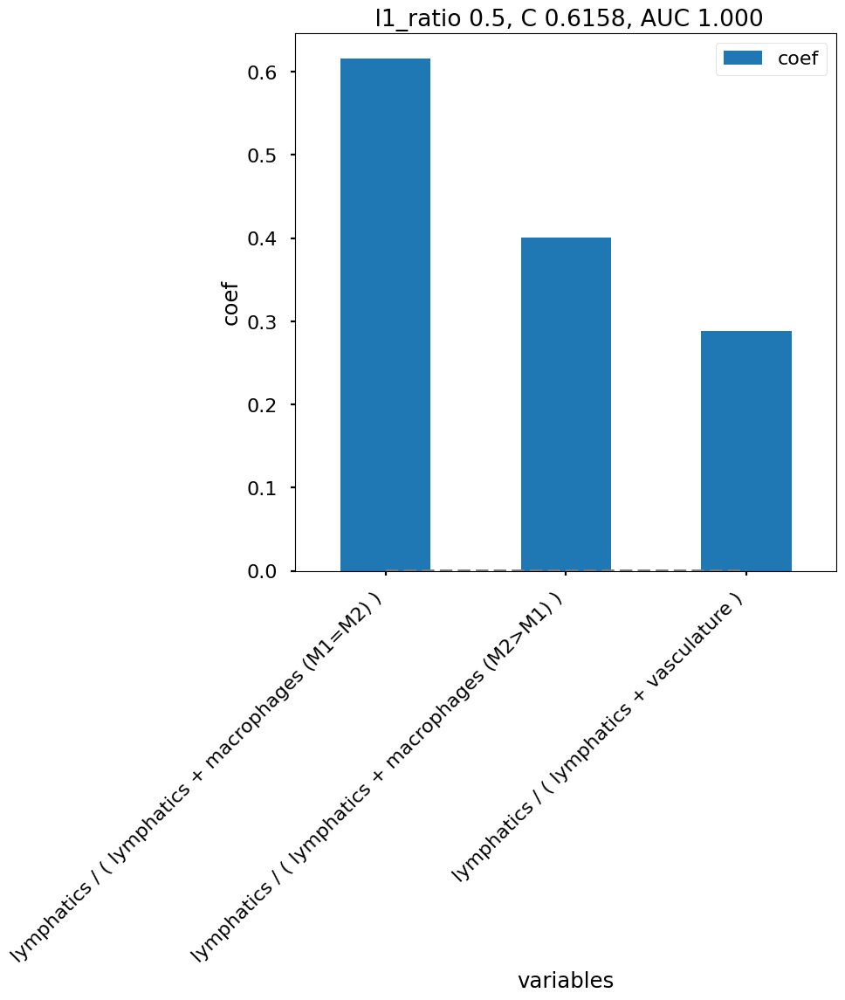

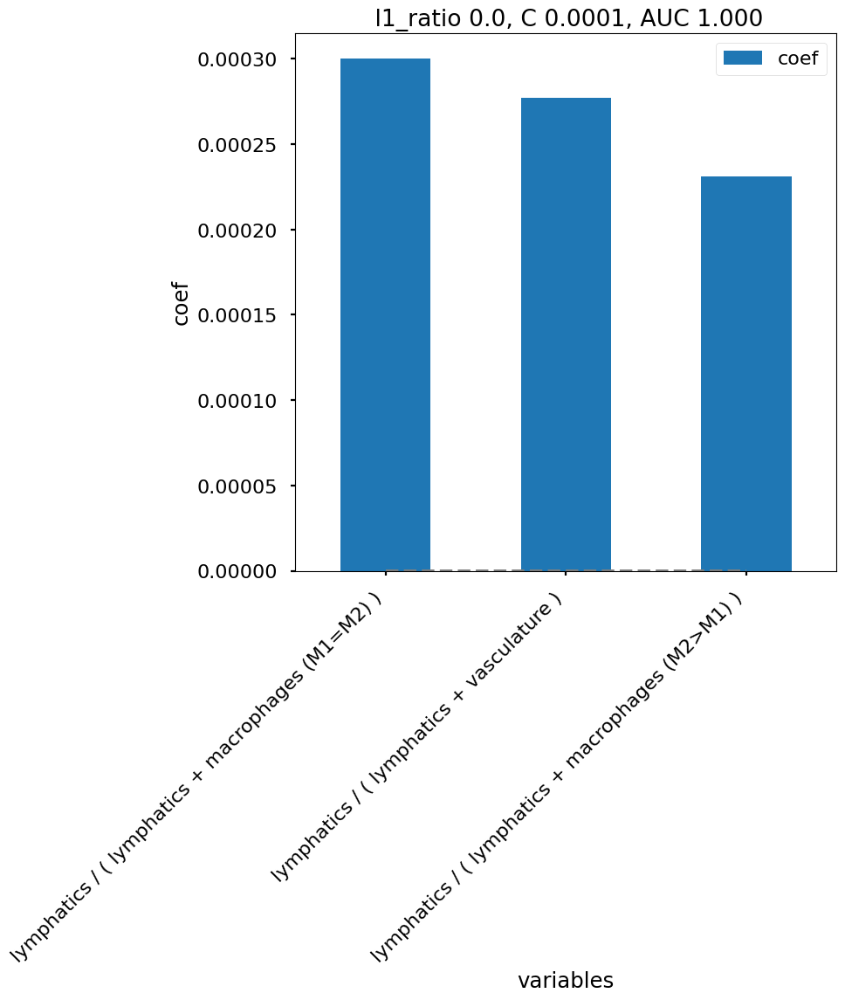

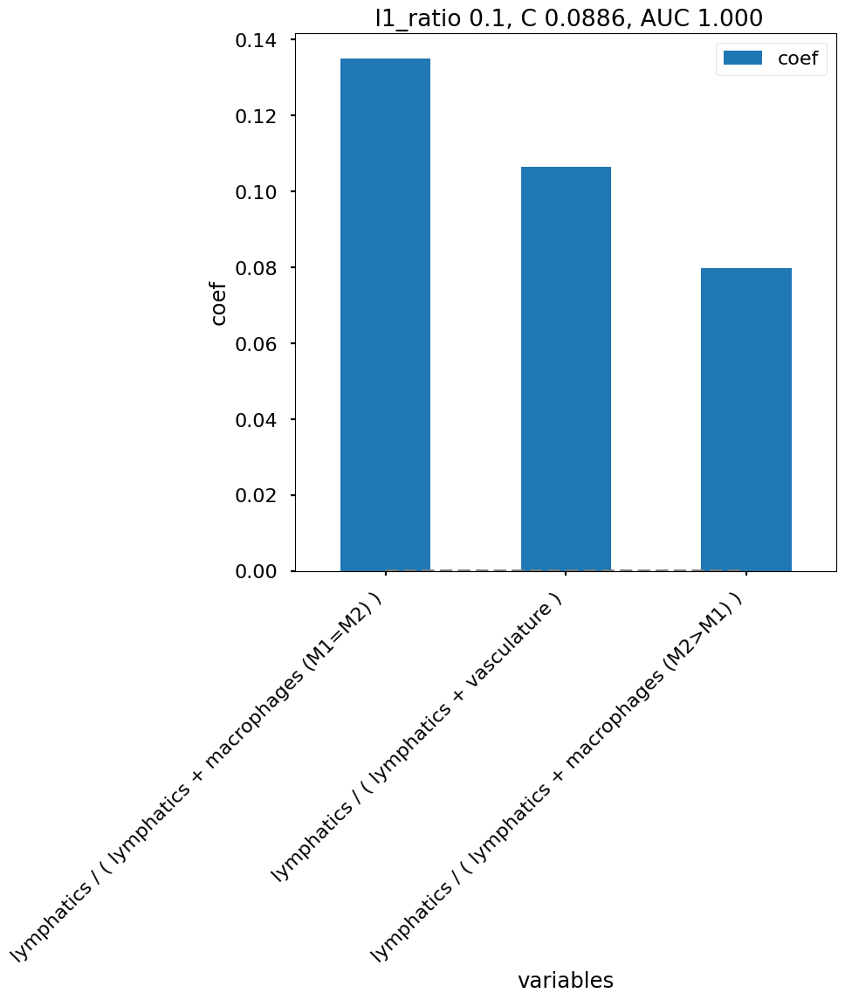

In [124]:
# Train ML model with best variables only

models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    save_plot_figures=True,
    dir_save=save_dir,
    str_prefix=f'{fig_step}_on_ratios2_selected_',
    )

### Second order of cell types ratios

In [125]:
# `find_DE_markers` can make composite variables, but we do it beforehand to reuse them
composed_variables = mosna.make_composed_variables(prop_types, method='ratio', order=2)
prop_types_comp = pd.concat([prop_types, composed_variables], axis=1)
pvals = mosna.find_DE_markers(prop_types_comp, group_ref=1, group_tgt=2, group_var=group_col)

In [126]:
pvals.head(20)

,pval,pval_corr
(lymphatics / macrophages (M2>M1)) / (mast cells / tumor cells),0.002331,0.615098
(lymphatics / macrophages (M1=M2)) / (macrophages (M2>M1) / tumor cells),0.002331,0.615098
lymphatics / macrophages (M1=M2),0.004079,0.615098
(CD4+ T cells / macrophages (M2>M1)) / (mast cells / tumor cells),0.004662,0.615098
(lymphatics / macrophages (M2>M1)) / (stroma / tumor cells),0.006993,0.615098
(lymphatics / macrophages (M1>M2)) / (macrophages (M2>M1) / tumor cells),0.006993,0.615098
(Tregs / lymphatics) / (macrophages (M1>M2) / stroma),0.011072,0.615098
(Tregs / lymphatics) / (macrophages (M1>M2) / vasculature),0.011072,0.615098
(CD8+ T cells / Tregs) / (nerves / tumor cells),0.013986,0.615098
(CD4+ T cells / macrophages (M2>M1)) / (mast cells / vasculature),0.013986,0.615098


In [127]:
n_sig = (pvals['pval'] < 0.05).sum()
print(f'There are {n_sig} significant variables (non corrected)')

There are 58 significant variables (non corrected)


The first variables related to cell types proportions are composed variables of the 2nd order (ratio of ratios), only `lymphatics / macrophages (M1=M2)` appear in the simpler composed variables, but all corrected pvalues are > 0.05. This is because mosna produced *a lot* of composed variables.

There are 58 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

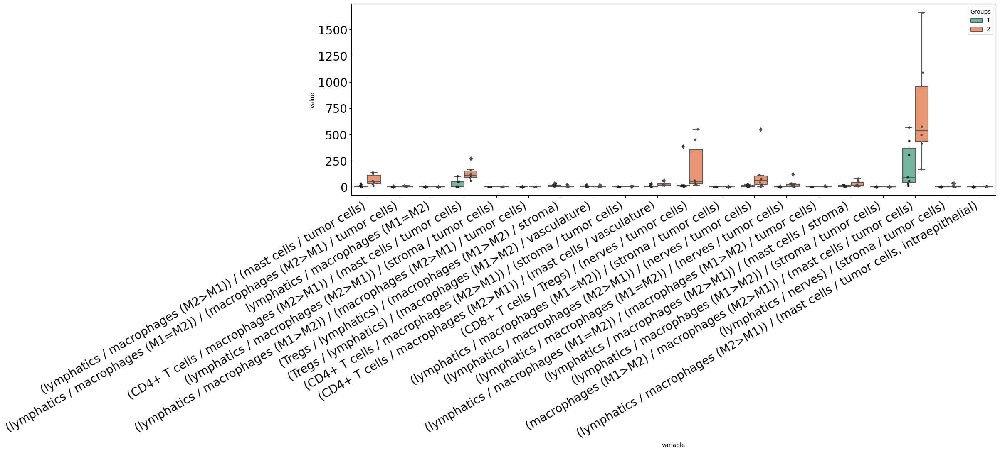

In [75]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

Some variables hide the distribution of other variables by their much larger range, we can exclude them to better see the other variables:

There are 58 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

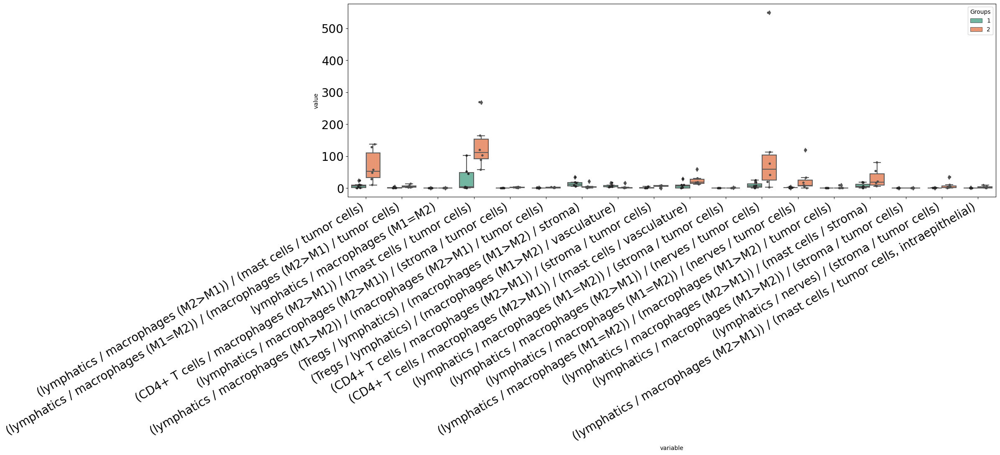

In [76]:
exclude_vars = [
    '(macrophages (M1>M2) / macrophages (M2>M1)) / (mast cells / tumor cells)',
    '(CD8+ T cells / Tregs) / (nerves / tumor cells)',
]
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    exclude_vars=exclude_vars,
    )

In [77]:
# we need to clean-up data for further analyses and visualizations
prop_types_comp_cleaned, select_finite = mosna.clean_data(
    prop_types_comp, 
    method='mixed',
    thresh=0.9,
    )

There are 24017 non finite values (27.6%)
Imputing data


In [78]:
pvals = mosna.find_DE_markers(prop_types_comp_cleaned, group_ref=1, group_tgt=2, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)

In [79]:
n_sig = (pvals['pval'] < 0.05).sum()
print(f'There are {n_sig} significant variables (non corrected) after data imputation')

There are 260 significant variables (non corrected) after data imputation


In [80]:
pd.set_option('display.max_rows', None)
pvals.head(20)

,pval,pval_corr
(CD8+ T cells / mast cells) / (plasma cells / tumor cells),0.002331,0.635998
(lymphatics / macrophages (M1=M2)) / (plasma cells / tumor cells),0.002331,0.635998
lymphatics / macrophages (M1=M2),0.004079,0.635998
(lymphatics / mast cells) / (plasma cells / tumor cells),0.004079,0.635998
(CD4+ T cells / mast cells) / (plasma cells / tumor cells),0.006993,0.635998
(CD8+ T cells / macrophages (M1=M2)) / (plasma cells / tumor cells),0.006993,0.635998
(CD8+ T cells / mast cells) / (neutrophils / tumor cells),0.006993,0.635998
(lymphatics / macrophages (M1=M2)) / (macrophages (M2>M1) / tumor cells),0.006993,0.635998
(CD4+ T cells / macrophages (M2>M1)) / (mast cells / tumor cells),0.011072,0.635998
(macrophages (M1>M2) / mast cells) / (plasma cells / tumor cells),0.011072,0.635998


In [81]:
pd.set_option('display.max_rows', 10)

There are 260 significant variables in `pval`


/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/Alexis/.pyenv/versions/3.10.13/envs/scverse/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: 

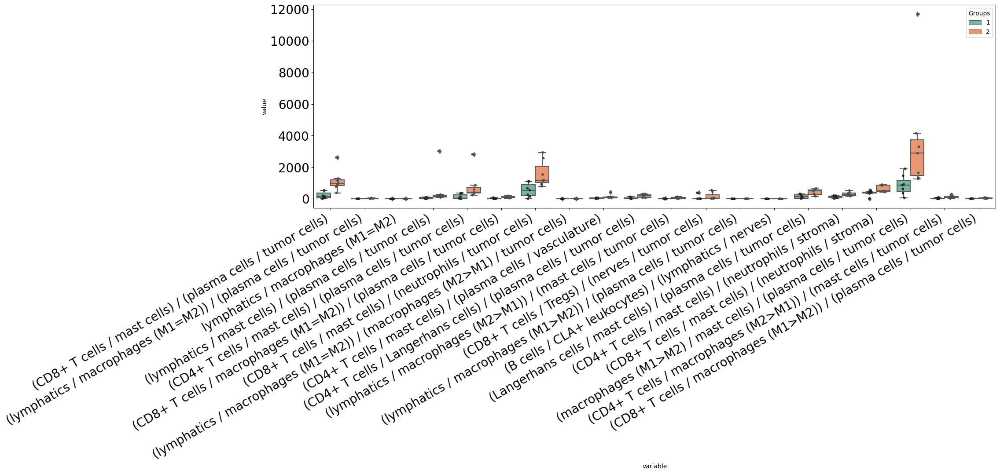

In [82]:
fig, ax = mosna.plot_distrib_groups(
    prop_types_comp_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    )

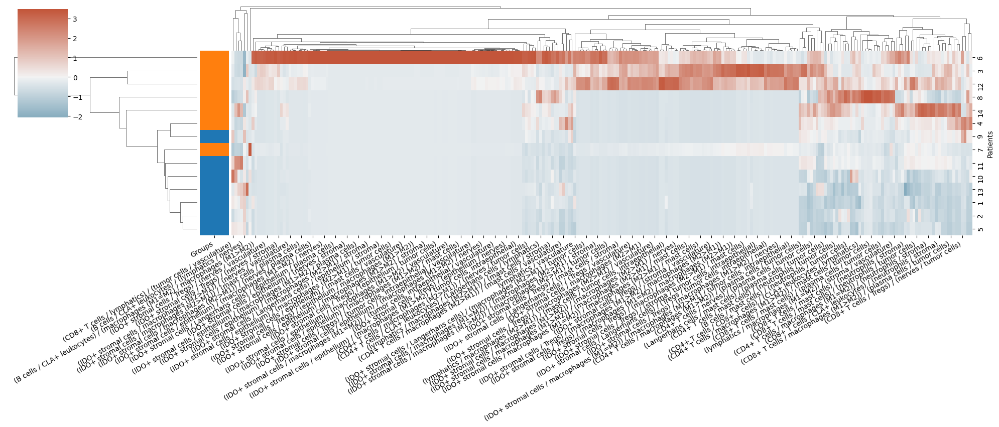

In [ ]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    figsize=(20, 12),
    );

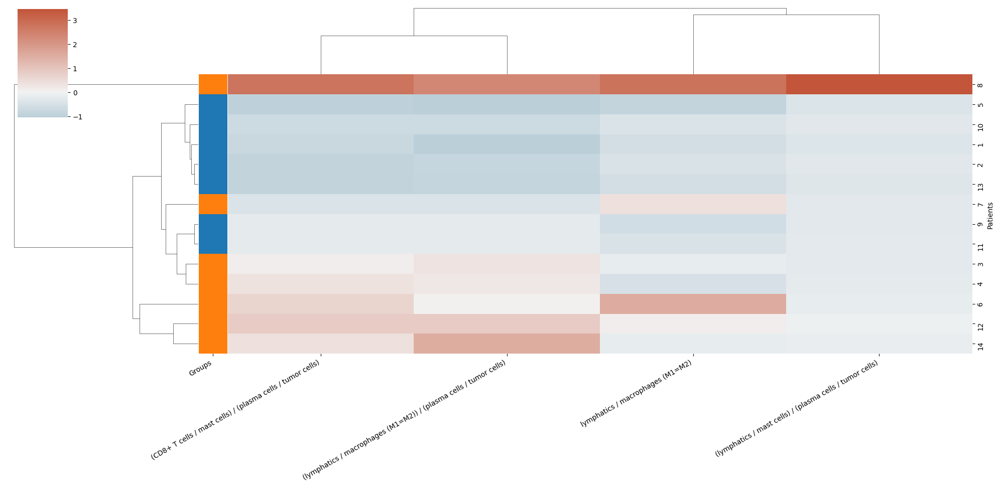

In [85]:
best_pval_names = pvals.loc[pvals['pval'] < 0.005, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(40).index
mosna.plot_heatmap(
    prop_types_comp_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=1,
    figsize=(20, 12),
    );

By selecting the variables with p-values under 5%, although their corresponding corrected p-values are not significant, we can notice a much better separation between patients groups.  
We must be careful though: we have computed a lot of composed variables, and selected those who happened to have the best p-values.

Training took 3.398s


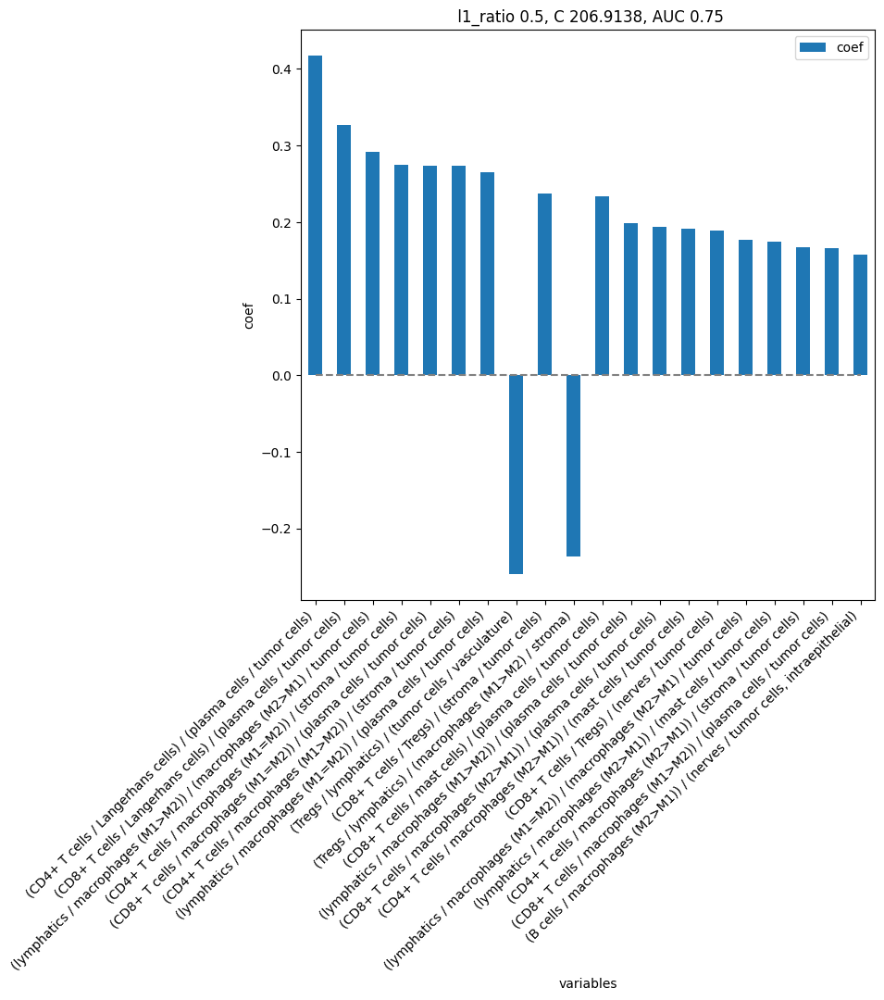

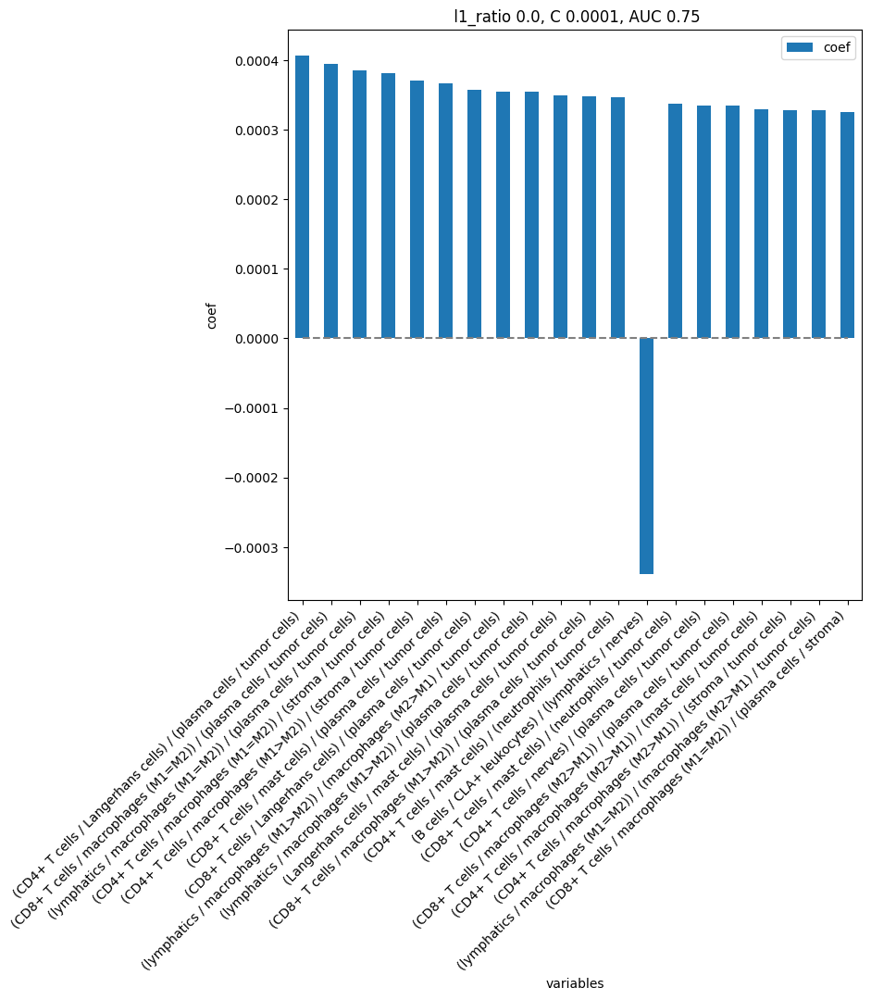

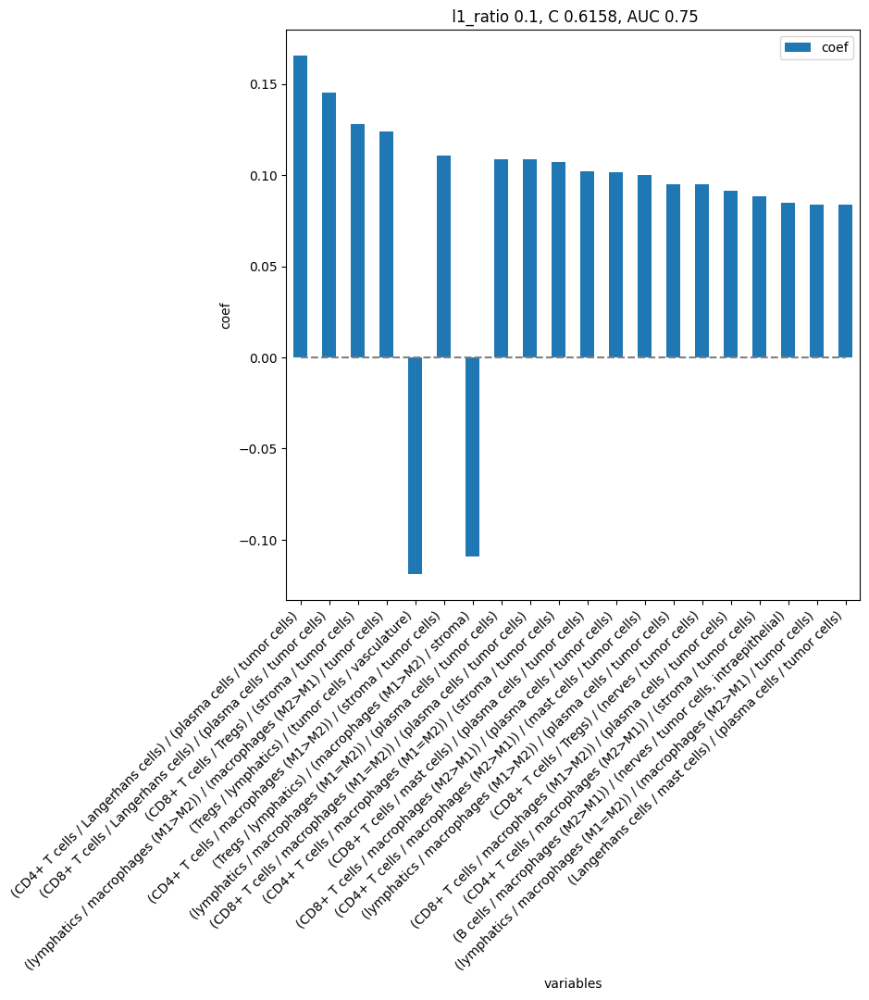

In [88]:
models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names], 
    y_name=group_col,
    col_drop=[patient_col], 
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    save_plot_figures=True,
    dir_save=save_dir,
    str_prefix=f'{fig_step}_on_ratios_of_ratios_',
    )

In [89]:
best_pval_names = pvals.loc[pvals['pval'] < 0.005, :].index

Training took 2.348s


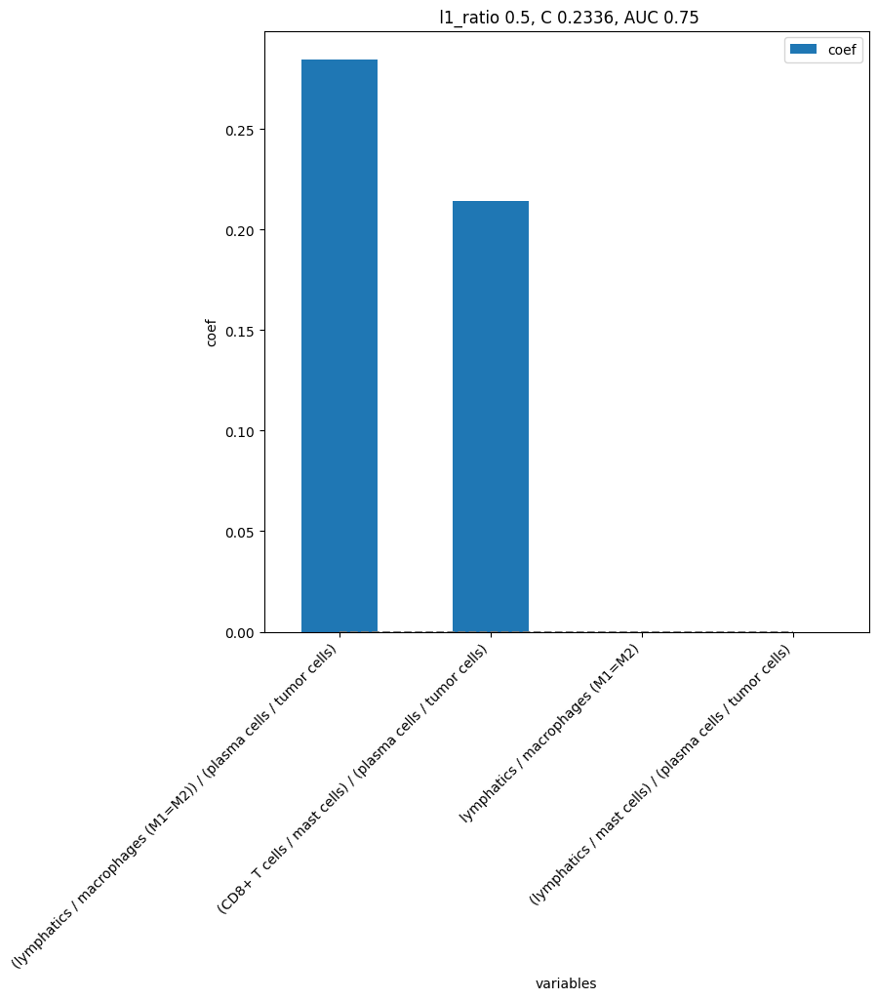

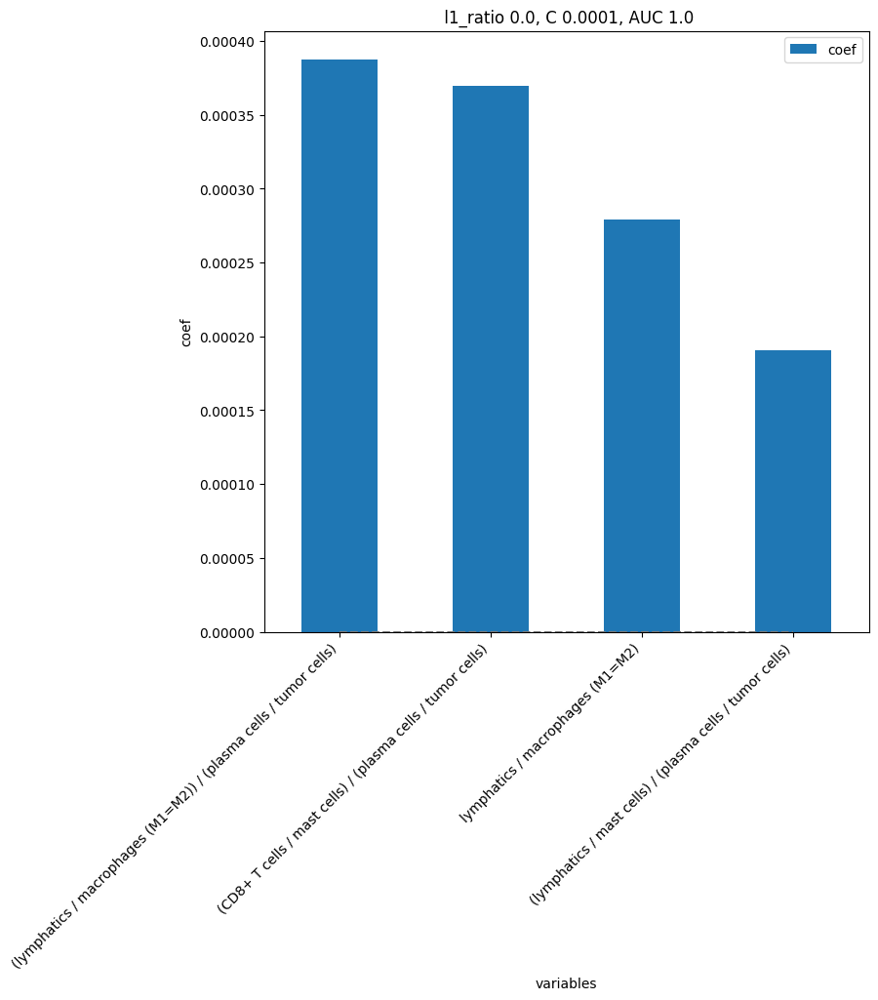

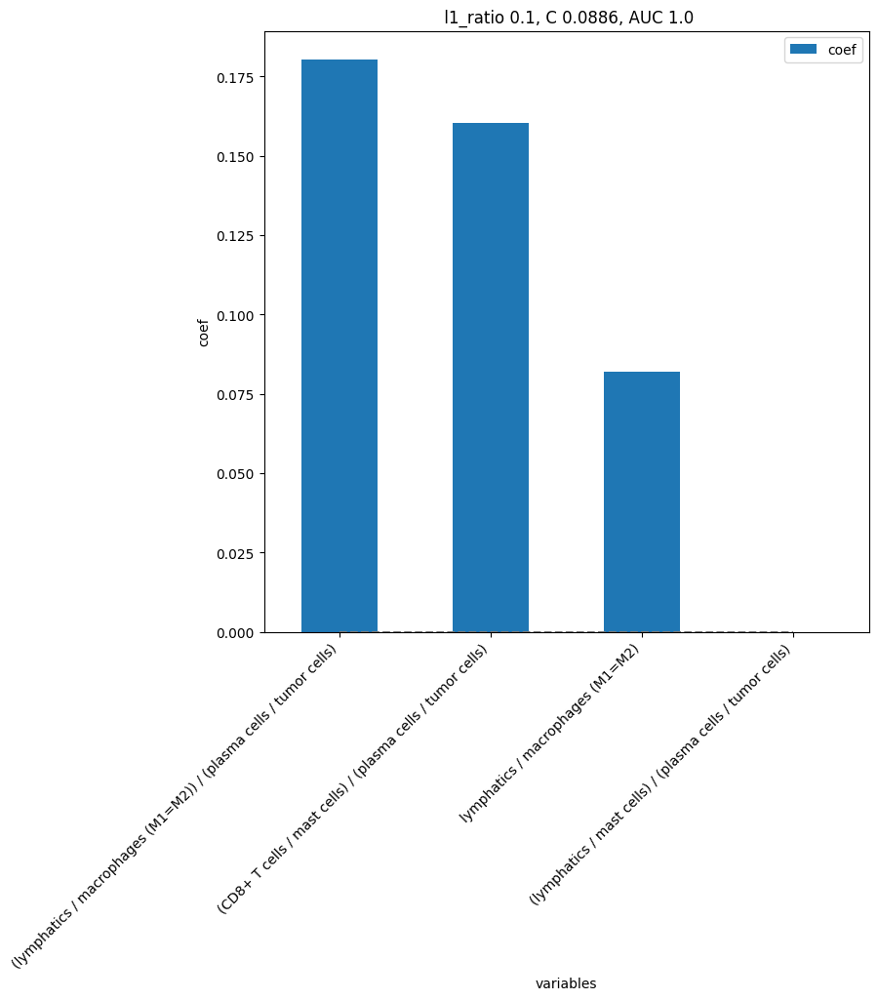

In [92]:
models = mosna.logistic_regression(
    prop_types_comp_cleaned[best_pval_names], 
    y_name=group_col,
    col_drop=[patient_col], 
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    save_plot_figures=True,
    dir_save=save_dir,
    str_prefix=f'{fig_step}_on_ratios_of_ratios_selected_',
    )

### Marker-positive cells proportions

In [93]:
def highlight_under(s, thresh=0.05, color='darkorange'):
    '''
    highlight values that are under a threshold
    '''
    is_under = s <= thresh
    attr = 'background-color: {}'.format(color)
    return [attr if v else '' for v in is_under]

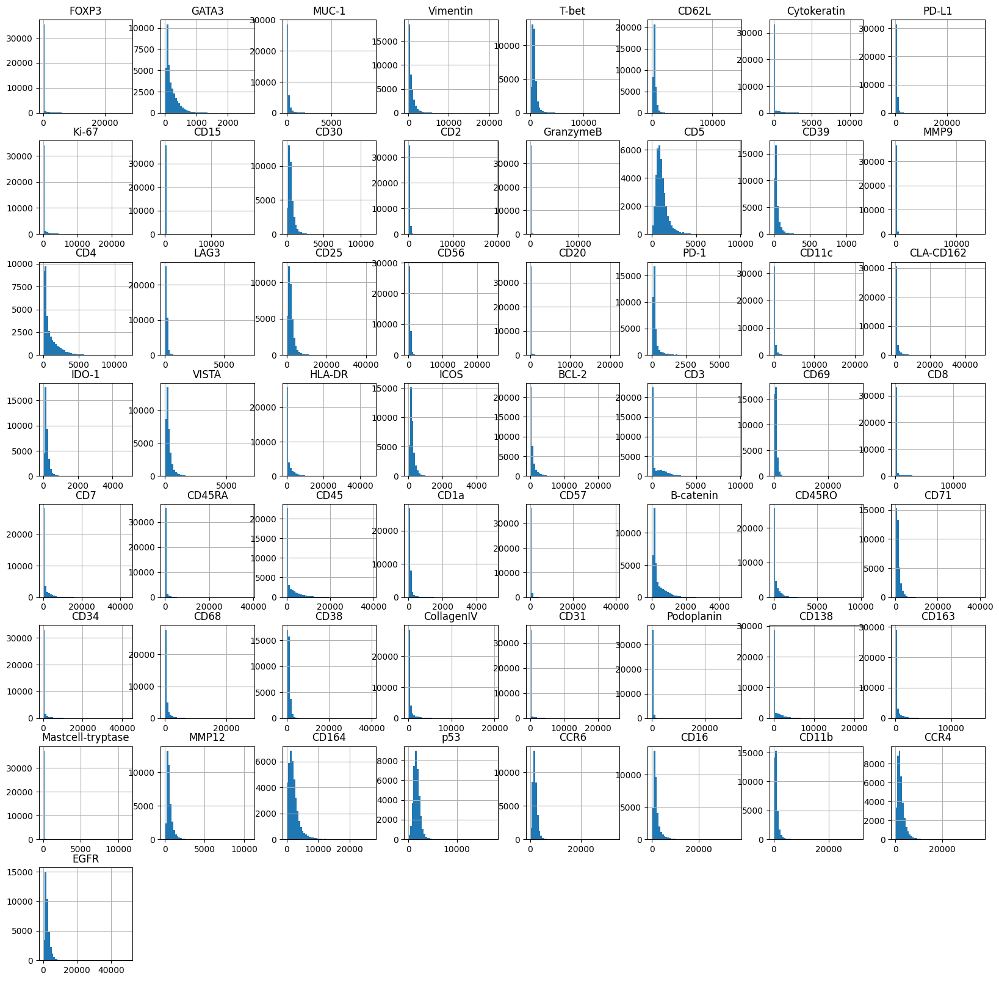

In [94]:
obj[marker_cols].hist(bins=50, figsize=(20, 20));

In [77]:
marker_thresh = {
    'FOXP3',
    'GATA3',
    'MUC-1',
    'Vimentin',
    'T-bet',
    'CD62L',
    'Cytokeratin',
    'PD-L1',
    'Ki-67',
    'CD15',
    'CD30',
    'CD2',
    'GranzymeB',
    'CD5',
    'CD39',
    'MMP9',
    'CD4',
    'LAG3',
    'CD25',
    'CD56',
    'CD20',
    'PD-1',
    'CD11c',
    'CLA-CD162',
    'IDO-1',
    'VISTA',
    'HLA-DR',
    'ICOS',
    'BCL-2',
    'CD3',
    'CD69',
    'CD8',
    'CD7',
    'CD45RA',
    'CD45',
    'CD1a',
    'CD57',
    'B-catenin',
    'CD45RO',
    'CD71',
    'CD34',
    'CD68',
    'CD38',
    'CollagenIV',
    'CD31',
    'Podoplanin',
    'CD138',
    'CD163',
    'Mastcell-tryptase',
    'MMP12',
    'CD164',
    'p53',
    'CCR6',
    'CD16',
    'CD11b',
    'CCR4',
    'EGFR'
}

In [78]:
# One needs to define a threshold for each marker, not done here.

We have seen that cell types proportions don't explain response of patient to therapy. But maybe interactions between cell types play a role in response?  
To answer this question we will look at the *mixing matrix* and *assortativity* of tissue networks.  

## Cell types interactions

We compute cell types interactions per sample to aggregate latter per patient or condition.

###  Assortativity and Mixing Matrix

#### Computation of assortativity

In [ ]:
grouping = sample_col
n_shuffle = 500
load_dir = reconst_dir
dir_assort = load_dir / "assortativity"
filename = dir_assort / f'network_interactions_stats_grouping-{grouping}_n_shuffle-{n_shuffle}.csv'

if RUN_LONG or not filename.exists():
    print("Computing z-scored assortativity")
    start = time()
    net_stats = mosna.groups_assort_mixmat(
        net_dir=reconst_dir, 
        attributes_col=pheno_col, 
        make_onehot=False,
        id_level_1='patient',
        id_level_2='sample', 
        extension='parquet',
        n_shuffle=n_shuffle,
        parallel_groups='max',  # or False
        memory_limit='2 GB',
        save_intermediate_results=True)
    end = time()
    duration = end - start
    print(f"Assortativity took {duration:.3f}s for n_suffle {n_shuffle}")

    net_stats.index = net_stats['id']
    net_stats.drop(columns=['id'], inplace=True)

    if not os.path.exists(dir_assort):
        os.makedirs(dir_assort)
    net_stats.to_csv(filename)
else:
    print("Loading z-scored assortativity")
    net_stats = pd.read_csv(filename, index_col=0)

fig_step = '03_assortativity_per_sample'

In [178]:
pd.set_option('display.max_rows', 10)
net_stats

,# total,% B cells,% CD4+ T cells,% CD8+ T cells,% Langerhans cells,% Tregs,% epithelium,% lymphatics,% macrophages (M1=M2),% macrophages (M1>M2),...,"macrophages (M1>M2) - DCs, CD11c+ Z","macrophages (M2>M1) - DCs, CD11c+ Z","mast cells - DCs, CD11c+ Z","nerves - DCs, CD11c+ Z","neutrophils - DCs, CD11c+ Z","plasma cells - DCs, CD11c+ Z","stroma - DCs, CD11c+ Z","tumor cells - DCs, CD11c+ Z","tumor cells, intraepithelial - DCs, CD11c+ Z","vasculature - DCs, CD11c+ Z"
id,,,,,,,,,,,,,,,,,,,,,
patient-9_sample-reg036,618,0.001618,0.006472,0.033981,0.003236,0.003236,0.021036,0.006472,0.064725,0.097087,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-3_sample-reg009,2334,0.000857,0.046701,0.048843,0.033419,0.022708,0.416881,0.002999,0.035990,0.105827,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-12_sample-reg045,1914,0.005225,0.017241,0.037095,0.022466,0.063218,0.379833,0.007315,0.035005,0.088297,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-14_sample-reg058,1854,0.003776,0.009709,0.014563,0.012406,0.211435,0.242718,0.010248,0.047465,0.096009,...,2.057483,-0.204124,-0.238919,-0.100504,NaN,-0.063372,2.869998,-0.217731,-0.164895,-0.551677
patient-4_sample-reg013,1765,0.086686,0.008499,0.015864,0.003399,0.002833,0.265156,0.003966,0.027762,0.060623,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
patient-2_sample-reg005,112,NaN,NaN,NaN,NaN,NaN,0.017857,NaN,0.035714,0.035714,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-10_sample-reg040,1317,0.002278,0.004556,0.024298,0.009112,0.044799,0.294609,0.005315,0.132118,0.114655,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-6_sample-reg022,2325,0.013333,0.045161,0.138065,0.022366,0.080860,0.003441,0.019355,0.031398,0.167742,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Example of Mixing Matrix

In [179]:
sample_id = 'patient-1_sample-reg001'
raw_cols = [x for x in net_stats.columns if x.endswith('RAW') and not x.startswith('assort')]
z_cols = [x for x in net_stats.columns if x.endswith('Z') and not x.startswith('assort')]

mixmat_raw = mosna.series_to_mixmat(net_stats.loc[sample_id, raw_cols], discard=' RAW').astype(float)
mixmat_z = mosna.series_to_mixmat(net_stats.loc[sample_id, z_cols], discard=' Z').astype(float)
assort_raw = net_stats.loc[sample_id, "assort"]
assort_z = net_stats.loc[sample_id, "assort Z"]

# select_cols = np.logical_and(mixmat_raw.isna(axis=0) == 0, mixmat_z.isna(axis=0) == 0)

Raw assortativity by cell types: 0.13
Z-scored assortativity by cell types: 24.19


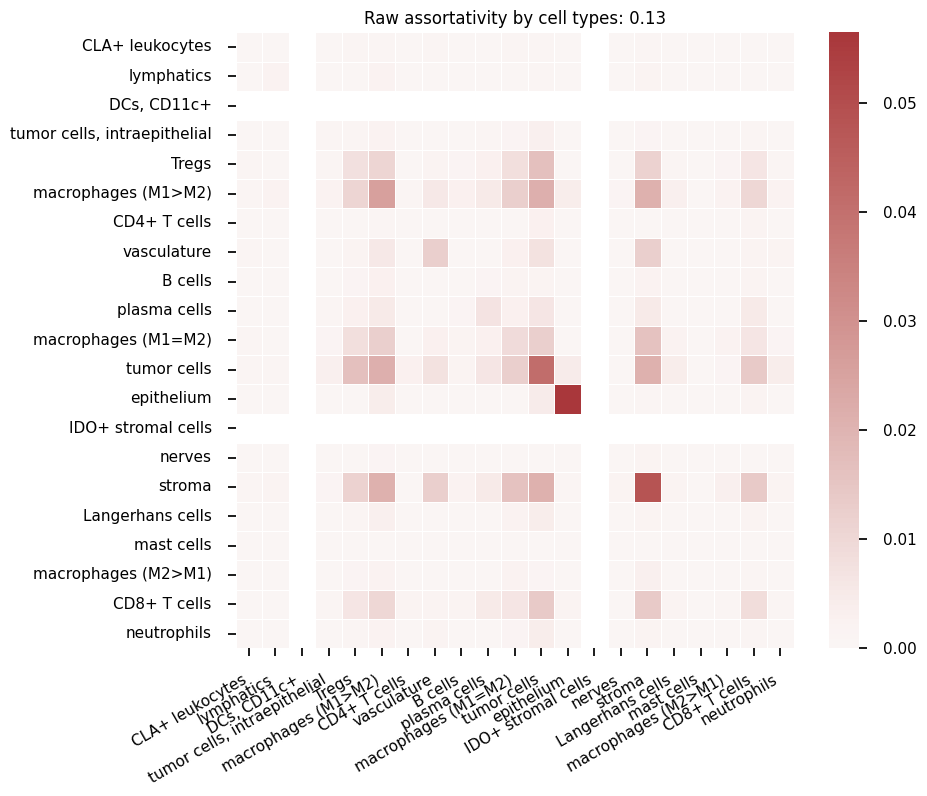

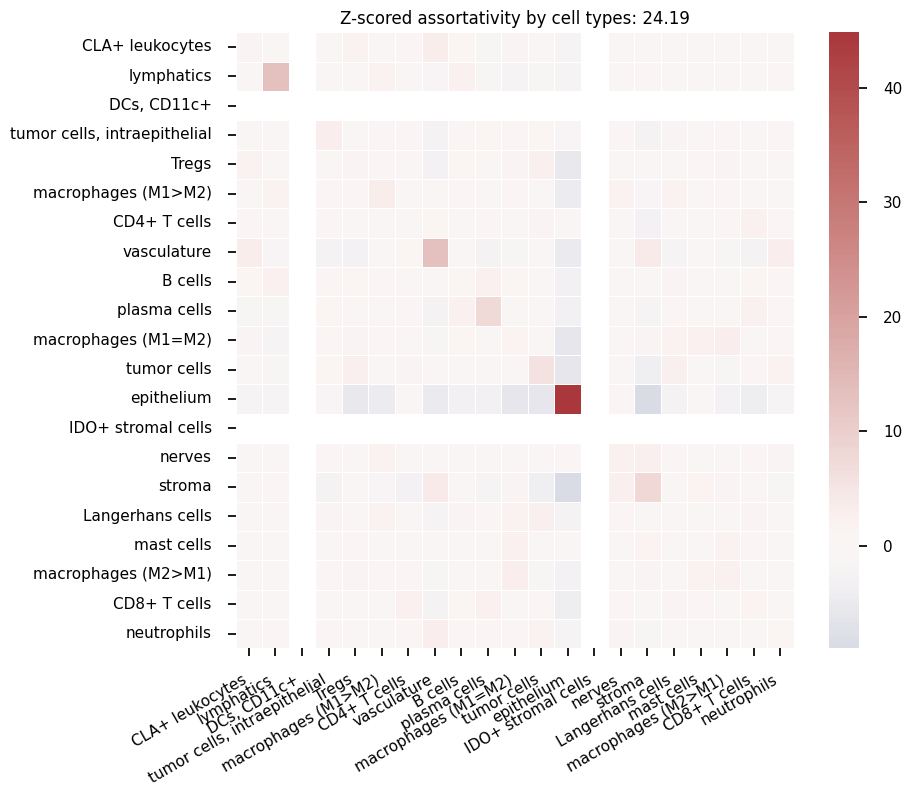

In [180]:
# sns.set_context('talk')
sns.set_context("notebook")
figsize = (9, 8)

title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_raw, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.xticks(rotation=30, ha='right');
# plt.xticks(rotation=30, ha='right', fontsize=20);
# plt.yticks(fontsize=20);
plt.savefig(save_dir / f"{fig_step}_assortativity_raw_sample-{sample_id}", bbox_inches='tight', facecolor='white')

title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_z, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.savefig(save_dir / f"{fig_step}_assortativity_z-scored_sample-{sample_id}", bbox_inches='tight', facecolor='white')

Raw assortativity by cell types: 0.13
Z-scored assortativity by cell types: 24.19


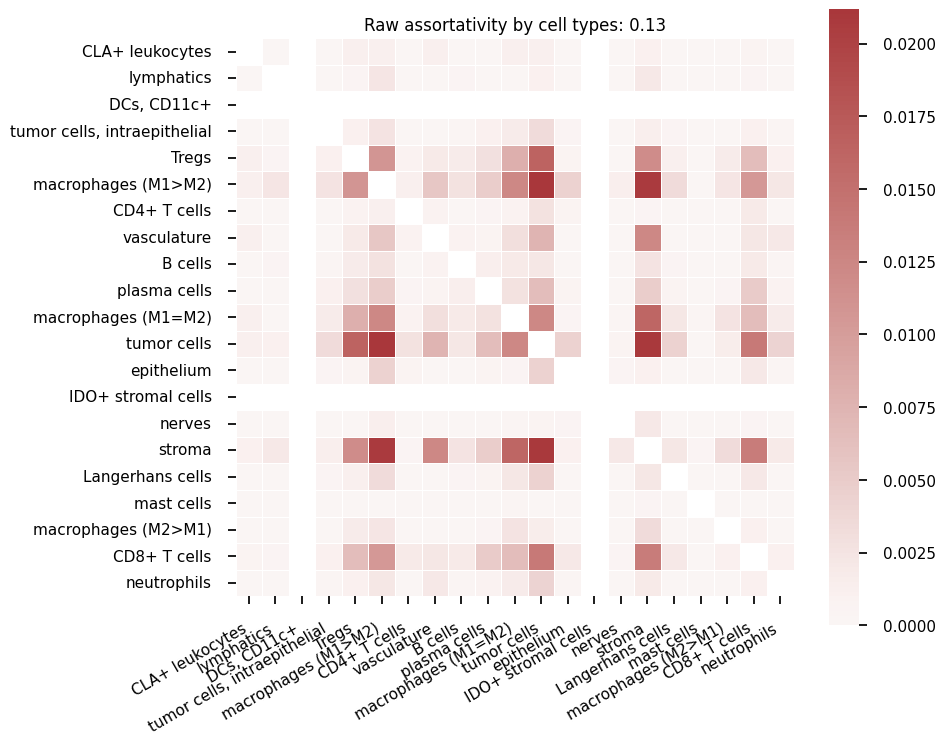

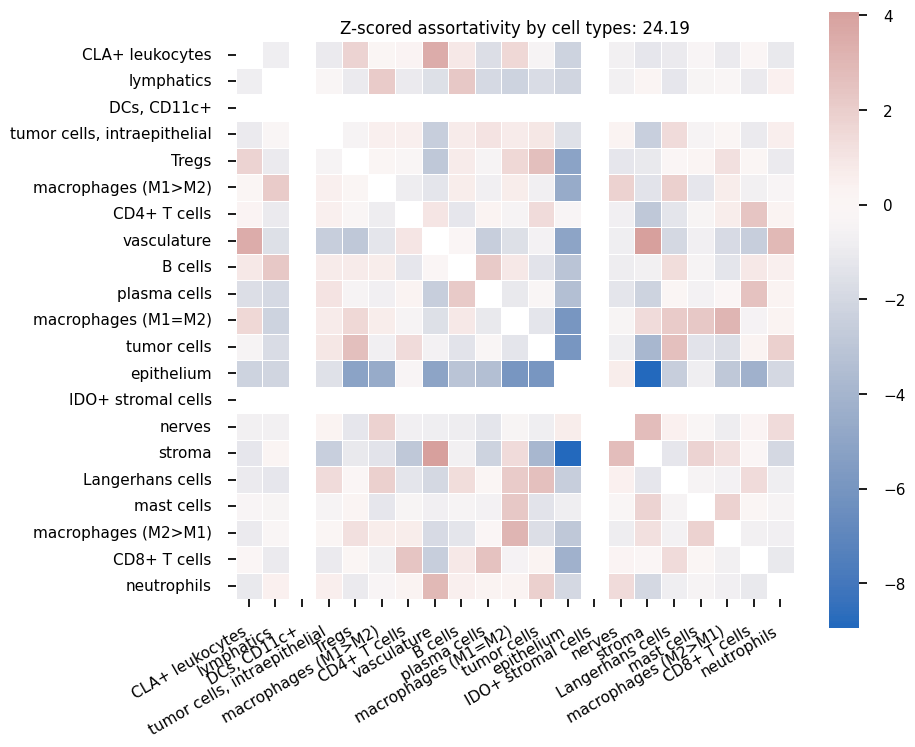

In [181]:
# Hide diagonal
# # Generate a mask for the upper triangle
# mask = np.triu(np.ones_like(mixmat_raw, dtype=bool))
# Generate a mask for the diagonal
mask = np.eye(mixmat_raw.shape[0], dtype=bool)

# sns.set_context('talk')
sns.set_context("notebook")
figsize = (9, 8)

title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_raw, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.xticks(rotation=30, ha='right');#, fontsize=20);
# plt.yticks(fontsize=20);
plt.savefig(save_dir / f"{fig_step}_assortativity_raw_sample-{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_z, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=30, ha='right');
plt.savefig(save_dir / f"{fig_step}_assortativity_z-scored_sample-{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

In [182]:
if RUN_LONG:
    for sample_id in net_stats.index:

        raw_cols = [x for x in net_stats.columns if x.endswith('RAW') and not x.startswith('assort')]
        z_cols = [x for x in net_stats.columns if x.endswith('Z') and not x.startswith('assort')]

        mixmat_raw = mosna.series_to_mixmat(net_stats.loc[sample_id, raw_cols], discard=' RAW').astype(float)
        mixmat_z = mosna.series_to_mixmat(net_stats.loc[sample_id, z_cols], discard=' Z').astype(float)
        assort_raw = net_stats.loc[sample_id, "assort"]
        assort_z = net_stats.loc[sample_id, "assort Z"]

        # sns.set_context('talk')
        sns.set_context("notebook")
        figsize = (9, 8)

        title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_raw, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.xticks(rotation=30, ha='right');
        # plt.xticks(rotation=30, ha='right', fontsize=20);
        # plt.yticks(fontsize=20);
        plt.savefig(save_dir / f"assortativity_raw_{sample_id}", bbox_inches='tight', facecolor='white')

        title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_z, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.savefig(save_dir / "assortativity_z-scored_{sample_id}", bbox_inches='tight', facecolor='white')

        # Hide diagonal
        # # Generate a mask for the upper triangle
        # mask = np.triu(np.ones_like(mixmat_raw, dtype=bool))
        # Generate a mask for the diagonal
        mask = np.eye(mixmat_raw.shape[0], dtype=bool)

        # sns.set_context('talk')
        sns.set_context("notebook")
        figsize = (9, 8)

        title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_raw, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.xticks(rotation=30, ha='right');#, fontsize=20);
        # plt.yticks(fontsize=20);
        plt.savefig(save_dir / f"assortativity_raw_{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

        title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
        print(title)
        f, ax = plt.subplots(figsize=figsize)
        sns.heatmap(mixmat_z, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
        ax.set_title(title)
        plt.xticks(rotation=30, ha='right');
        plt.savefig(save_dir / "assortativity_z-scored_{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

After removing highly self-assortative cell-types, we can notice that ~~most cell types tend to avoid other cell types in this sample.~~

#### Assortativity and patients response

In [183]:
z_cols = [x for x in net_stats.columns if x.endswith('Z')]
z_net_stats = net_stats[z_cols]

In [184]:
z_net_stats

,assort Z,B cells - B cells Z,CD4+ T cells - B cells Z,CD4+ T cells - CD4+ T cells Z,CD8+ T cells - B cells Z,CD8+ T cells - CD4+ T cells Z,CD8+ T cells - CD8+ T cells Z,Langerhans cells - B cells Z,Langerhans cells - CD4+ T cells Z,Langerhans cells - CD8+ T cells Z,...,"macrophages (M1>M2) - DCs, CD11c+ Z","macrophages (M2>M1) - DCs, CD11c+ Z","mast cells - DCs, CD11c+ Z","nerves - DCs, CD11c+ Z","neutrophils - DCs, CD11c+ Z","plasma cells - DCs, CD11c+ Z","stroma - DCs, CD11c+ Z","tumor cells - DCs, CD11c+ Z","tumor cells, intraepithelial - DCs, CD11c+ Z","vasculature - DCs, CD11c+ Z"
id,,,,,,,,,,,,,,,,,,,,,
patient-9_sample-reg036,15.638028,NaN,-0.182989,-0.214535,2.094064,0.450974,1.776368,-0.100504,-0.243561,-0.554657,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-3_sample-reg009,51.712912,NaN,-0.758091,6.070553,0.576871,1.009794,5.545749,-0.677016,0.988686,1.971417,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-12_sample-reg045,50.355990,2.611957,-1.003352,1.138473,-0.767088,2.832835,4.136948,1.719362,1.038611,4.048322,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-14_sample-reg058,47.697650,-0.278960,-0.669385,0.683198,2.127269,1.286638,5.010030,0.882442,-1.222268,0.080840,...,2.057483,-0.204124,-0.238919,-0.100504,NaN,-0.063372,2.869998,-0.217731,-0.164895,-0.551677
patient-4_sample-reg013,58.109504,24.442070,1.563820,3.204244,-2.064984,0.585197,0.659895,0.794877,1.301955,0.737113,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
patient-2_sample-reg005,3.043484,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-10_sample-reg040,47.373121,-0.156813,-0.261973,-0.261488,0.762673,0.250091,5.948726,-0.377047,1.335255,0.333333,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-6_sample-reg022,16.117764,-1.043565,0.753801,1.896369,4.081195,4.289645,1.403922,-0.979068,-0.647062,0.018535,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [185]:
# Have a look at nan values
for name, value in z_net_stats.isna().sum().items():
    print(name, ' ' * (52- len(name)), value)

assort Z                                              0
B cells - B cells Z                                   10
CD4+ T cells - B cells Z                              8
CD4+ T cells - CD4+ T cells Z                         6
CD8+ T cells - B cells Z                              7
CD8+ T cells - CD4+ T cells Z                         6
CD8+ T cells - CD8+ T cells Z                         5
Langerhans cells - B cells Z                          7
Langerhans cells - CD4+ T cells Z                     6
Langerhans cells - CD8+ T cells Z                     4
Langerhans cells - Langerhans cells Z                 4
Tregs - B cells Z                                     7
Tregs - CD4+ T cells Z                                6
Tregs - CD8+ T cells Z                                4
Tregs - Langerhans cells Z                            3
Tregs - Tregs Z                                       4
epithelium - B cells Z                                7
epithelium - CD4+ T cells Z                    

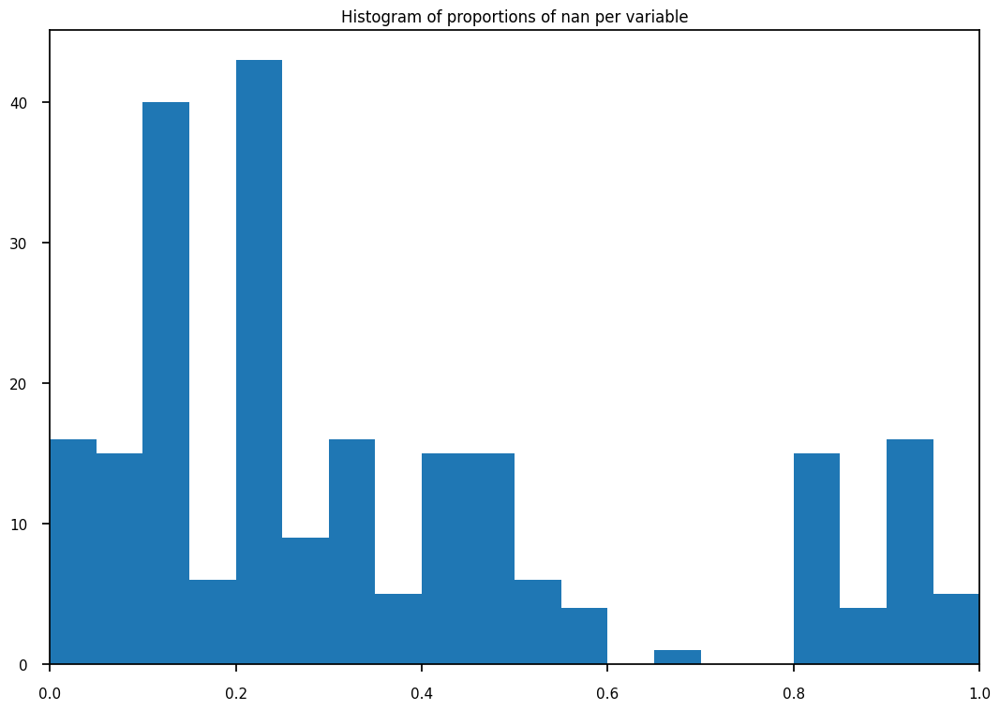

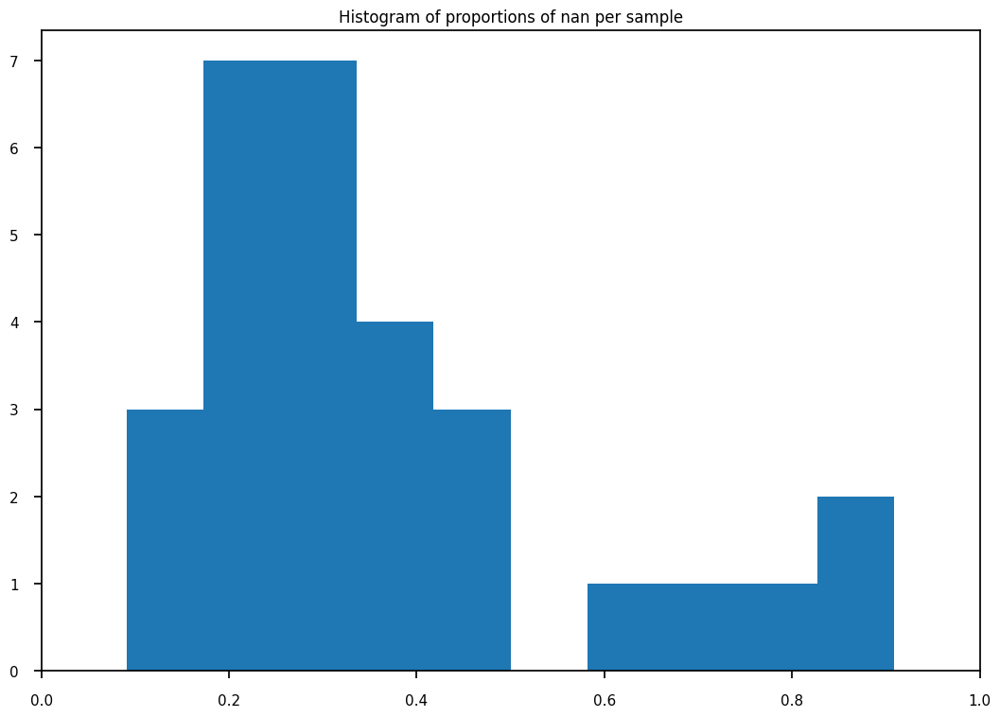

In [186]:
plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0], bins=20);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

There are some nan values due to interactions between rare cell types that never happened.  
We can have a first look at the sample, but it would be more informative to have a look at samples before therapy, grouping them per patient.

Before dropping variables z_net_stats shape: (29, 231)
There are 2373 non finite values (35.4%)
Final z_net_stats shape: (29, 150)
There are 81 variables discarded


/home/alexis/Pro/Postdoc_CRCT/Projects/mosna_benchmark/mosna/mosna.py:2683: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[to_nan] = np.nan
/home/alexis/Pro/Postdoc_CRCT/Projects/mosna_benchmark/mosna/mosna.py:2683: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[to_nan] = np.nan


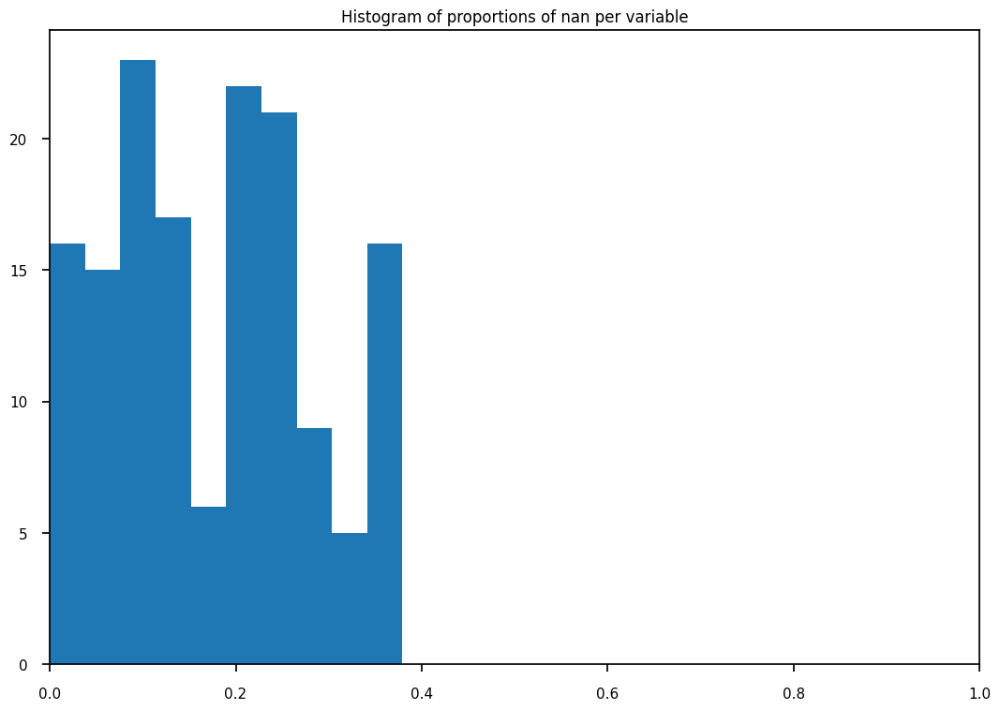

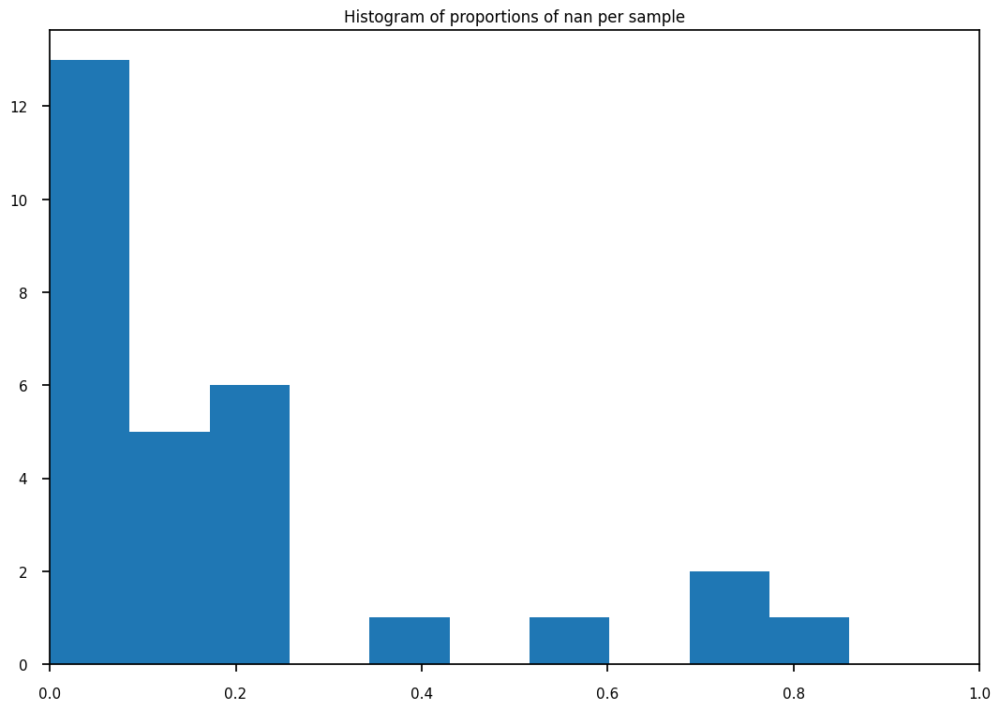

In [187]:
print("Before dropping variables z_net_stats shape:", z_net_stats.shape)

# drop columns
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.4,
    axis=0,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} variables discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping samples z_net_stats shape: (29, 150)
There are 760 non finite values (17.5%)
Final z_net_stats shape: (25, 150)
There are 4 observations discarded


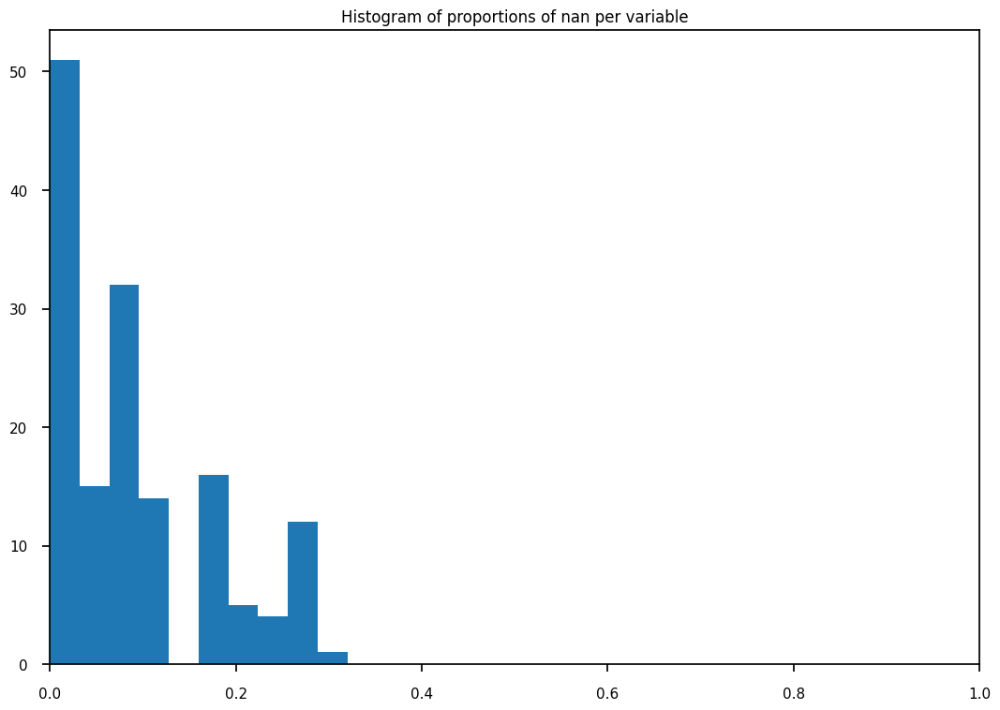

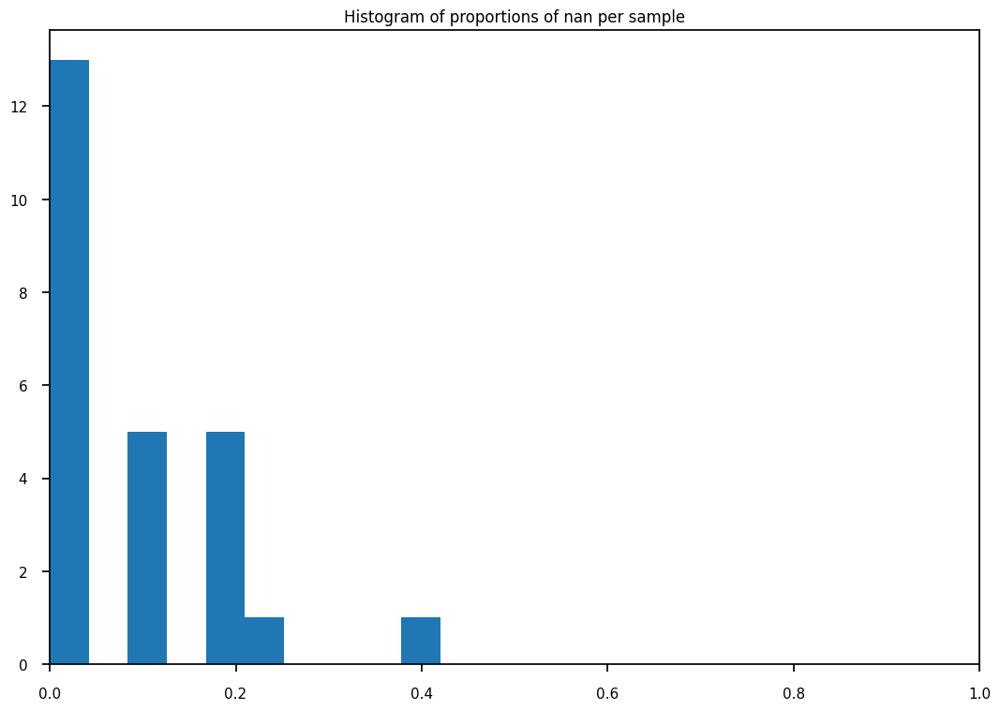

In [188]:
print("Before dropping samples z_net_stats shape:", z_net_stats.shape)

# drop samples
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.5,
    axis=1,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} observations discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

In [189]:
# impute non finite values in data for further analyses and visualizations
z_net_stats_cleaned, select_finite = mosna.clean_data(
    z_net_stats, 
    method='mixed',
    thresh=0.8,
    )
print("Final z_net_stats shape:", z_net_stats_cleaned.shape)

There are 326 non finite values (8.7%)
Imputing data
Final z_net_stats shape: (25, 150)


In [190]:
# Add back patient id to the network stats dataframe
def parse_patient(s):
    return s.split('_')[0][8:]

# if patient_col not in z_net_stats_cleaned.columns:
#     z_net_stats_cleaned[patient_col] = [parse_patient(s) for s in z_net_stats_cleaned.index]

# Add back sample id to the network stats dataframe
def parse_sample(s):
    return s.split('_')[1][7:]

# if sample_col not in z_net_stats_cleaned.columns:
#     z_net_stats_cleaned[sample_col] = [parse_sample(s) for s in z_net_stats_cleaned.index]
# z_net_stats_cleaned.index = z_net_stats_cleaned[sample_col]

z_net_stats_cleaned.index = [parse_sample(s) for s in z_net_stats_cleaned.index]
z_net_stats_cleaned.index.name = sample_col


In [191]:
z_net_stats_cleaned

,assort Z,B cells - B cells Z,CD4+ T cells - B cells Z,CD4+ T cells - CD4+ T cells Z,CD8+ T cells - B cells Z,CD8+ T cells - CD4+ T cells Z,CD8+ T cells - CD8+ T cells Z,Langerhans cells - B cells Z,Langerhans cells - CD4+ T cells Z,Langerhans cells - CD8+ T cells Z,...,"tumor cells, intraepithelial - macrophages (M1=M2) Z","tumor cells, intraepithelial - macrophages (M1>M2) Z","tumor cells, intraepithelial - macrophages (M2>M1) Z","tumor cells, intraepithelial - mast cells Z","tumor cells, intraepithelial - nerves Z","tumor cells, intraepithelial - stroma Z","tumor cells, intraepithelial - tumor cells Z","tumor cells, intraepithelial - tumor cells, intraepithelial Z",vasculature - plasma cells Z,"vasculature - tumor cells, intraepithelial Z"
FileName,,,,,,,,,,,,,,,,,,,,,
reg036,15.638028,0.131967,-0.182989,-0.214535,2.094064,0.450974,1.776368,-0.100504,-0.243561,-0.554657,...,-0.289486,0.152593,-0.162248,0.062686,0.850648,-0.569690,0.665444,-0.058831,-1.108444,-1.191784
reg009,51.712912,3.912258,-0.758091,6.070553,0.576871,1.009794,5.545749,-0.677016,0.988686,1.971417,...,-0.475406,0.600099,0.714401,2.239859,0.731007,-1.368285,-0.088305,1.044084,-0.526157,-2.004947
reg045,50.355990,2.611957,-1.003352,1.138473,-0.767088,2.832835,4.136948,1.719362,1.038611,4.048322,...,0.026618,1.255740,0.494464,1.097072,-0.414425,0.240981,1.275797,0.826754,-0.853301,-0.689825
reg058,47.697650,-0.278960,-0.669385,0.683198,2.127269,1.286638,5.010030,0.882442,-1.222268,0.080840,...,0.329180,-0.658858,4.209120,-0.575594,-0.225245,-1.518278,1.187869,-0.238919,-0.790011,-1.377108
reg013,58.109504,24.442070,1.563820,3.204244,-2.064984,0.585197,0.659895,0.794877,1.301955,0.737113,...,-0.609476,-0.855012,-0.163383,-0.142857,6.377042,-0.322816,0.920843,-0.044766,1.027835,-0.831252
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
reg021,15.761557,1.775415,-0.325513,0.358437,3.477269,-0.143025,3.822918,1.732606,0.235705,-1.259608,...,-0.880157,0.416937,0.435821,-0.538538,-0.361538,-2.842627,3.213455,-0.370250,-1.786568,-1.661358
reg040,47.373121,-0.156813,-0.261973,-0.261488,0.762673,0.250091,5.948726,-0.377047,1.335255,0.333333,...,0.193408,1.091358,1.161323,-0.294884,-0.175863,-1.867344,0.554009,-0.175863,3.118119,0.657354
reg022,16.117764,-1.043565,0.753801,1.896369,4.081195,4.289645,1.403922,-0.979068,-0.647062,0.018535,...,-1.330717,-1.221566,0.961154,-0.557527,0.335244,-0.915399,2.600266,-0.291607,-3.132999,-0.449231


Let's add information about patients' group and time of biopsy

In [192]:
if sample_col in status.columns:
    status.index = status[sample_col]
    status.drop(columns=[sample_col], inplace=True)
    status.index.name = 'id'
if 'Count' in status.columns:
    status = status.drop(columns=['Count'])
# status.sort_values('Spots')
status

,Patients,Groups,Spots
id,,,
reg001,1,1,1
reg002,1,1,2
reg005,2,1,5
reg006,2,1,6
reg009,3,2,9
...,...,...,...
reg046,12,2,46
reg051,13,1,51
reg052,13,1,52


In [193]:
# pd.set_option('display.max_rows', 10)
# reg026 and reg044 not in biopsies
z_net_stats_cleaned = pd.concat([status, z_net_stats_cleaned], axis=1, join='inner')#.sort_values('Spots')
z_net_stats_cleaned.drop(columns=['Spots'], inplace=True)
z_net_stats_cleaned.index.name = sample_col
z_net_stats_cleaned

,Patients,Groups,assort Z,B cells - B cells Z,CD4+ T cells - B cells Z,CD4+ T cells - CD4+ T cells Z,CD8+ T cells - B cells Z,CD8+ T cells - CD4+ T cells Z,CD8+ T cells - CD8+ T cells Z,Langerhans cells - B cells Z,...,"tumor cells, intraepithelial - macrophages (M1=M2) Z","tumor cells, intraepithelial - macrophages (M1>M2) Z","tumor cells, intraepithelial - macrophages (M2>M1) Z","tumor cells, intraepithelial - mast cells Z","tumor cells, intraepithelial - nerves Z","tumor cells, intraepithelial - stroma Z","tumor cells, intraepithelial - tumor cells Z","tumor cells, intraepithelial - tumor cells, intraepithelial Z",vasculature - plasma cells Z,"vasculature - tumor cells, intraepithelial Z"
FileName,,,,,,,,,,,,,,,,,,,,,
reg001,1,1,24.190942,1.134907,-1.243968,-0.678786,0.860589,2.366711,1.573080,1.344357,...,0.712619,0.517322,0.123441,-0.435376,0.319161,-2.445261,0.956805,2.924093,-2.501314,-2.493605
reg002,1,1,12.379904,-0.375650,3.270044,1.400757,-1.251090,2.228154,2.902544,-0.681232,...,-0.344178,0.343373,-0.958725,0.926844,-0.435887,-1.202350,1.153567,0.314647,-0.805019,-1.460195
reg006,2,1,15.343623,-0.342746,-0.379896,-0.163383,1.571017,-0.333608,3.260047,0.458192,...,-0.928841,-1.202189,0.067444,-0.156813,-0.349295,0.966901,0.291703,-0.044766,-0.569737,-0.998532
reg009,3,2,51.712912,3.912258,-0.758091,6.070553,0.576871,1.009794,5.545749,-0.677016,...,-0.475406,0.600099,0.714401,2.239859,0.731007,-1.368285,-0.088305,1.044084,-0.526157,-2.004947
reg010,3,2,52.830785,3.925074,-0.593397,8.865137,0.775713,-2.957335,8.063748,0.424438,...,0.158983,-0.420327,-1.195581,1.112205,-2.063254,-2.116539,0.419101,4.894248,0.622160,0.823554
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
reg046,12,2,23.398796,6.026715,-0.766431,-0.870370,-1.219096,1.164041,0.593253,0.812697,...,-0.293345,0.811437,-1.196243,-1.325071,0.310205,0.241760,-1.621342,-0.012179,-0.300474,0.704778
reg051,13,1,45.689836,-0.089803,-0.480017,1.130731,-0.335480,0.881702,1.426758,1.651555,...,0.105164,-0.145020,-0.508913,-0.555348,-0.348209,2.021777,-1.710073,12.930318,1.007051,-2.000002
reg052,13,1,47.704148,-0.119159,-0.394176,0.748555,-0.238919,-0.549152,-0.198749,-0.590616,...,-1.059355,2.446734,-0.466477,-0.281657,-0.670682,3.297647,-0.711130,-0.368761,-0.383893,0.352221


In [194]:
pvals = mosna.find_DE_markers(z_net_stats_cleaned.drop(columns=[patient_col]), group_ref=2, group_tgt=1, group_var=group_col)
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()
pvals = pvals.sort_values(by='pval', ascending=True)

In [195]:
pd.set_option('display.max_rows', None)
pvals.loc[pvals['pval'] < 0.05, :]

,pval,pval_corr
vasculature - vasculature Z,0.000999,0.149872
lymphatics - B cells Z,0.008338,0.625378
nerves - CD4+ T cells Z,0.023989,0.897791
macrophages (M1=M2) - lymphatics Z,0.047107,0.897791
"tumor cells, intraepithelial - B cells Z",0.047107,0.897791


In [196]:
pd.set_option('display.max_rows', 10)

There are 5 significant variables in `pval`


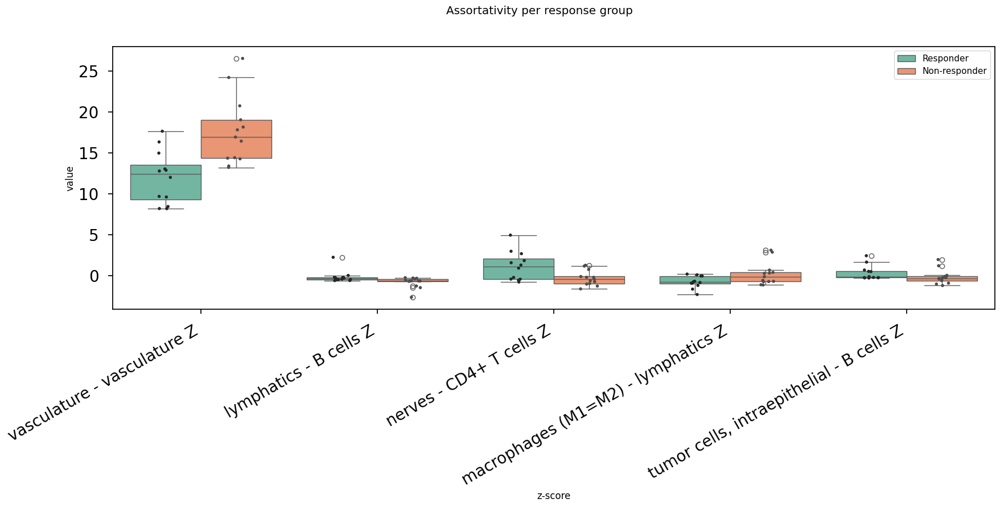

In [197]:
reload(mosna)
fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    group_names=group_names,
    )
fig.suptitle("Assortativity per response group", y=1.0);
plt.savefig(save_dir / f'{fig_step}-distributions_per_response_group.jpg', bbox_inches='tight', facecolor='white', dpi=600)

Some variables hide the distribution of other variables by their much larger range, we can exclude them to better see the other variables:

There are 5 significant variables in `pval`


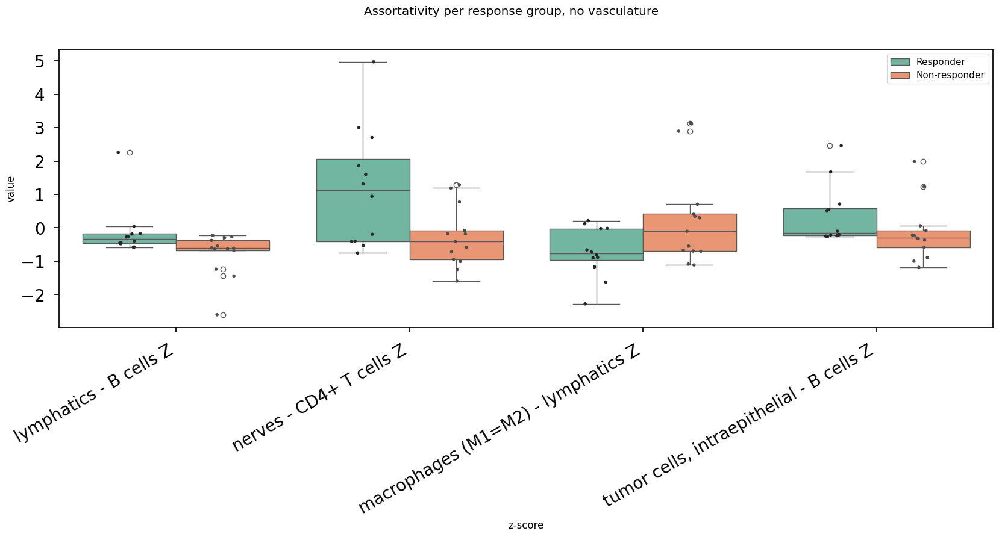

In [198]:
exclude_vars = [
    # 'assort Z',
    'vasculature - vasculature Z',
    # 'neutrophils - neutrophils Z',
    # 'tumor cells - tumor cells Z',
]
fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    exclude_vars=exclude_vars,
    group_names=group_names,
    )
fig.suptitle("Assortativity per response group, no vasculature", y=1.0);
plt.savefig(save_dir / f'{fig_step}-distributions_per_response_group_no_vasculature.jpg', bbox_inches='tight', facecolor='white', dpi=600)

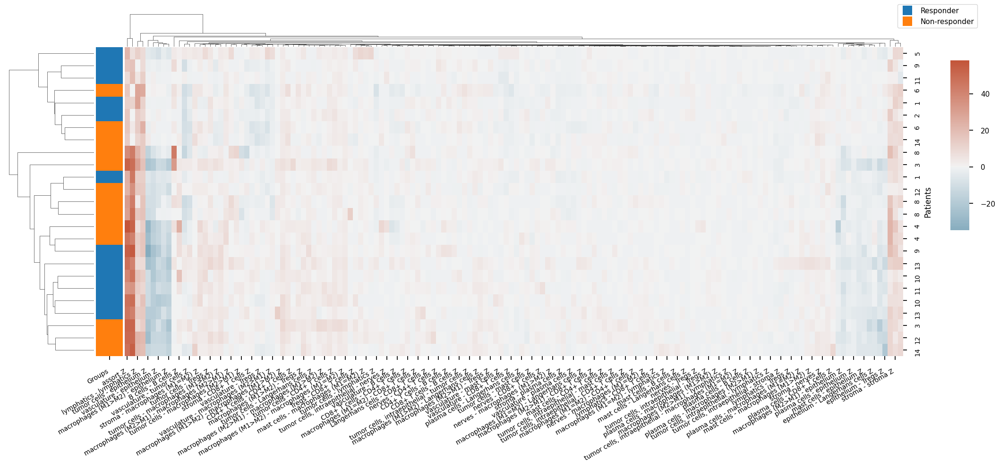

In [200]:
mosna.plot_heatmap(
    z_net_stats_cleaned, 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    skip_cols=['assort Z'],
    z_score=None,
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=0.1,
    legend_opt = {'loc': 'lower right', 'bbox_to_anchor': (1.1, 1.05)},
    )
plt.savefig(save_dir / f'{fig_step}-clustering_imputed.jpg', bbox_inches='tight', facecolor='white', dpi=600)

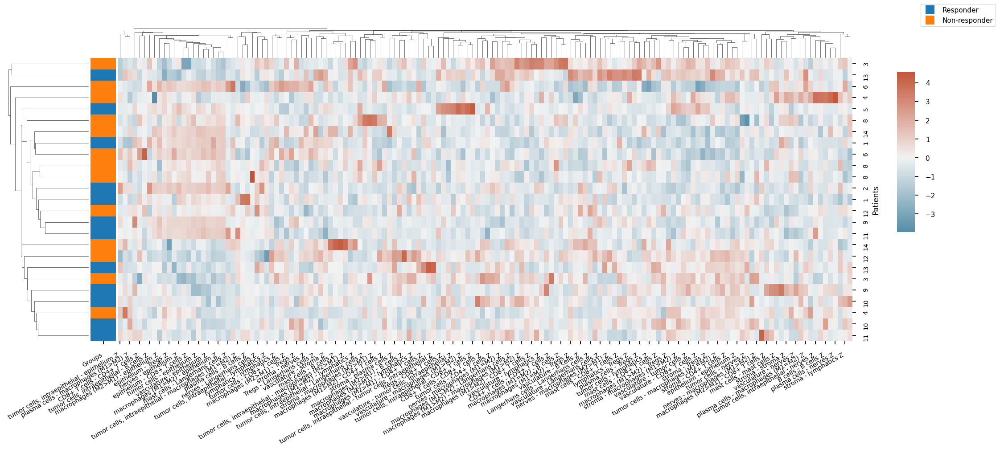

In [201]:
mosna.plot_heatmap(
    z_net_stats_cleaned, 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    skip_cols=['assort Z'],
    z_score=1,
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=0.1
    )
plt.savefig(save_dir / f'{fig_step}-clustering_imputed_zscored.jpg', bbox_inches='tight', facecolor='white', dpi=600)

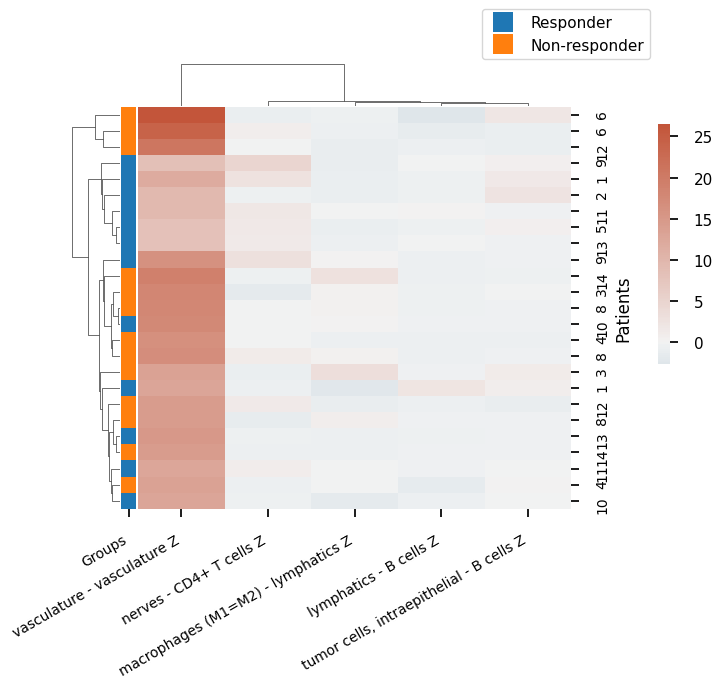

In [202]:
mosna.plot_heatmap(
    z_net_stats_cleaned[best_pval_names+[patient_col, group_col]], 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(6, 8),
    skip_cols=['assort Z'],
    z_score=None,
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=0.1
    )
plt.savefig(save_dir / f'{fig_step}-clustering_imputed_selected.jpg', bbox_inches='tight', facecolor='white', dpi=600)

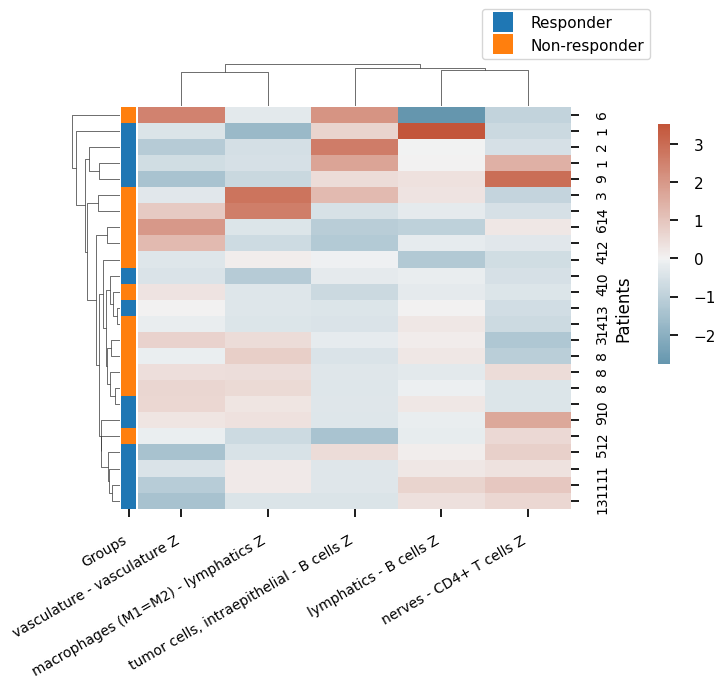

In [203]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()

mosna.plot_heatmap(
    z_net_stats_cleaned[best_pval_names+[patient_col, group_col]], 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(6, 8),
    skip_cols=['assort Z'],
    z_score=1,
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=0.1,
    )
plt.savefig(save_dir / f'{fig_step}-clustering_imputed_zscored_selected.jpg', bbox_inches='tight', facecolor='white', dpi=600)

Samples are a bit clustered into consistent response groups, but it's not incredible.  
We also need to aggregate samples per patient and time of biopsy, that may help us correcting nan values and have more variables, and hopefully better clusters.

In [171]:
z_net_stats_cleaned.to_csv(dir_assort / 'assortativity_per_sample.csv')

In [204]:
z_net_stats_cleaned

,Patients,Groups,assort Z,B cells - B cells Z,CD4+ T cells - B cells Z,CD4+ T cells - CD4+ T cells Z,CD8+ T cells - B cells Z,CD8+ T cells - CD4+ T cells Z,CD8+ T cells - CD8+ T cells Z,Langerhans cells - B cells Z,...,"tumor cells, intraepithelial - macrophages (M1=M2) Z","tumor cells, intraepithelial - macrophages (M1>M2) Z","tumor cells, intraepithelial - macrophages (M2>M1) Z","tumor cells, intraepithelial - mast cells Z","tumor cells, intraepithelial - nerves Z","tumor cells, intraepithelial - stroma Z","tumor cells, intraepithelial - tumor cells Z","tumor cells, intraepithelial - tumor cells, intraepithelial Z",vasculature - plasma cells Z,"vasculature - tumor cells, intraepithelial Z"
FileName,,,,,,,,,,,,,,,,,,,,,
reg001,1,1,24.190942,1.134907,-1.243968,-0.678786,0.860589,2.366711,1.573080,1.344357,...,0.712619,0.517322,0.123441,-0.435376,0.319161,-2.445261,0.956805,2.924093,-2.501314,-2.493605
reg002,1,1,12.379904,-0.375650,3.270044,1.400757,-1.251090,2.228154,2.902544,-0.681232,...,-0.344178,0.343373,-0.958725,0.926844,-0.435887,-1.202350,1.153567,0.314647,-0.805019,-1.460195
reg006,2,1,15.343623,-0.342746,-0.379896,-0.163383,1.571017,-0.333608,3.260047,0.458192,...,-0.928841,-1.202189,0.067444,-0.156813,-0.349295,0.966901,0.291703,-0.044766,-0.569737,-0.998532
reg009,3,2,51.712912,3.912258,-0.758091,6.070553,0.576871,1.009794,5.545749,-0.677016,...,-0.475406,0.600099,0.714401,2.239859,0.731007,-1.368285,-0.088305,1.044084,-0.526157,-2.004947
reg010,3,2,52.830785,3.925074,-0.593397,8.865137,0.775713,-2.957335,8.063748,0.424438,...,0.158983,-0.420327,-1.195581,1.112205,-2.063254,-2.116539,0.419101,4.894248,0.622160,0.823554
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
reg046,12,2,23.398796,6.026715,-0.766431,-0.870370,-1.219096,1.164041,0.593253,0.812697,...,-0.293345,0.811437,-1.196243,-1.325071,0.310205,0.241760,-1.621342,-0.012179,-0.300474,0.704778
reg051,13,1,45.689836,-0.089803,-0.480017,1.130731,-0.335480,0.881702,1.426758,1.651555,...,0.105164,-0.145020,-0.508913,-0.555348,-0.348209,2.021777,-1.710073,12.930318,1.007051,-2.000002
reg052,13,1,47.704148,-0.119159,-0.394176,0.748555,-0.238919,-0.549152,-0.198749,-0.590616,...,-1.059355,2.446734,-0.466477,-0.281657,-0.670682,3.297647,-0.711130,-0.368761,-0.383893,0.352221


        training failed
        training failed with cv <= 5
Training took 3.349s


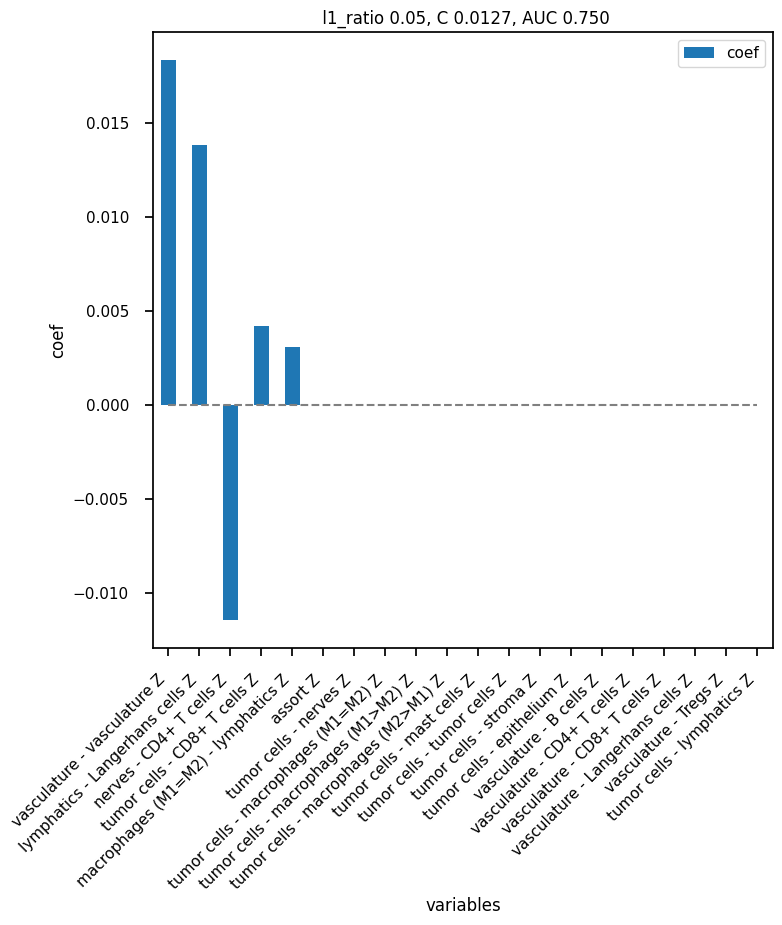

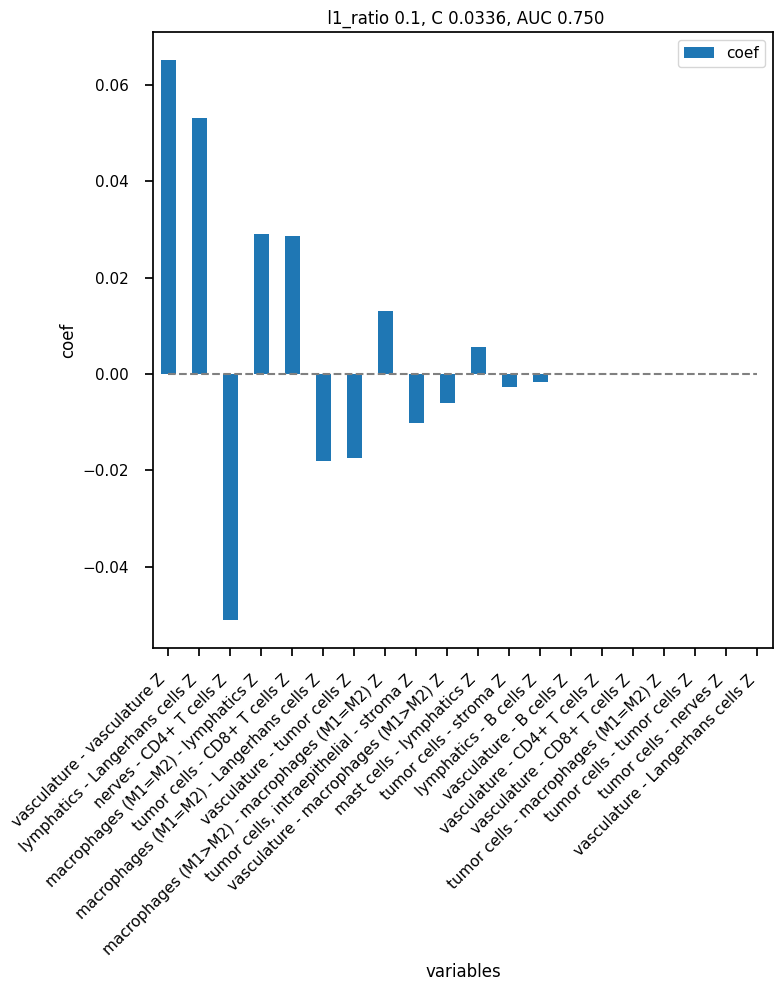

In [205]:
models = mosna.logistic_regression(
    z_net_stats_cleaned,
    y_name=group_col,
    col_drop=[sample_col, patient_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    save_plot_figures=True,
    dir_save=save_dir,
    str_prefix=f'{fig_step}_',
    )

In [206]:
best_pval_names

['vasculature - vasculature Z',
 'lymphatics - B cells Z',
 'nerves - CD4+ T cells Z',
 'macrophages (M1=M2) - lymphatics Z',
 'tumor cells, intraepithelial - B cells Z']

Training took 3.260s


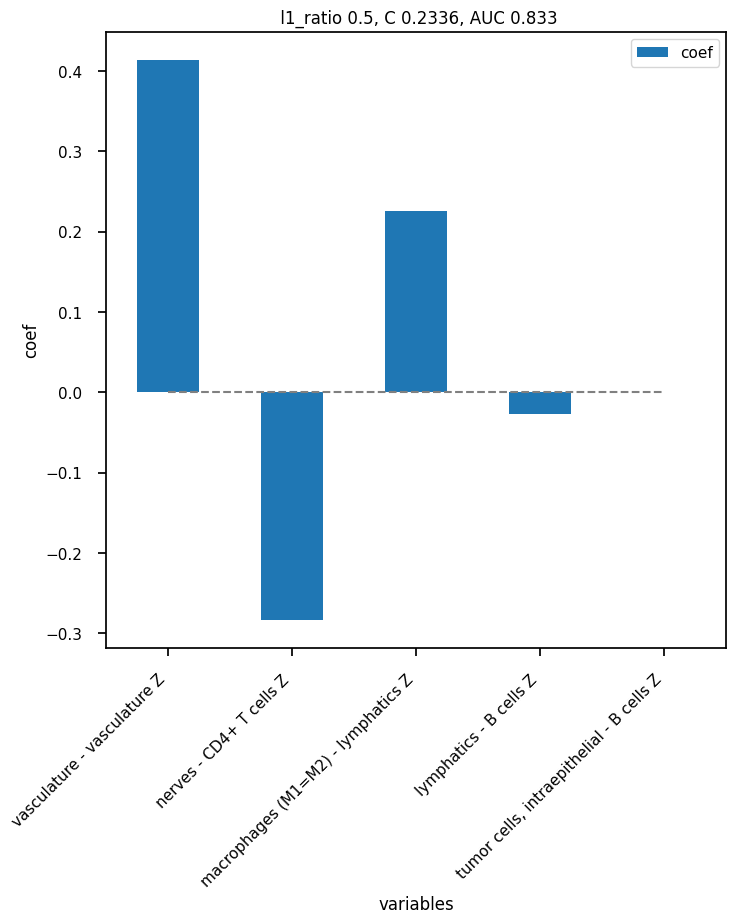

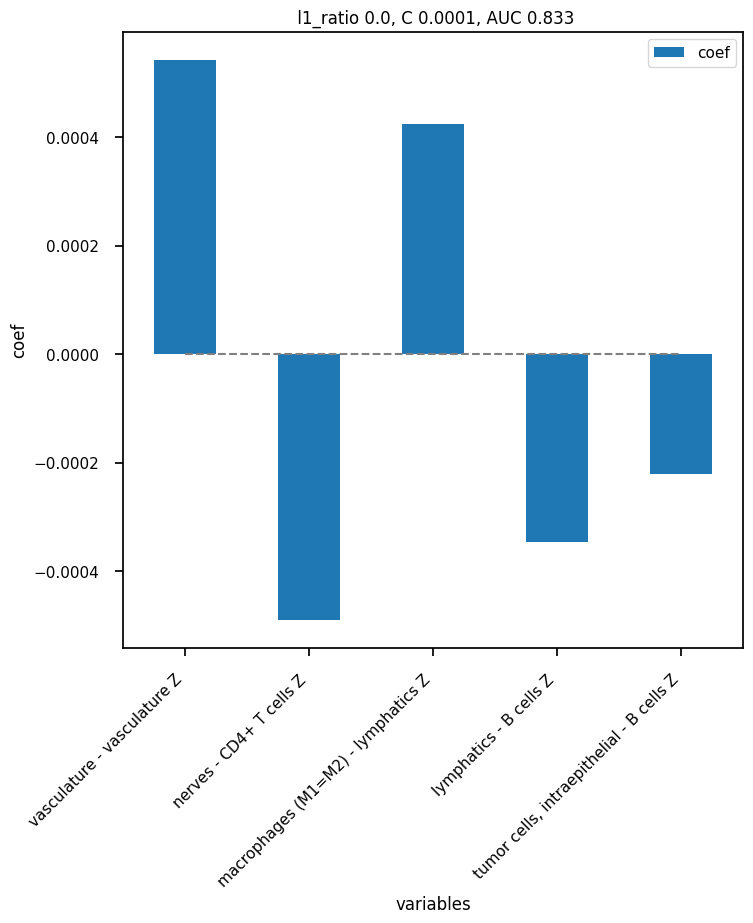

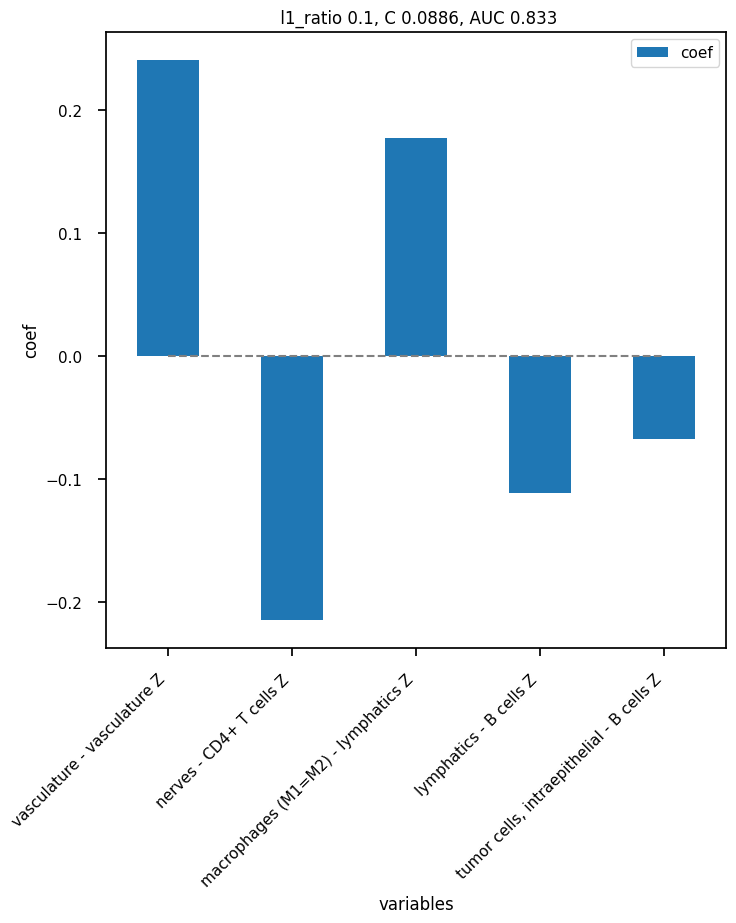

In [207]:
# columns = [
#     'neutrophils - nerves Z',
#     'vasculature - tumor cells Z',
#     'Langerhans cells - Langerhans cells Z',
#     'neutrophils - neutrophils Z', 
# ]

models = mosna.logistic_regression(
    z_net_stats_cleaned[best_pval_names + [group_col]],
    y_name=group_col,
    col_drop=[sample_col],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    save_plot_figures=True,
    dir_save=save_dir,
    str_prefix=f'{fig_step}_selected_',
    )

#### Samples aggregation per patient and time point.

In [208]:
z_net_stats = net_stats[z_cols]
z_net_stats.index = [parse_sample(s) for s in z_net_stats.index]
z_net_stats.index.name = sample_col

z_net_stats = pd.concat([status, z_net_stats], axis=1, join='inner')#.sort_values('Spots')
z_net_stats.drop(columns=['Spots'], inplace=True)

fig_step = '03_assortativity_per_patient'

In [209]:
# the mean of aggregated data already ignores nans
z_net_stats = z_net_stats.groupby([patient_col, group_col]).mean()
z_net_stats

,,assort Z,B cells - B cells Z,CD4+ T cells - B cells Z,CD4+ T cells - CD4+ T cells Z,CD8+ T cells - B cells Z,CD8+ T cells - CD4+ T cells Z,CD8+ T cells - CD8+ T cells Z,Langerhans cells - B cells Z,Langerhans cells - CD4+ T cells Z,Langerhans cells - CD8+ T cells Z,...,"macrophages (M1>M2) - DCs, CD11c+ Z","macrophages (M2>M1) - DCs, CD11c+ Z","mast cells - DCs, CD11c+ Z","nerves - DCs, CD11c+ Z","neutrophils - DCs, CD11c+ Z","plasma cells - DCs, CD11c+ Z","stroma - DCs, CD11c+ Z","tumor cells - DCs, CD11c+ Z","tumor cells, intraepithelial - DCs, CD11c+ Z","vasculature - DCs, CD11c+ Z"
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,18.285423,0.379628,1.013038,0.360985,-0.195251,2.297432,2.237812,0.331563,-0.850976,0.995579,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,9.193553,-0.342746,-0.379896,-0.163383,1.571017,-0.333608,3.260047,0.458192,1.376494,2.168006,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2,52.271849,NaN,-0.758091,7.467845,0.576871,-0.973770,6.804749,-0.677016,0.313157,2.253644,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2,52.205555,16.019297,0.404733,1.494855,-1.356062,0.812310,-0.058913,-0.098084,0.436204,-0.089359,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,1,20.961282,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.193247,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10,1,43.370101,8.605185,-0.331394,1.186227,2.301700,0.354720,3.069966,-0.355190,0.457781,-0.372936,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,1,20.803035,-0.089803,NaN,-0.462358,-0.224544,2.085407,1.611584,-0.283092,0.118890,0.630564,...,2.372255,-0.362245,-0.229416,-0.119159,NaN,NaN,0.480766,-0.855591,-0.258904,4.171794
12,2,36.877393,4.319336,-0.884892,0.134051,-0.993092,1.998438,2.365100,1.266030,0.848276,3.871280,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [210]:
# Have a look at nan values
for name, value in z_net_stats.isna().sum().items():
    print(name, ' ' * (52- len(name)), value)

assort Z                                              0
B cells - B cells Z                                   4
CD4+ T cells - B cells Z                              3
CD4+ T cells - CD4+ T cells Z                         2
CD8+ T cells - B cells Z                              2
CD8+ T cells - CD4+ T cells Z                         2
CD8+ T cells - CD8+ T cells Z                         2
Langerhans cells - B cells Z                          2
Langerhans cells - CD4+ T cells Z                     2
Langerhans cells - CD8+ T cells Z                     1
Langerhans cells - Langerhans cells Z                 1
Tregs - B cells Z                                     2
Tregs - CD4+ T cells Z                                2
Tregs - CD8+ T cells Z                                1
Tregs - Langerhans cells Z                            1
Tregs - Tregs Z                                       1
epithelium - B cells Z                                2
epithelium - CD4+ T cells Z                     

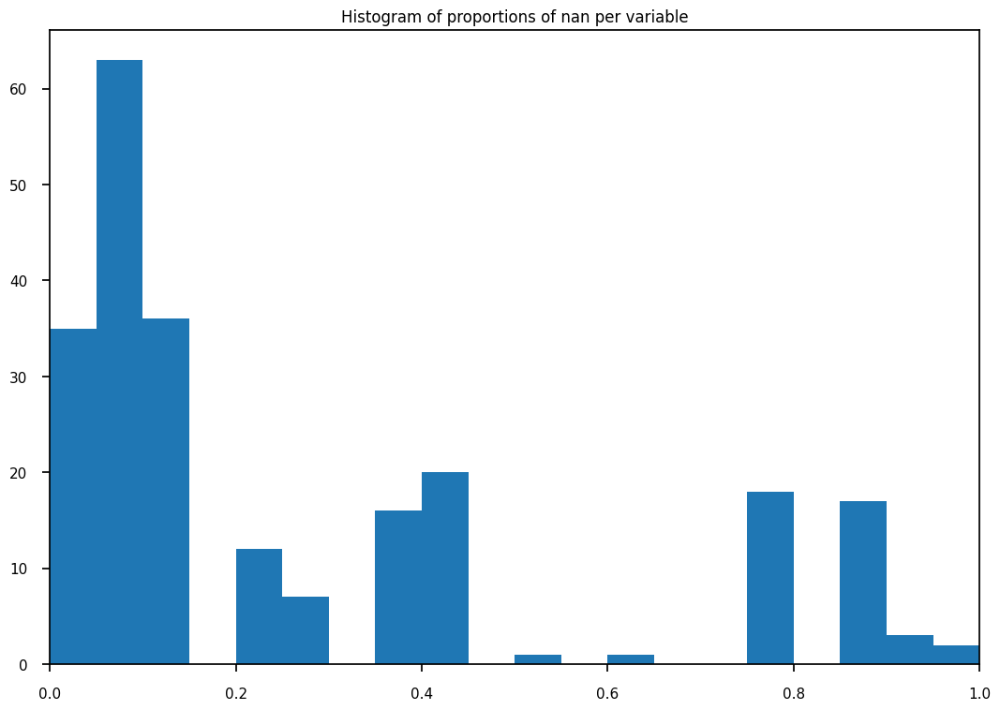

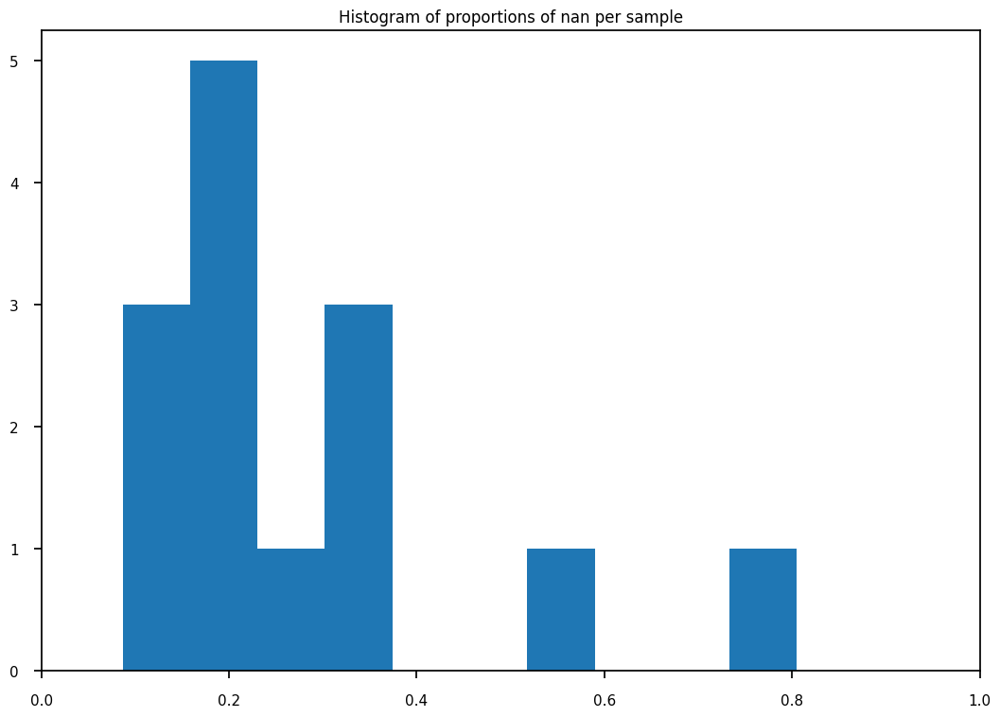

In [211]:
plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0], bins=20);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping variables z_net_stats shape: (14, 231)
There are 884 non finite values (27.3%)
Final z_net_stats shape: (14, 169)
There are 62 variables discarded


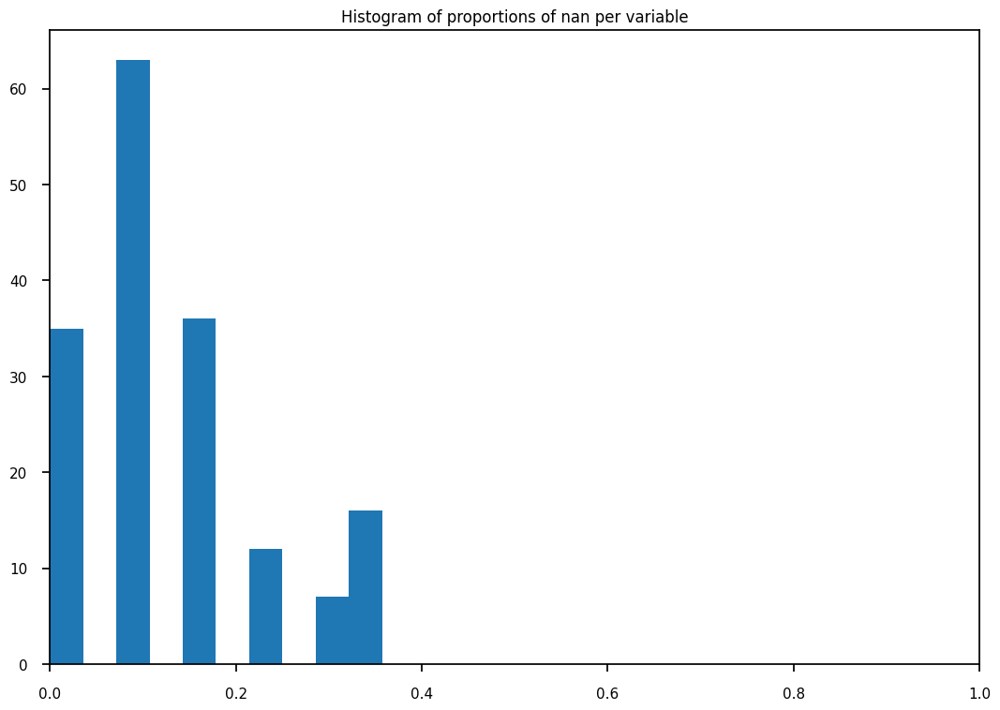

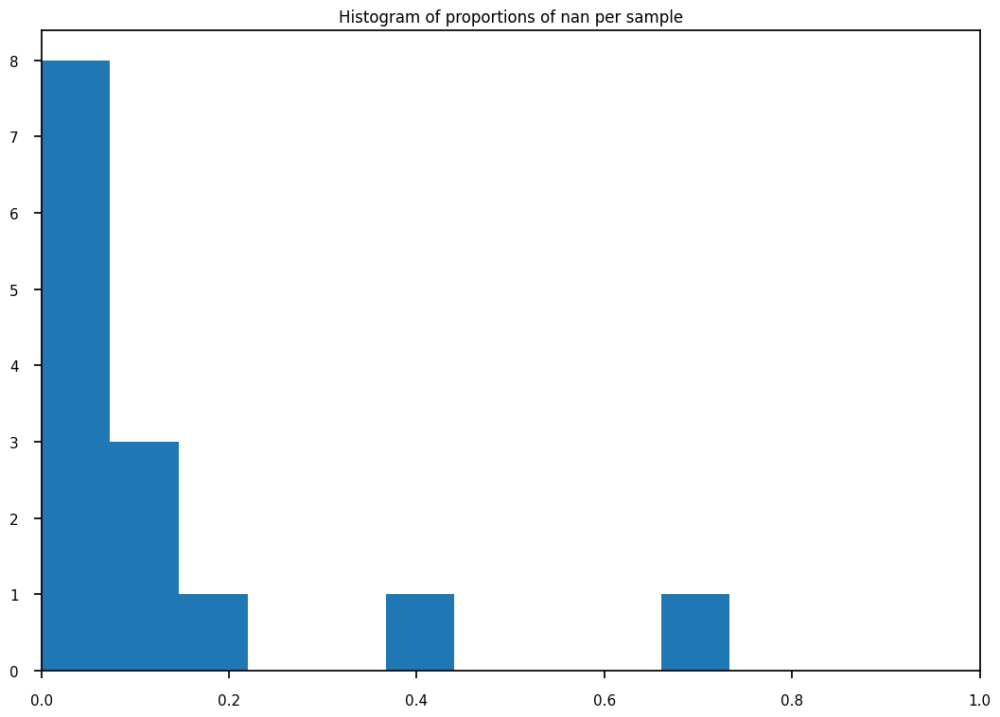

In [212]:
print("Before dropping variables z_net_stats shape:", z_net_stats.shape)

# drop columns
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.4,
    axis=0,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} variables discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping samples z_net_stats shape: (14, 169)
There are 279 non finite values (11.8%)
Final z_net_stats shape: (13, 169)
There are 1 observations discarded


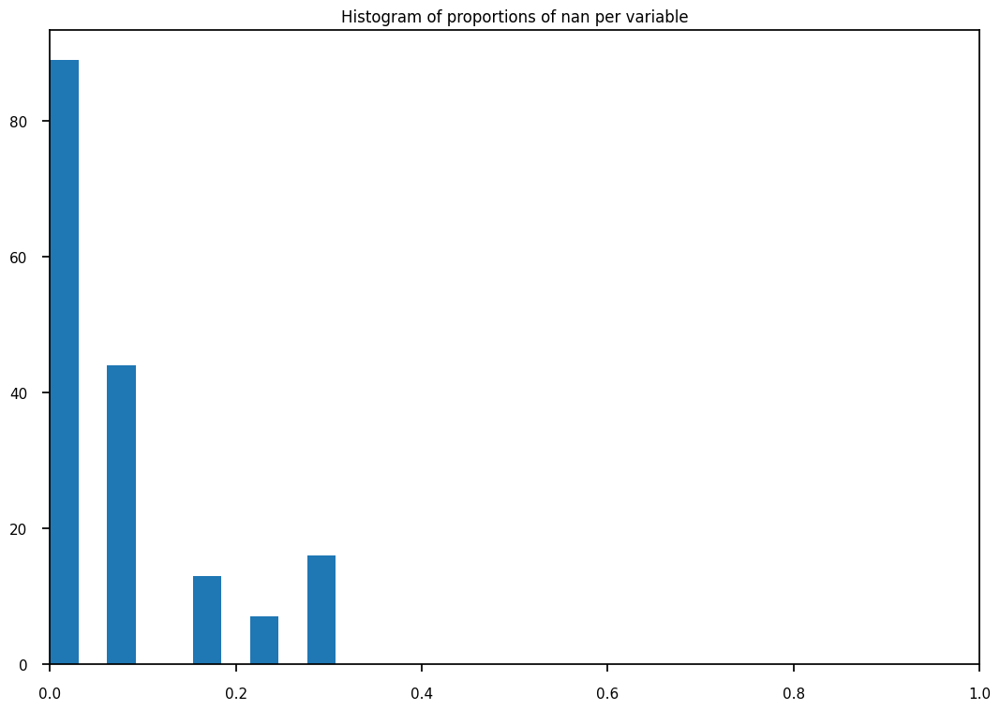

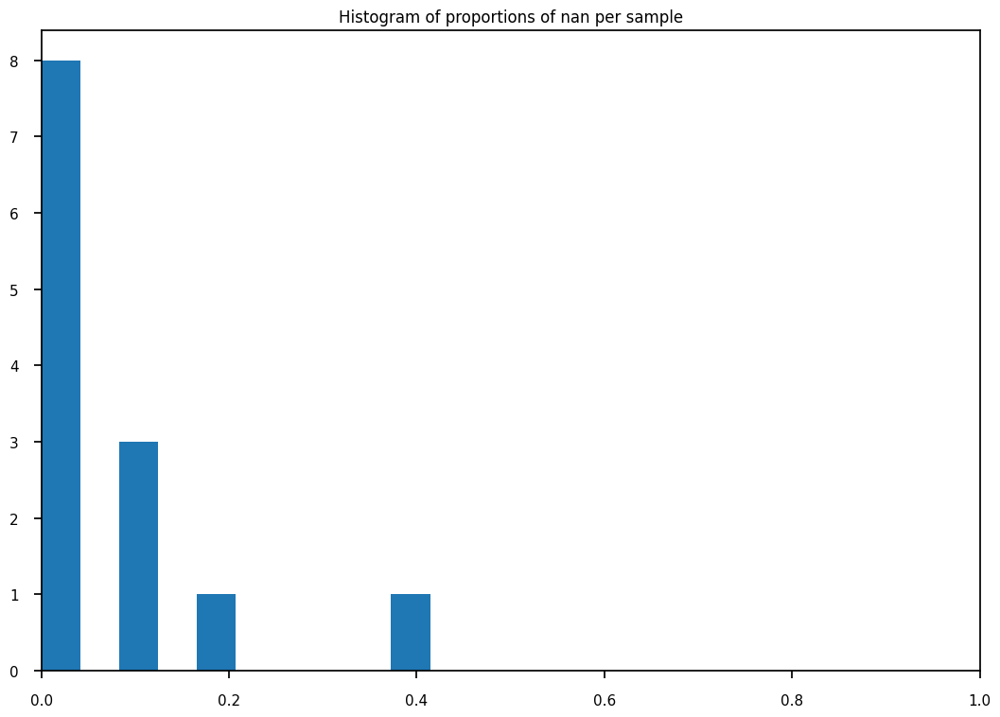

In [213]:
# Here we notice there are no patient with more than80% of nan values.
# We will still drop high-nan patients.

print("Before dropping samples z_net_stats shape:", z_net_stats.shape)

# drop samples
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.5,
    axis=1,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} observations discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

In [214]:
# impute non finite values in data for further analyses and visualizations
z_net_stats_cleaned, select_finite = mosna.clean_data(
    z_net_stats, 
    method='mixed',
    thresh=0.8,
    )
print("Final z_net_stats shape:", z_net_stats_cleaned.shape)

There are 155 non finite values (7.1%)
Imputing data
Final z_net_stats shape: (13, 169)


In [215]:
pvals = mosna.find_DE_markers(z_net_stats_cleaned.iloc[:, 1:], group_ref=2, group_tgt=1, group_var=group_col)
pvals = pvals.sort_values(by='pval', ascending=True)
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index.tolist()

In [216]:
pvals.head(10)

,pval,pval_corr
vasculature - vasculature Z,0.002331,0.391608
lymphatics - B cells Z,0.022145,0.998725
macrophages (M2>M1) - lymphatics Z,0.022145,0.998725
Tregs - CLA+ leukocytes Z,0.034965,0.998725
nerves - CD4+ T cells Z,0.051282,0.998725
B cells - B cells Z,0.073427,0.998725
macrophages (M1=M2) - lymphatics Z,0.073427,0.998725
"tumor cells, intraepithelial - macrophages (M2>M1) Z",0.101399,0.998725
tumor cells - CD8+ T cells Z,0.137529,0.998725
mast cells - lymphatics Z,0.137529,0.998725


There are 4 significant variables in `pval`


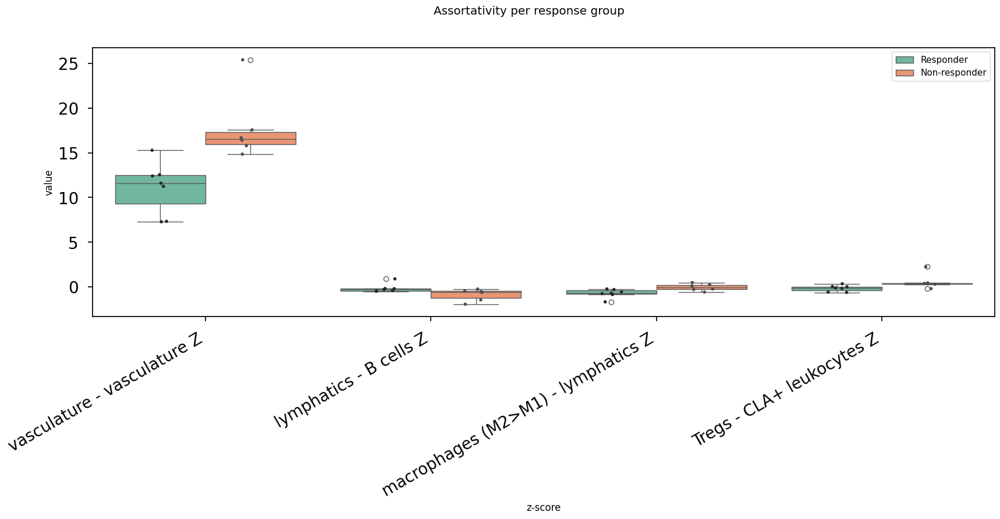

In [217]:
fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    group_names=group_names,
    )
fig.suptitle("Assortativity per response group", y=1.0);
plt.savefig(save_dir / f'{fig_step}-distributions_per_response_group.jpg', bbox_inches='tight', facecolor='white', dpi=600)

There are 4 significant variables in `pval`


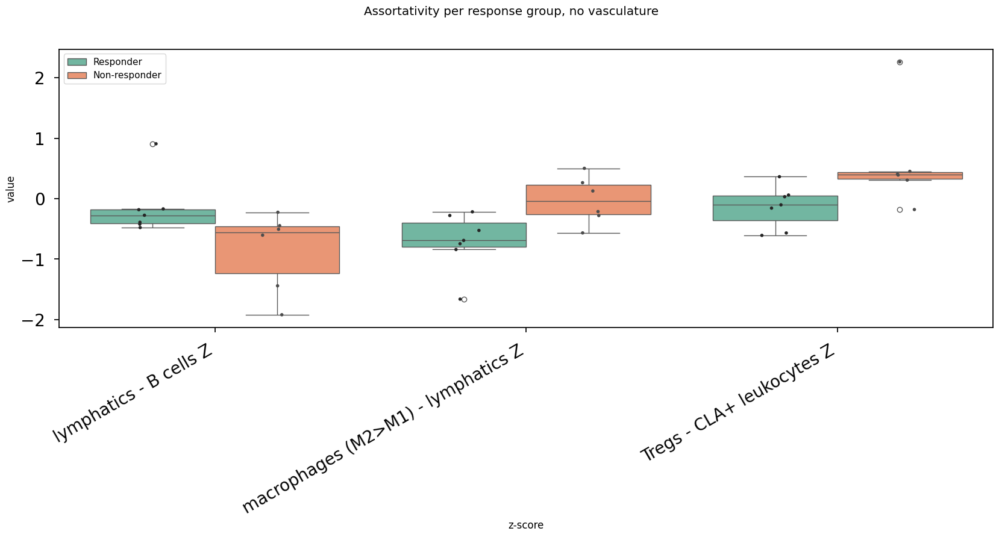

In [218]:
exclude_vars = [
    'vasculature - vasculature Z',
    # 'neutrophils - neutrophils Z',
    # 'Langerhans cells - Langerhans cells Z',
    #  'tumor cells, intraepithelial - tumor cells, intraepithelial Z',
]

fig, ax = mosna.plot_distrib_groups(
    z_net_stats_cleaned, 
    group_var=group_col,
    groups=[1, 2], 
    exclude_vars=exclude_vars,
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='z-score',
    group_names=group_names,
    )
fig.suptitle("Assortativity per response group, no vasculature", y=1.0);
plt.savefig(save_dir / f'{fig_step}-distributions_per_response_group_no_vasculature.jpg', bbox_inches='tight', facecolor='white', dpi=600)

Distributions of Z scored interactions between -2 and 2 are not significative.

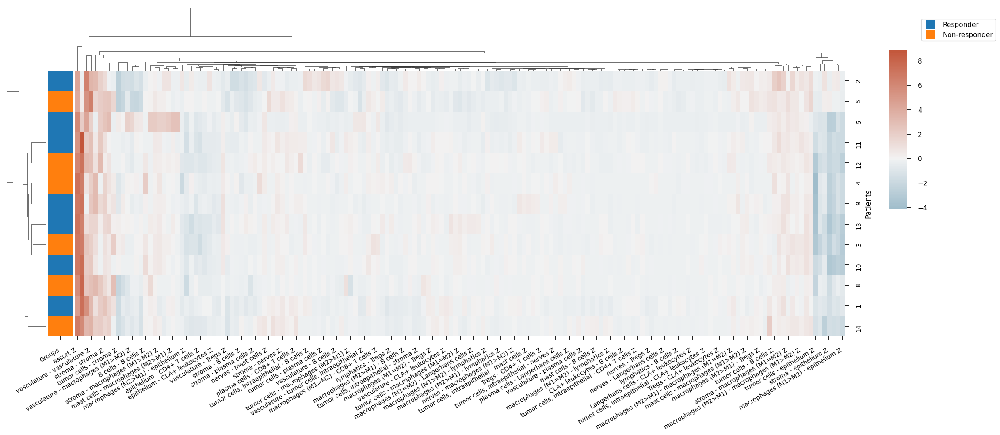

In [219]:
mosna.plot_heatmap(
    z_net_stats_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    z_score=False,
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=[0.05, 0.2],
    )
plt.savefig(save_dir / f'{fig_step}-clustering_imputed.jpg', bbox_inches='tight', facecolor='white', dpi=600)

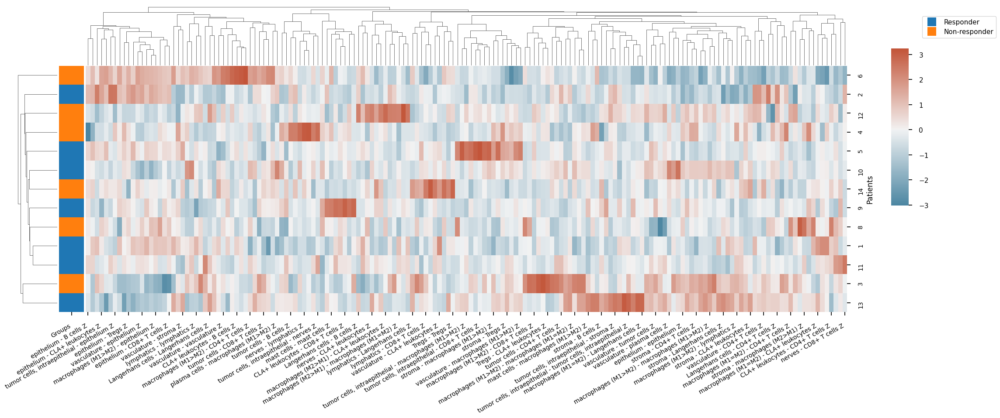

In [220]:
mosna.plot_heatmap(
    z_net_stats_cleaned.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(20, 12),
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=[0.05, 0.2],
    )
plt.savefig(save_dir / f'{fig_step}-clustering_imputed_zscored.jpg', bbox_inches='tight', facecolor='white', dpi=600)

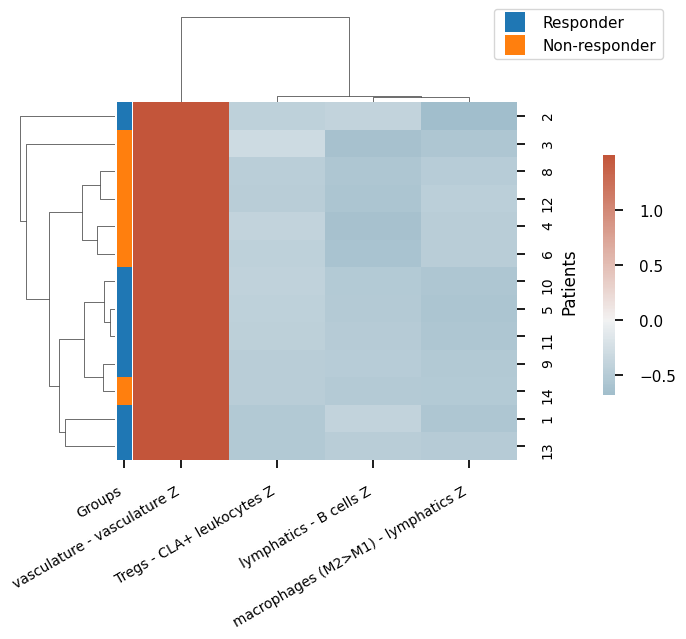

In [225]:
mosna.plot_heatmap(
    z_net_stats_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(6, 8),
    z_score=False,
    group_names=group_names,
    cbar_pos=(1.01, 0.5, 0.02, 0.3),
    dendrogram_ratio=0.2,
    legend_opt = {'loc': 'lower right', 'bbox_to_anchor': (1.4, 1.1)},
    )
plt.savefig(save_dir / f'{fig_step}-clustering_imputed_selected.jpg', bbox_inches='tight', facecolor='white', dpi=600)

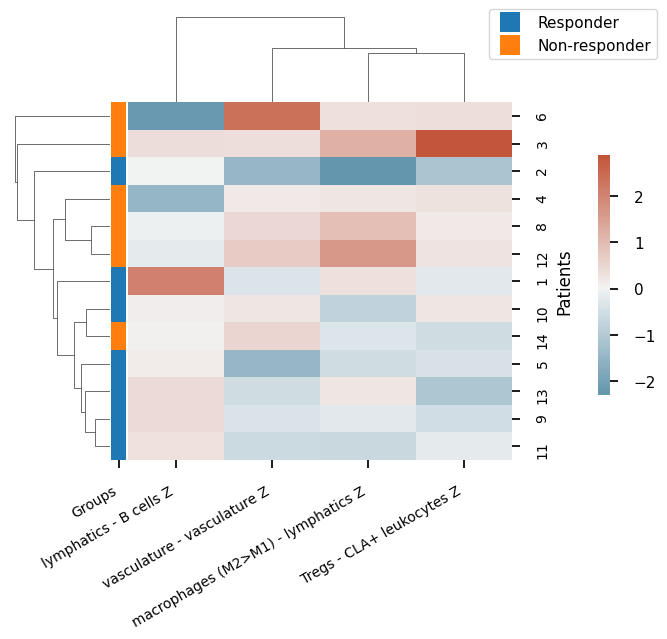

In [227]:
mosna.plot_heatmap(
    z_net_stats_cleaned[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(6, 8),
    group_names=group_names,
    cbar_pos=(1.01, 0.5, 0.02, 0.3),
    dendrogram_ratio=0.2,
     legend_opt = {'loc': 'lower right', 'bbox_to_anchor': (1.4, 1.1)},
    )
plt.savefig(save_dir / f'{fig_step}-clustering_imputed_zscored_selected.jpg', bbox_inches='tight', facecolor='white', dpi=600)

#### Logistic regression on interaction coefficients

        training failed
        training failed with cv <= 5
        training failed
        training failed with cv <= 5
Training took 2.466s


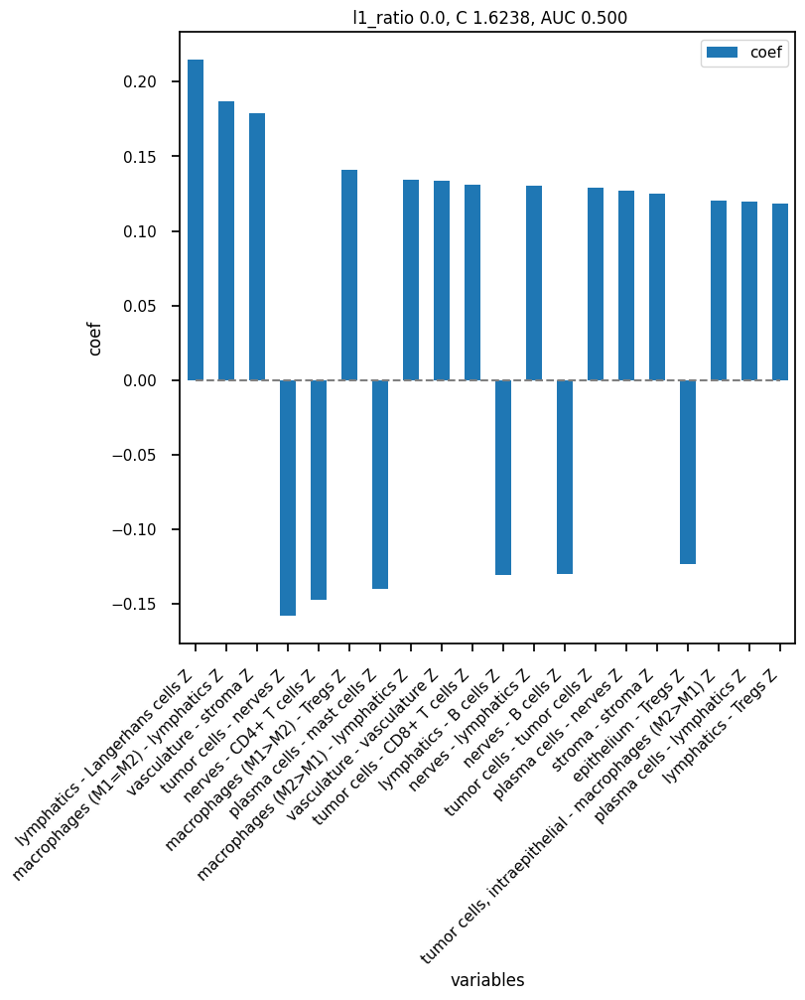

In [228]:
models = mosna.logistic_regression(
    z_net_stats_cleaned,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    save_preds=True,
    save_plot_figures=True,
    dir_save=save_dir,
    str_prefix=f'{fig_step}_',
    )

In [99]:
# columns = [
#     'neutrophils - neutrophils Z', 
#     'tumor cells, intraepithelial - tumor cells, intraepithelial Z',
#     'vasculature -vascilature Z',
#     'neutrophils - nerves Z',
#     'vasculature - tumor cells Z',
#     'Langerhans cells - Langerhans cells Z',
#     'vasculature - vasculature Z',
#     'neutrophils - neutrophils Z',
#     'Langerhans cells - Langerhans cells Z',
# ]

Training took 2.559s


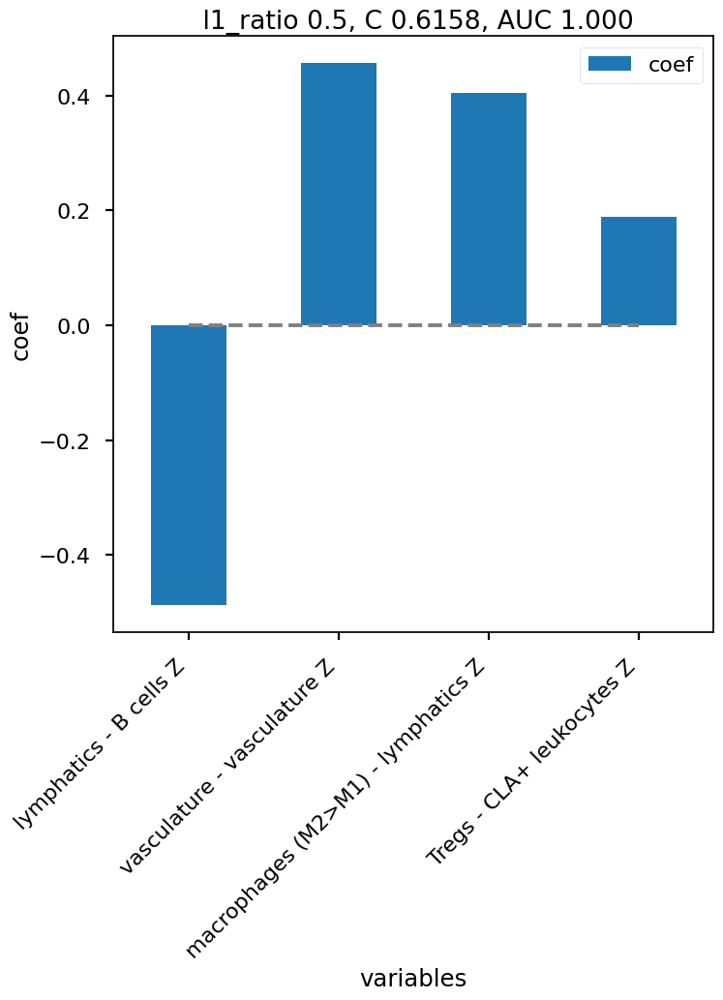

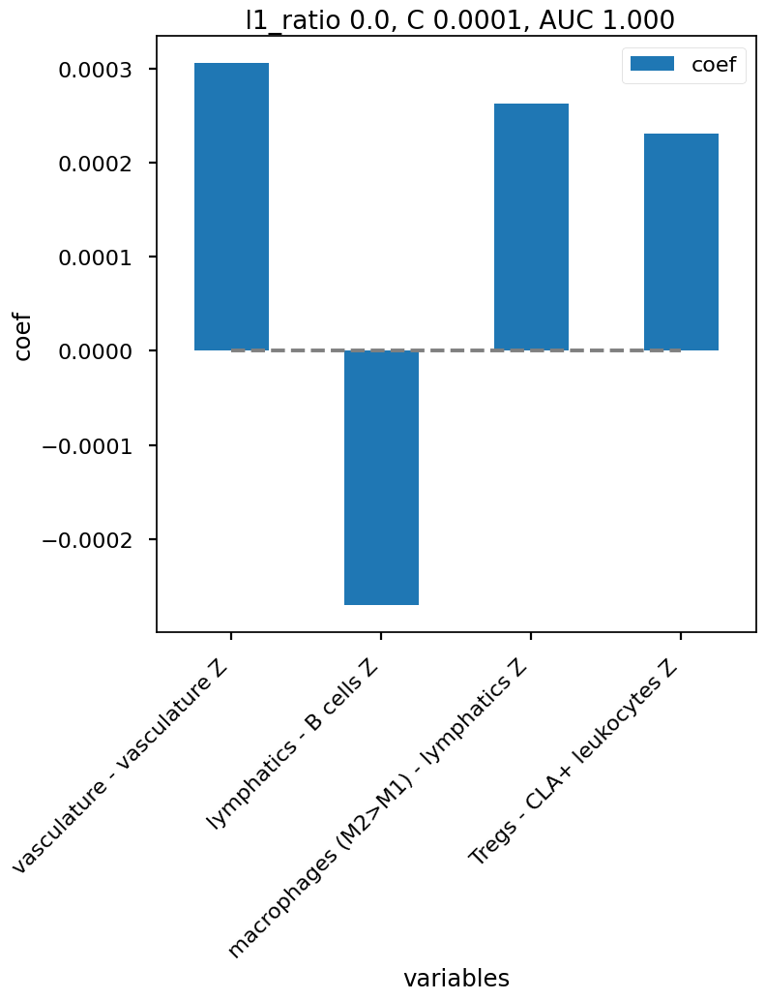

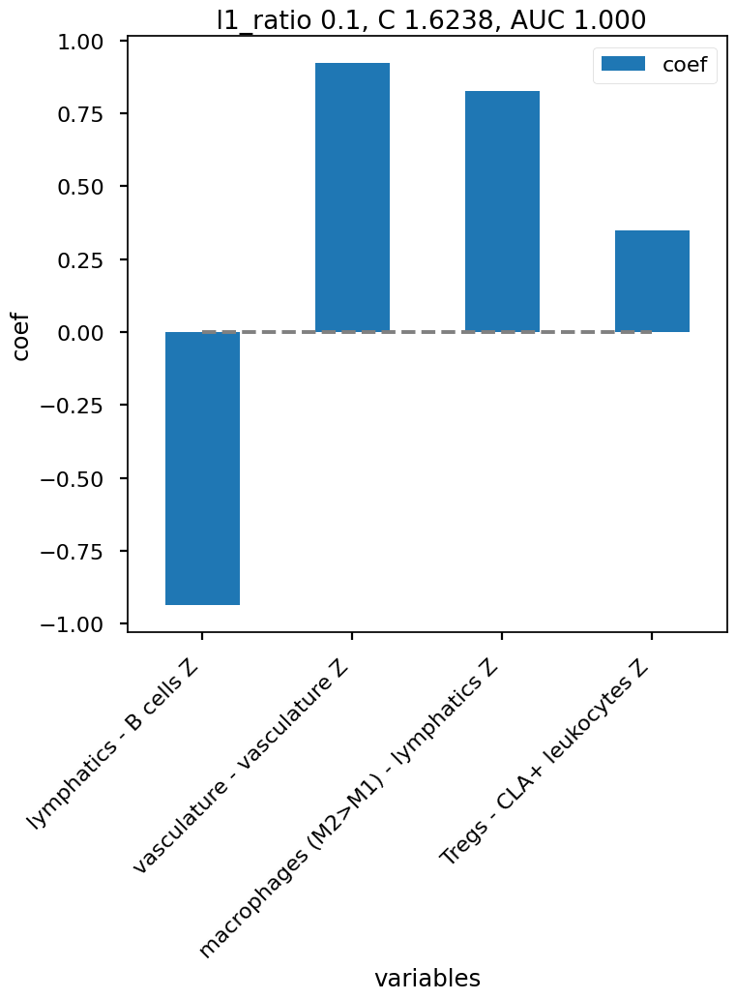

In [230]:
plt.style.use('seaborn-v0_8-poster')

models = mosna.logistic_regression(
    z_net_stats_cleaned[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    save_preds=True,
    save_plot_figures=True,
    dir_save=save_dir,
    str_prefix=f'{fig_step}_selected_',
    )

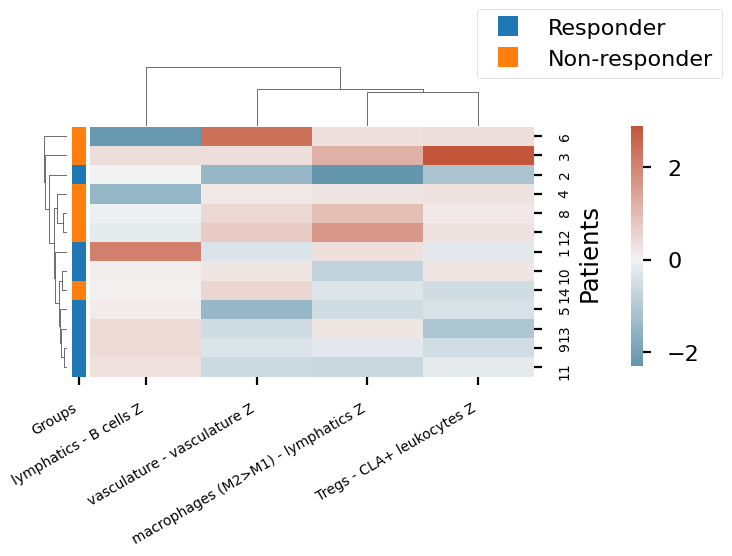

In [237]:
# use the most statistically relevant variable separating groups

nb_vars = np.sum(pvals['pval'] <= 0.05)
# nb_vars = min(nb_vars, 20)
marker_vars = pvals.sort_values(by='pval', ascending=True).head(nb_vars).index.tolist()

mosna.plot_heatmap(
    z_net_stats_cleaned[marker_vars].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    figsize=(6, 8),
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=[0.05, 0.2],
    legend_opt = {'loc': 'lower right', 'bbox_to_anchor': (1.45, 1.15)},
    )

### Ratio of cell-types interactions

Since as noted by this study's authors the imbalance in interactions between cell types can influence response to therapy, let's blindly investigate how ratios of cell types assortativity could predict response to therapy.

In [238]:
z_net_stats_cleaned

,,assort Z,B cells - B cells Z,CD4+ T cells - B cells Z,CD4+ T cells - CD4+ T cells Z,CD8+ T cells - B cells Z,CD8+ T cells - CD4+ T cells Z,CD8+ T cells - CD8+ T cells Z,Langerhans cells - B cells Z,Langerhans cells - CD4+ T cells Z,Langerhans cells - CD8+ T cells Z,...,"tumor cells, intraepithelial - macrophages (M2>M1) Z","tumor cells, intraepithelial - mast cells Z","tumor cells, intraepithelial - nerves Z","tumor cells, intraepithelial - plasma cells Z","tumor cells, intraepithelial - stroma Z","tumor cells, intraepithelial - tumor cells Z","tumor cells, intraepithelial - tumor cells, intraepithelial Z",vasculature - CLA+ leukocytes Z,vasculature - plasma cells Z,"vasculature - tumor cells, intraepithelial Z"
Patients,Groups,,,,,,,,,,,,,,,,,,,,,
1,1,18.285423,0.379628,1.013038,0.360985,-0.195251,2.297432,2.237812,0.331563,-0.850976,0.995579,...,-0.417642,0.245734,-0.058363,0.537909,-1.823805,1.055186,1.619370,2.354305,-1.653167,-1.976900
2,1,9.193553,-0.342746,-0.379896,-0.163383,1.571017,-0.333608,3.260047,0.458192,1.376494,2.168006,...,0.067444,-0.156813,-0.349295,-0.287183,0.966901,0.291703,-0.044766,-0.270220,-0.569737,-0.998532
3,2,52.271849,6.007915,-0.758091,7.467845,0.576871,-0.973770,6.804749,-0.677016,0.313157,2.253644,...,-0.240590,1.676032,-0.666123,0.290527,-1.742412,0.165398,2.969166,-0.113594,-0.526157,-0.590696
4,2,52.205555,16.019297,0.404733,1.494855,-1.356062,0.812310,-0.058913,-0.098084,0.436204,-0.089359,...,-0.221720,-0.217545,3.120827,-0.135186,-0.435213,-0.137330,-0.077487,-0.725846,0.208737,-0.950303
5,1,20.961282,0.271940,0.584850,0.105791,1.229469,1.405370,2.606522,0.164320,0.001452,-0.193247,...,-0.142857,-0.089803,-0.100504,0.127481,-0.366608,-0.224544,0.436430,0.504944,-0.318498,3.219609
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10,1,43.370101,8.605185,-0.331394,1.186227,2.301700,0.354720,3.069966,-0.355190,0.457781,-0.372936,...,0.445604,-0.284618,-0.160394,-0.116330,-0.331505,-0.023216,-0.175863,-0.130681,1.877497,0.626649
11,1,20.803035,-0.089803,0.497844,-0.462358,-0.224544,2.085407,1.611584,-0.283092,0.118890,0.630564,...,-0.365601,-0.251638,1.875653,0.324354,-1.366788,-0.397661,0.952437,0.545575,-0.400482,-1.123676
12,2,36.877393,4.319336,-0.884892,0.134051,-0.993092,1.998438,2.365100,1.266030,0.848276,3.871280,...,-0.350890,-0.114000,-0.052110,1.318499,0.241371,-0.172772,0.407288,-0.699327,-0.853301,0.007477


In [239]:
use_cols = [x for x in z_net_stats_cleaned.columns if x != 'assort Z']
composed_variables = mosna.make_composed_variables(z_net_stats_cleaned[use_cols], method='ratio', order=1)
z_net_stats_comp = pd.concat([z_net_stats_cleaned, composed_variables], axis=1)
pvals = mosna.find_DE_markers(z_net_stats_comp, group_ref=1, group_tgt=2, group_var=group_col)

In [240]:
pvals.head(10)

,pval,pval_corr
macrophages (M2>M1) - B cells Z / tumor cells - macrophages (M1>M2) Z,0.001166,1.0
mast cells - mast cells Z / plasma cells - CD4+ T cells Z,0.001166,1.0
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - tumor cells Z",0.001166,1.0
"tumor cells - mast cells Z / tumor cells, intraepithelial - plasma cells Z",0.001166,1.0
macrophages (M2>M1) - Tregs Z / nerves - macrophages (M1>M2) Z,0.001166,1.0
CD8+ T cells - B cells Z / lymphatics - Langerhans cells Z,0.001166,1.0
macrophages (M2>M1) - lymphatics Z / mast cells - B cells Z,0.001166,1.0
"nerves - CD8+ T cells Z / tumor cells, intraepithelial - epithelium Z",0.001166,1.0
"tumor cells - mast cells Z / tumor cells, intraepithelial - tumor cells, intraepithelial Z",0.001166,1.0
mast cells - macrophages (M1>M2) Z / tumor cells - mast cells Z,0.002331,1.0


In [248]:
# select columns potentially related to the Spatial Score
sc_cols = [x for x in pvals.index if 'Tregs - CD4+ T cells' in x and 'tumor' in x]

In [249]:
pvals.loc[sc_cols, :]

,pval,pval_corr
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - tumor cells Z",0.001166,1.0
Tregs - CD4+ T cells Z / tumor cells - nerves Z,0.034965,1.0
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - mast cells Z",0.137529,1.0
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - CLA+ leukocytes Z",0.137529,1.0
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - B cells Z",0.137529,1.0
...,...,...
Tregs - CD4+ T cells Z / tumor cells - plasma cells Z,0.945221,1.0
Tregs - CD4+ T cells Z / vasculature - tumor cells Z,0.945221,1.0
Tregs - CD4+ T cells Z / tumor cells - Tregs Z,0.945221,1.0
"Tregs - CD4+ T cells Z / tumor cells, intraepithelial - plasma cells Z",0.945221,1.0


In [250]:
pvals.loc['Tregs - CD4+ T cells Z / tumor cells - CD4+ T cells Z', :]

pval         0.835664
pval_corr    1.000000
Name: Tregs - CD4+ T cells Z / tumor cells - CD4+ T cells Z, dtype: float64

Only `Tregs - CD4+ T cells Z / tumor cells, intraepithelial - tumor cells Z` and `Tregs - CD4+ T cells Z / tumor cells - nerves Z` are in the significant interaction between the response groups, without FDR correction. The `Tregs - CD4+ T cells Z / tumor cells - CD4+ T cells Z` corresponding to the Spatial Score is not significantly different between response groups.

There are 333 significant variables in `pval`


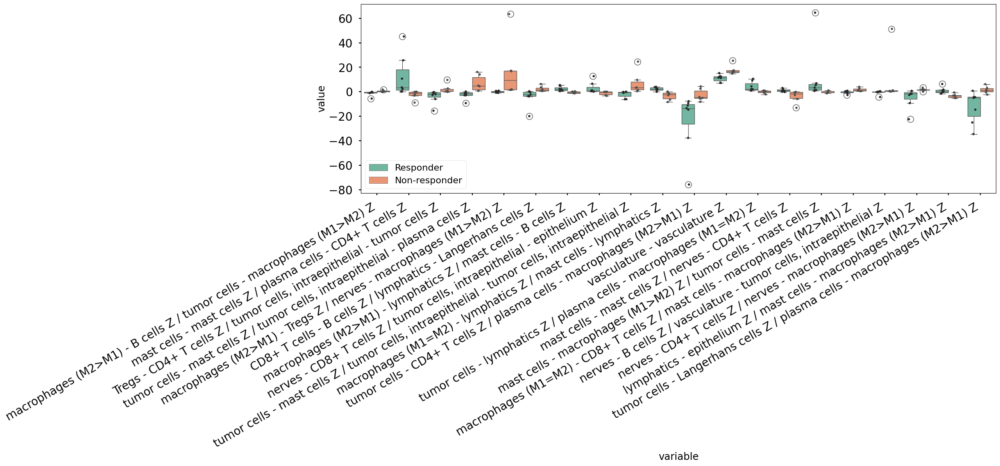

In [251]:
fig, ax = mosna.plot_distrib_groups(
    z_net_stats_comp, 
    group_var=group_col,
    groups=[1, 2], 
    pval_data=pvals, 
    pval_col='pval', 
    max_cols=20, 
    multi_ind_to_col=True,
    group_names=group_names,
    )

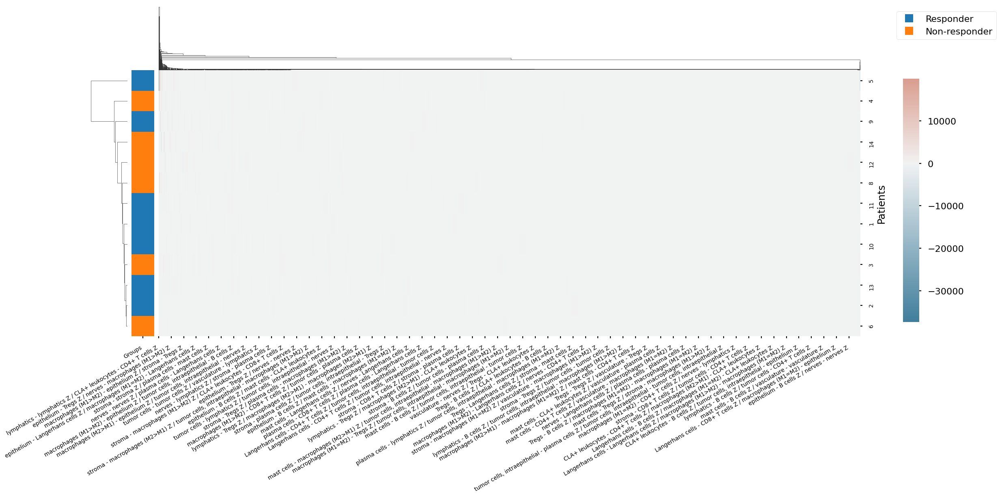

In [253]:
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    z_net_stats_comp.reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(20, 20),
    group_names=group_names,
    cbar_pos=(1.01, 0.6, 0.02, 0.3),
    dendrogram_ratio=[0.05, 0.2],
    );

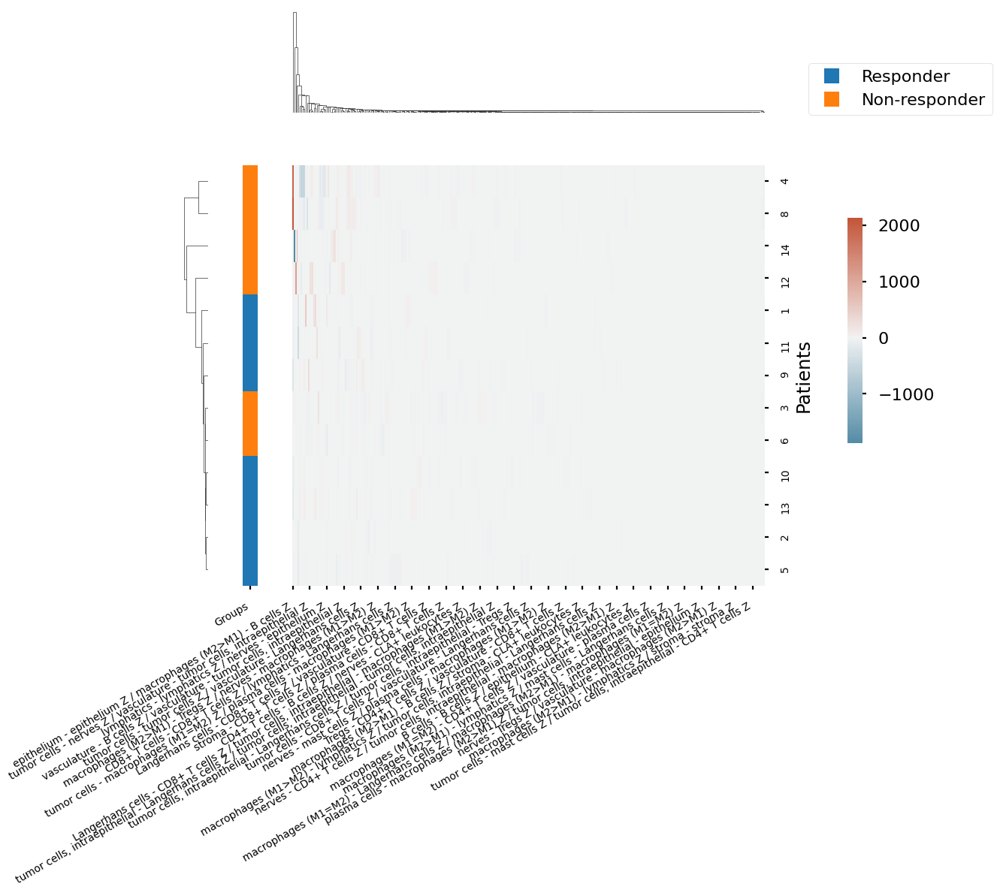

In [259]:
best_pval_names = pvals.loc[pvals['pval'] < 0.05, :].index
# or to select only 20 variables:
# best_pval_names = pvals.head(20).index
mosna.plot_heatmap(
    z_net_stats_comp[best_pval_names].reset_index(), 
    obs_labels=patient_col, 
    group_var=group_col, 
    groups=[1, 2],
    z_score=None,
    figsize=(10, 10),
    group_names=group_names,
    cbar_pos=(1.01, 0.3, 0.02, 0.3),
    dendrogram_ratio=[0.05, 0.2],
    legend_opt = {'loc': 'lower right', 'bbox_to_anchor': (1.5, 1.1)}
    );

        training failed
        training failed with cv <= 5
Training took 39.364s


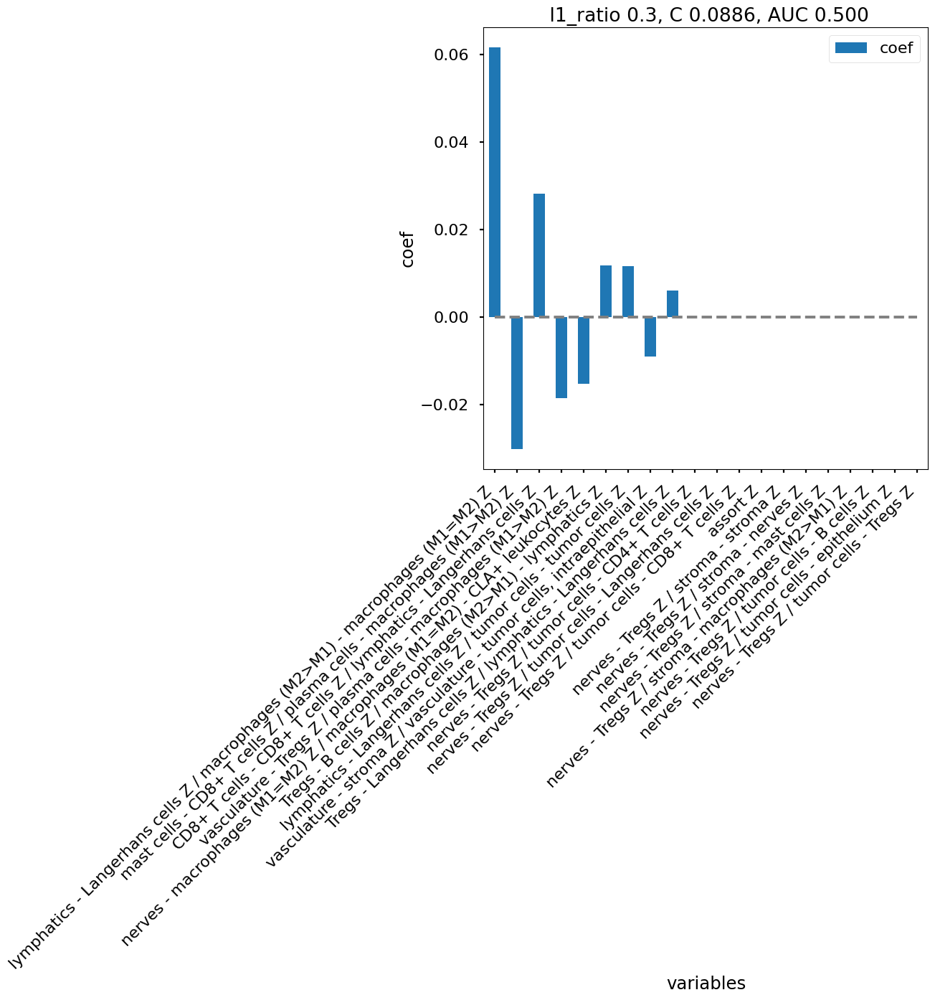

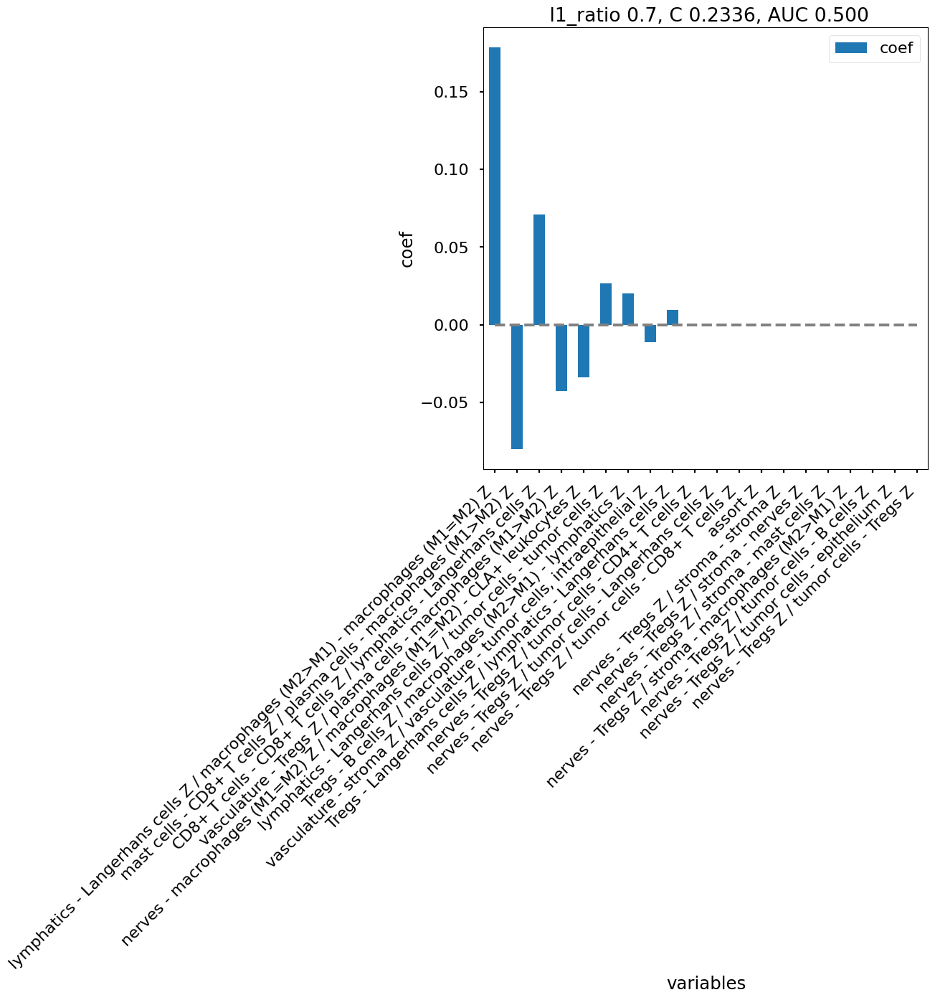

In [260]:
# Train ML model with all variables

models = mosna.logistic_regression(
    z_net_stats_comp,
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

Training took 2.477s


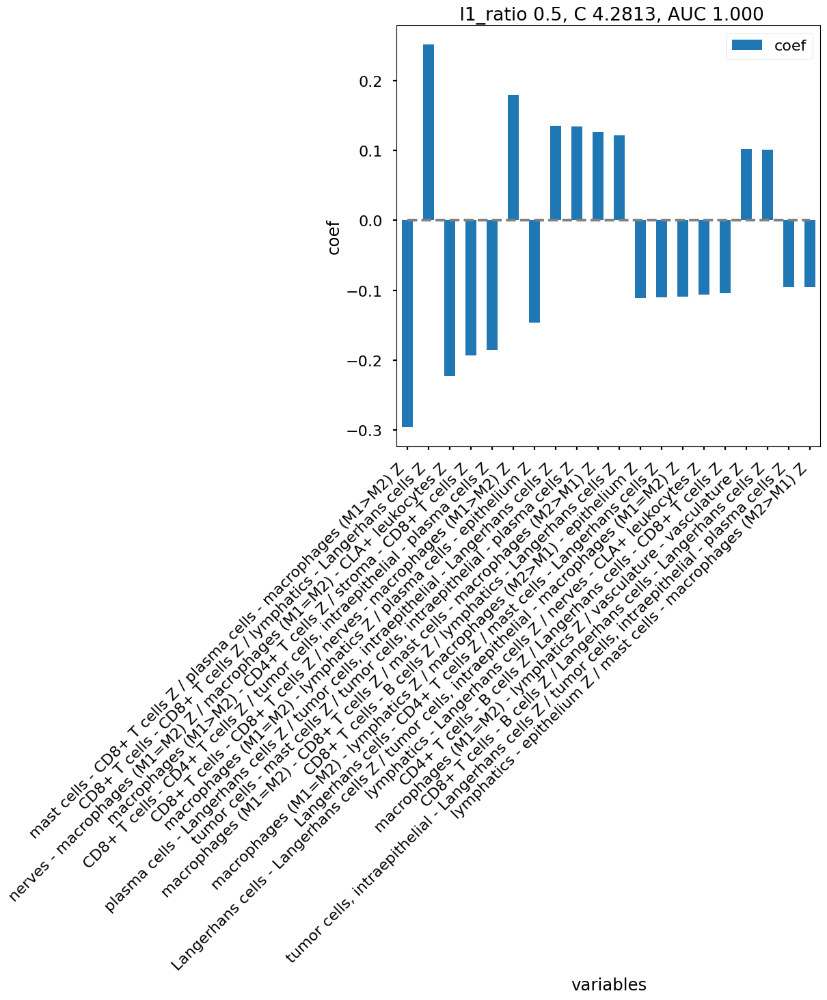

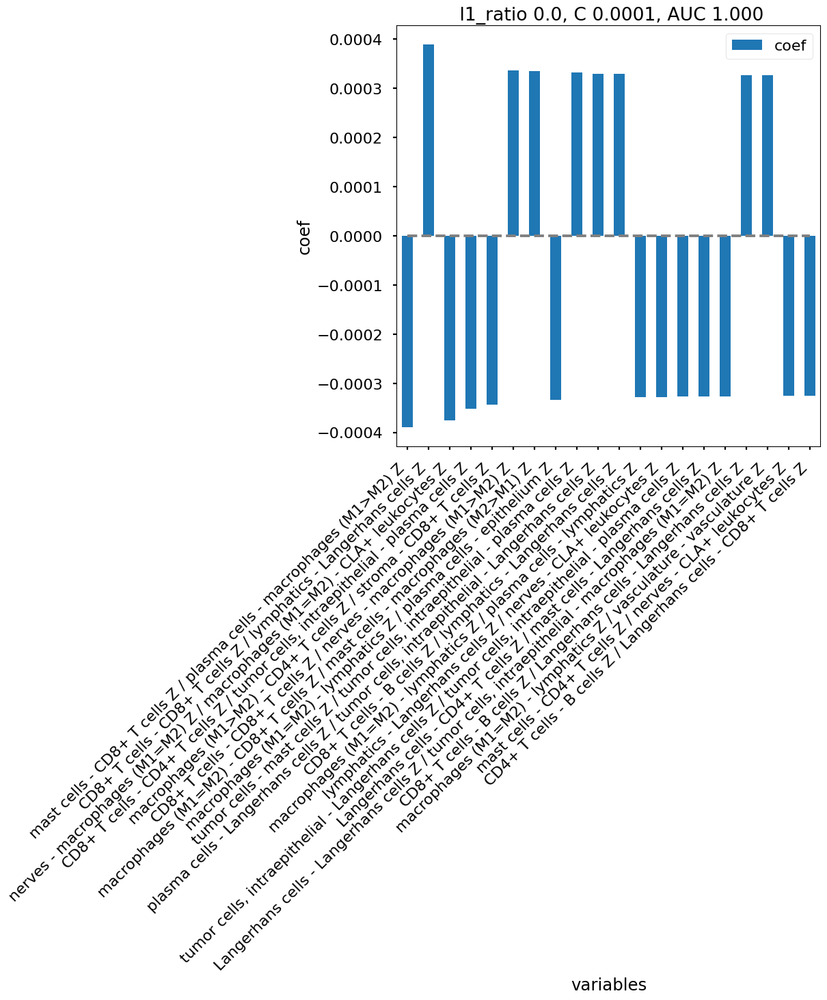

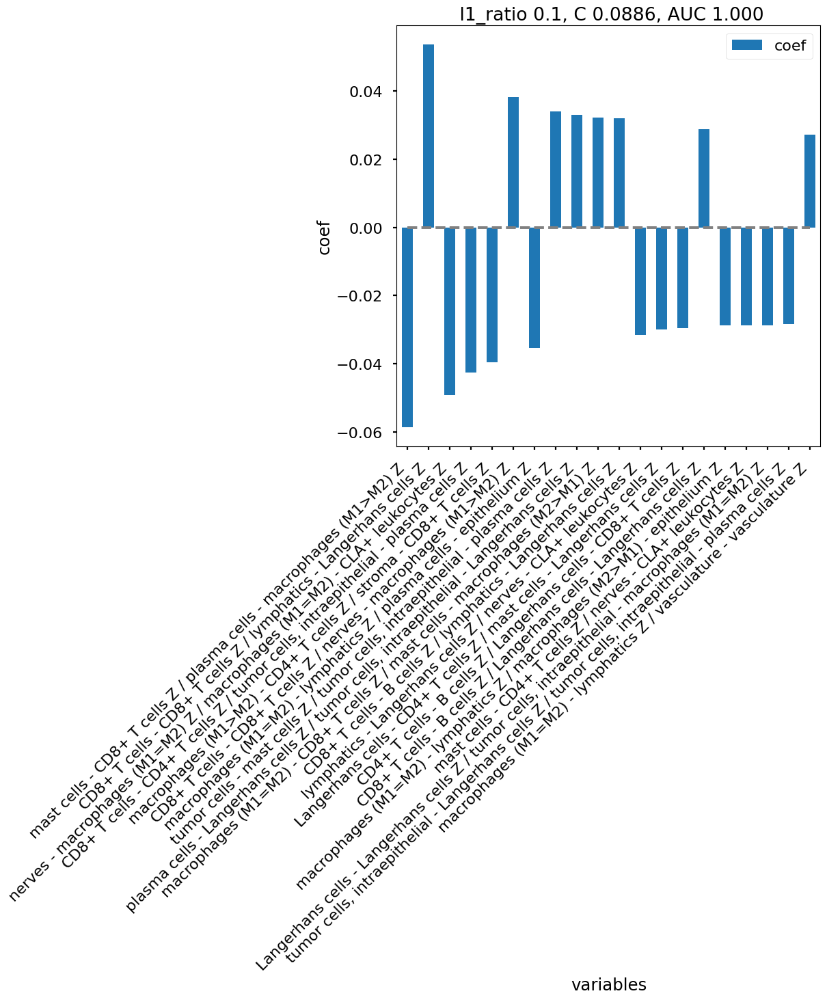

In [261]:
# Train ML model with the best variables

models = mosna.logistic_regression(
    z_net_stats_comp[best_pval_names],
    y_name=group_col,
    col_drop=[patient_col],
    cv_train=4, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    )

### Marker-positive cells interactions

We can also compute the mixing matrix and assortativity between marker-positive cells.

## Cellular neighborhoods

The mixing matrix and assortativity give us information about the global network organization.  
Here we will see how to use the *Neighbors Aggregation Statistics* method to find local "cellular communities", or "neighborhoods", or "niches", that can be relevant to understand disease progression or response to therapies.  

#### re-initialization

In [1]:
# For WIP and avoid re-executing individual cells, to be deleted...

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=DeprecationWarning)
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
from time import time
import joblib
from pathlib import Path
from time import time
from tqdm import tqdm
import copy
import matplotlib as mpl
import napari
import colorcet as cc
import composition_stats as cs
from sklearn.impute import KNNImputer

from tysserand import tysserand as ty
from mosna import mosna

import matplotlib as mpl
mpl.rcParams["figure.facecolor"] = 'white'
mpl.rcParams["axes.facecolor"] = 'white'
mpl.rcParams["savefig.facecolor"] = 'white'

# If need to reload modules after their modification
from importlib import reload
ty = reload(ty)
mosna = reload(mosna)

RUN_LONG = False

data_dir = Path("../data/raw/CODEX_CTCL")
try:
    objects_path = data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.parquet"
    obj = pd.read_parquet(data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.parquet")
except FileNotFoundError:
    objects_path = data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.xlsx"
    obj = pd.read_excel(objects_path, skiprows=2)
    # for latter use
    obj.to_parquet(data_dir / "41467_2021_26974_MOESM3_ESM_-_Objects.parquet")

# sample_cols = obj.columns[:10]
obj.rename(columns={'X': 'x', 'Y': 'y', 'Z':'z', 'ClusterName': 'cell type'}, inplace=True)
patient_col = 'Patients'
sample_col = 'FileName'
group_col = 'Groups'
pos_cols = ['x', 'y']
pheno_col = 'cell type'  # unique columns with all cell types
sample_cols = [sample_col, pheno_col, patient_col, 'Spots' ,group_col]
marker_cols = obj.columns[9:67]
marker_cols = [x for x in marker_cols if x != 'HOECHST1:Cyc_1_ch_1']
# pos_cols = obj.columns[69:76]
# slices are 5µm thick, so data is pseudo-2D, including z leads to spatial networks reconstruction artifacts
cell_type_cols = list(obj.columns[75:96]) # one-hot encoded cell types
marker_posit_cols = list(obj.columns[100:-1])
all_cols = sample_cols + marker_cols + pos_cols + cell_type_cols + marker_posit_cols
net_cols = pos_cols + [pheno_col] + cell_type_cols + marker_cols
nb_clusters = obj[pheno_col].unique().size

# Select only pre-treatment samples
obj = obj.loc[obj[group_col] < 3, :]
obj.index = np.arange(len(obj))

code_groups = {
  1: 'Responder, pre-treatment',
  2: 'Non-responder, pre-treatment',
  3: 'Responder, post-treatment',
  4: 'Non-responder, post-treatment',
} 

status_path = data_dir / "41467_2021_26974_MOESM5_ESM - Patients_spots_conditons.xlsx"
# status = pd.read_excel(status_path, skiprows=2, usecols=[patient_col, group_col, 'Spots'])
# # samples 5, 25, 36, 37, 40, 44 are missing
# # now inferred from updated data at https://static-content.springer.com/esm/art%3A10.1038%2Fs41467-021-26974-6/MediaObjects/41467_2021_26974_MOESM1_ESM.pdf
# updated_data = [
#     [2, 1, 5],
#     [7, 2, 25],
#     [9, 1, 36],
#     [9, 3, 37],
#     [10, 1, 40],
#     [11, 3, 44],
#     ]
# status = pd.concat([status, pd.DataFrame(updated_data, columns=status.columns)], axis=0)

# status[sample_col] = status['Spots'].apply(lambda x: f'reg{x:03}')
# # pd.set_option('display.max_rows', 100)

# if sample_col in status.columns:
#     status.index = status[sample_col]
#     status.drop(columns=[sample_col], inplace=True)
#     status.index.name = 'id'
# status.sort_values('Spots')

# When status had too many missing values after first data release:
# we make a status dataframe from the objects dataframe
status = obj[[sample_col, patient_col, group_col, 'Count', 'Spots']].groupby([patient_col, group_col, 'Spots', sample_col]).count().reset_index()
if sample_col in status.columns:
    status.index = status[sample_col]
    status.drop(columns=[sample_col], inplace=True)
    status.index.name = sample_col

# Drop sample with too few cells
# net_size_threshold = 300
net_size_threshold = 0    # no filtering
status = status.loc[status['Count'] >= net_size_threshold, :]
status.sort_values('Spots')
# status.drop(columns=['Count'], inplace=True)

# update the `object` dataframe
uniq_filenames = set(status.index)
obj = obj.query("FileName in @uniq_filenames")

pd.set_option('display.max_rows', 10)


survival_path = data_dir / "cohort_response.ods"
surv = pd.read_excel(survival_path)
surv.index = surv['Patient ID']
surv.drop(columns=['Patient ID'], inplace=True)
surv.index.name = patient_col


# make common color mapper
cycle_cmap = False

nodes_labels = obj[pheno_col]
uniq = pd.Series(nodes_labels).value_counts().index

processed_dir = Path('../data/processed/CODEX_CTCL')
dir_fig_save = processed_dir / 'figures'


trim_dist = 200 # or 'percentile_size'
min_neighbors = 3 # number of nearest nodes to connect for each unconneted node

reconst_dir = processed_dir / f"pretreatment_samples_networks_xy_min_size-{net_size_threshold}_solitary-{min_neighbors}"
save_dir = reconst_dir / "networks_images_common_cmap_saturated_first"
save_dir.mkdir(parents=True, exist_ok=True)
edges_dir = reconst_dir
nodes_dir = reconst_dir

uniq_patients = obj[patient_col].unique()
uniq_samples = obj[sample_col].unique()
n_uniq_patients = len(uniq_patients)
n_uniq_samples = len(uniq_samples)

# we add attributes to nodes to color network figures
nodes_all = obj[pos_cols + [pheno_col]].copy()
nodes_all = nodes_all.join(pd.get_dummies(obj[pheno_col]))
uniq_phenotypes = nodes_all[pheno_col].unique() 

count_types = obj[[patient_col, group_col, 'Count']].join(nodes_all[pheno_col]).groupby([patient_col, group_col, pheno_col]).count().unstack()
count_types.columns = count_types.columns.droplevel()
count_types = count_types.fillna(value=0).astype(int)
total_count_types = count_types.sum().sort_values(ascending=False)
prop_types = count_types.div(count_types.sum(axis=1), axis=0)

# With this dataset, when we filter networks without enough nodes
# we can't split patients in 5 groups having at least one occurrence
# of both groups (one patient of group 2 is deleted).

if net_size_threshold == 300:
    cv_train = 4
    cv_adapt = False
    cv_max = 4
else:
    cv_train = 5
    cv_adapt = False
    cv_max = 5

fig_step = '04_niches'


### On markers

In [2]:
nodes_dir = Path('../data/processed/CODEX_CTCL/pretreatment_samples_networks_xy_min_size-0_solitary-3/transfo-clr/batch_correction-scanorama_on-patient/')

In [3]:
method = 'NAS'
# method = 'SCAN-IT'

order = 1
var_type = 'markers'
stat_funcs='default'
stat_names='default'
# stat_funcs = np.mean
# stat_names = 'mean'
# aggreg_vars = marker_cols

# directory of spatial omic features
if method == 'NAS':
    sof_dir = nodes_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
    sof_dir.mkdir(parents=True, exist_ok=True)
elif method == 'SCAN-IT':
    sof_dir = nodes_dir / f"scanit_on-{var_type}"    
    sof_dir.mkdir(parents=True, exist_ok=True)

# For UMAP visualization
marker = '.'
size_points = 10

# read column names in stored nodes files
node_file = list(nodes_dir.glob('nodes_*.parquet'))[0]
attributes_col = pd.read_parquet(node_file).columns[:-2]

In [4]:
attributes_col

Index(['x', 'y', 'cell type', 'B cells', 'CD4+ T cells', 'CD8+ T cells',
       'CLA+ leukocytes', 'DCs, CD11c+', 'IDO+ stromal cells',
       'Langerhans cells', 'Tregs', 'epithelium', 'lymphatics',
       'macrophages (M1=M2)', 'macrophages (M1>M2)', 'macrophages (M2>M1)',
       'mast cells', 'nerves', 'neutrophils', 'plasma cells', 'stroma',
       'tumor cells', 'tumor cells, intraepithelial', 'vasculature', 'FOXP3',
       'GATA3', 'MUC-1', 'Vimentin', 'T-bet', 'CD62L', 'Cytokeratin', 'PD-L1',
       'Ki-67', 'CD15', 'CD30', 'CD2', 'GranzymeB', 'CD5', 'CD39', 'MMP9',
       'CD4', 'LAG3', 'CD25', 'CD56', 'CD20', 'PD-1', 'CD11c', 'CLA-CD162',
       'IDO-1', 'VISTA', 'HLA-DR', 'ICOS', 'BCL-2', 'CD3', 'CD69', 'CD8',
       'CD7', 'CD45RA', 'CD45', 'CD1a', 'CD57', 'B-catenin', 'CD45RO', 'CD71',
       'CD34', 'CD68', 'CD38', 'CollagenIV', 'CD31', 'Podoplanin', 'CD138',
       'CD163', 'Mastcell-tryptase', 'MMP12', 'CD164', 'p53', 'CCR6', 'CD16',
       'CD11b', 'CCR4', 'EGFR'],
    

In [5]:
filename = sof_dir / f'aggregation_statistics.parquet'

if filename.exists():
    print('Load aggregation statistics')
    var_aggreg = pd.read_parquet(filename)
else:
    var_aggreg = mosna.compute_spatial_omic_features_all_networks(
        method=method,
        nodes_dir=nodes_dir,
        edges_dir=edges_dir, 
        attributes_col=attributes_col, 
        use_attributes=marker_cols, # use all attributes 
        make_onehot=False, 
        stat_funcs=stat_funcs,
        stat_names=stat_names,
        id_level_1='patient',
        save_intermediate_results=False, 
        dir_save_interm=None,
        verbose=1,
        # memory_limit='1GB',
        )
    var_aggreg.to_parquet(filename, index=False)

Load aggregation statistics


In [6]:
# retrieve network info and remove it from NAS table
var_aggreg_samples_info = var_aggreg[['patient', 'sample']]
var_aggreg.drop(columns=['patient', 'sample'], inplace=True)

In [7]:
pd.set_option('display.max_rows', 10)

In [8]:
var_aggreg

,FOXP3 mean,GATA3 mean,MUC-1 mean,Vimentin mean,T-bet mean,CD62L mean,Cytokeratin mean,PD-L1 mean,Ki-67 mean,CD15 mean,...,CD163 std,Mastcell-tryptase std,MMP12 std,CD164 std,p53 std,CCR6 std,CD16 std,CD11b std,CCR4 std,EGFR std
0,0.051929,0.020772,0.143854,0.114105,0.063696,-0.029824,-0.054979,-0.174515,0.102320,-0.051192,...,0.071924,0.053871,0.040228,0.017292,0.009788,0.035631,0.014495,0.023713,0.121012,0.012793
1,0.030949,0.020868,0.103542,0.109624,0.094377,-0.010374,-0.028705,-0.219838,0.124533,-0.039827,...,0.022474,0.053976,0.052094,0.036259,0.005400,0.023135,0.051291,0.013761,0.142735,0.027163
2,0.047038,0.018171,0.143875,0.098401,0.078787,-0.017430,0.025349,-0.216158,0.110923,-0.051625,...,0.083224,0.049045,0.066538,0.009928,0.003357,0.026004,0.112810,0.012135,0.094783,0.024149
3,0.075300,0.040729,0.129774,0.107679,0.068932,-0.023587,-0.016752,-0.220682,0.100538,-0.037418,...,0.085097,0.033951,0.074406,0.018837,0.008119,0.035856,0.011793,0.008725,0.067492,0.017646
4,0.080212,0.001324,0.135504,0.107500,0.073880,-0.040149,0.009726,-0.196033,0.105935,-0.034791,...,0.077400,0.050277,0.070841,0.053142,0.012311,0.035975,0.011338,0.017062,0.114786,0.014883
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38060,0.086637,-0.010136,0.138054,0.067018,0.083059,-0.067397,0.053803,-0.177677,0.110275,-0.040961,...,0.017854,0.015227,0.044064,0.012310,0.013274,0.028051,0.006623,0.012730,0.062015,0.009160
38061,0.020715,0.035064,0.150269,0.116261,0.072845,-0.012741,0.017578,-0.241258,0.110400,-0.027556,...,0.017980,0.053749,0.086857,0.053231,0.015831,0.025305,0.074165,0.008851,0.101246,0.013351
38062,0.056651,0.040472,0.142154,0.108011,0.079002,-0.009502,0.006976,-0.210690,0.109395,-0.037599,...,0.040363,0.071312,0.066242,0.011296,0.014940,0.027676,0.093624,0.020682,0.109082,0.009892
38063,-0.008281,0.055926,0.148055,0.114563,0.071210,-0.006853,-0.058583,-0.227113,0.109383,-0.020025,...,0.011276,0.032378,0.033625,0.033382,0.005845,0.011419,0.012520,0.015343,0.102535,0.006073


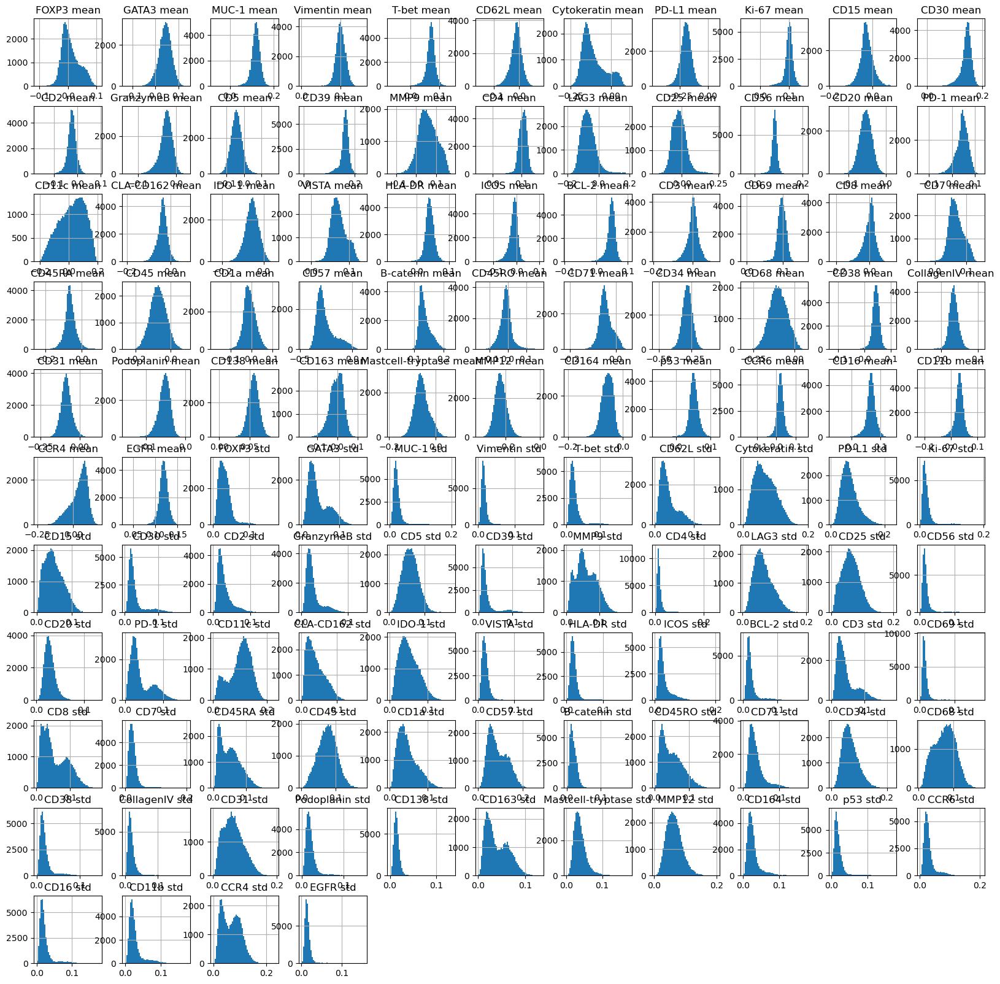

In [35]:
var_aggreg.hist(bins=50, figsize=(20, 20));

In [ ]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 15, 
    'metric': 'cosine', #'manhattan', # or 'euclidean',
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.05,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

Loading reducer object and reduced coordinates


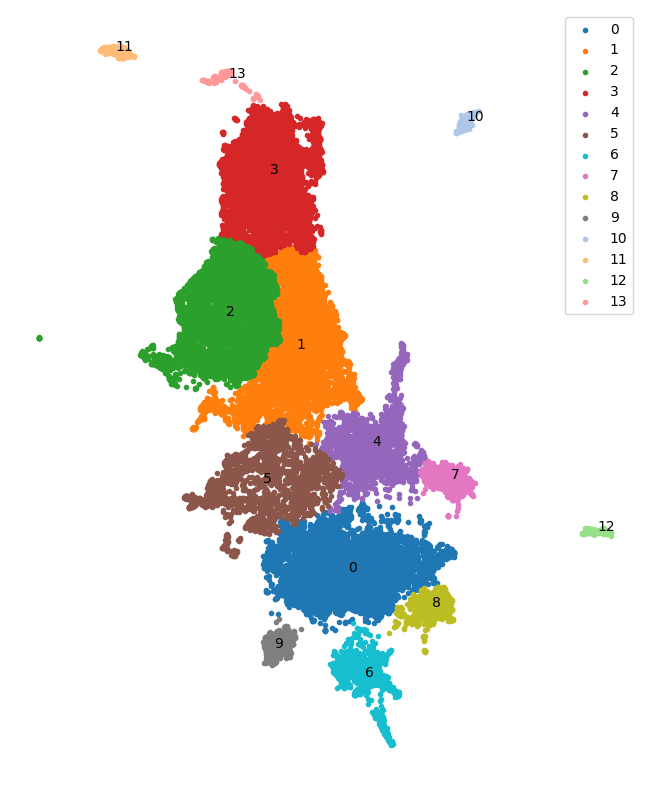

In [ ]:
embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels, 
    sof_dir, 
    cluster_params=cluster_params, 
    return_cmap=True,
    )

In [ ]:
# save_dir = cluster_dir / 'spatial_networks_niches'
# save_dir.mkdir(parents=True, exist_ok=True)

# # colormap for cell-types
# n_cell_types = obj[pheno_col].unique().size
# # palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
# # palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]
# niche_colors = np.array([niches_color_mapper[x] for x in cluster_labels])

# plots_marker = '.'
# for sample in obj[sample_col].unique():
#     print("filename: {}".format(sample))
#     select = np.array(obj[sample_col] == sample)

#     # load nodes and edges
#     coords = obj.loc[select, pos_cols].values
#     # TODO: find a way to reuse pairs compatible with aggregated nodes
#     # pairs = edges_all.loc[edges_all[sample_col] == sample, ['source', 'target']].values
#     pairs = ty.build_delaunay(coords, trim_dist=trim_dist)
#     if k_sol > 0:
#         pairs = ty.link_solitaries(coords, pairs, method='knn', k=k_sol)

#     # Big summary plot
#     fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
#     i = 0
#     ty.plot_network(coords, 
#                     pairs,
#                     labels=obj.loc[select, pheno_col], 
#                     color_mapper=celltypes_color_mapper, 
#                     marker=plots_marker, 
#                     size_nodes=size_points, 
#                     ax=ax[0])
#     ax[i].set_title('Spatial map of phenotypes', fontsize=14);

#     i += 1
#     ax[i].scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points)
#     ax[i].set_title('Spatial map of detected areas', fontsize=14);
#     ax[i].set_aspect('equal')

#     i += 1
#     ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=niche_colors[select], s=5);
#     ax[i].set_title("Clustering on NAS", fontsize=14);
#     ax[i].set_aspect('equal')

#     i += 1
#     ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=niche_colors);
#     ax[i].set_title("Clustering on NAS of all samples", fontsize=14);
#     ax[i].set_aspect('equal')
    
#     # make plot limits equal
#     ax[i-1].set_xlim(ax[i].get_xlim())
#     ax[i-1].set_ylim(ax[i].get_ylim())

#     suptitle = f"Spatial omics data and detected areas - sample {sample}";
#     fig.suptitle(suptitle, fontsize=18)

#     fig.savefig(save_dir / suptitle, bbox_inches='tight', facecolor='white', dpi=300)
#     plt.show()

#### Screen clustering parameters

In [9]:
group_remapper = {2: 0, # non-responders
                  1: 1} # responders
group_cat_mapper = {0: 'Non-responder',
                    1: 'Responder'}
group_cat_mapper_rev = {val: key for key, val in group_cat_mapper.items()}

In [10]:
# predict_key = 'patient'
predict_key = 'sample'
group_col_cat = 'Response status'

if predict_key == 'patient':
    var_label = patient_col
    status_pred = surv[[group_col_cat]]
    status_pred[group_col] = status_pred[group_col_cat].map(group_cat_mapper_rev)
elif predict_key == 'sample':
    var_label = sample_col
    status_pred = status.copy()
    status_pred[group_col] = status_pred[group_col].map(group_remapper)
    status_pred[group_col_cat] = status_pred[group_col].map(group_cat_mapper)

status_pred

,Patients,Groups,Spots,Count,Response status
FileName,,,,,
reg001,1,1,1,1301,Responder
reg002,1,1,2,2324,Responder
reg005,2,1,5,112,Responder
reg006,2,1,6,603,Responder
reg009,3,0,9,2334,Non-responder
...,...,...,...,...,...
reg046,12,0,46,808,Non-responder
reg051,13,1,51,1082,Responder
reg052,13,1,52,1707,Responder


In [11]:
#%% Define space of hyperparameters search

plot_heatmap = True
plot_alphas = False
plot_best_model_coefs = False
train_model = True
recompute = False
verbose = 1

DEBUG = False
if DEBUG:
    verbose = 2
    
show_progress = False
n_jobs_gridsearch = -1

columns = ['dim_clust', 'n_neighbors', 'metric', 'clusterer_type', 'k_cluster', 'clust_size_param', 'n_clusters', 'normalize', 'l1_ratio', 'alpha', 'score_roc_auc', 'score_ap', 'score_mcc']
col_types = {
    'dim_clust': int,
    'n_neighbors': int,
    'metric': 'category',
    'k_cluster': int,
    'clusterer_type': 'category',
    'clust_size_param': float,
    'n_clusters': int,
    'normalize': 'category',
    'l1_ratio': float,
    'alpha': float,
    'score_roc_auc': float, 
    'score_ap': float, 
    'score_mcc': float,
    }

l1_ratios = [.1, .5, .7, .9, .95, .99, 1]
min_alpha = 0.001
dir_save_interm = sof_dir / f'search_LogReg_on_{predict_key}'
dir_save_interm.mkdir(parents=True, exist_ok=True)

In [ ]:
reducer_type-umap_n_neighbors-200_metric-euclidean_min_dist-0.0_clusterer_type-leiden_dim_clust-3_k_cluster-100_min_cluster_size-0.1


In [14]:

cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 200, 
    'metric': 'euclidean',
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 3, 
    'k_cluster': 100, 
    'min_cluster_size': 0.1,
}

# try:
cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, verbose=verbose, **cluster_params)
n_clusters = len(np.unique(cluster_labels))

# Survival analysis (just heatmap for now)
niches = cluster_labels
if n_clusters > 1:
    for normalize in ['total', 'niche', 'obs', 'clr', 'niche&obs']:
        str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
        str_params = str_params + f'_normalize-{normalize}'

        results_path = dir_save_interm / f'{str_params}.parquet'
        new_model = None
        if results_path.exists() and not recompute:
            if verbose > 1:
                print(f'load {results_path.stem}')
            new_model = pd.read_parquet(results_path)
        else:
            if train_model and n_clusters < 200:
                if verbose > 1:
                    print(f'compute {results_path.stem}')
        
                var_aggreg_niches = var_aggreg_samples_info.copy()
                var_aggreg_niches['niche'] = np.array(niches)

                counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize)
                counts.index = counts.index.astype(status_pred.index.dtype)
                exo_vars = counts.columns.astype(str).tolist()
                df_surv = pd.concat([status_pred, counts], axis=1, join='inner').fillna(0)
                # alternative aggregation
                # df_surv = counts.merge(status_pred, how='inner', on=var_label) 
                df_surv.columns = df_surv.columns.astype(str)
                df_surv.index.name = var_label


Loading clusterer object and cluster labels
There are 1 clusters


In [12]:
RUN_LONG = False

In [13]:
if RUN_LONG:
    print('searching hyperparameters')
    all_models = []
    # screen NAS parameters
    iter_dim_clust = [2, 3, 4, 5]
    if show_progress:
        iter_dim_clust = tqdm(iter_dim_clust, leave=False)
    for dim_clust in iter_dim_clust:
        iter_n_neighbors = [15, 45, 75, 100, 200]
        if show_progress:
            iter_n_neighbors = tqdm(iter_n_neighbors, leave=False)
        for n_neighbors in iter_n_neighbors:
            iter_metric = ['manhattan', 'euclidean', 'cosine']
            if show_progress:
                iter_metric = tqdm(iter_metric, leave=False)
            for metric in iter_metric:
                iter_k_cluster = [x for x in iter_n_neighbors if x <= n_neighbors]
                if show_progress:
                    iter_k_cluster = tqdm(iter_k_cluster, leave=False)
                for k_cluster in iter_k_cluster:
                    # iter_clusterer_type = ['hdbscan', 'spectral', 'ecg', 'leiden', 'gmm']
                    # iter_clusterer_type = ['spectral', 'ecg', 'leiden', 'gmm']
                    iter_clusterer_type = ['leiden']
                    if show_progress:
                        iter_clusterer_type = tqdm(iter_clusterer_type, leave=False)
                    for clusterer_type in iter_clusterer_type:

                        if clusterer_type == 'spectral':
                            clust_size_param_name = 'n_clusters'
                            if DEBUG:
                                iter_clust_size_param = range(3, 6)
                            else:
                                iter_clust_size_param = range(3, 20)
                        elif clusterer_type == 'leiden':
                            clust_size_param_name = 'min_cluster_size'
                            iter_clust_size_param = [0.1, 0.03, 0.01, 0.003, 0.001]
                        elif clusterer_type == 'hdbscan':
                            clust_size_param_name = 'resolution'
                            iter_clust_size_param = [0.1, 0.03, 0.01, 0.003, 0.001]
                        elif clusterer_type == 'ecg':
                            clust_size_param_name = 'ecg_ensemble_size'
                            iter_clust_size_param = [20]
                        if clusterer_type == 'gmm':
                            clust_size_param_name = 'n_clusters'
                            iter_clust_size_param = range(3, 20)
                        
                        if show_progress:
                            iter_clust_size_param = tqdm(iter_clust_size_param, leave=False)
                        for clust_size_param in iter_clust_size_param:
                            cluster_params = {
                                'reducer_type': 'umap', 
                                # 'reducer_type': 'none', 
                                'n_neighbors': n_neighbors, 
                                'metric': metric,
                                'min_dist': 0.0,
                                'clusterer_type': clusterer_type, 
                                'dim_clust': dim_clust, 
                                'k_cluster': k_cluster, 
                                # 'flavor': 'CellCharter',
                                clust_size_param_name: clust_size_param,
                            }
                            str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
                            print(str_params)

                            # try:
                            cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, verbose=verbose, **cluster_params)
                            n_clusters = len(np.unique(cluster_labels))
                            
                            # Survival analysis (just heatmap for now)
                            niches = cluster_labels
                            if n_clusters > 1:
                                for normalize in ['total', 'niche', 'obs', 'clr', 'niche&obs']:
                                    str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
                                    str_params = str_params + f'_normalize-{normalize}'

                                    results_path = dir_save_interm / f'{str_params}.parquet'
                                    new_model = None
                                    if results_path.exists() and not recompute:
                                        if verbose > 1:
                                            print(f'load {results_path.stem}')
                                        new_model = pd.read_parquet(results_path)
                                    else:
                                        if train_model and n_clusters < 200:
                                            if verbose > 1:
                                                print(f'compute {results_path.stem}')
                                    
                                            var_aggreg_niches = var_aggreg_samples_info.copy()
                                            var_aggreg_niches['niche'] = np.array(niches)

                                            counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize)
                                            counts.index = counts.index.astype(status_pred.index.dtype)
                                            exo_vars = counts.columns.astype(str).tolist()
                                            df_surv = pd.concat([status_pred, counts], axis=1, join='inner').fillna(0)
                                            # alternative aggregation
                                            # df_surv = counts.merge(status_pred, how='inner', on=var_label) 
                                            df_surv.columns = df_surv.columns.astype(str)
                                            df_surv.index.name = var_label

                                            # to model data, not to predict from it, do:
                                            split_train_test = False
                                            models = mosna.logistic_regression(
                                                df_surv[exo_vars + [group_col]],
                                                y_name=group_col,
                                                col_drop=[var_label],
                                                cv_train=cv_train, 
                                                cv_adapt=cv_adapt, 
                                                cv_max=cv_max,
                                                plot_coefs=False,
                                                split_train_test=split_train_test,
                                                )
                                            
                                            score_roc_auc = np.nanmax([models[model_type]['score']['ROC AUC'] for model_type in models.keys()])
                                            score_ap = np.nanmax([models[model_type]['score']['AP'] for model_type in models.keys()])
                                            score_mcc = np.nanmax([models[model_type]['score']['MCC'] for model_type in models.keys()])
                                            print(f'score_roc_auc: {score_roc_auc:.3f}')
                                            
                                            if score_roc_auc >= 0.7:
                                            
                                                best_id = np.argmax([models[model_type]['score']['ROC AUC'] for model_type in models.keys()])
                                                l1_ratio = [models[model_type]['model'].l1_ratio_[0] for model_type in models.keys()][best_id]
                                                alpha = [models[model_type]['model'].C_[0] for model_type in models.keys()][best_id]

                                                if plot_heatmap:
                                                    # make folder to save figures
                                                    path_parts = cluster_dir.parts[-2:]
                                                    dir_save_figures = dir_save_interm
                                                    for part in path_parts:
                                                        dir_save_figures = dir_save_figures / part
                                                    dir_save_figures.mkdir(parents=True, exist_ok=True)

                                                    try:
                                                        g, d = mosna.plot_heatmap(
                                                            # TODO: use group_col_cat instead?
                                                            df_surv[exo_vars + [group_col]].reset_index(), 
                                                            obs_labels=var_label, 
                                                            group_var=group_col, 
                                                            groups=[0, 1],
                                                            group_names=group_cat_mapper,
                                                            figsize=(10, 10),
                                                            z_score=False,
                                                            cmap=sns.color_palette("Reds", as_cmap=True),
                                                            return_data=True,
                                                            )
                                                        figname = f"biclustering_{str_params}_roc_auc-{score_roc_auc:.3f}.jpg"
                                                        plt.savefig(dir_save_figures / figname, dpi=150)
                                                        plt.show()

                                                        g, d = mosna.plot_heatmap(
                                                            df_surv[exo_vars + [group_col]].reset_index(), 
                                                            obs_labels=var_label, 
                                                            group_var=group_col, 
                                                            groups=[0, 1],
                                                            group_names=group_cat_mapper,
                                                            figsize=(10, 10),
                                                            z_score=1,
                                                            cmap=sns.color_palette("Reds", as_cmap=True),
                                                            return_data=True,
                                                            )
                                                        figname = f"biclustering_{str_params}_roc_auc-{score_roc_auc:.3f}_col_zscored.jpg"
                                                        plt.savefig(dir_save_figures / figname, dpi=150)
                                                        plt.show()
                                                    except:
                                                        pass
                                                
                                                new_model = [dim_clust, n_neighbors, metric, clusterer_type, k_cluster, clust_size_param, n_clusters, normalize, l1_ratio, alpha, score_roc_auc, score_ap, score_mcc]
                                        if new_model is None:
                                            # not trained or training failed
                                            new_model = [dim_clust, n_neighbors, metric, clusterer_type, k_cluster, clust_size_param, n_clusters, normalize, -1, -1, -1, -1, -1]
                                        new_model = pd.DataFrame(data=np.array(new_model).reshape((1, -1)), columns=columns)
                                        new_model = new_model.astype(col_types)
                                        new_model.to_parquet(results_path)
                                    
                                    all_models.append(new_model.values)
                                # except Exception as e:
                                #     print(e)
    all_models = pd.DataFrame(all_models, columns=columns)
    all_models = all_models.astype(col_types)
    all_models.to_parquet(dir_save_interm / 'all_models.parquet')
    print('done')
else:
    aggregated_file_path = dir_save_interm / 'all_models.parquet'
    if aggregated_file_path.exists():
        print('Load NAS hyperparameters search results')
        all_models = pd.read_parquet()
    else:
        print('Aggregate NAS hyperparameters search results')
        all_models = [pd.read_parquet(file_path) for file_path in dir_save_interm.glob('*.parquet')]
        all_models = pd.concat(all_models, axis=0).astype(col_types)
        all_models.index = np.arange(len(all_models))

Aggregate NAS hyperparameters search results


In [15]:
print(all_models.shape)

(3656, 13)


In [31]:
all_models.loc[:, ['l1_ratio', 'alpha', 'score_roc_auc', 'score_ap', 'score_mcc']] = all_models.loc[:, ['l1_ratio', 'alpha', 'score_roc_auc', 'score_ap', 'score_mcc']].replace(-1, np.NaN)
all_models = all_models.dropna() 
all_models = all_models.sort_values('score_roc_auc', ascending=False, ignore_index=True)
score_cols = ['score_roc_auc', 'score_ap', 'score_mcc']
print(all_models[score_cols].max())

score_roc_auc    0.919048
score_ap         0.927492
score_mcc        0.723810
dtype: float64


In [32]:
all_models

,dim_clust,n_neighbors,metric,clusterer_type,k_cluster,clust_size_param,n_clusters,normalize,l1_ratio,alpha,score_roc_auc,score_ap,score_mcc
0,5,15,cosine,leiden,15,0.003,9,clr,0.5,29.763514,0.919048,0.927492,0.447619
1,3,15,cosine,leiden,15,0.001,10,clr,0.5,3792.690191,0.919048,0.922252,0.516752
2,3,15,cosine,leiden,15,0.100,10,clr,0.5,3792.690191,0.919048,0.922252,0.516752
3,5,15,cosine,leiden,15,0.010,9,clr,0.5,29.763514,0.919048,0.927492,0.447619
4,3,15,cosine,leiden,15,0.003,10,clr,0.5,3792.690191,0.919048,0.922252,0.516752
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2197,2,75,euclidean,leiden,15,0.100,4,clr,0.5,0.000100,0.700000,0.713945,0.309524
2198,2,75,euclidean,leiden,15,0.030,4,clr,0.5,0.000100,0.700000,0.713945,0.309524
2199,2,75,euclidean,leiden,15,0.010,4,clr,0.5,0.000100,0.700000,0.713945,0.309524
2200,2,75,euclidean,leiden,15,0.003,4,clr,0.5,0.000100,0.700000,0.713945,0.309524


array([[<Axes: title={'center': 'score_roc_auc'}>,
        <Axes: title={'center': 'score_ap'}>],
       [<Axes: title={'center': 'score_mcc'}>, <Axes: >]], dtype=object)

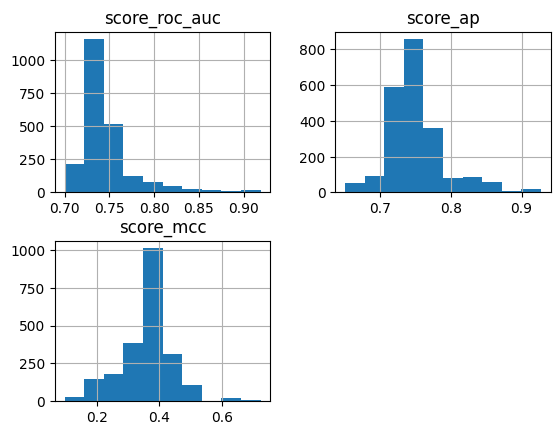

In [33]:
all_models[score_cols].hist(bins=10)

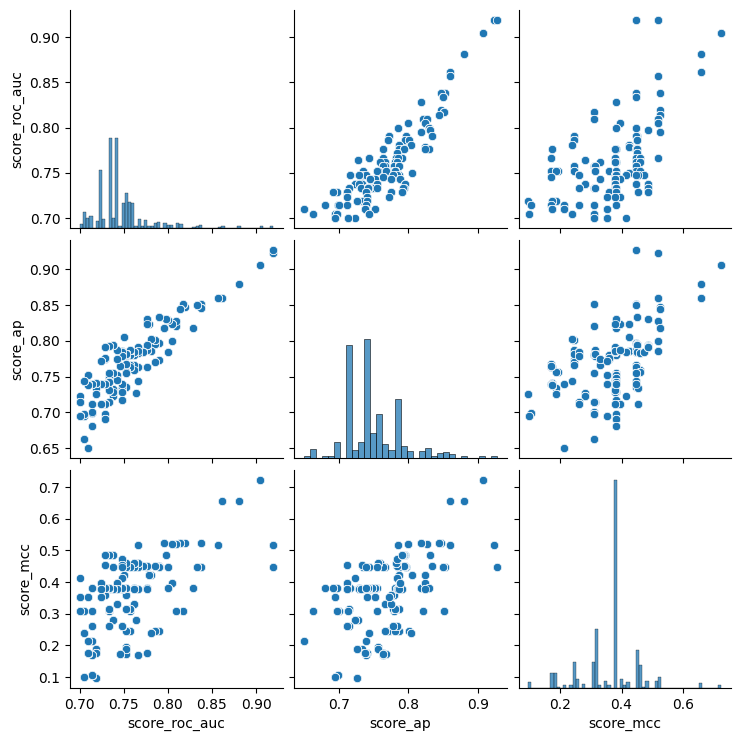

In [34]:
sns.pairplot(all_models[score_cols]);

In [24]:
best_idx = all_models[score_cols[0]].argmax()
# best_idx = 39
best_params = all_models.loc[best_idx, :]
best_params

dim_clust                 2
n_neighbors              15
metric            manhattan
clusterer_type       leiden
k_cluster                15
                    ...    
l1_ratio                0.0
alpha              4.281332
score_roc_auc      0.857143
score_ap           0.337766
score_mcc          0.516752
Name: 0, Length: 13, dtype: object

In [44]:
# list of best models
best_idxs = [np.argsort(all_models[score_col].values)[::-1][:3] for score_col in score_cols]
best_idxs = np.unique(best_idxs)
best_idxs

array([ 0,  1,  2,  3,  6, 11, 12, 19])

In [40]:
def to_number(val):
    """
    Convert a string to a number if possible.

    Example
    -------
    >>> print(to_number('hello'))
    >>> print(to_number('0.1'))
    >>> print(to_number('1.0'))
    """
    try:
        val = float(val)
        if int(val) == val:
            val = int(val)
    finally:
        return val

def get_params_from_str(
    s, 
    ignore_fields=['biclustering'],
    exclude_keys = ['normalize', 'roc_auc'],
    ):
    fields = [x for x in s.split('_') if x not in ignore_fields]

    clean_fields = []
    for i, field in enumerate(fields):
        if '-' not in field:
            try:
                fields[i + 1] = f"{field}_{fields[i + 1]}"
            except:
                print(i)
                print(fields)
        else:
            clean_fields.append(field)

    # make parameters variables
    nas_params = {}
    for field in clean_fields:
        key, val = field.split('-')
        # nas_params[key] = to_number(val)
        nas_params[key] = val

    cluster_params = {key: val for key, val in nas_params.items() if key not in exclude_keys}
    normalize_pred = nas_params['normalize']
    return cluster_params, normalize_pred


In [70]:
best_params_dir = Path('../data/processed/CODEX_CTCL/pretreatment_samples_networks_xy_min_size-0_solitary-3/transfo-clr/batch_correction-scanorama_on-patient/select_nas_on-markers_stats-default_order-1')
save_dir = best_params_dir
file_names = best_params_dir.glob('*.jpg')

In [42]:
cell_types = nodes_all[pheno_col]

Loading clusterer object and cluster labels
There are 16 clusters
Loading reducer object and reduced coordinates


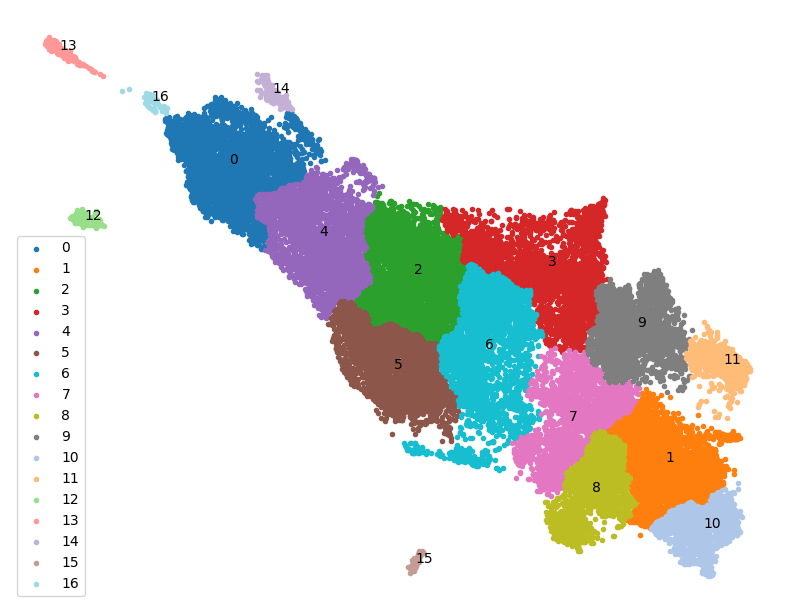

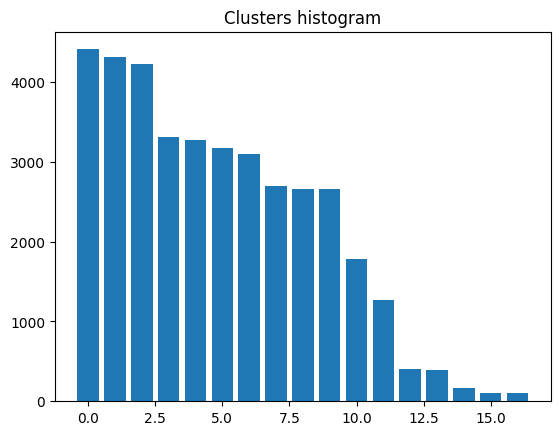

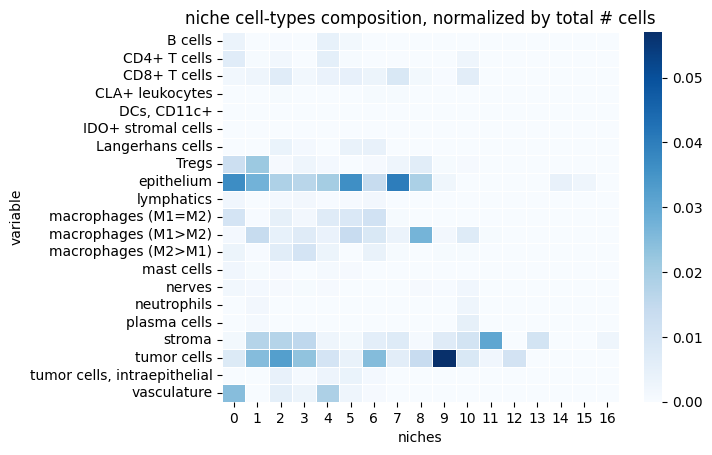

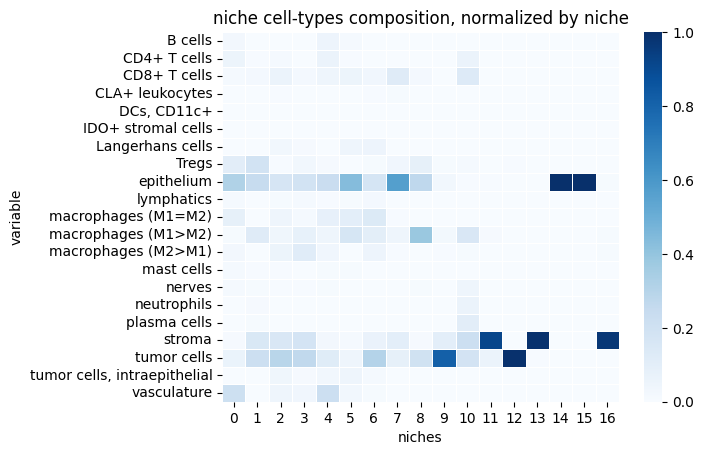

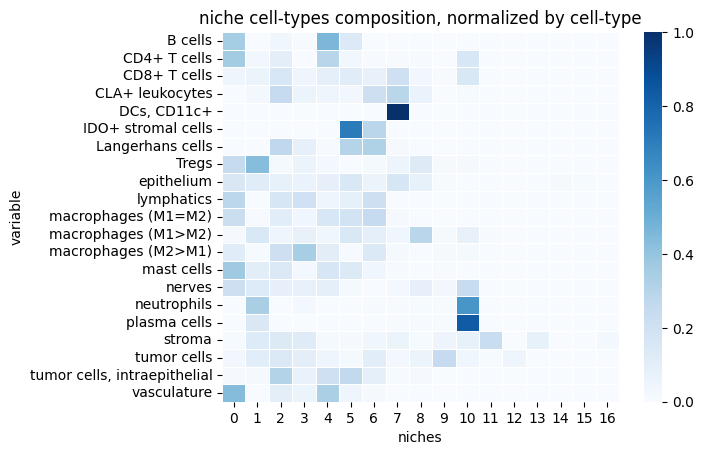

reducer_type-umap_n_neighbors-45_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr


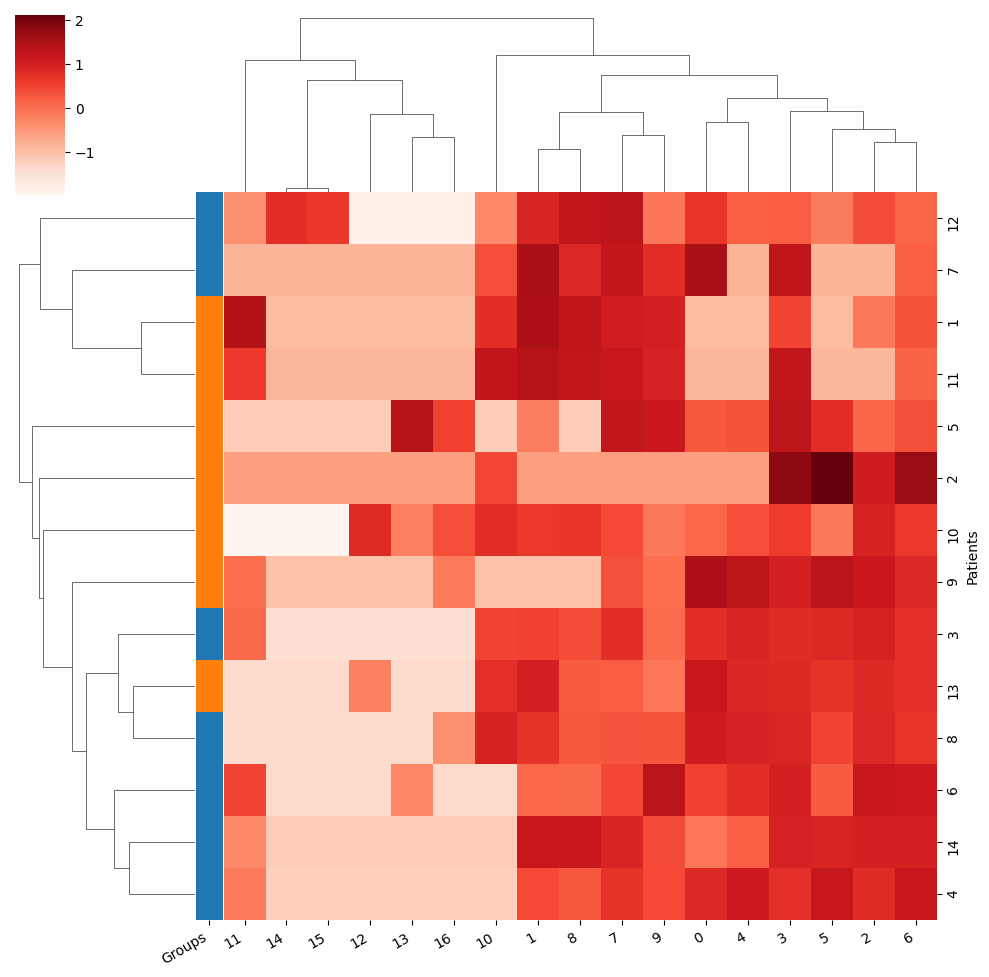

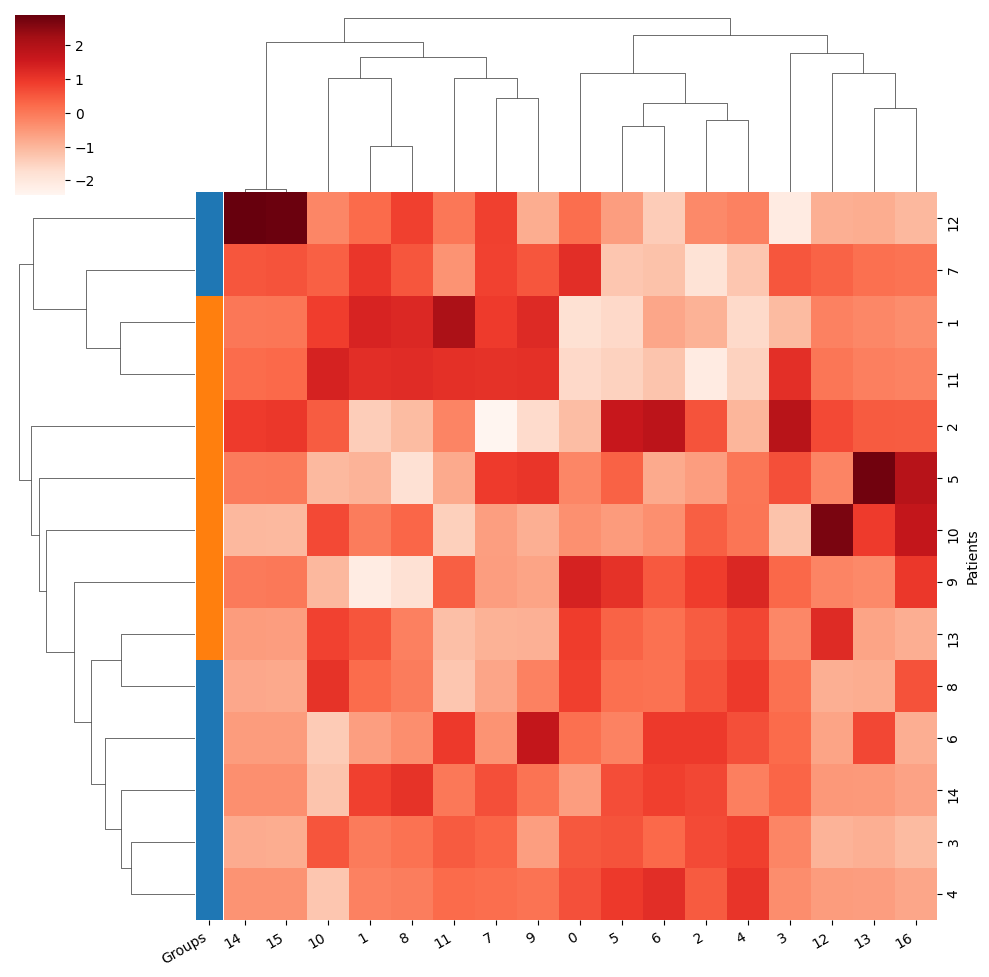

Training took 2.517s


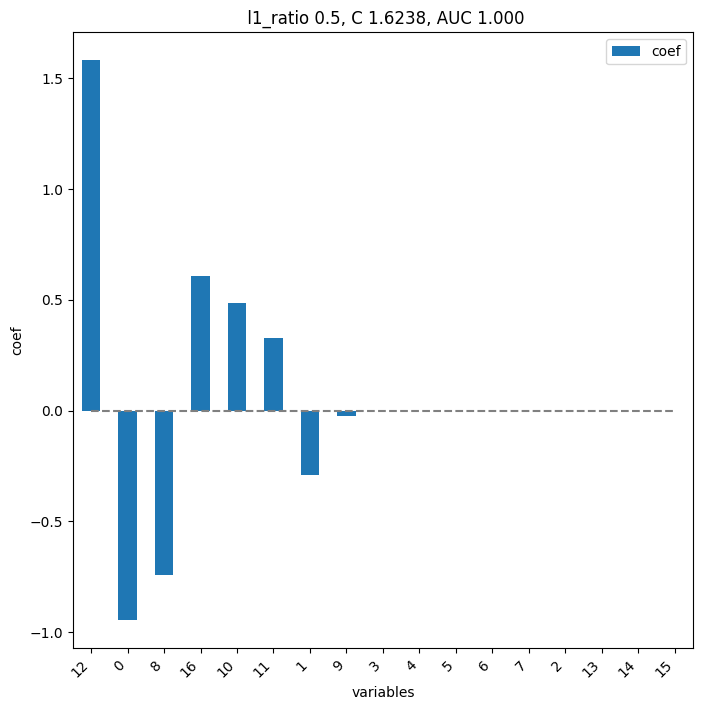

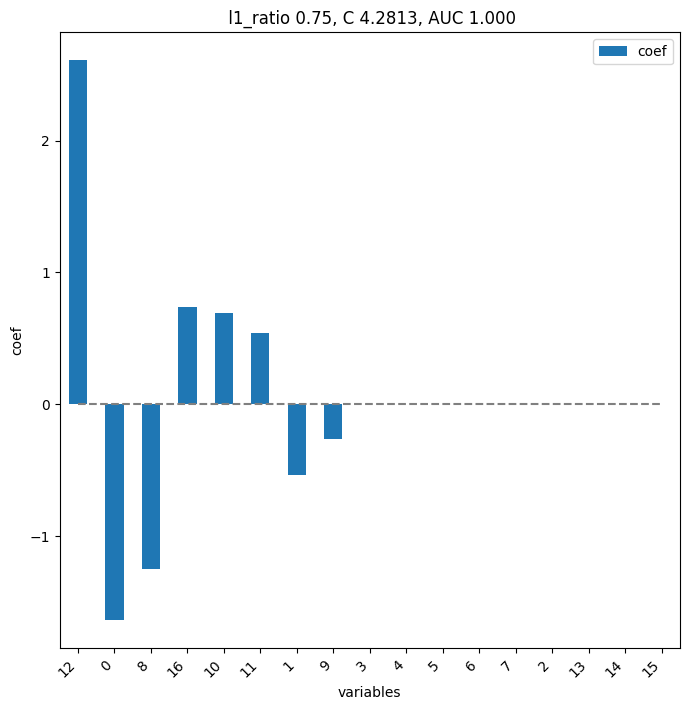

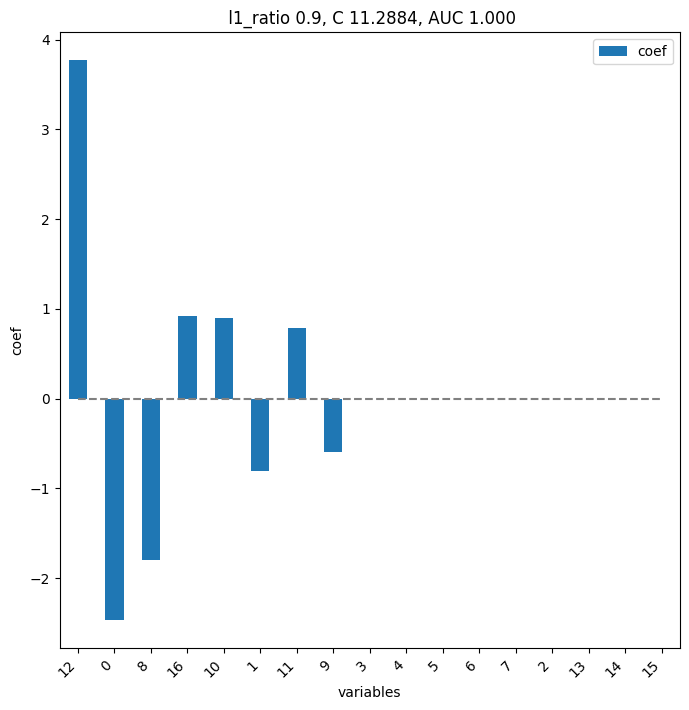

        pval  pval_corr
12  0.006993   0.118881
16  0.072844   0.551476
13  0.097319   0.551476
10  0.164918   0.700903
0   0.259324   0.734751
2   0.259324   0.734751
4   0.455711   0.862596
9   0.534965   0.862596
3   0.534965   0.862596
8   0.534965   0.862596
6   0.710373   0.862596
15  0.710373   0.862596
1   0.710373   0.862596
14  0.710373   0.862596
7   0.901515   0.957860
11  0.901515   0.957860
5   1.000000   1.000000


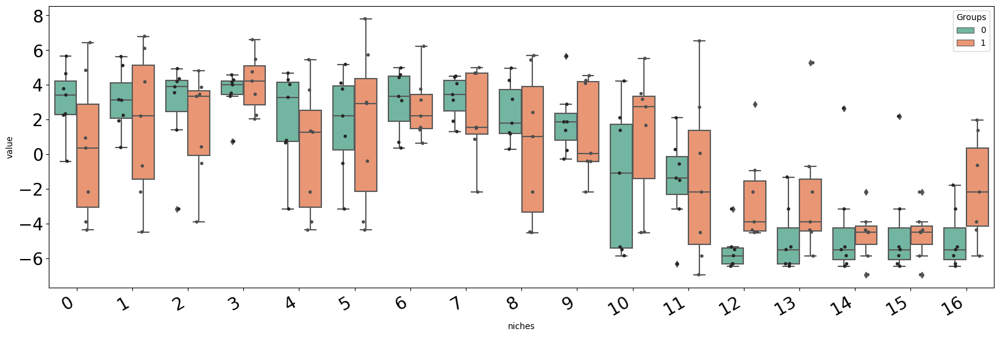

Loading clusterer object and cluster labels
There are 9 clusters
Loading reducer object and reduced coordinates


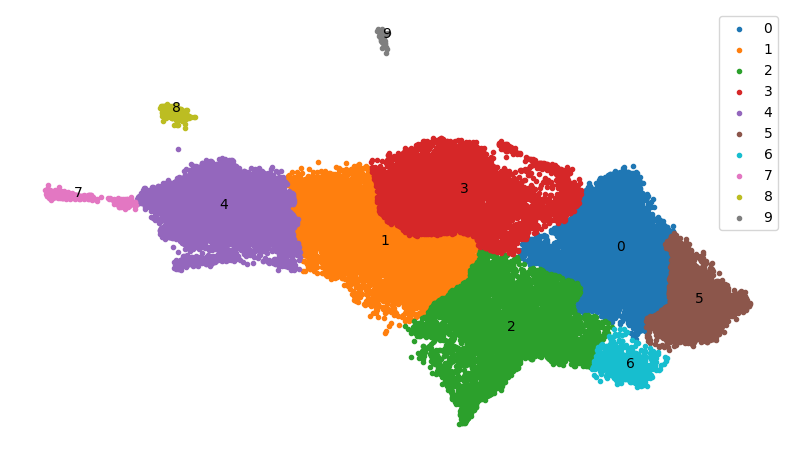

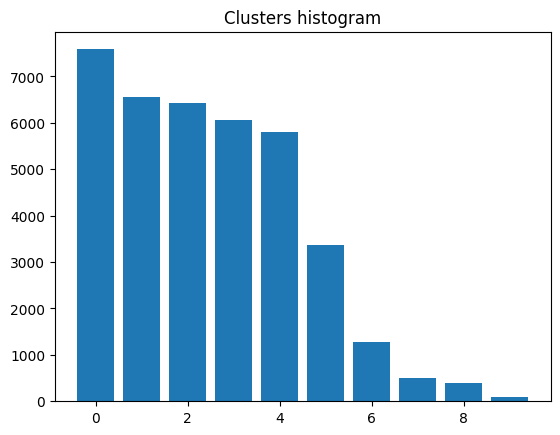

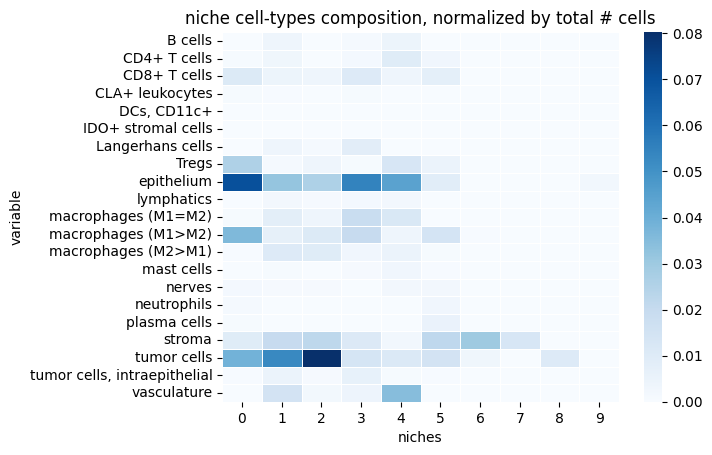

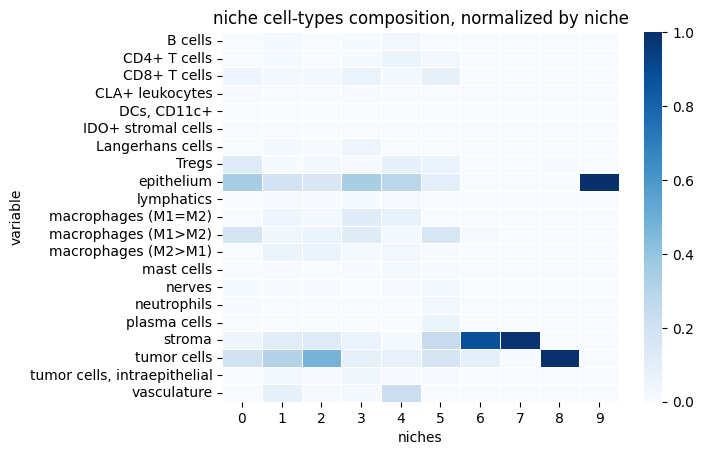

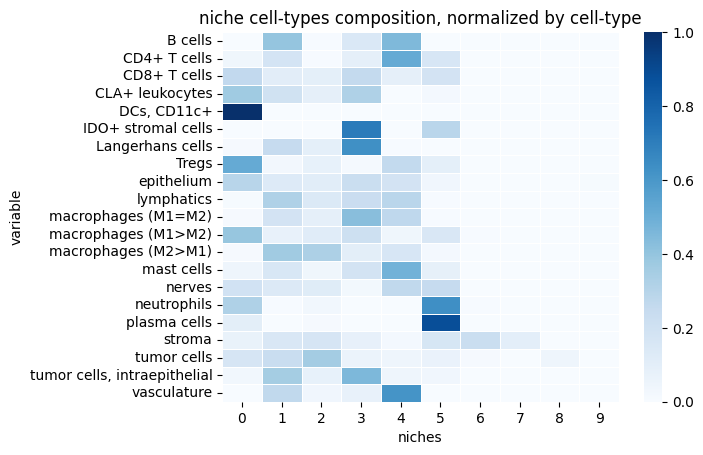

reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr


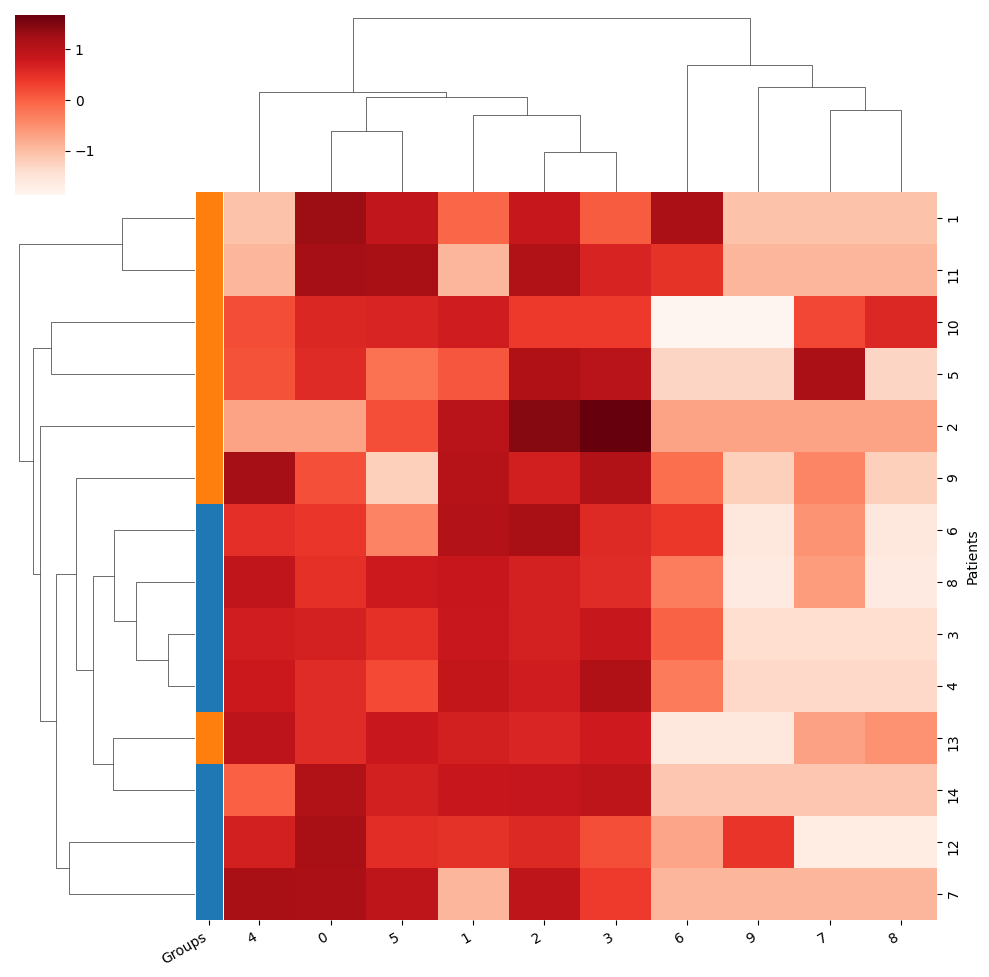

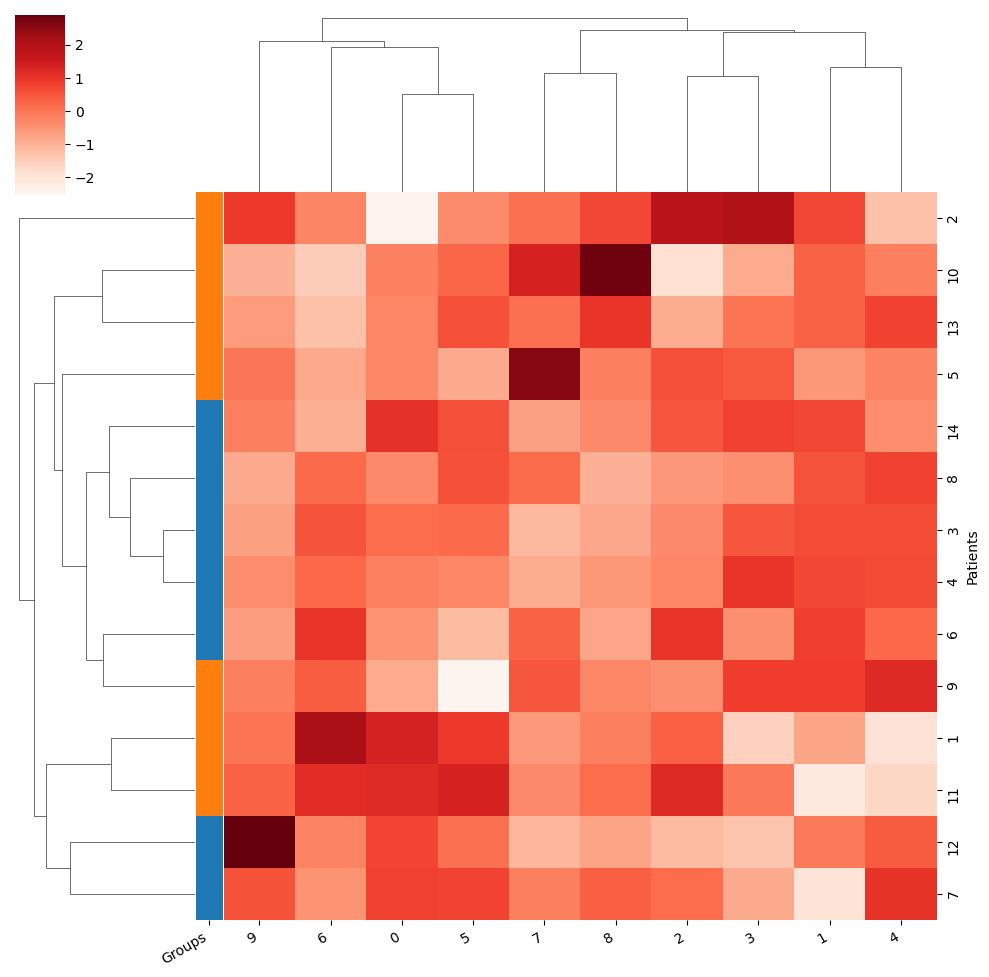

Training took 2.514s


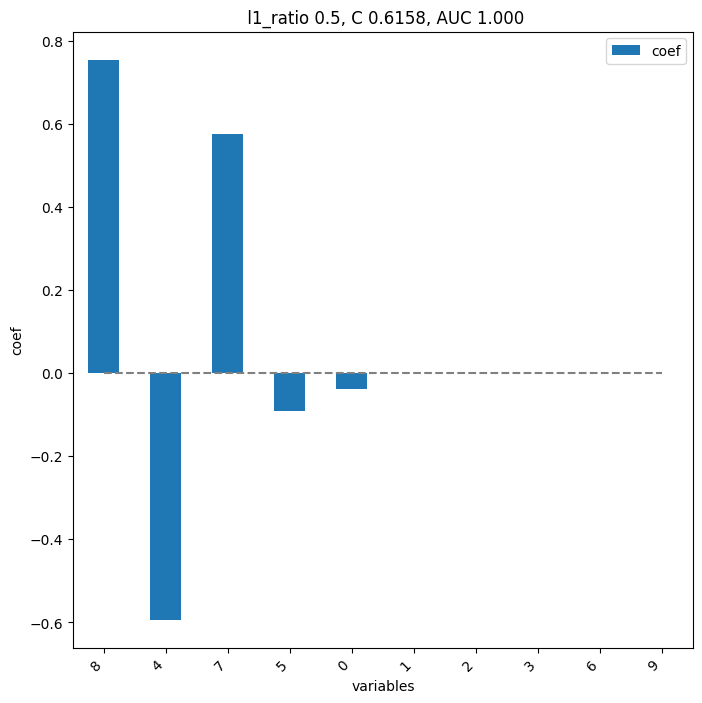

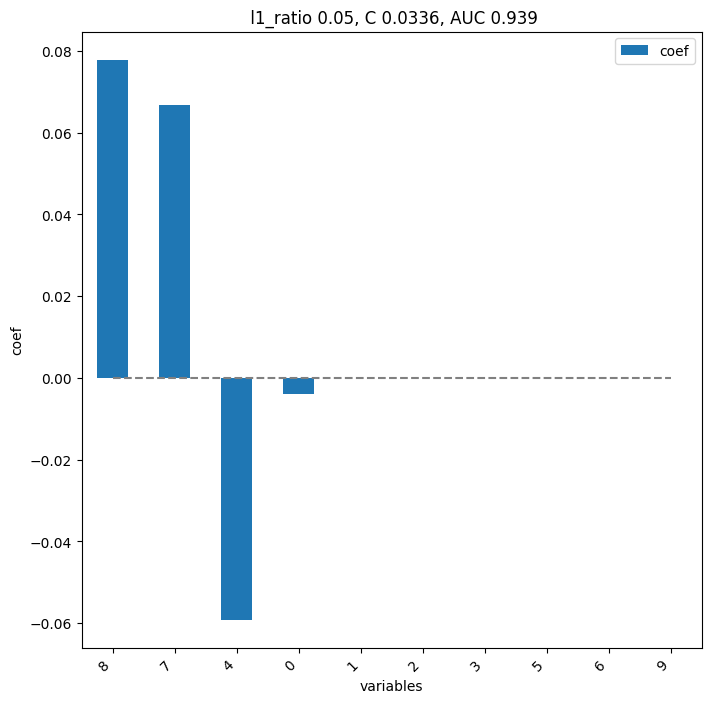

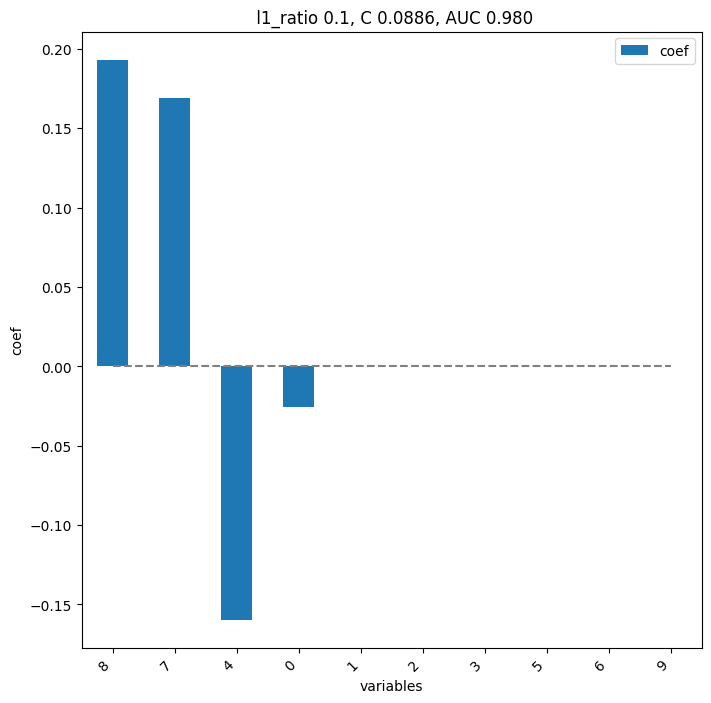

       pval  pval_corr
8  0.006993   0.069930
7  0.072844   0.364219
4  0.259324   0.864413
1  0.534965   1.000000
0  0.620047   1.000000
9  0.620047   1.000000
2  0.710373   1.000000
6  0.804779   1.000000
3  0.901515   1.000000
5  1.000000   1.000000


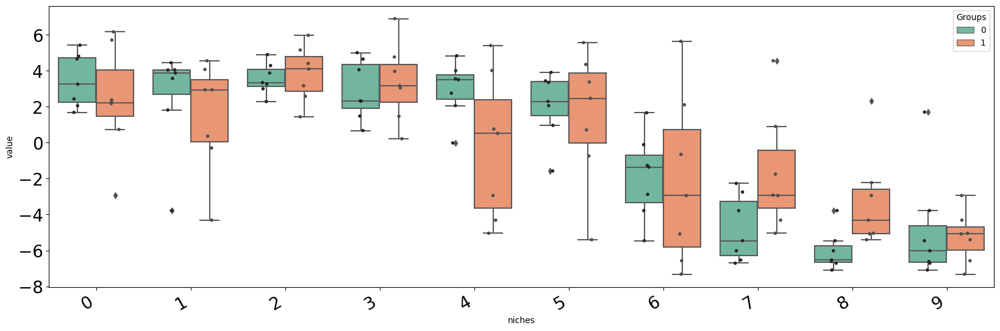

Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


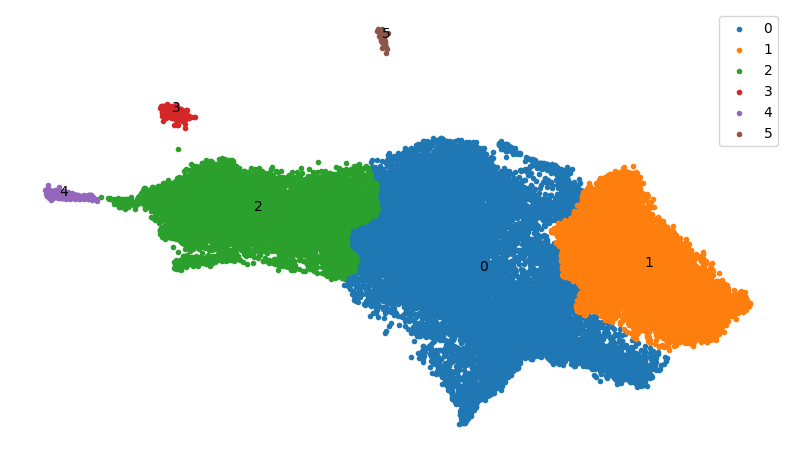

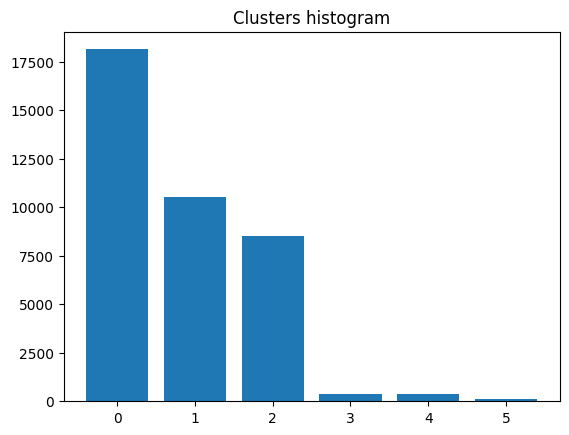

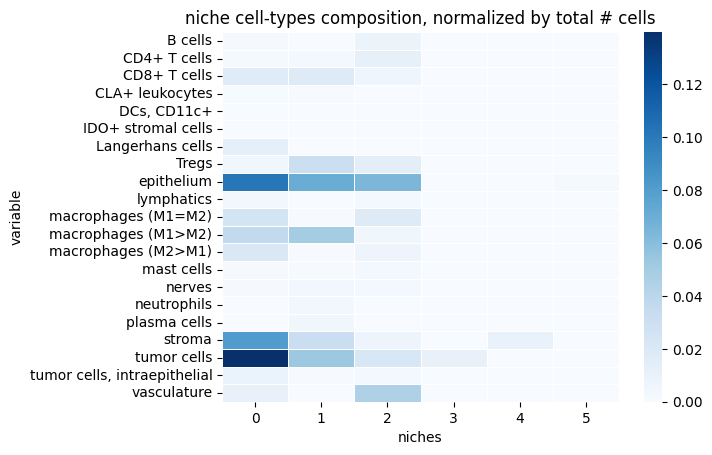

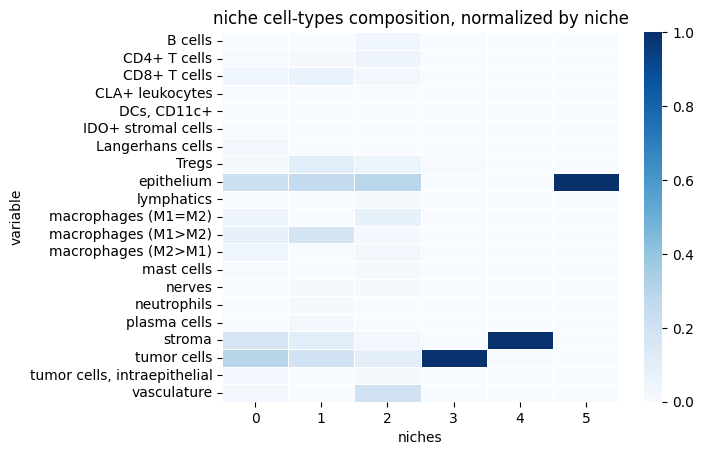

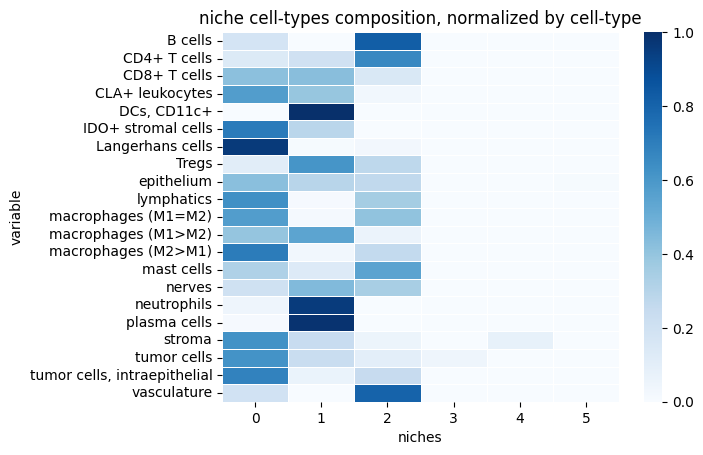

reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


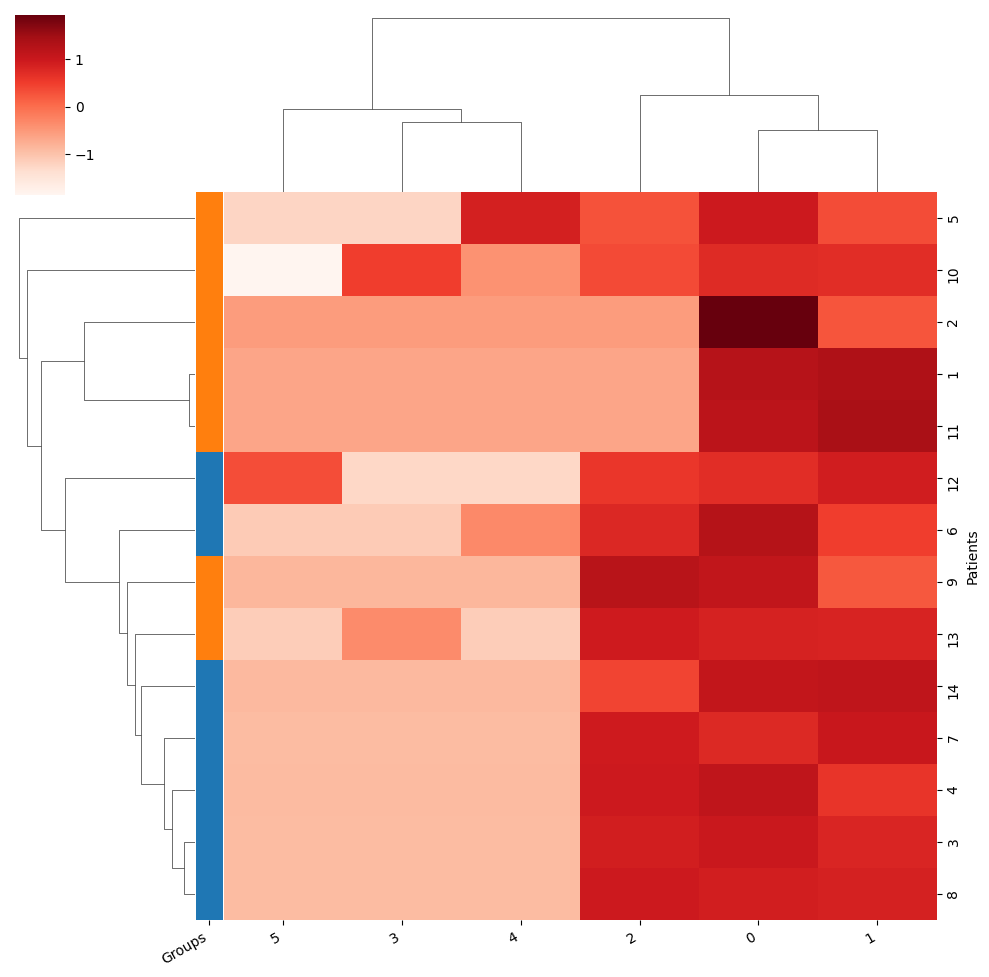

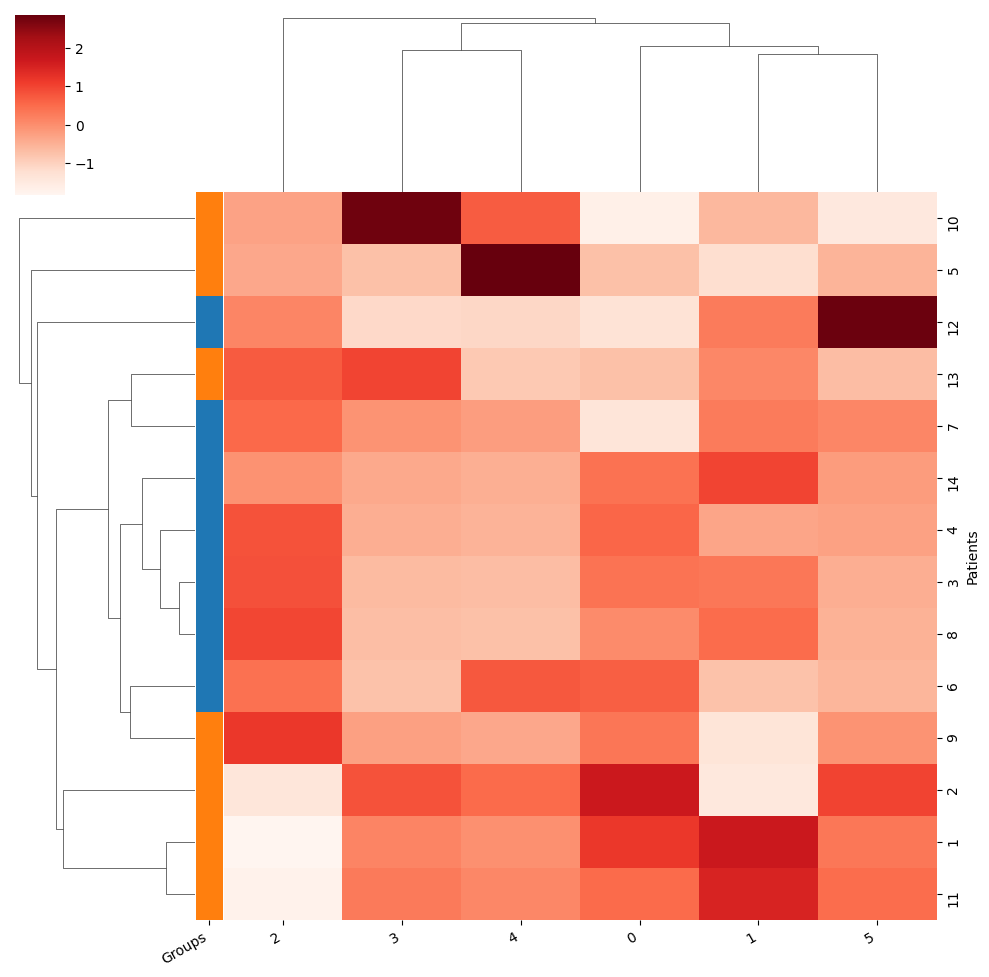

Training took 2.414s


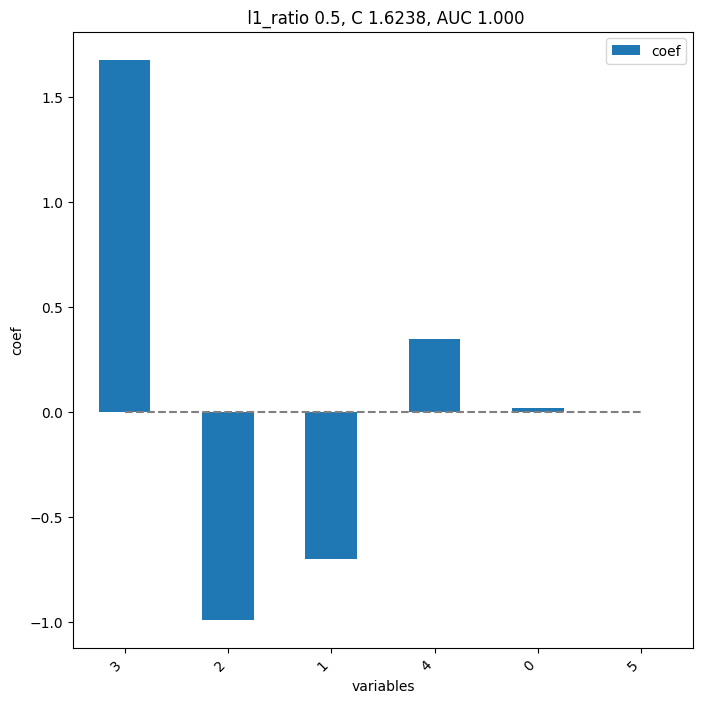

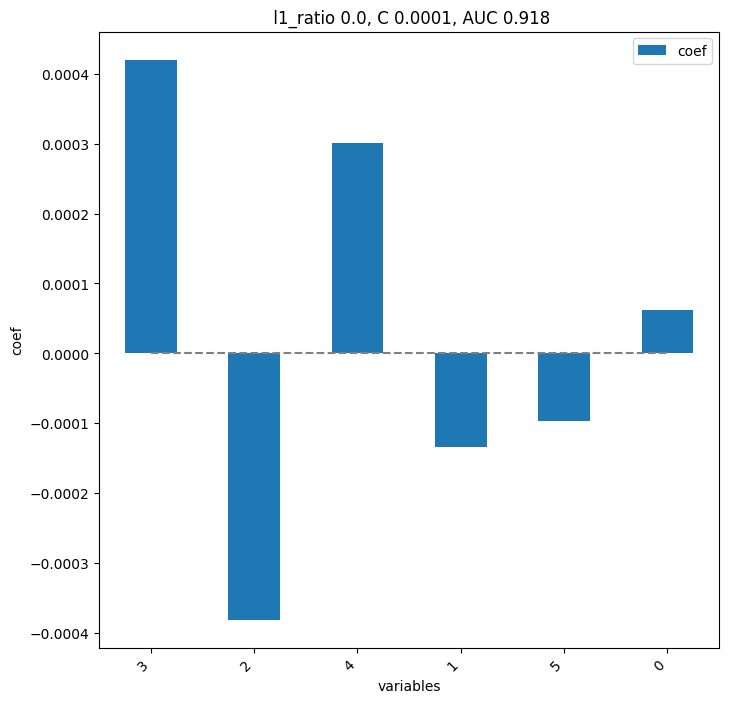

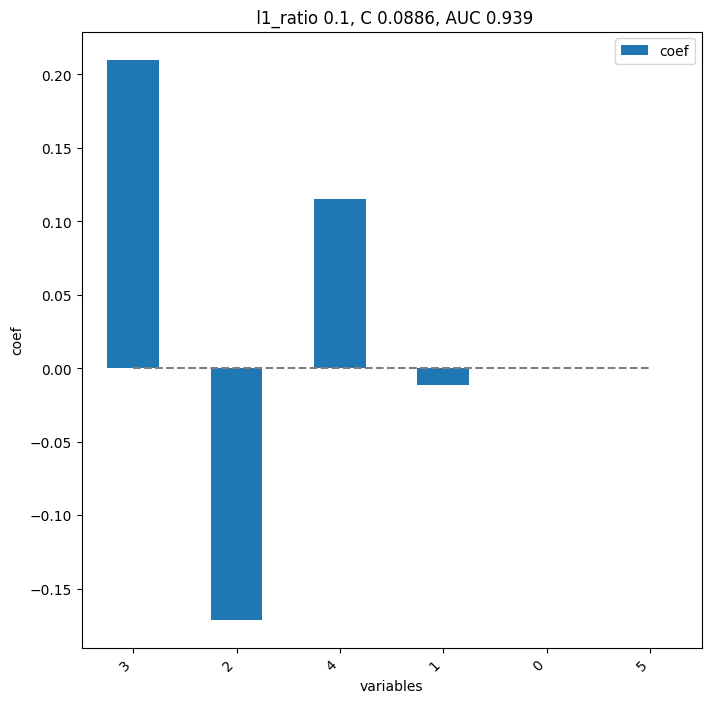

       pval  pval_corr
3  0.017483   0.104895
2  0.097319   0.256410
4  0.128205   0.256410
1  0.382867   0.574301
0  0.901515   1.000000
5  1.000000   1.000000


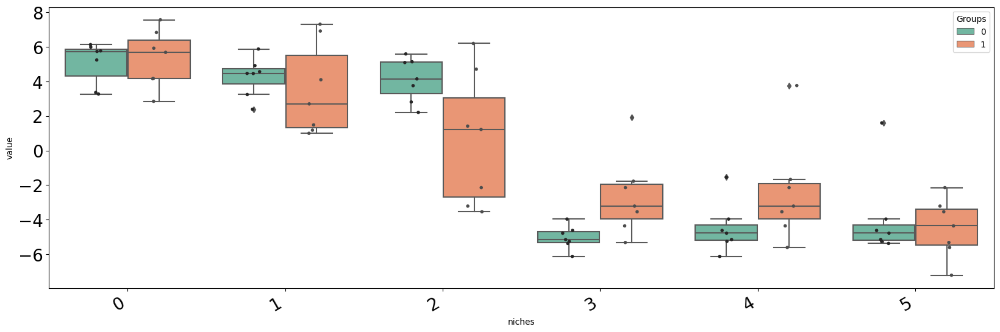

Loading clusterer object and cluster labels
There are 8 clusters
Loading reducer object and reduced coordinates


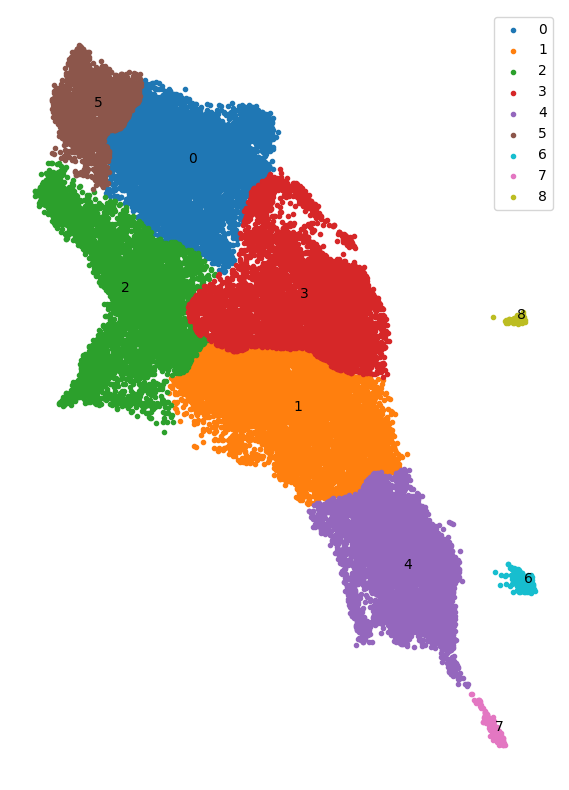

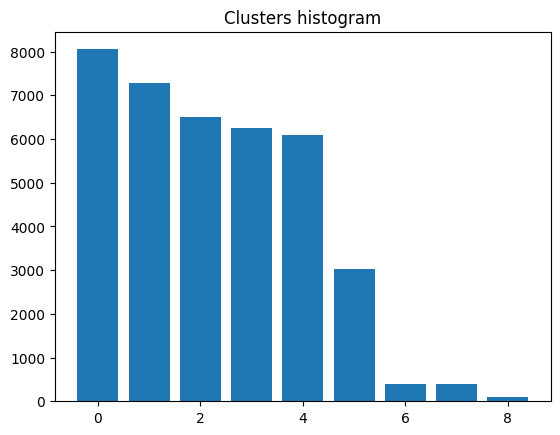

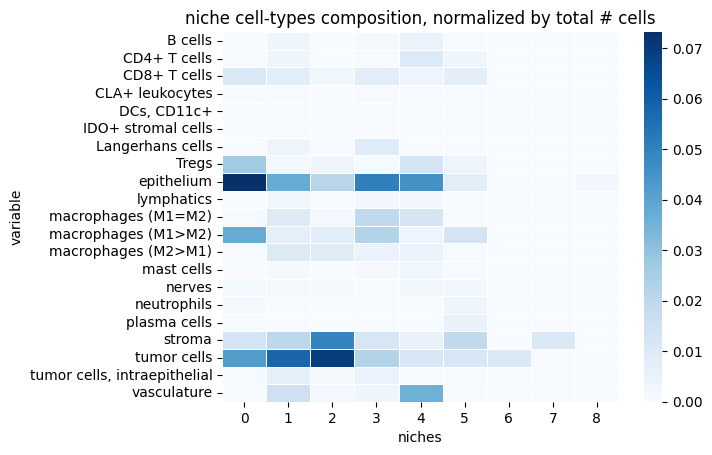

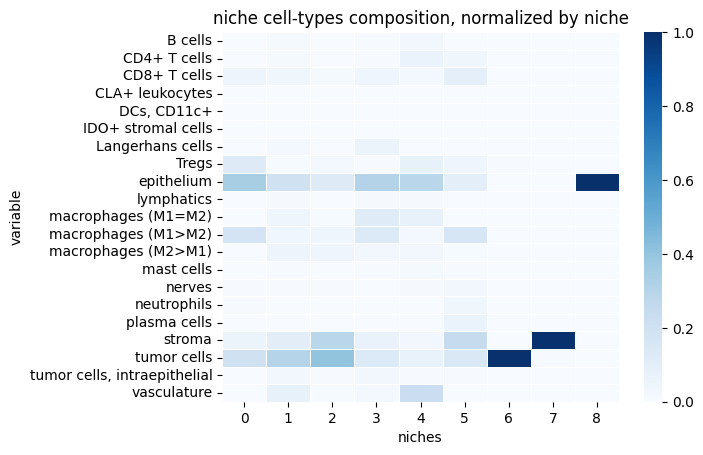

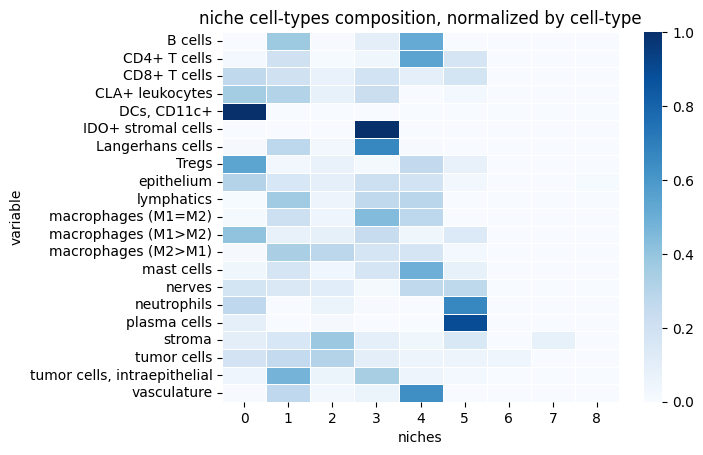

reducer_type-umap_n_neighbors-100_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr


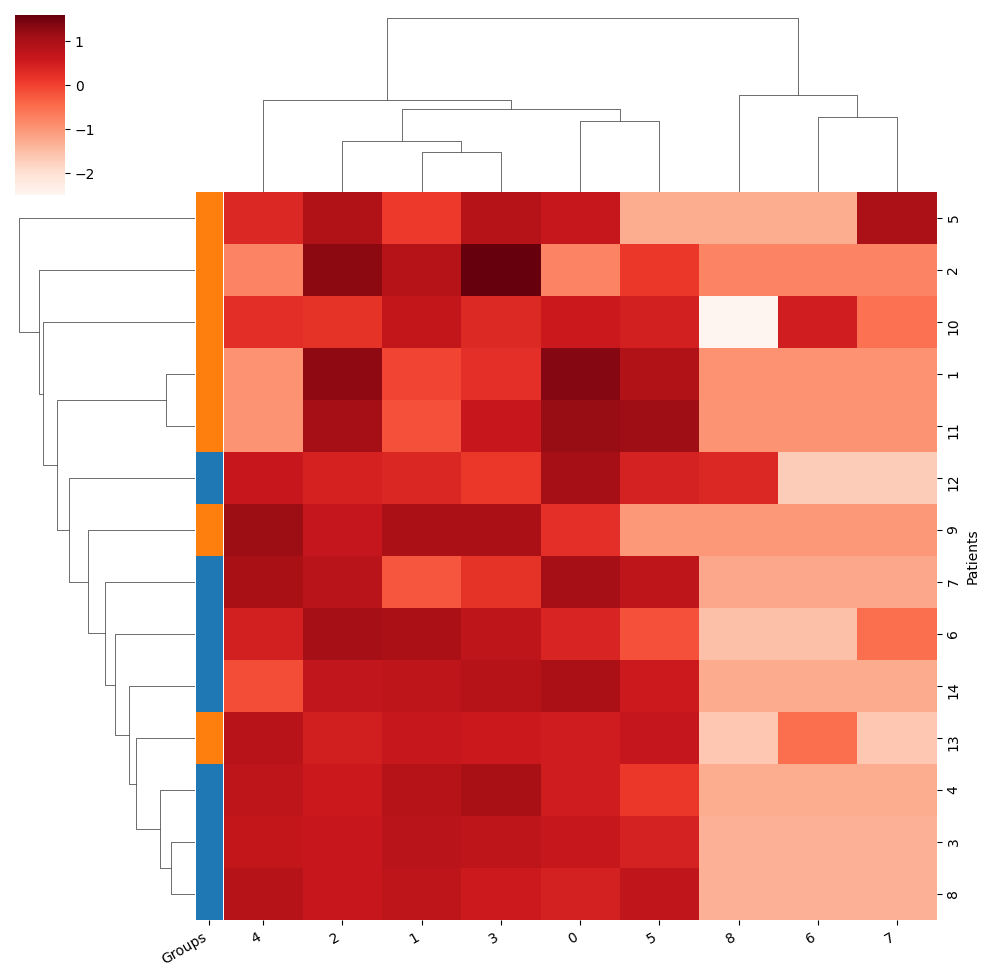

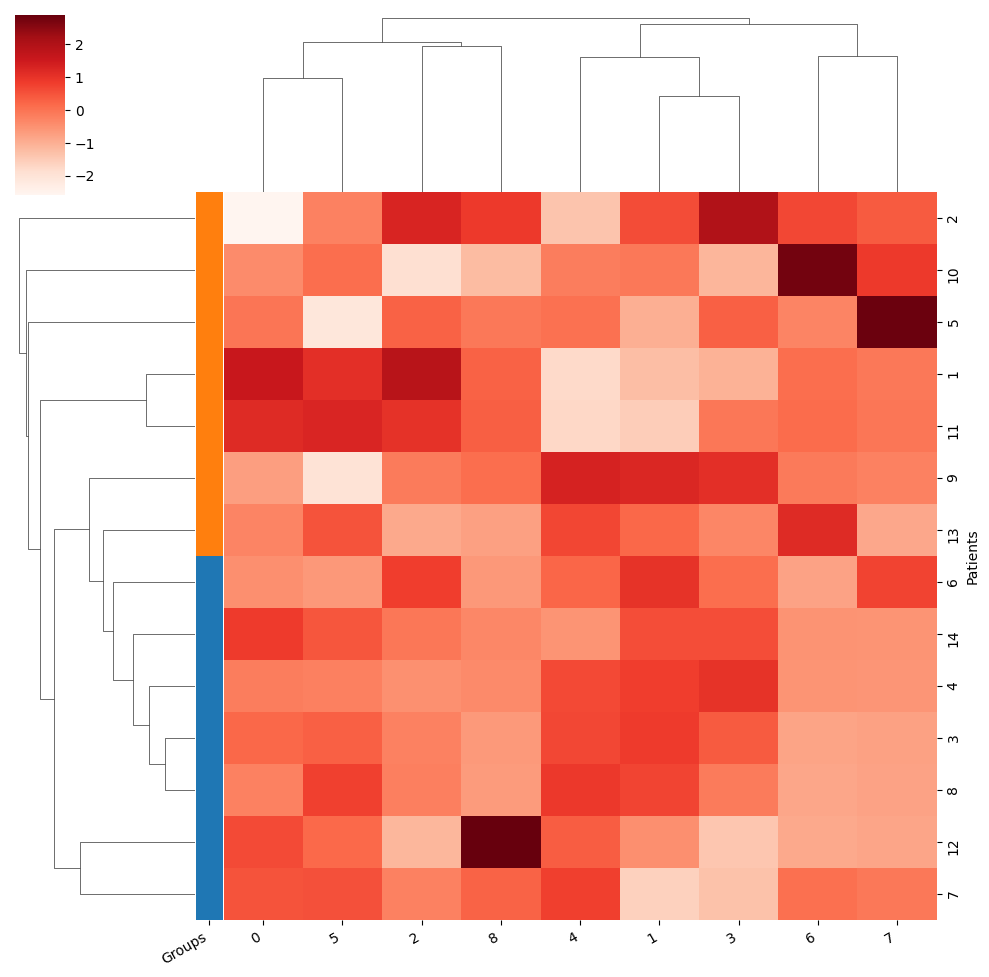

Training took 2.444s


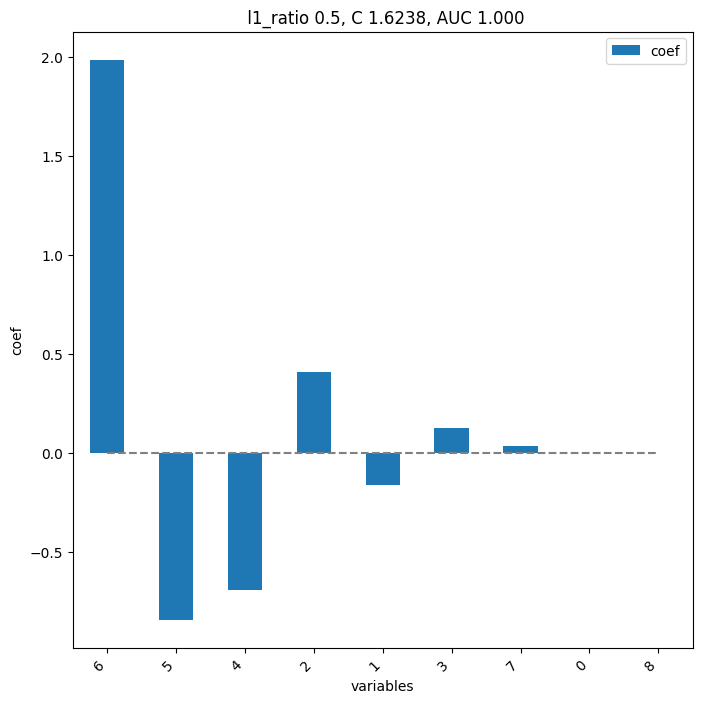

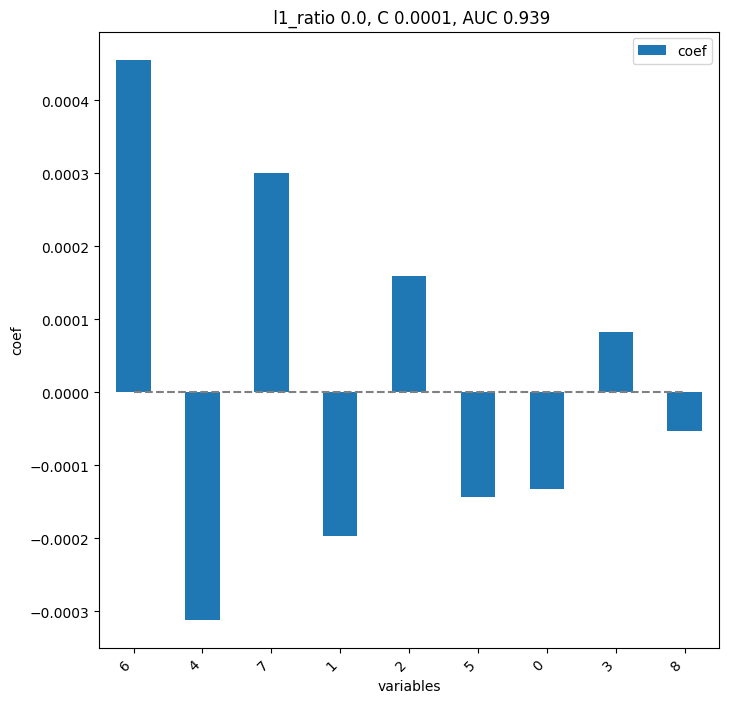

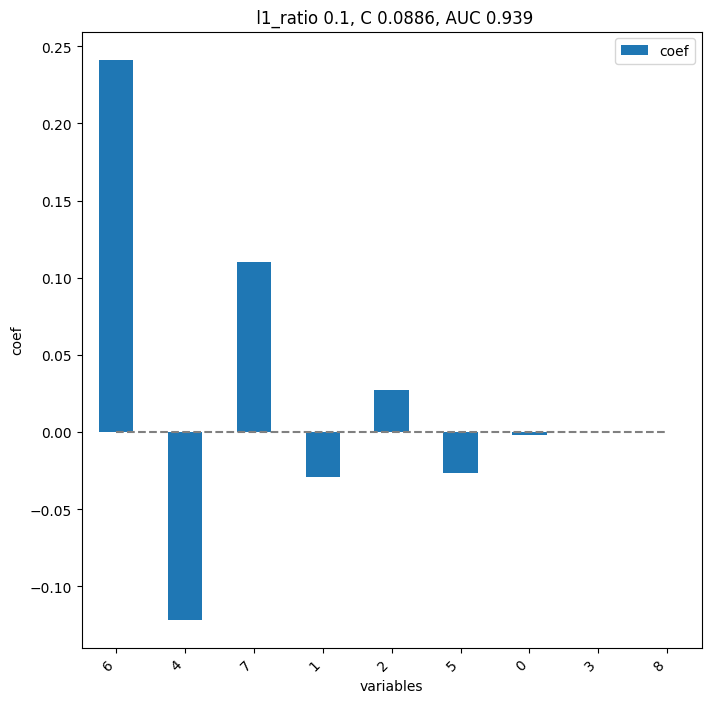

       pval  pval_corr
6  0.002331   0.020979
7  0.128205   0.576923
4  0.208625   0.625874
2  0.317599   0.689161
1  0.382867   0.689161
0  0.534965   0.802448
8  0.710373   0.804779
3  0.804779   0.804779
5  0.804779   0.804779


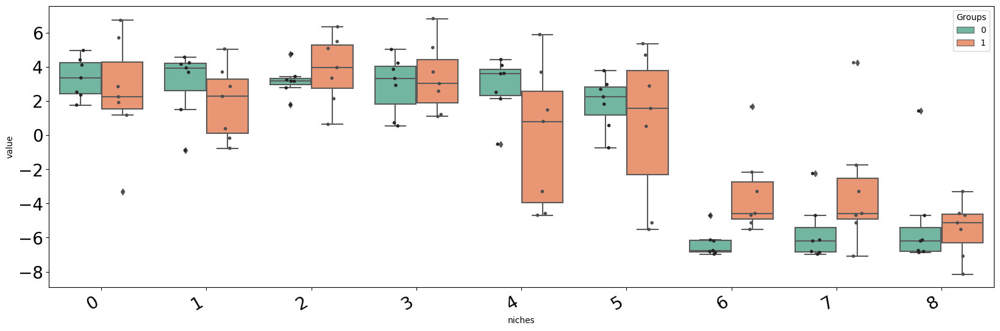

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-100', 'metric-manhattan', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-50', 'resolution', 'resolution_parameter-0.03', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


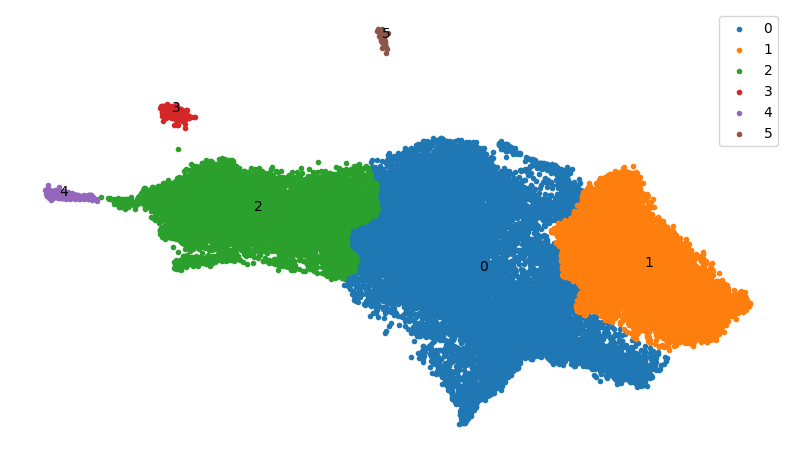

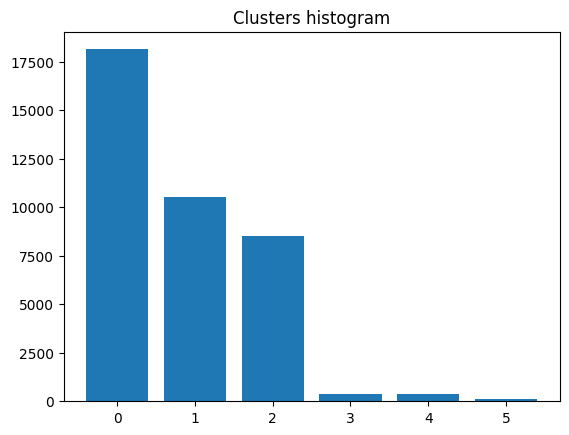

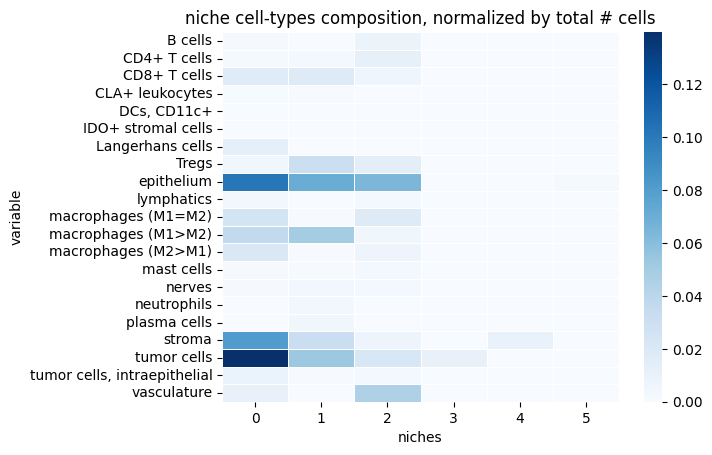

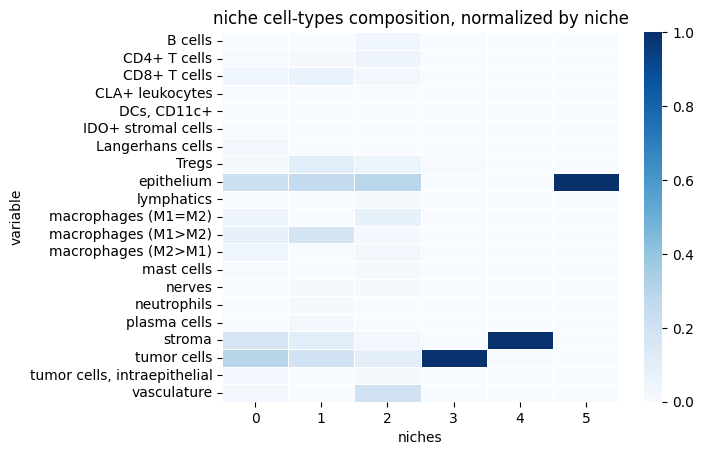

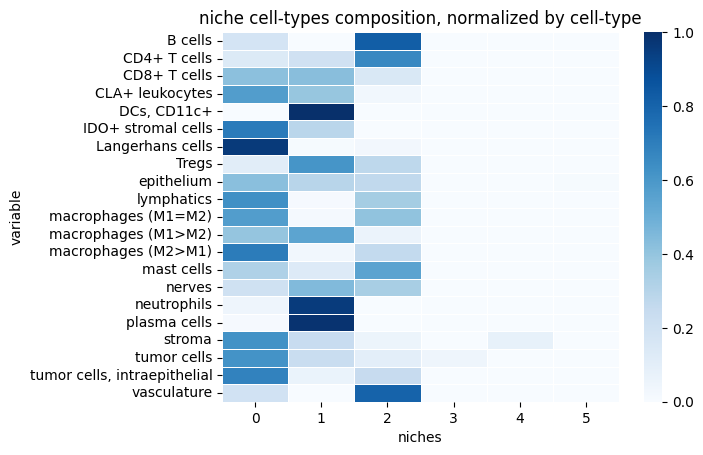

reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


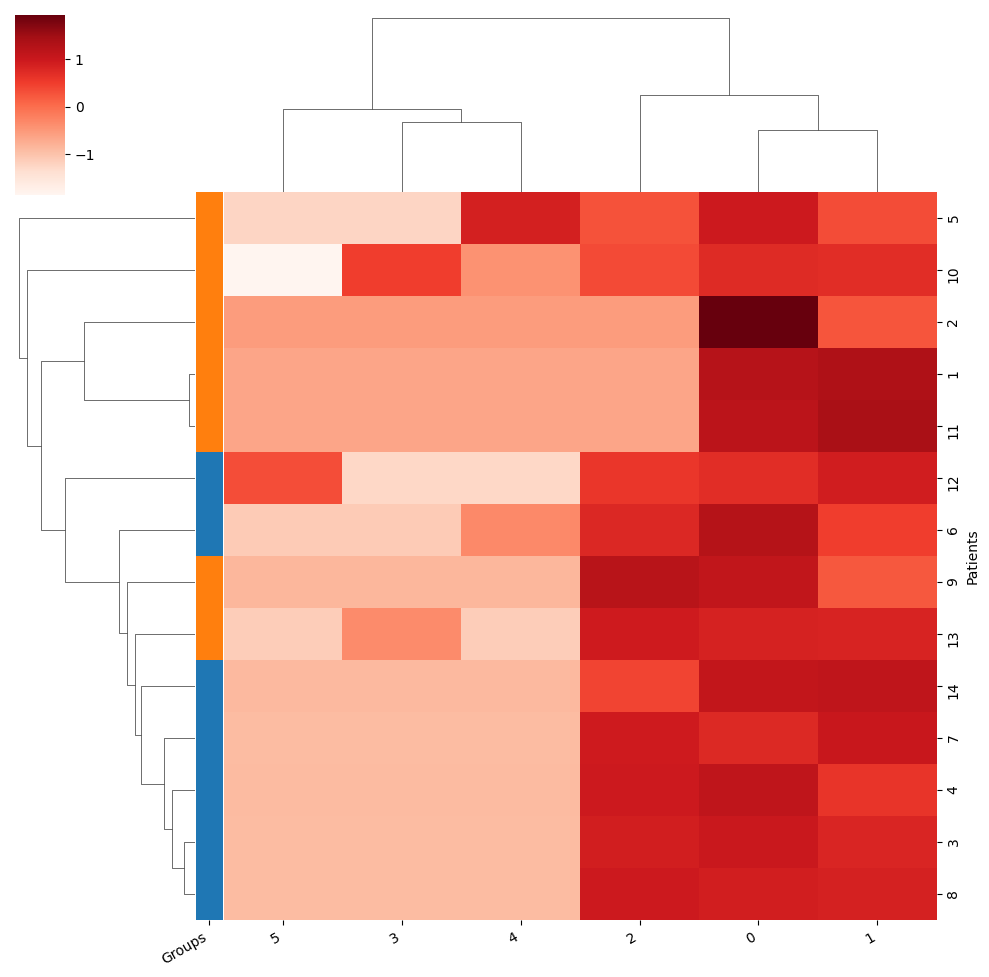

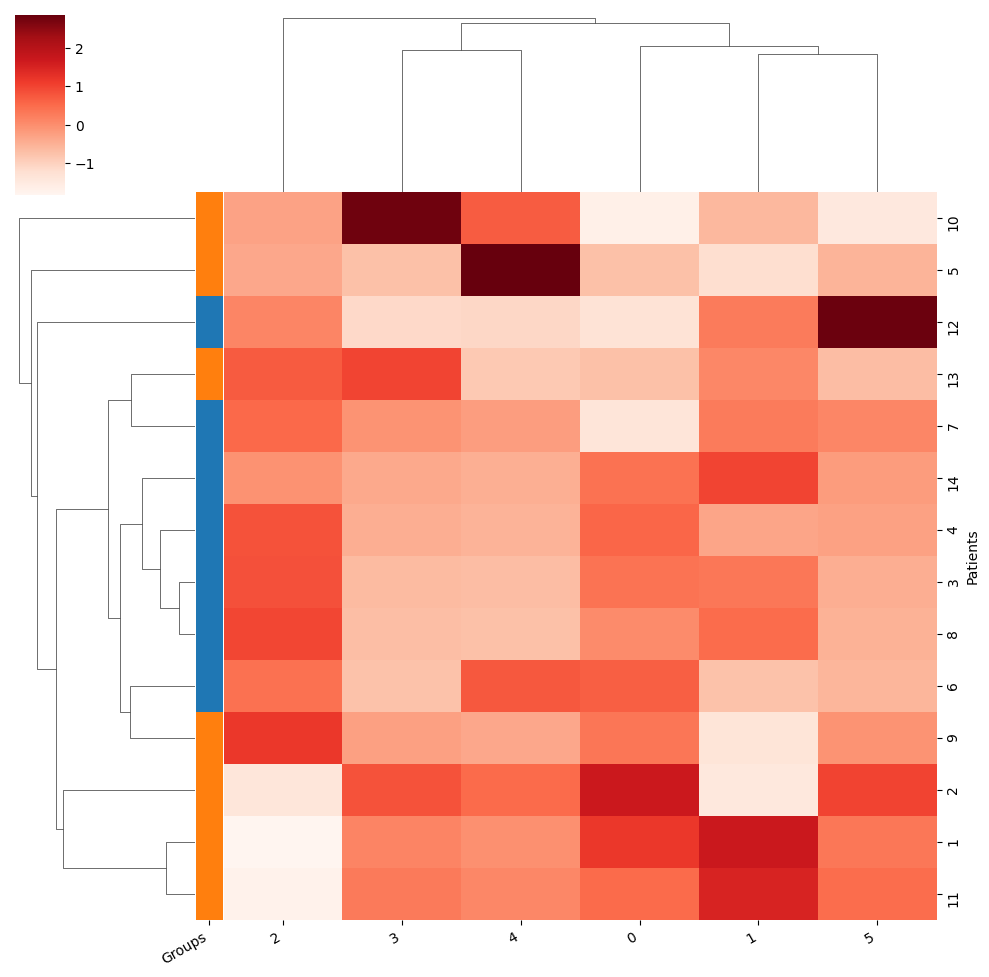

Training took 2.440s


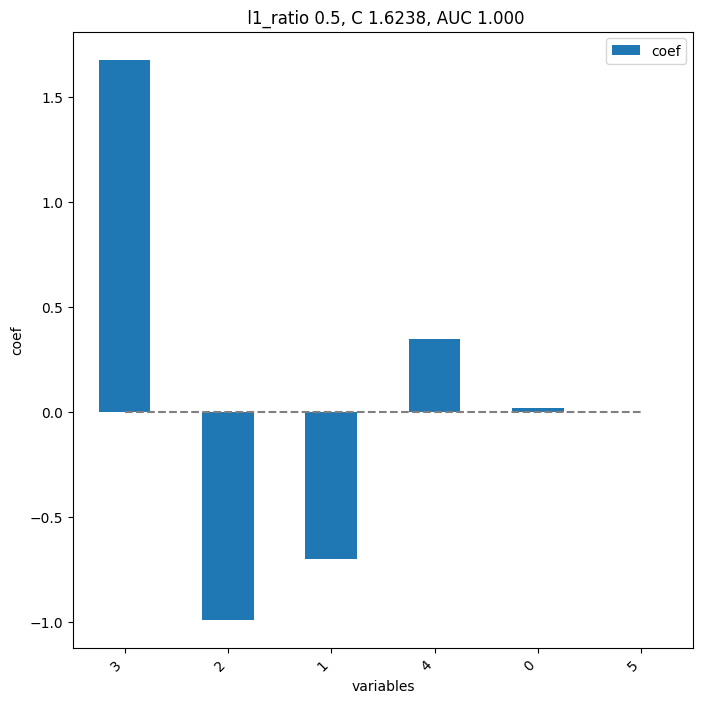

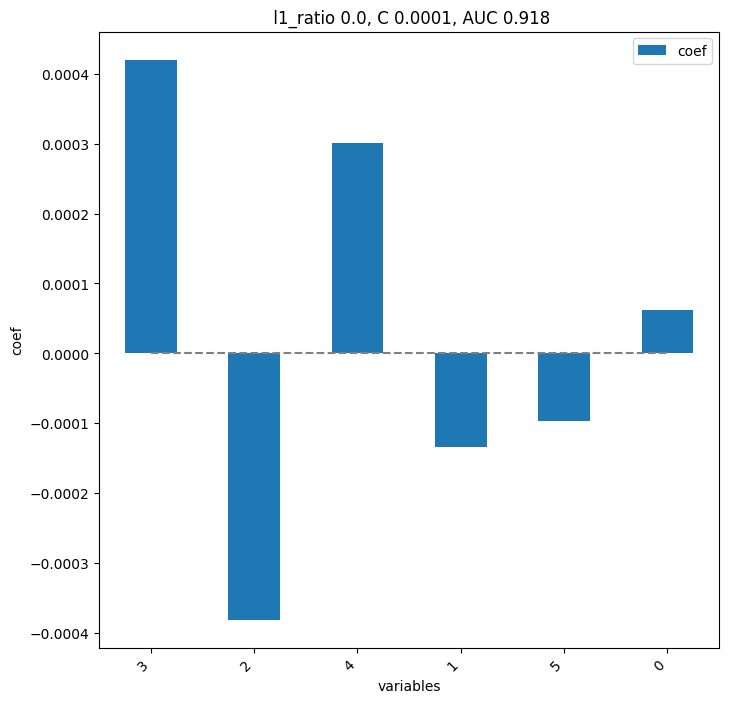

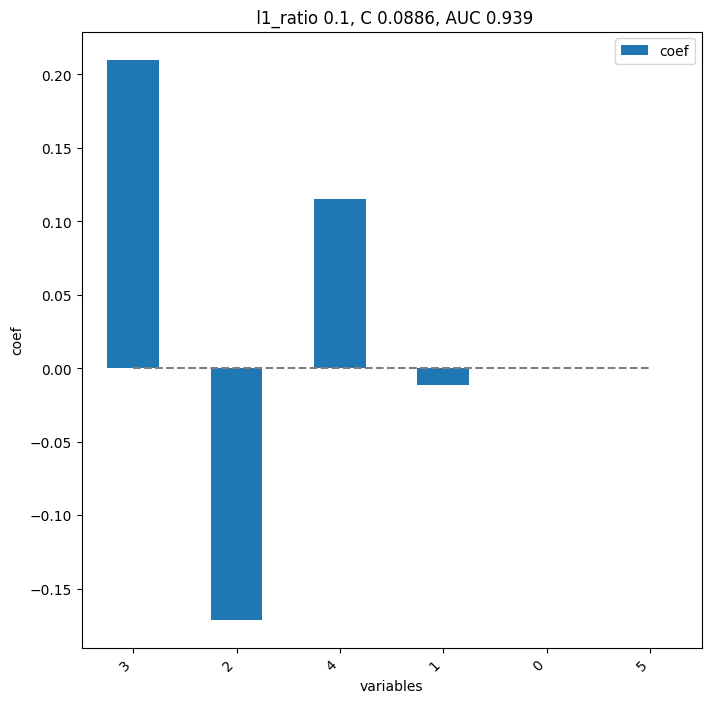

       pval  pval_corr
3  0.017483   0.104895
2  0.097319   0.256410
4  0.128205   0.256410
1  0.382867   0.574301
0  0.901515   1.000000
5  1.000000   1.000000


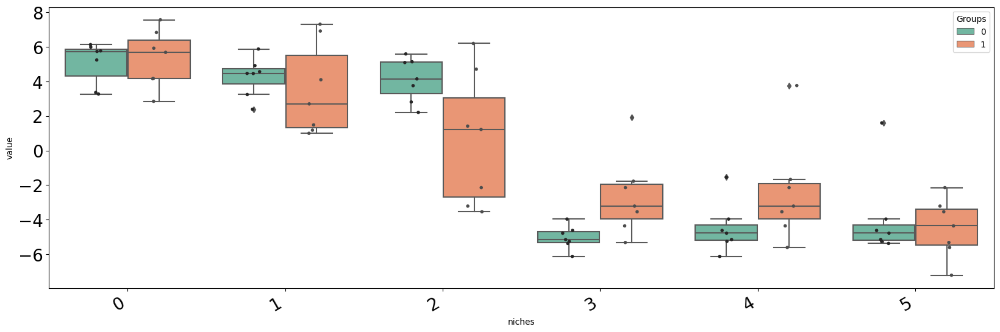

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-45', 'metric-cosine', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-15', 'resolution', 'resolution_parameter-0.1', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 16 clusters
Loading reducer object and reduced coordinates


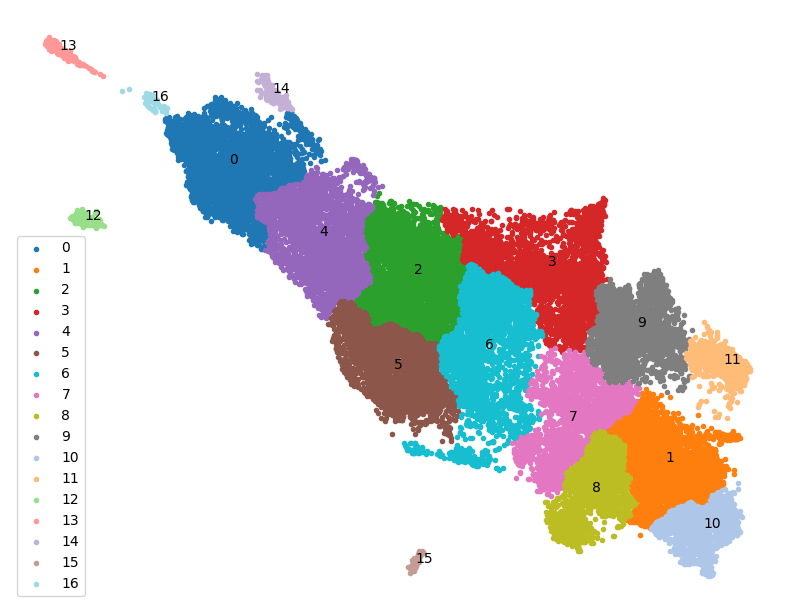

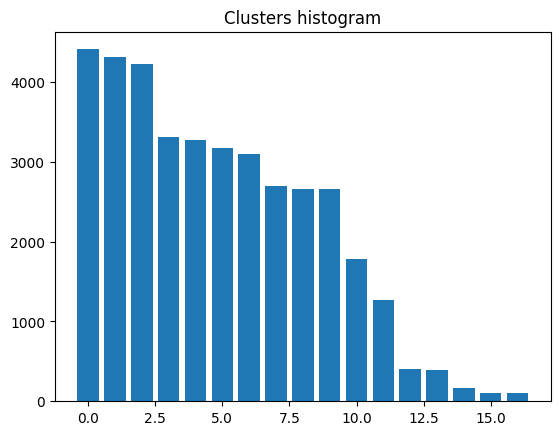

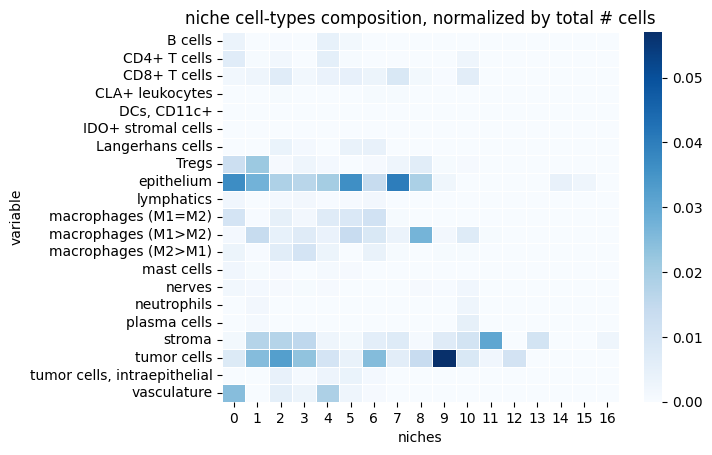

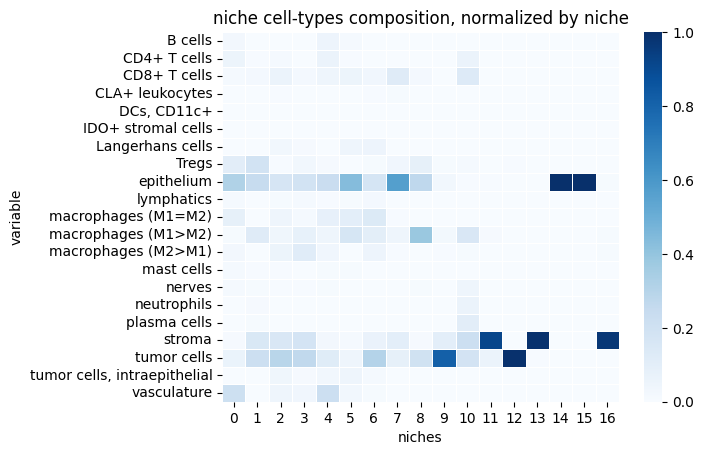

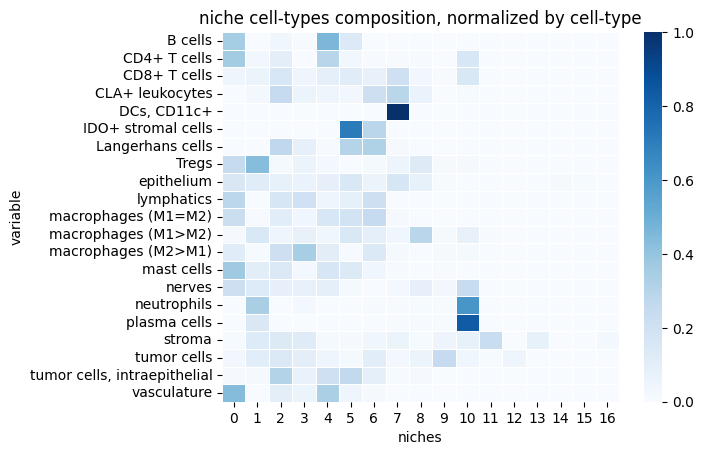

reducer_type-umap_n_neighbors-45_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr


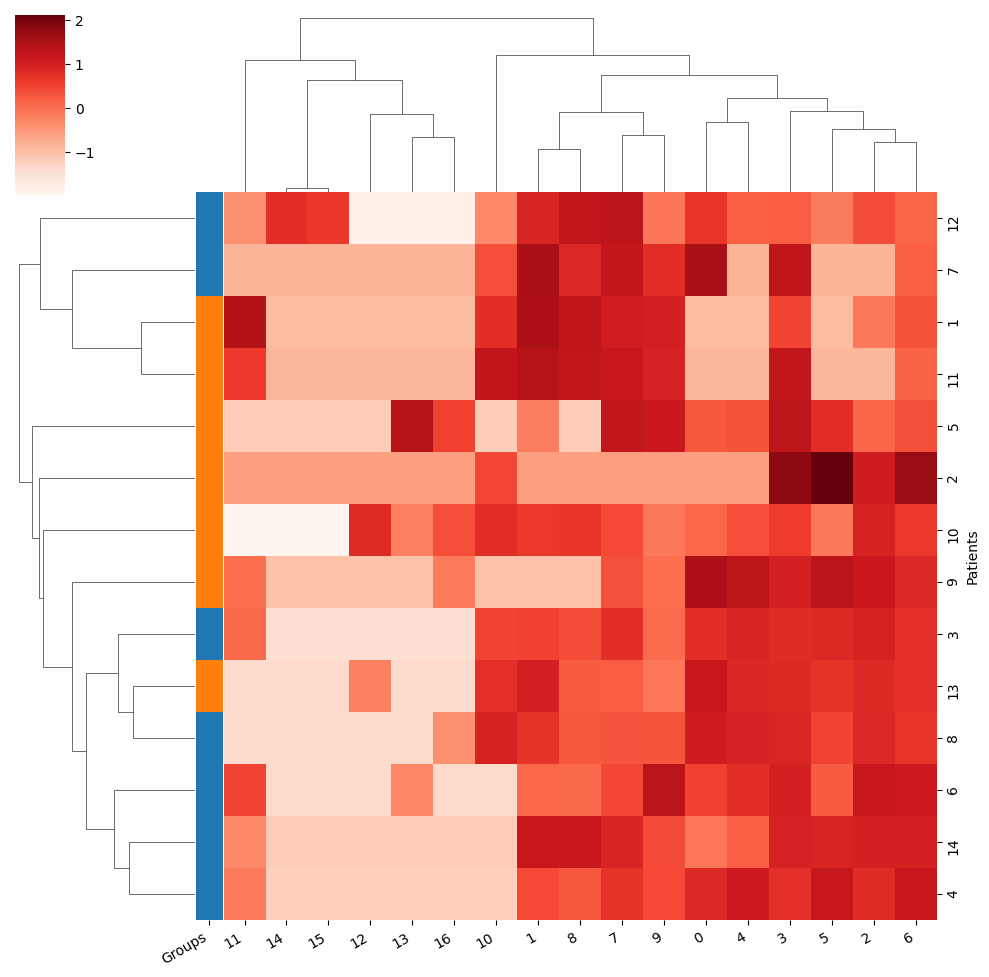

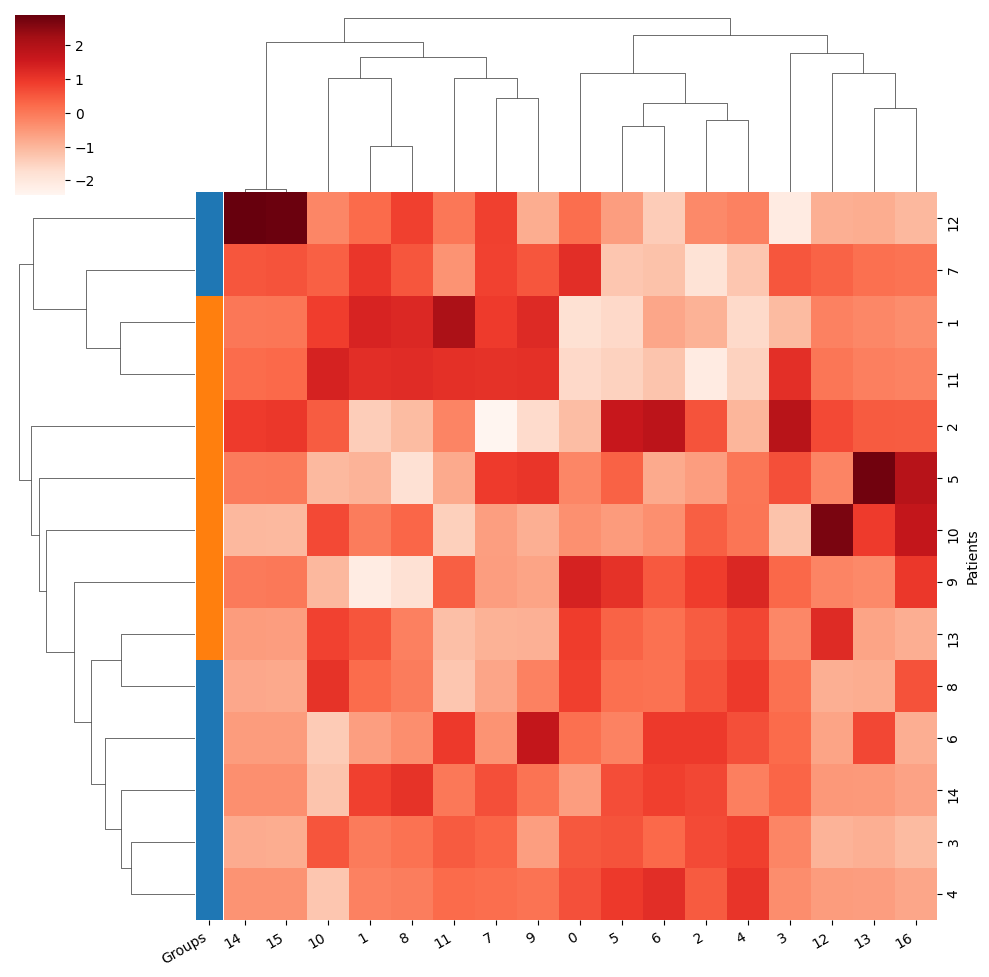

Training took 2.472s


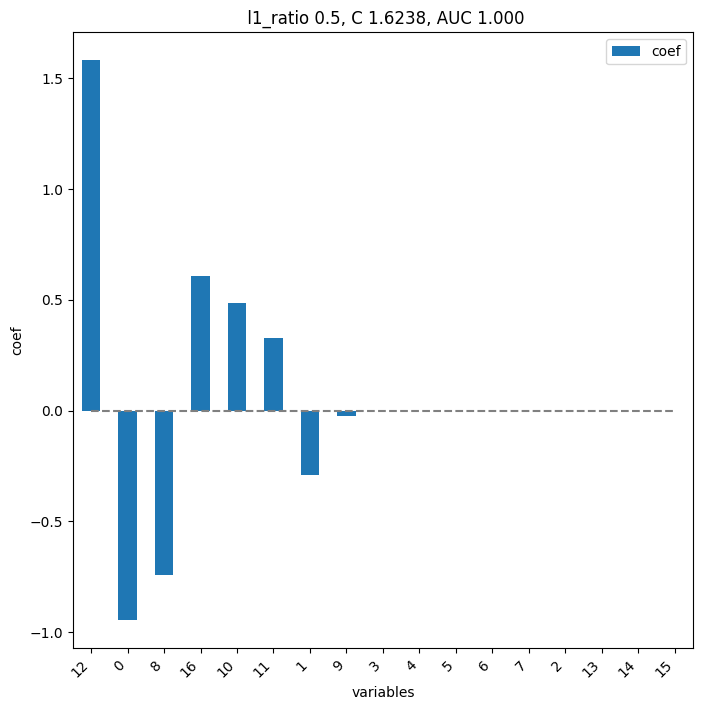

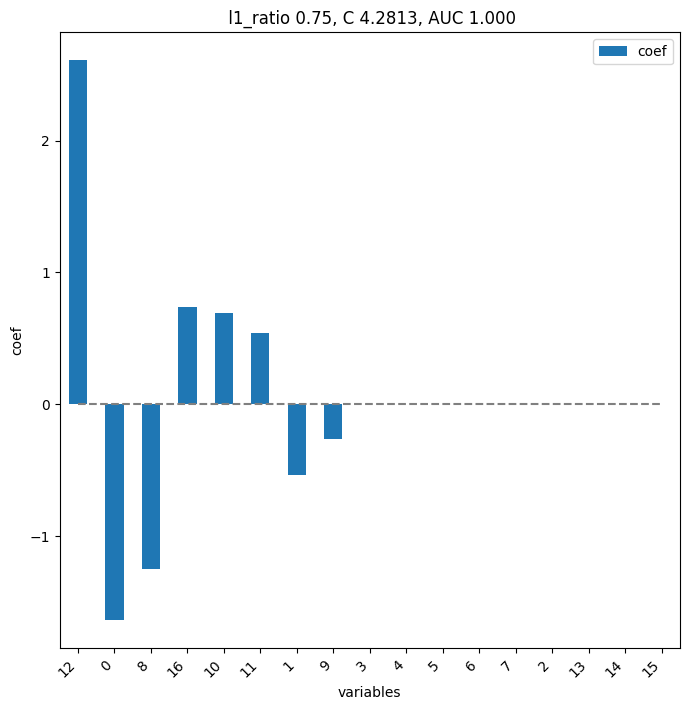

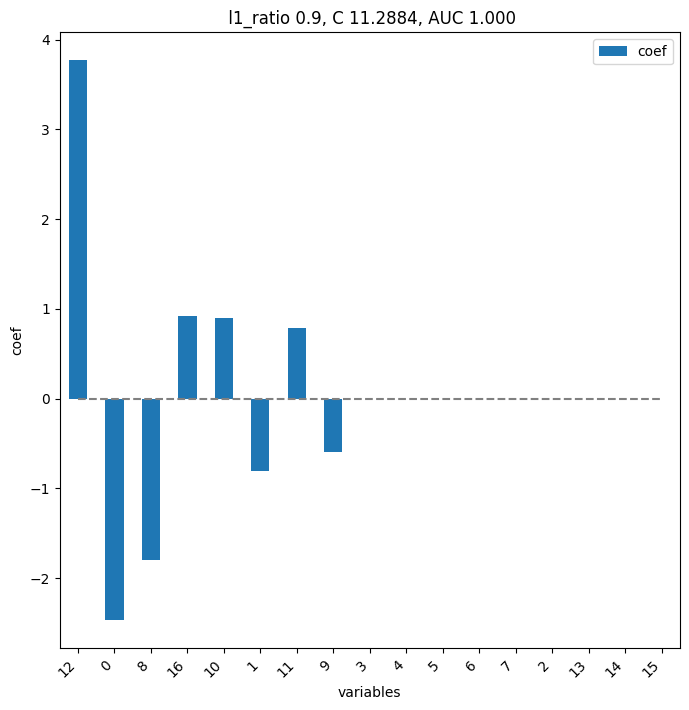

        pval  pval_corr
12  0.006993   0.118881
16  0.072844   0.551476
13  0.097319   0.551476
10  0.164918   0.700903
0   0.259324   0.734751
2   0.259324   0.734751
4   0.455711   0.862596
9   0.534965   0.862596
3   0.534965   0.862596
8   0.534965   0.862596
6   0.710373   0.862596
15  0.710373   0.862596
1   0.710373   0.862596
14  0.710373   0.862596
7   0.901515   0.957860
11  0.901515   0.957860
5   1.000000   1.000000


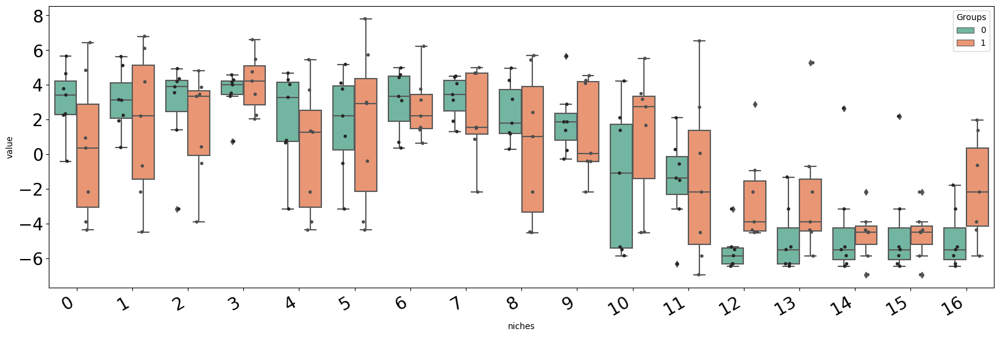

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-100', 'metric-manhattan', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-50', 'resolution', 'resolution_parameter-0.1', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 9 clusters
Loading reducer object and reduced coordinates


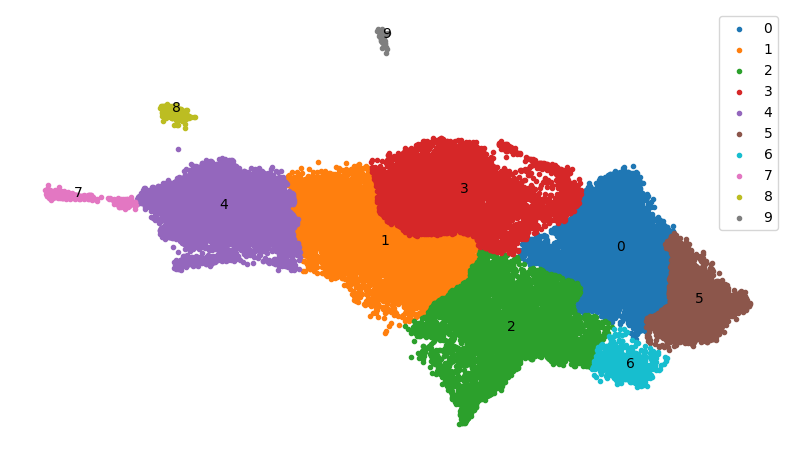

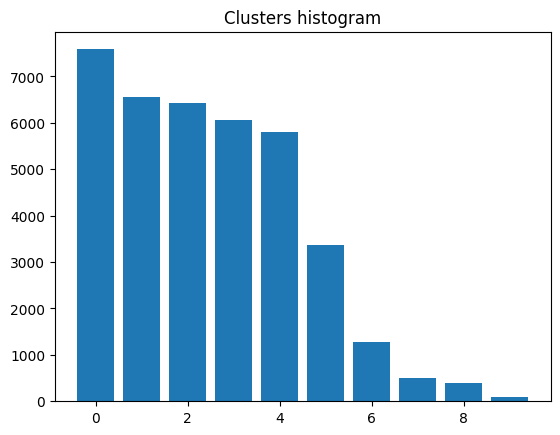

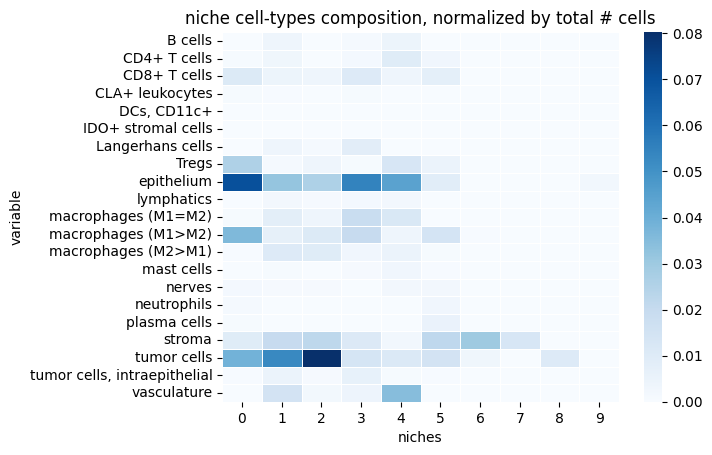

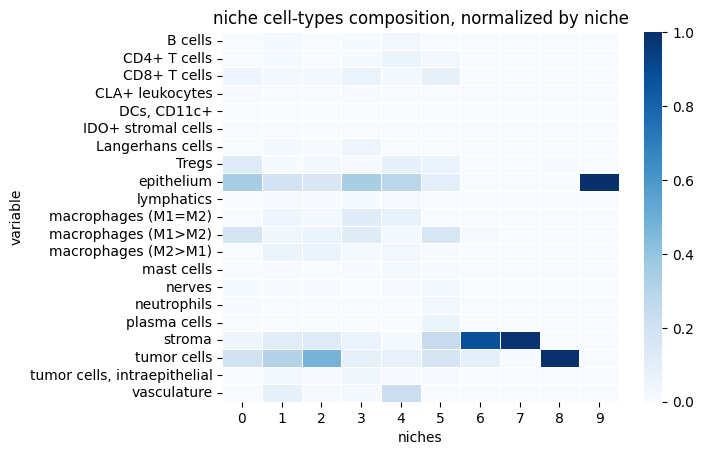

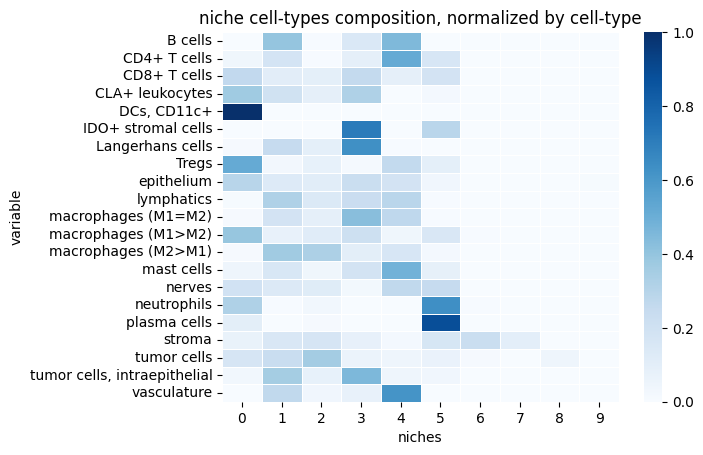

reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr


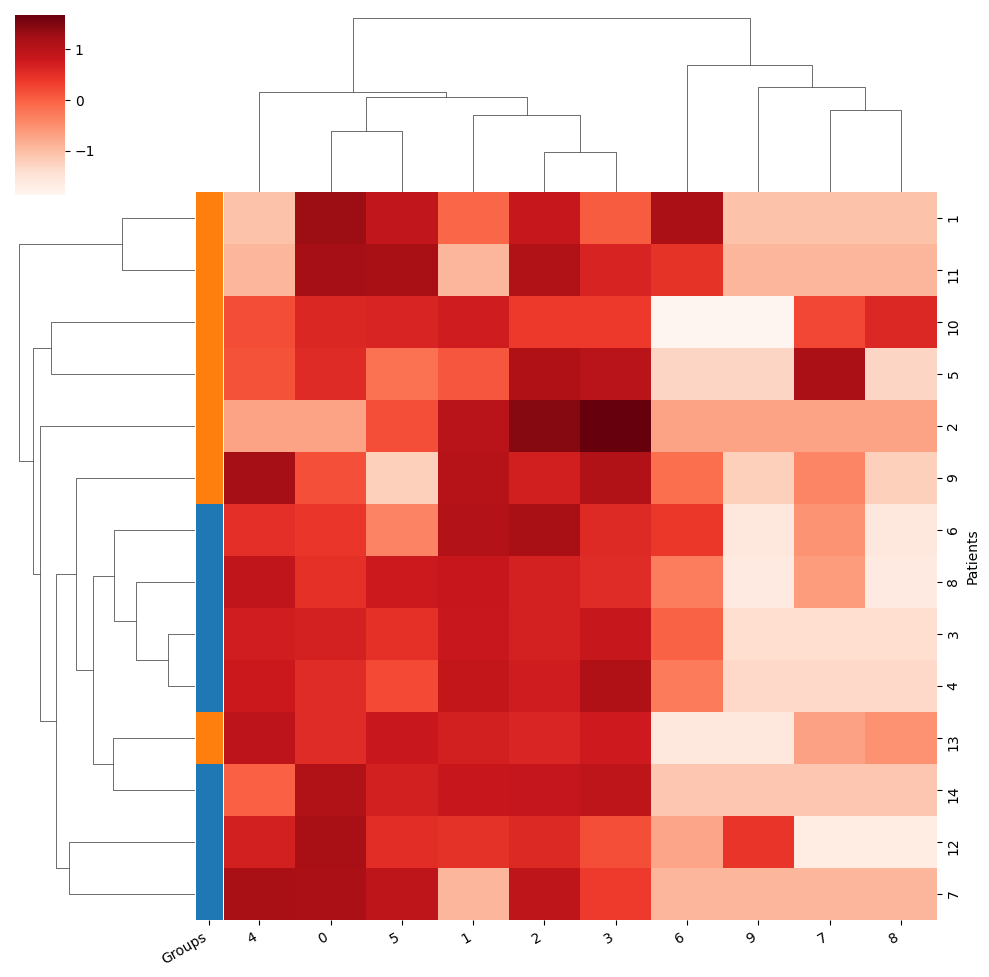

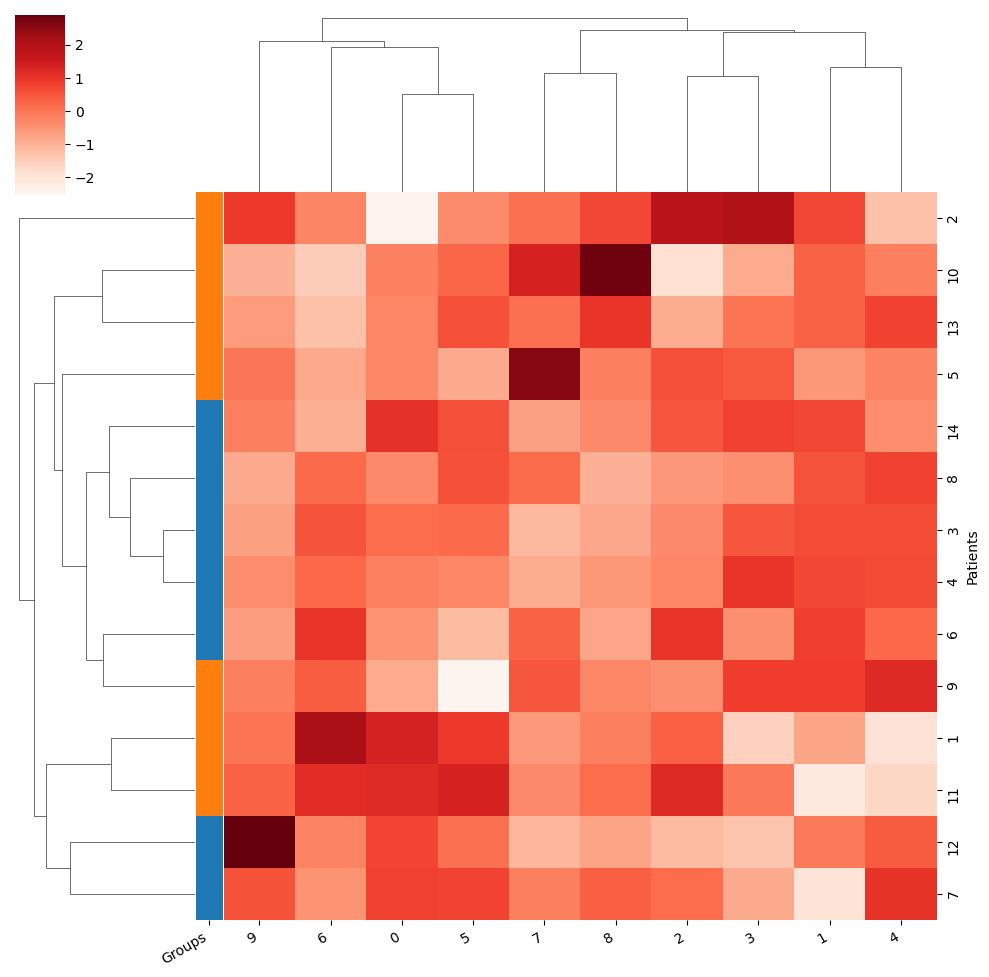

Training took 2.449s


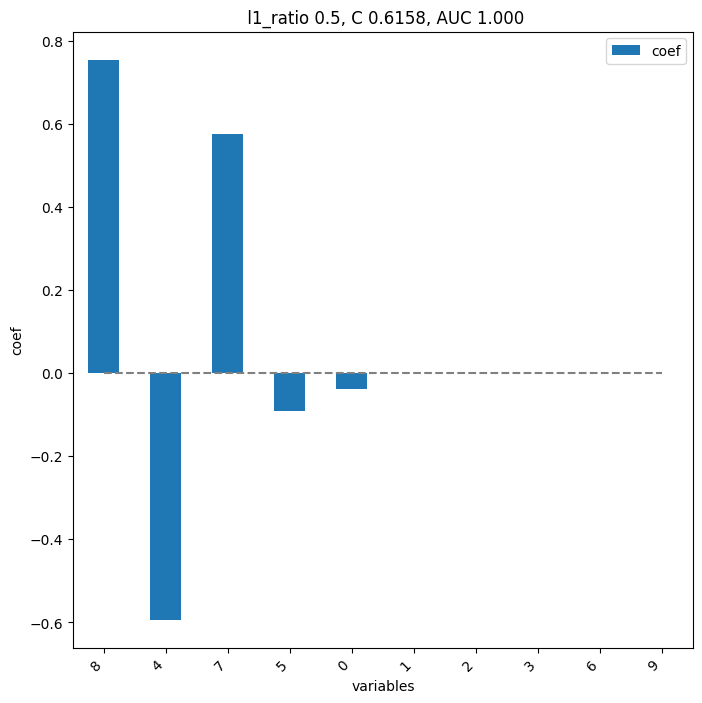

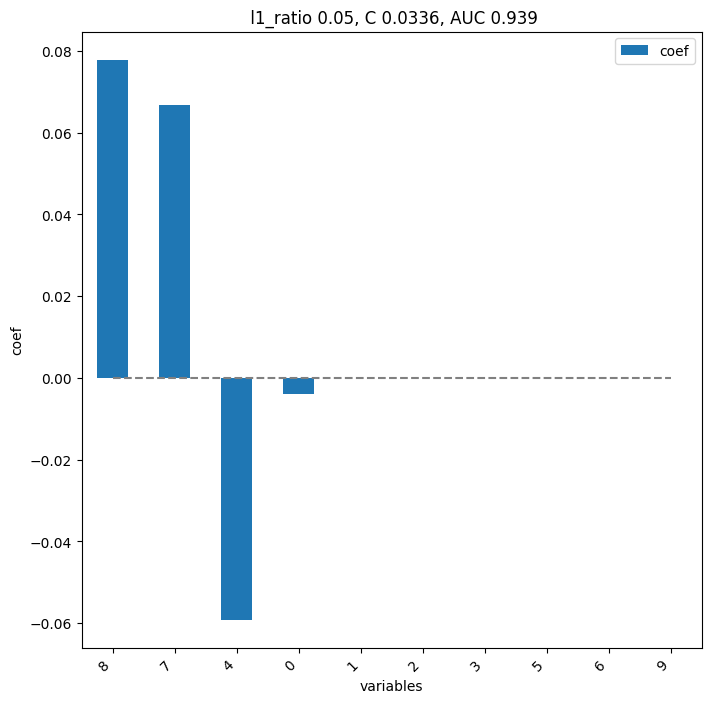

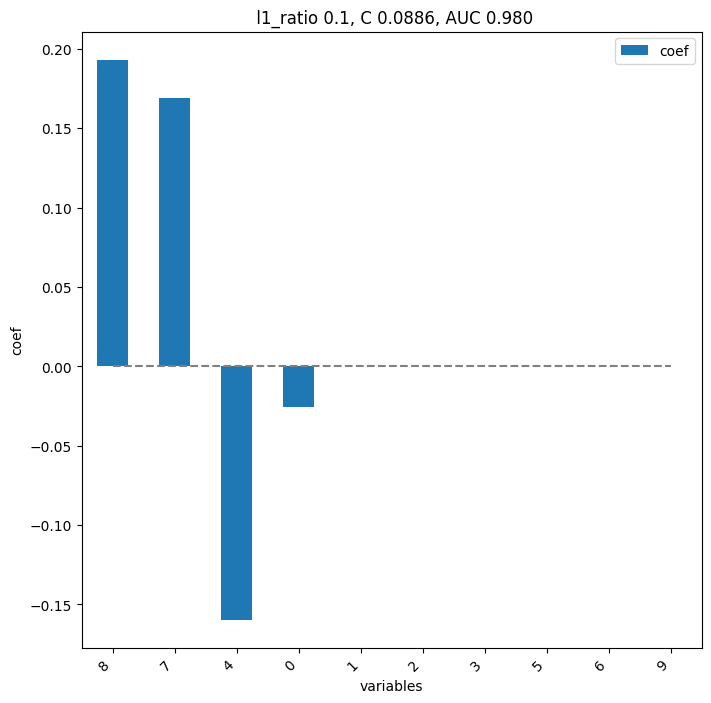

       pval  pval_corr
8  0.006993   0.069930
7  0.072844   0.364219
4  0.259324   0.864413
1  0.534965   1.000000
0  0.620047   1.000000
9  0.620047   1.000000
2  0.710373   1.000000
6  0.804779   1.000000
3  0.901515   1.000000
5  1.000000   1.000000


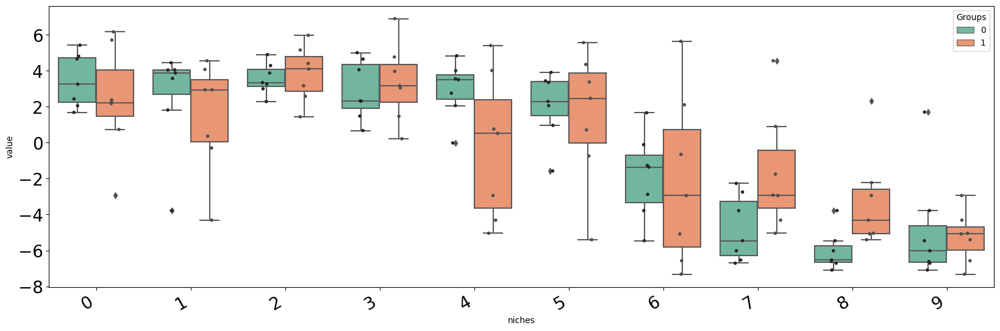

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-75', 'metric-cosine', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-15', 'resolution', 'resolution_parameter-0.01', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


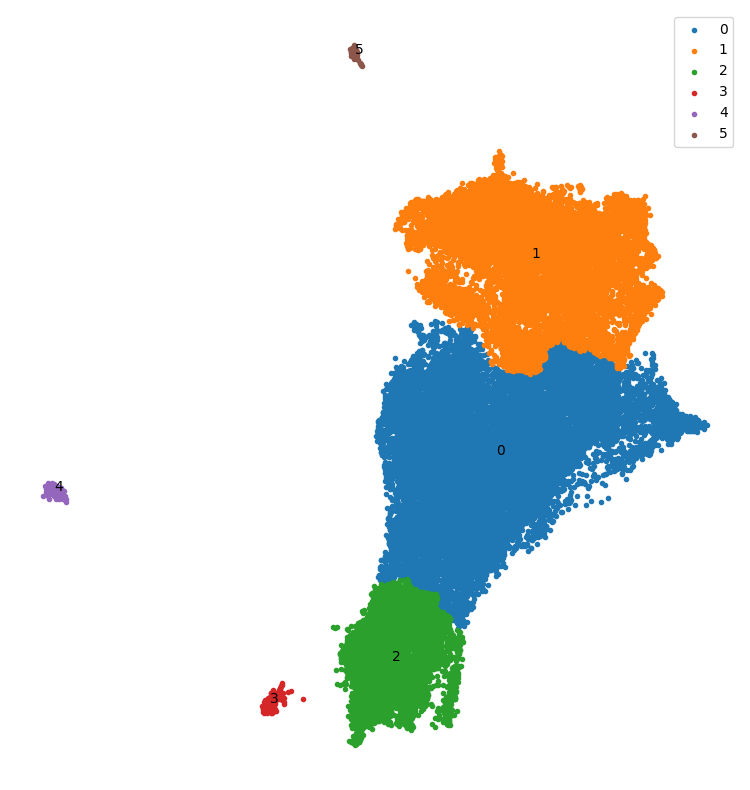

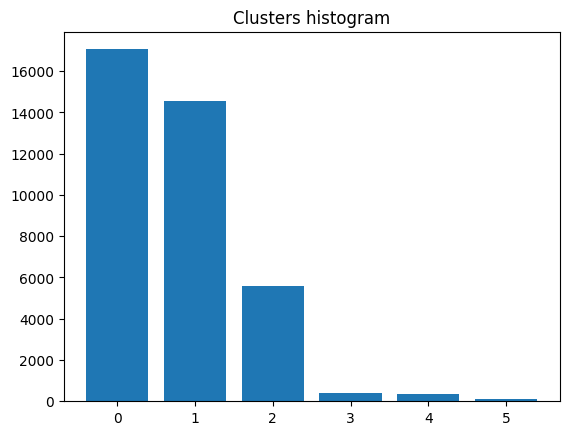

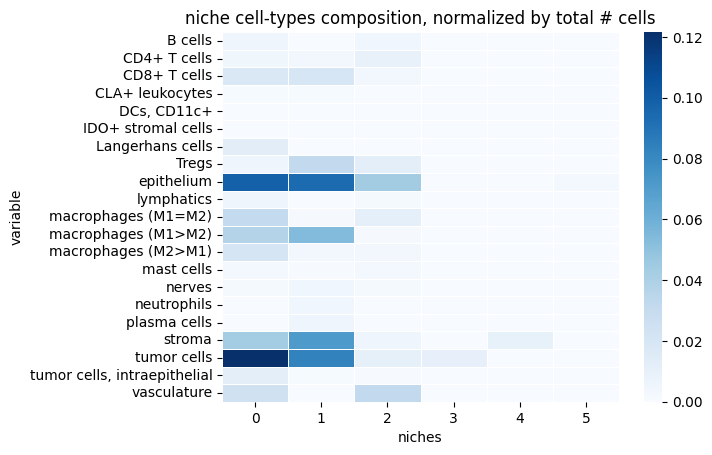

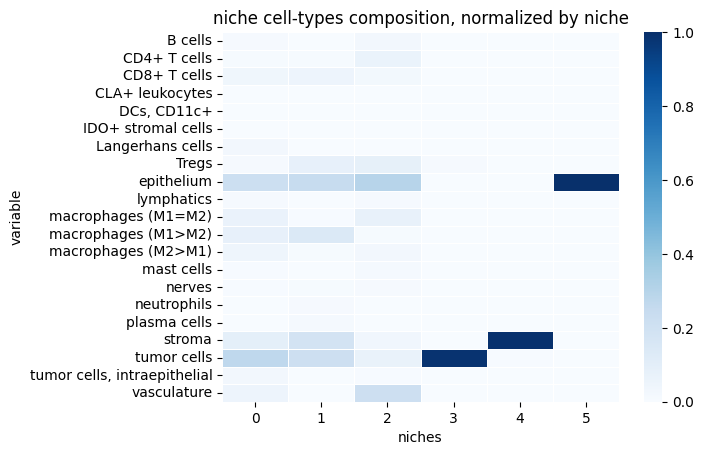

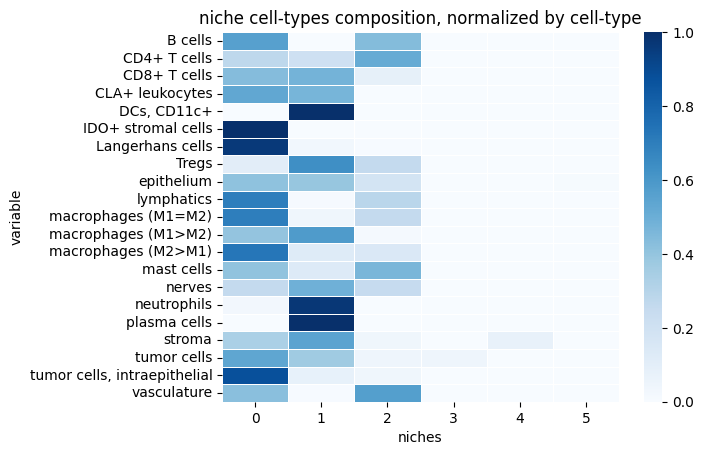

reducer_type-umap_n_neighbors-75_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.01_normalize-clr


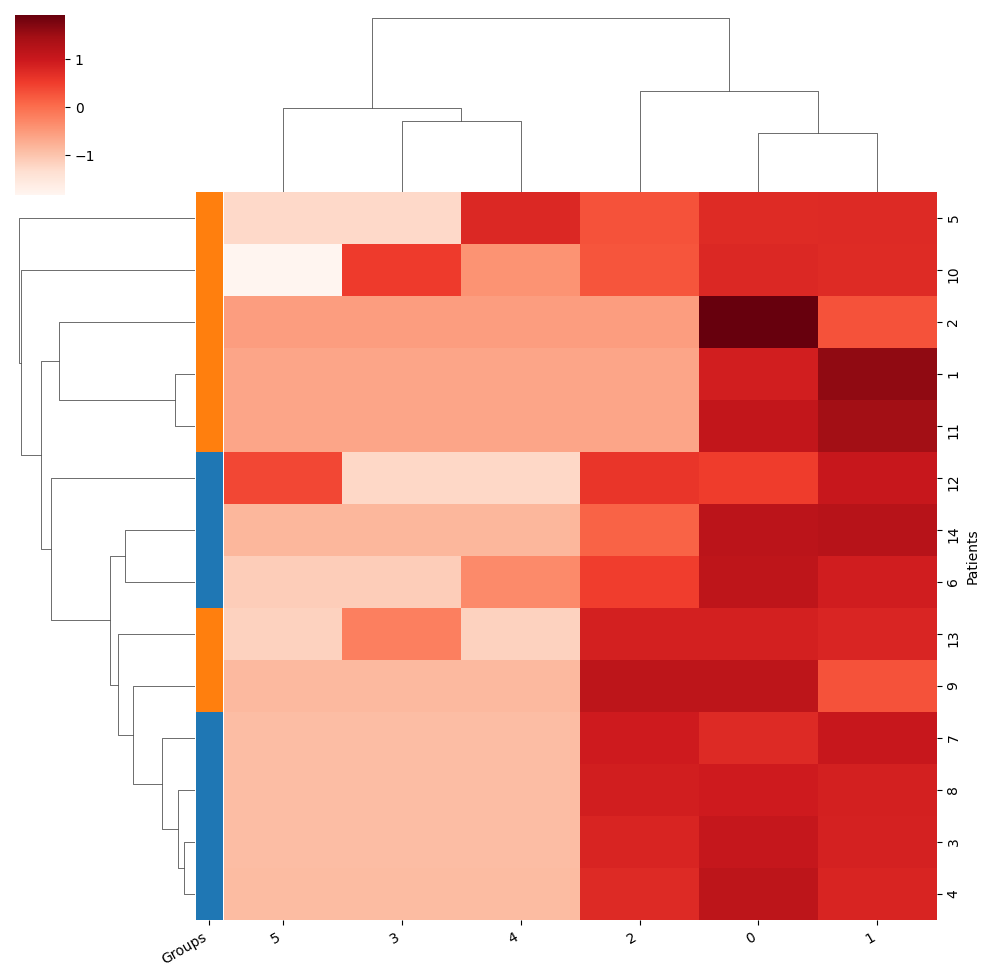

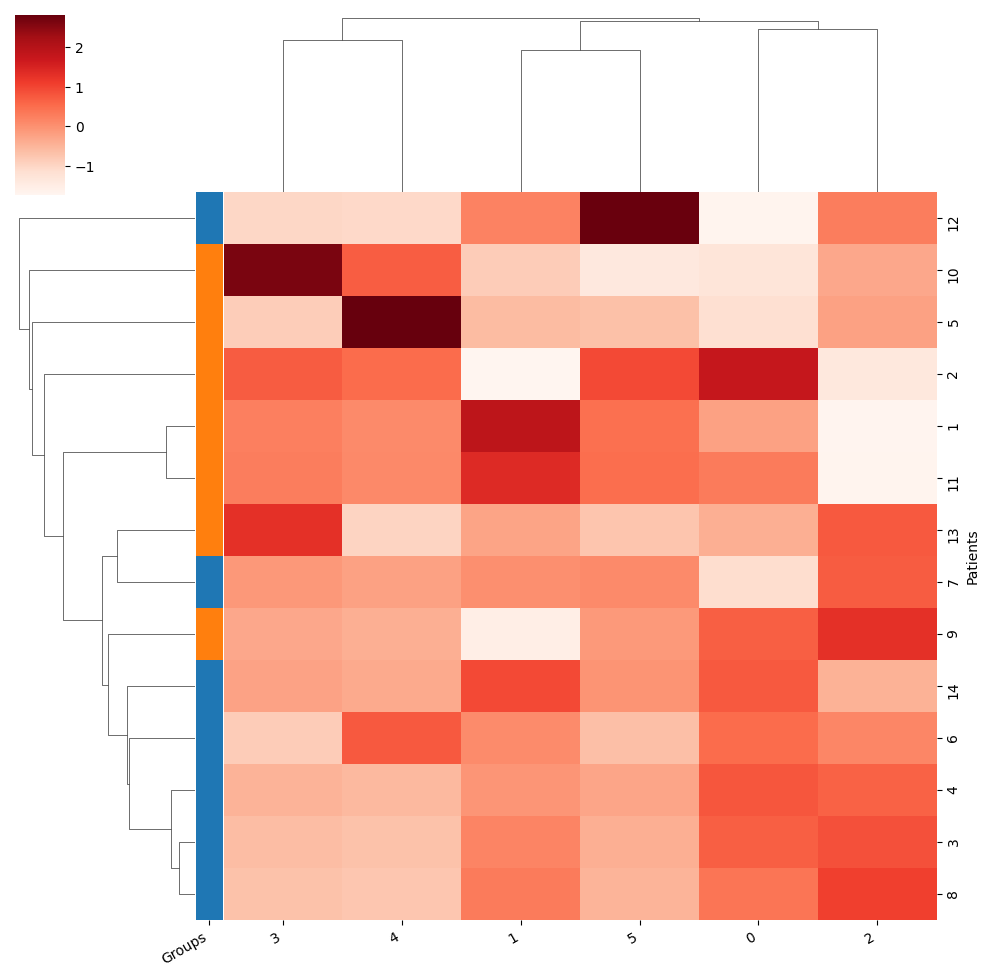

Training took 2.394s


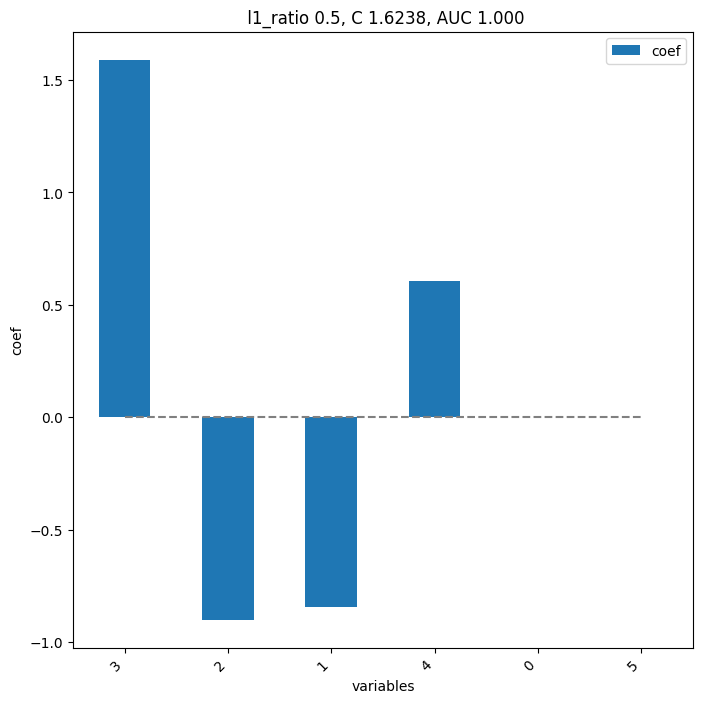

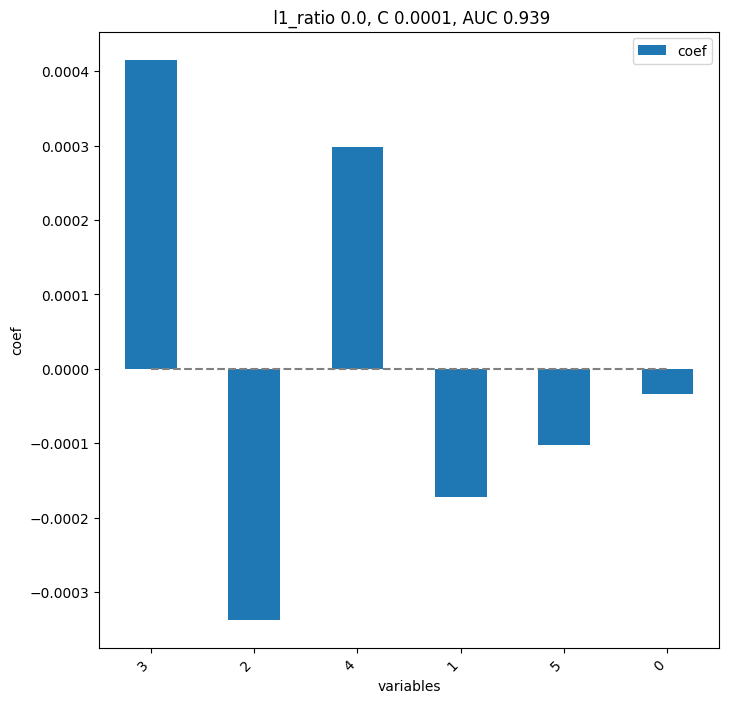

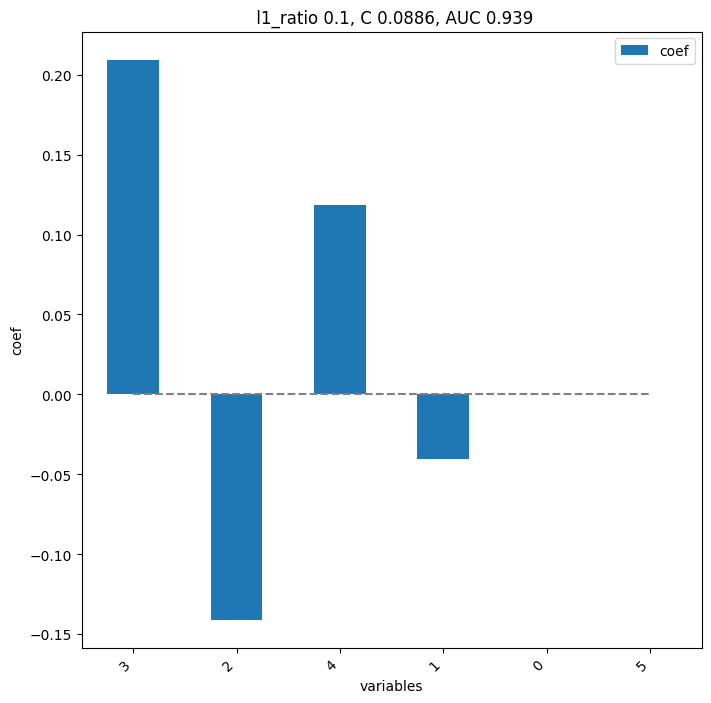

       pval  pval_corr
3  0.037879   0.227273
4  0.164918   0.312937
1  0.208625   0.312937
2  0.208625   0.312937
0  0.534965   0.641958
5  0.804779   0.804779


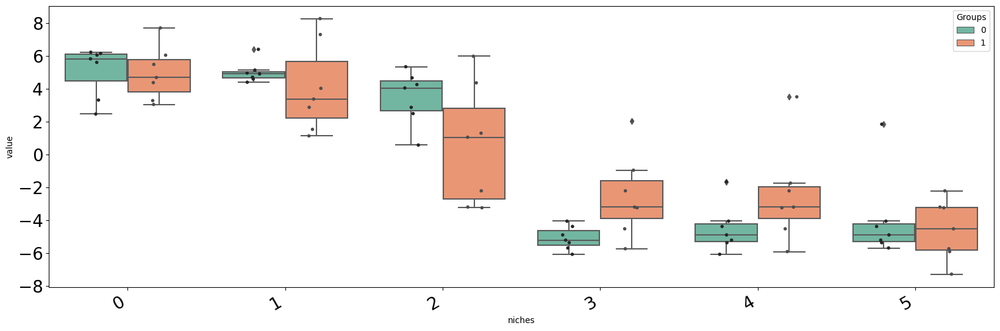

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-45', 'metric-manhattan', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-50', 'resolution', 'resolution_parameter-0.03', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


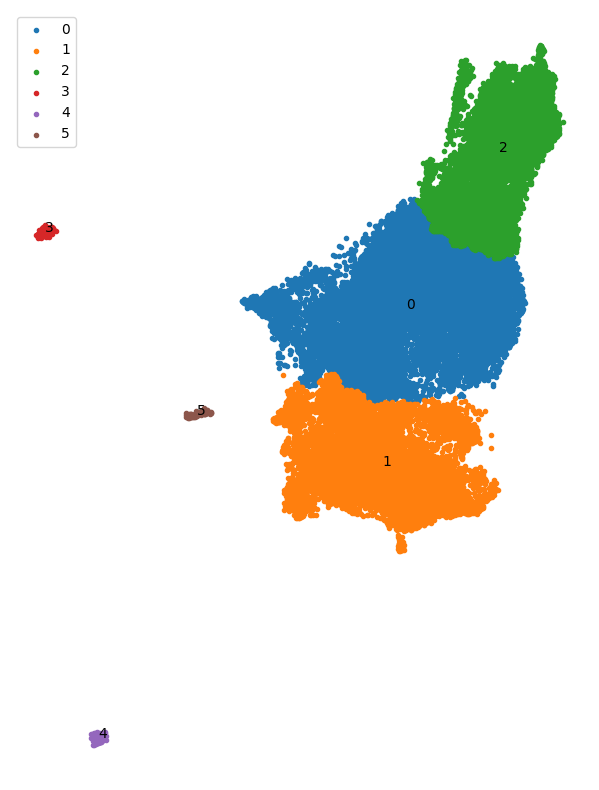

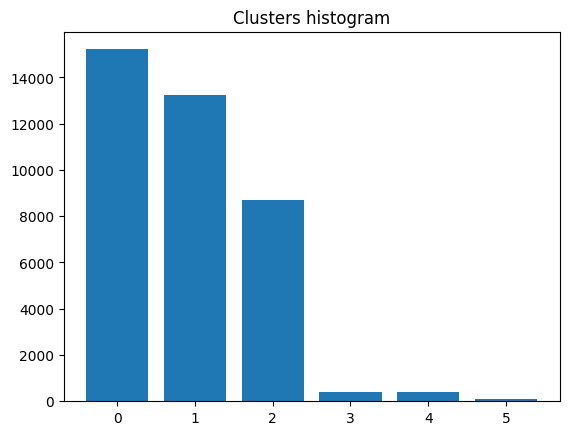

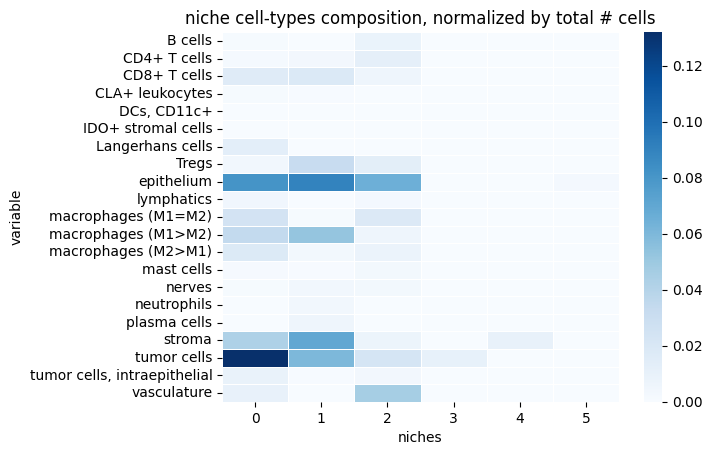

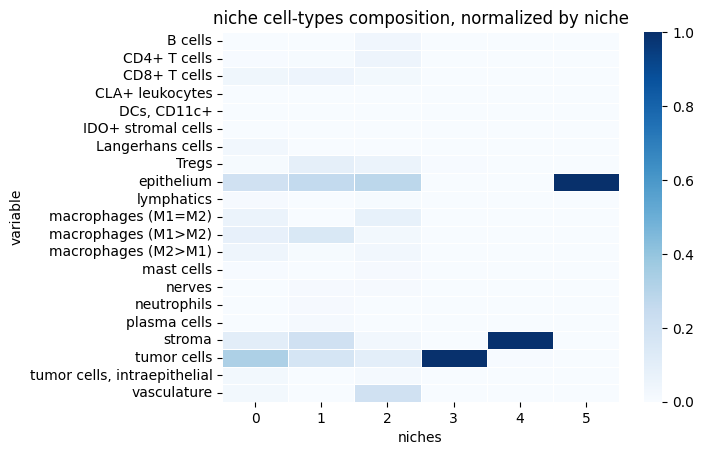

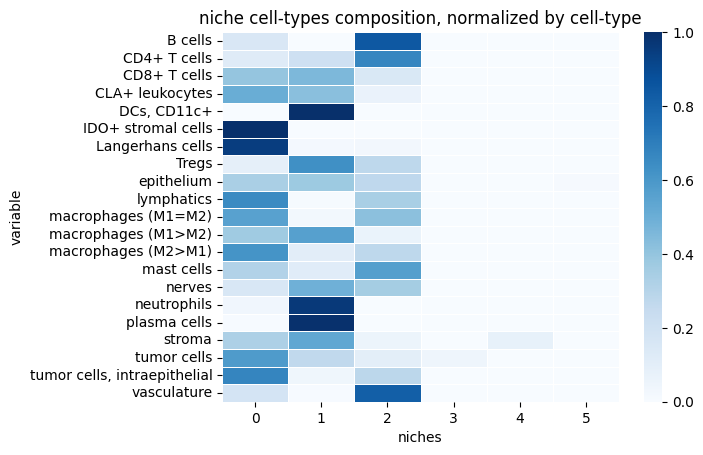

reducer_type-umap_n_neighbors-45_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


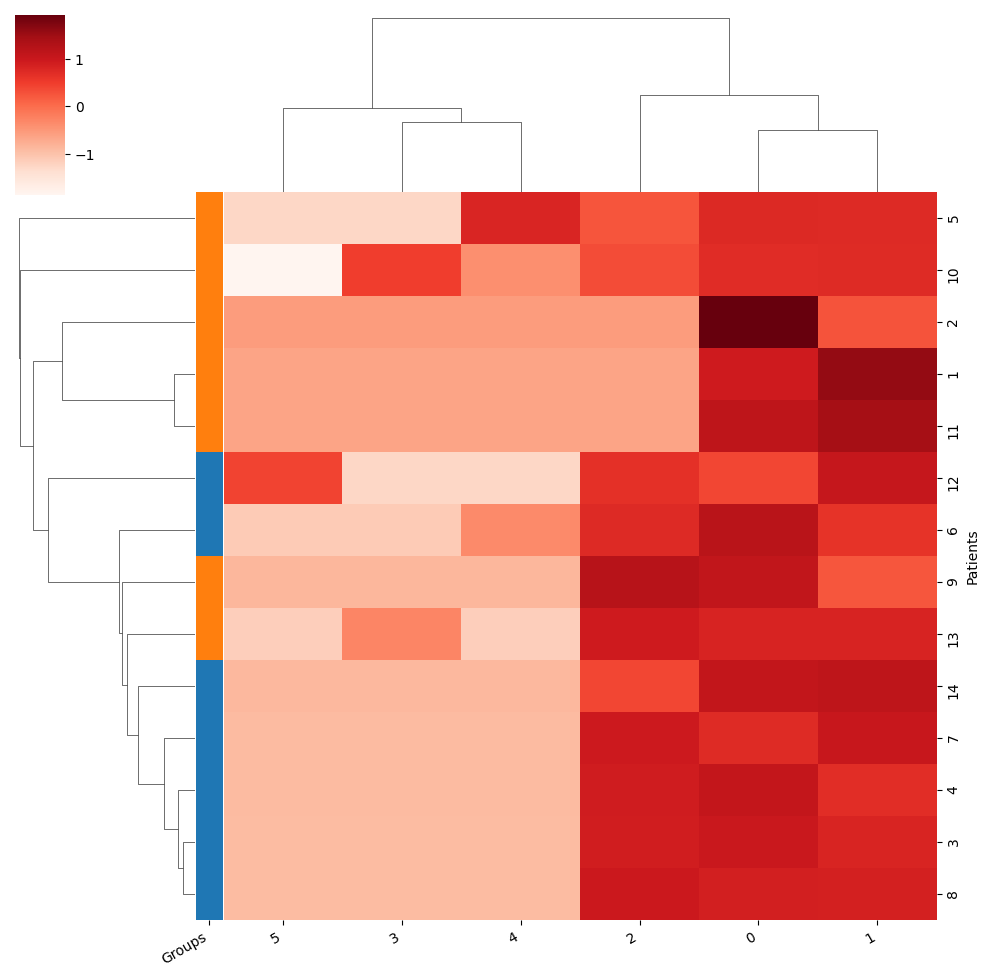

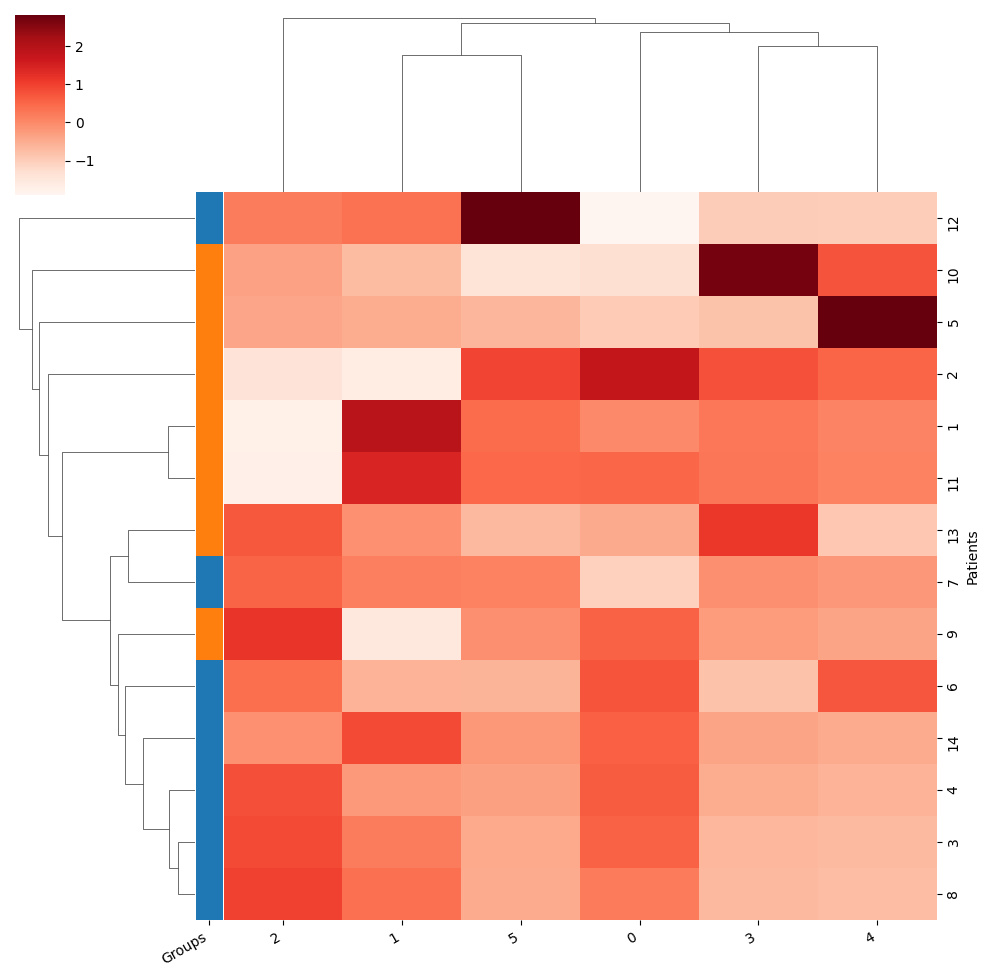

Training took 2.485s


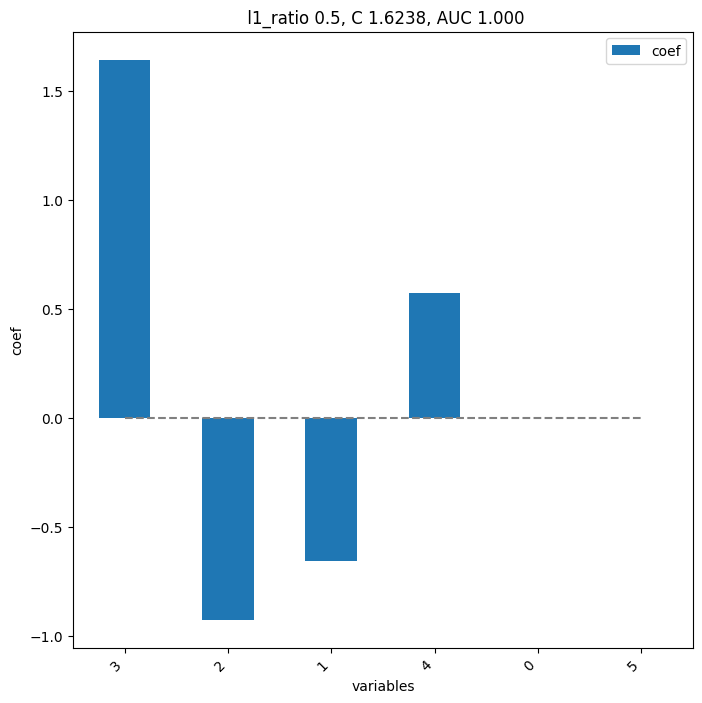

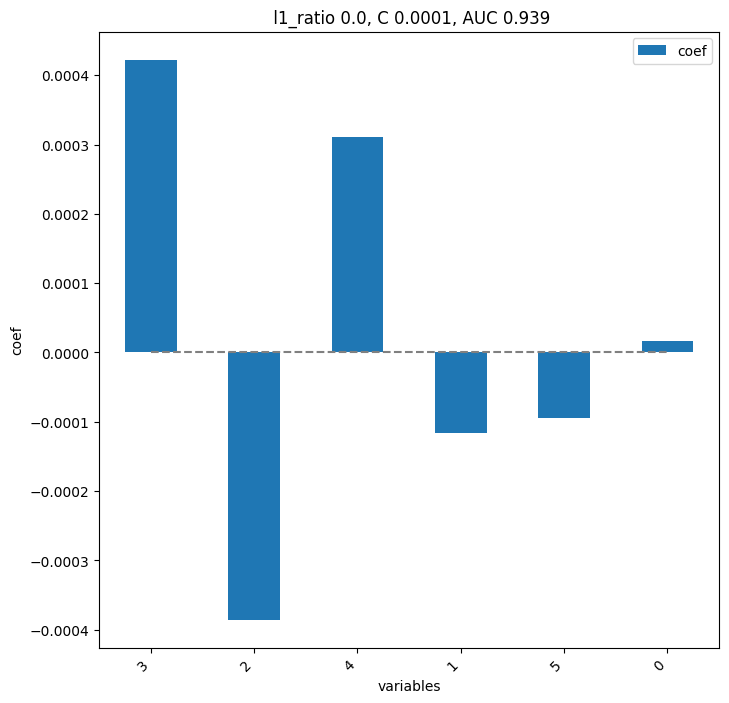

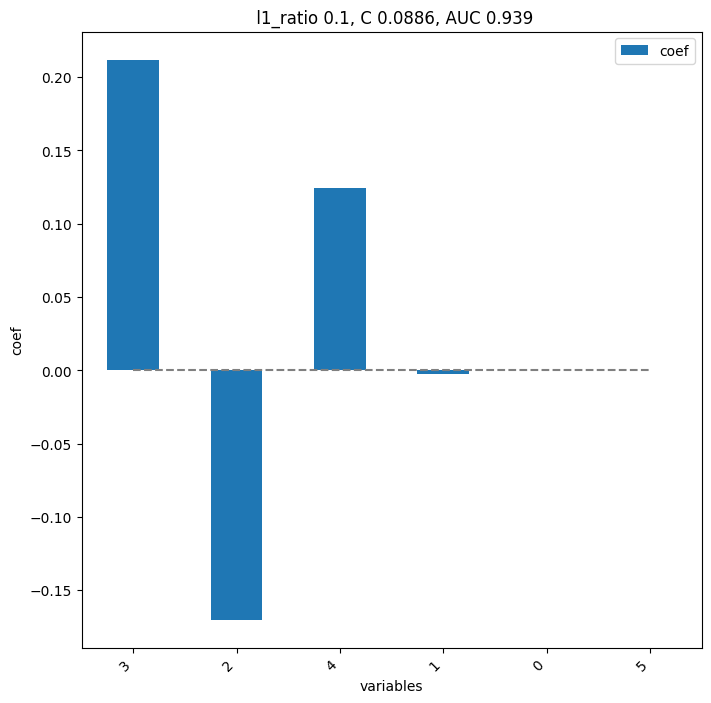

       pval  pval_corr
3  0.026224   0.157343
2  0.097319   0.194639
4  0.097319   0.194639
1  0.382867   0.574301
0  0.620047   0.744056
5  0.901515   0.901515


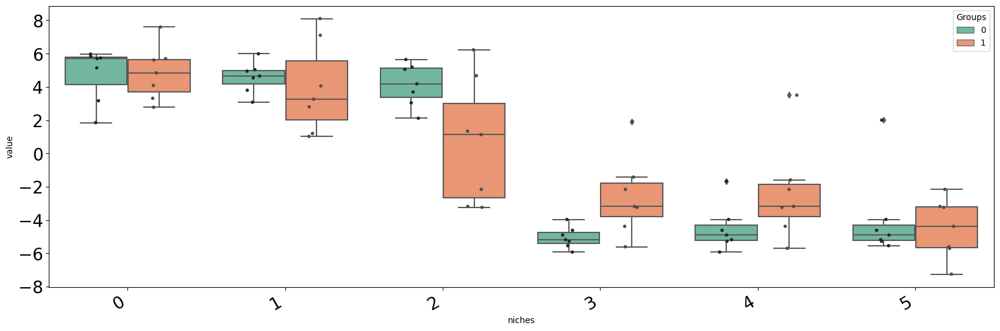

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-75', 'metric-cosine', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-50', 'resolution', 'resolution_parameter-0.03', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


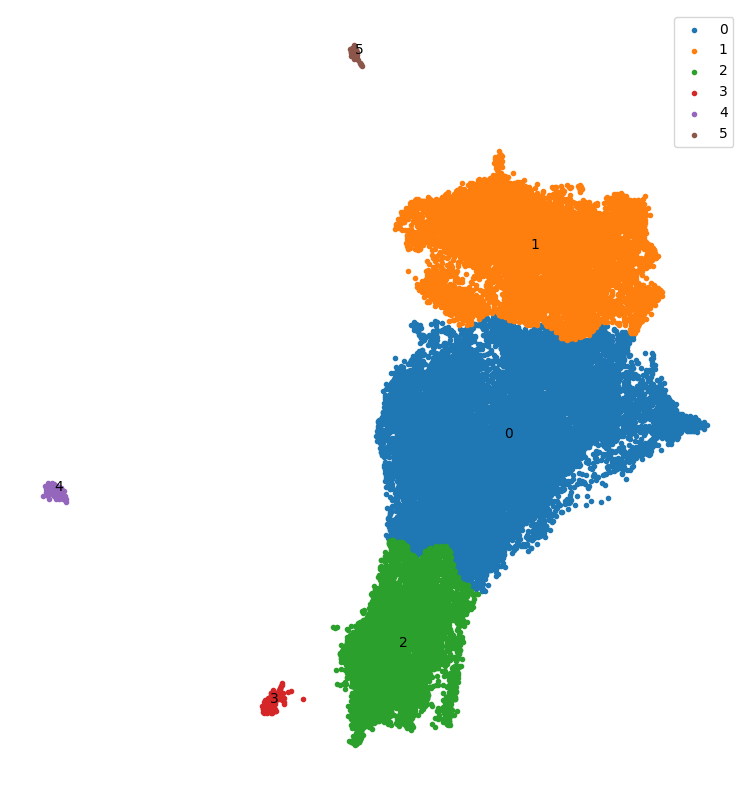

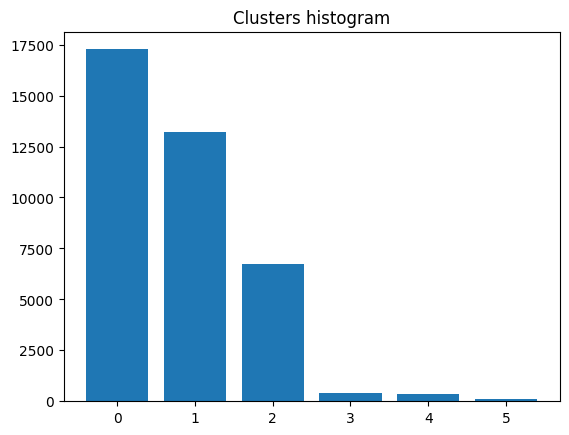

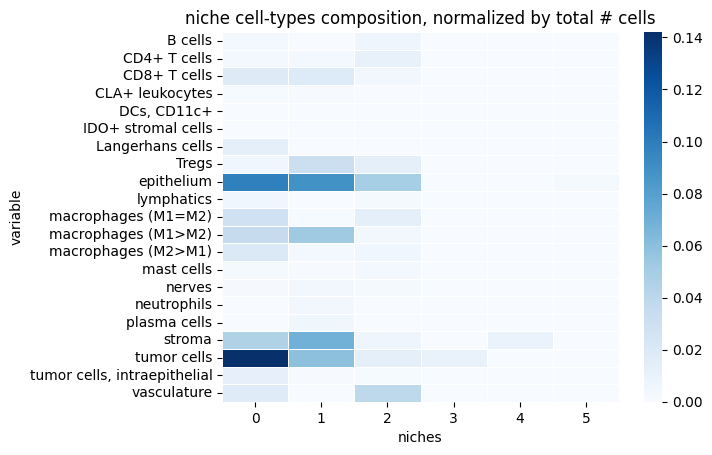

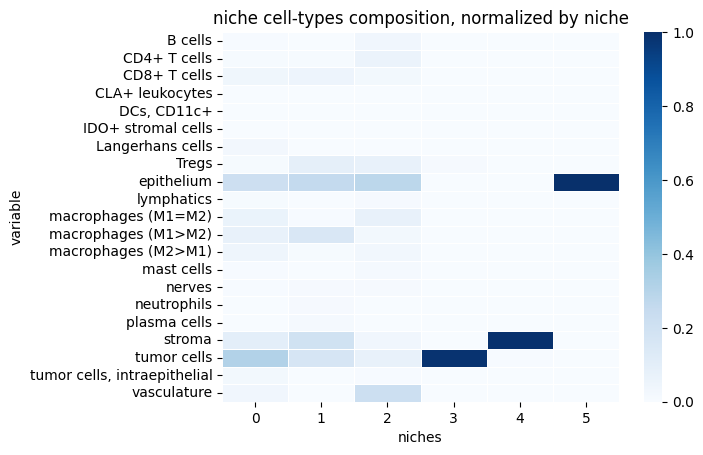

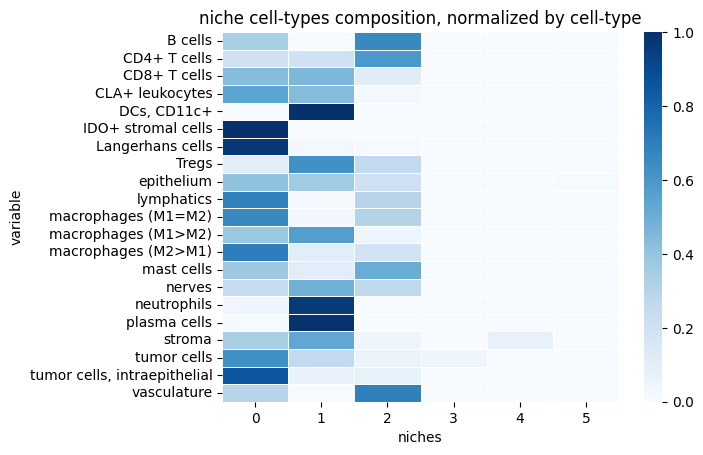

reducer_type-umap_n_neighbors-75_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


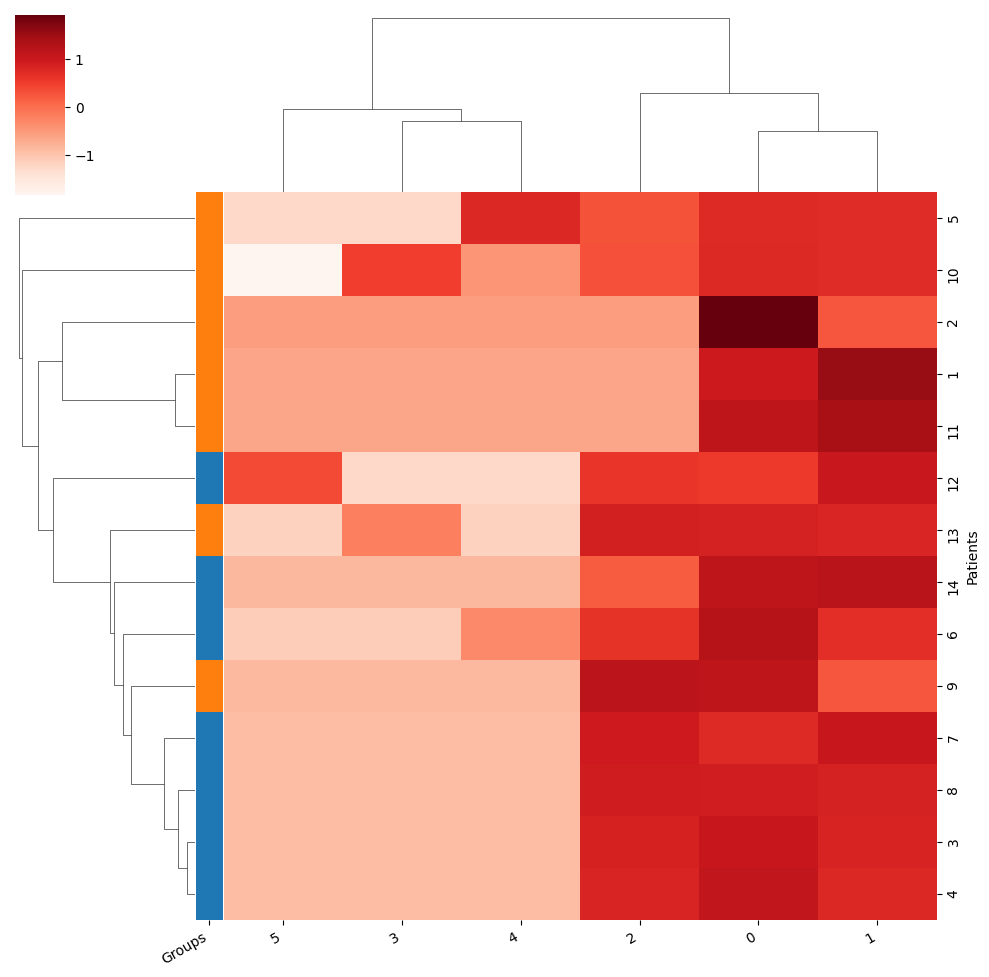

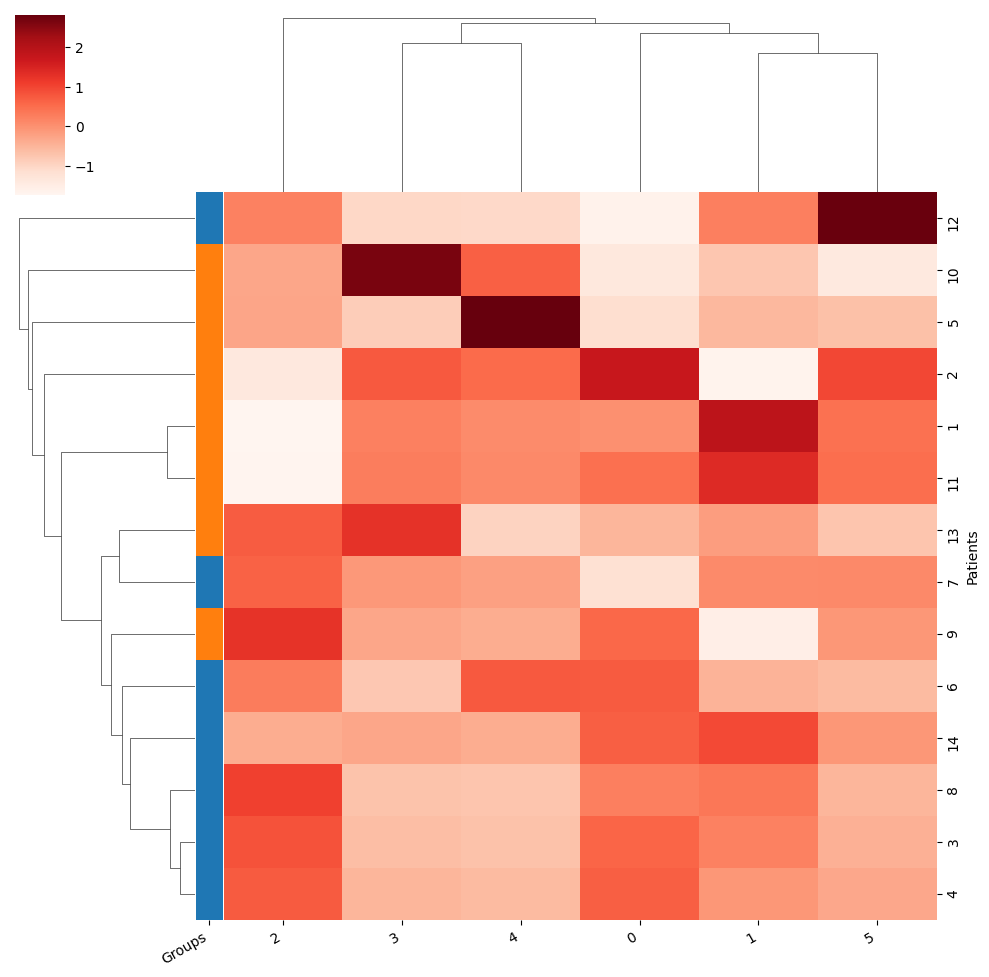

Training took 2.477s


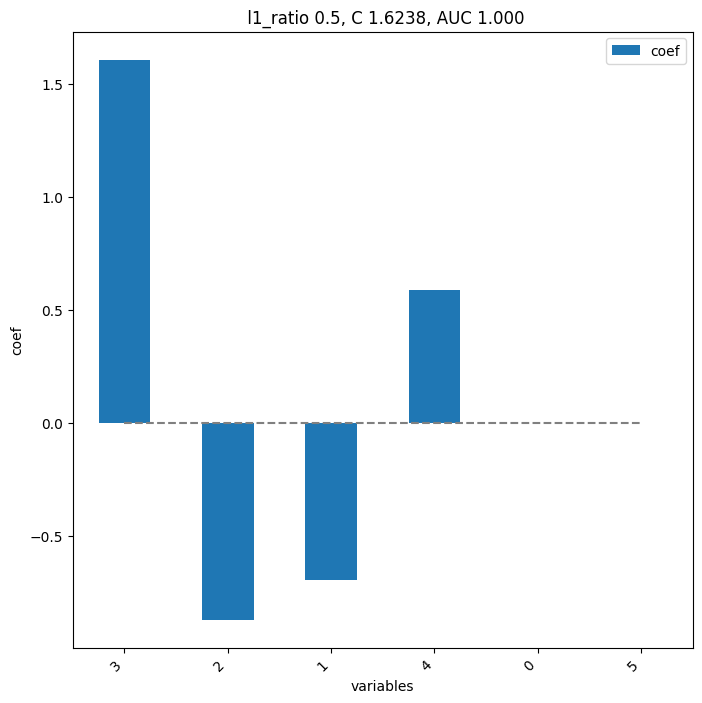

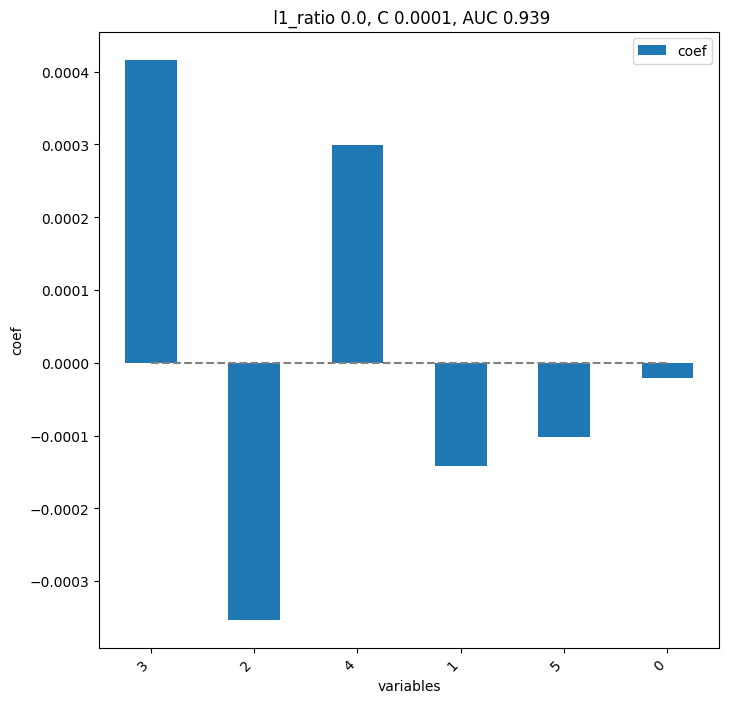

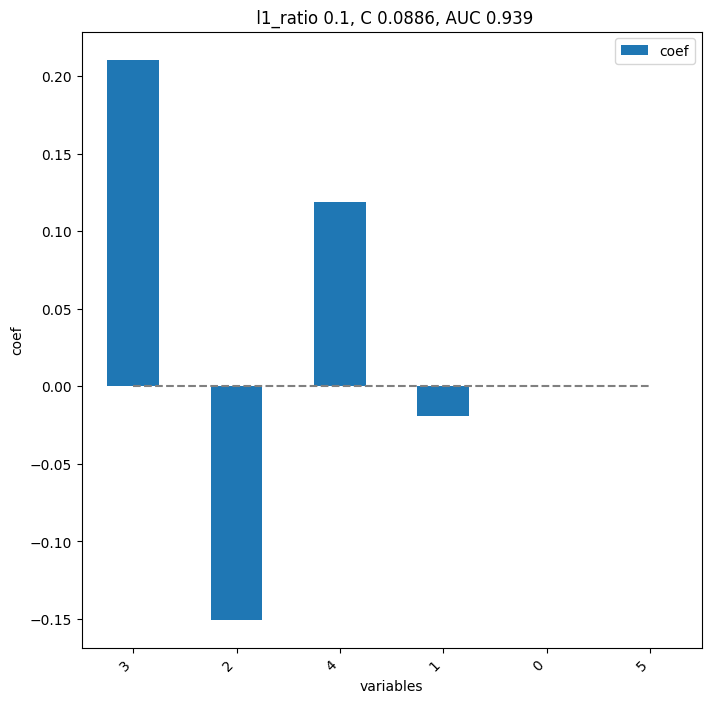

       pval  pval_corr
3  0.037879   0.227273
2  0.164918   0.329837
4  0.164918   0.329837
1  0.259324   0.388986
0  0.620047   0.744056
5  0.804779   0.804779


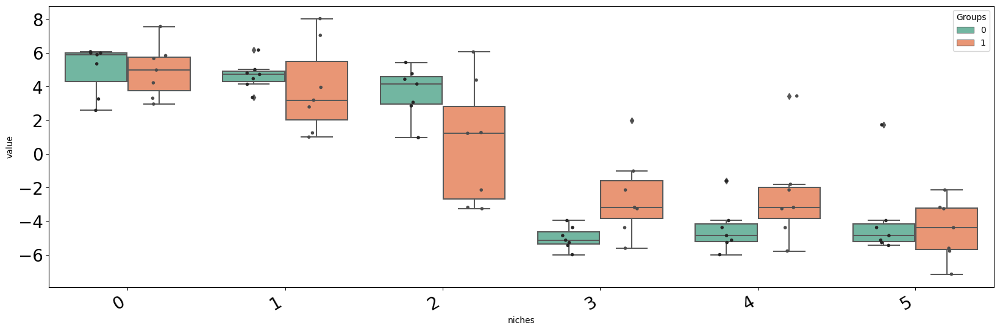

Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


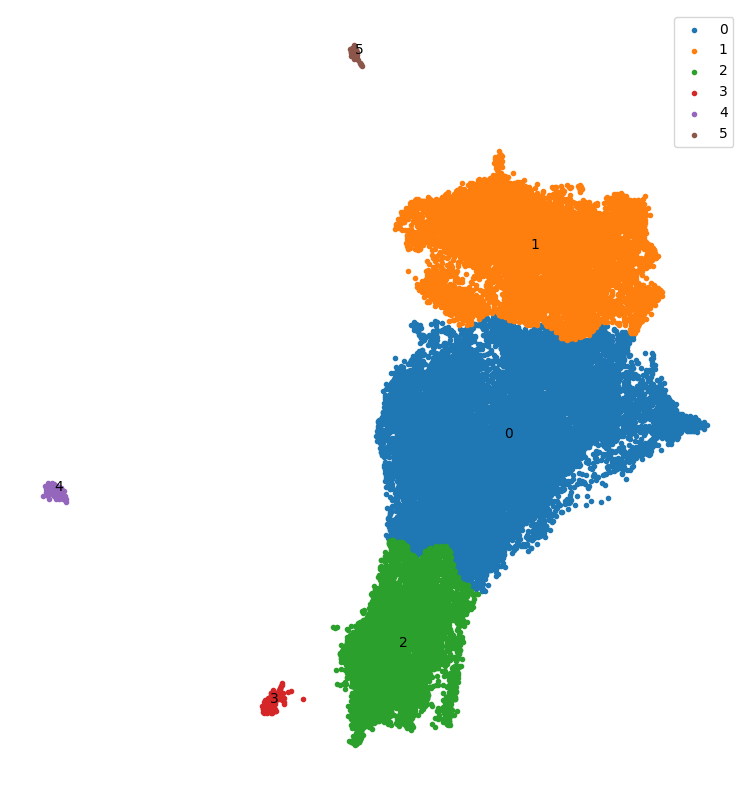

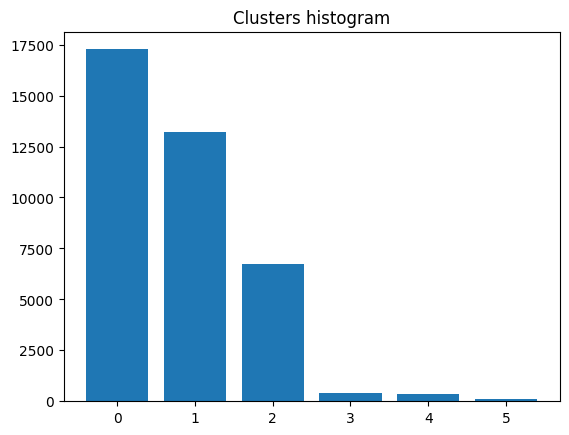

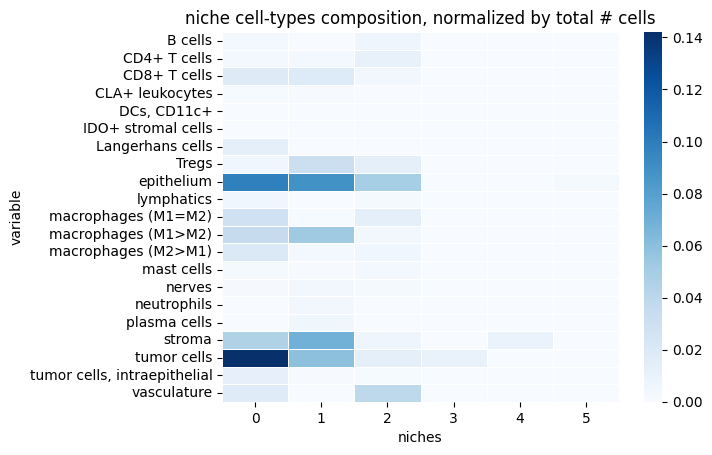

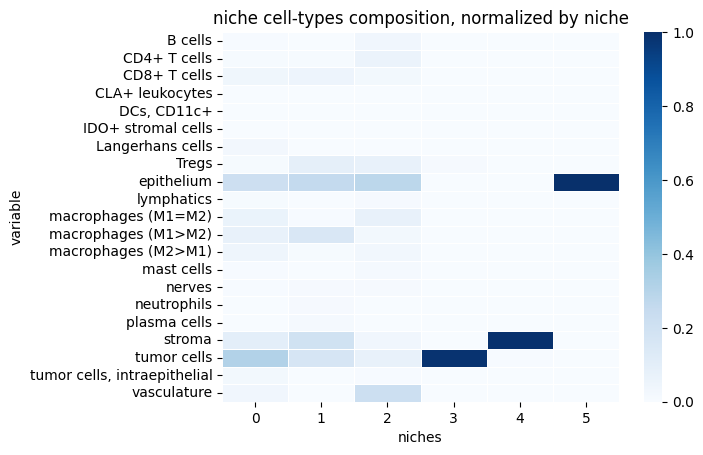

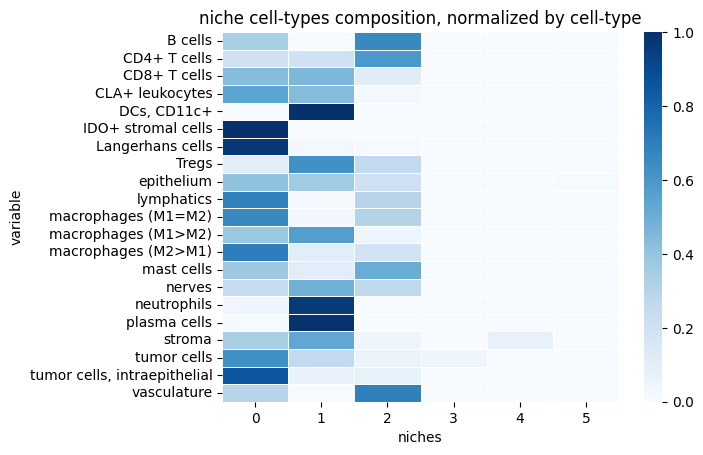

reducer_type-umap_n_neighbors-75_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


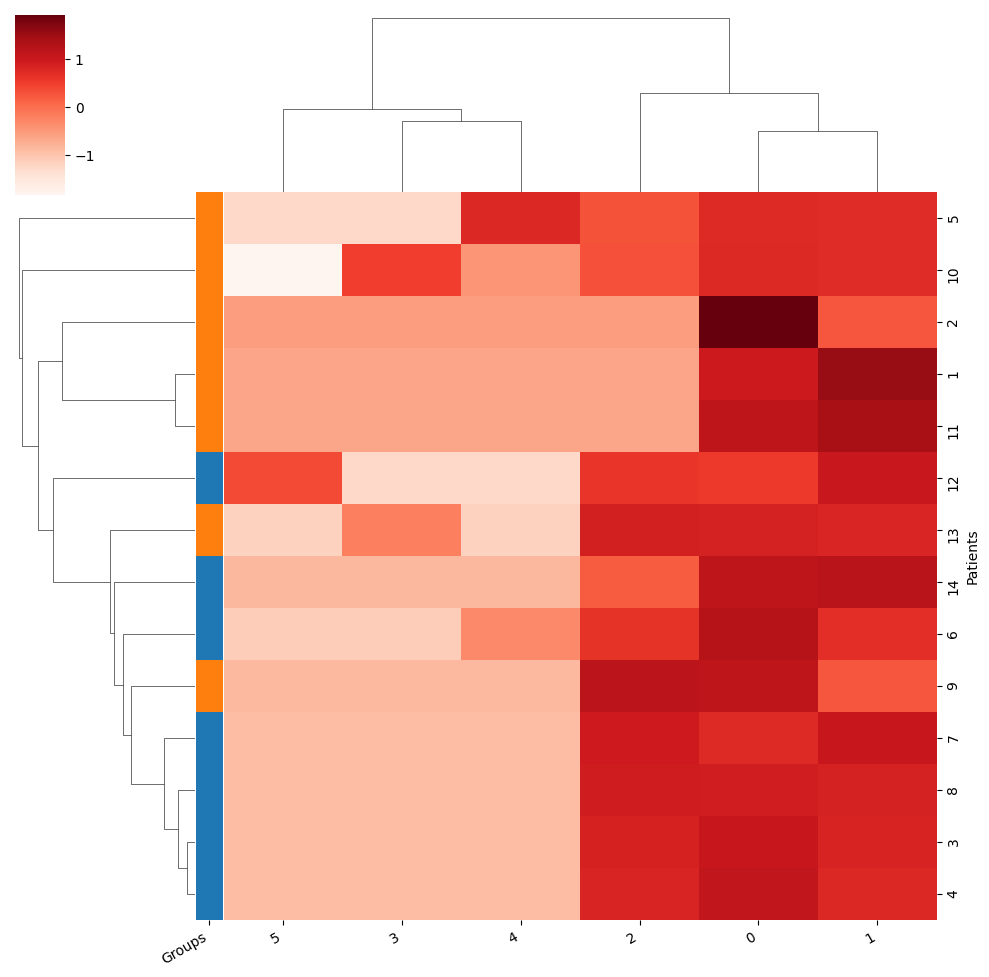

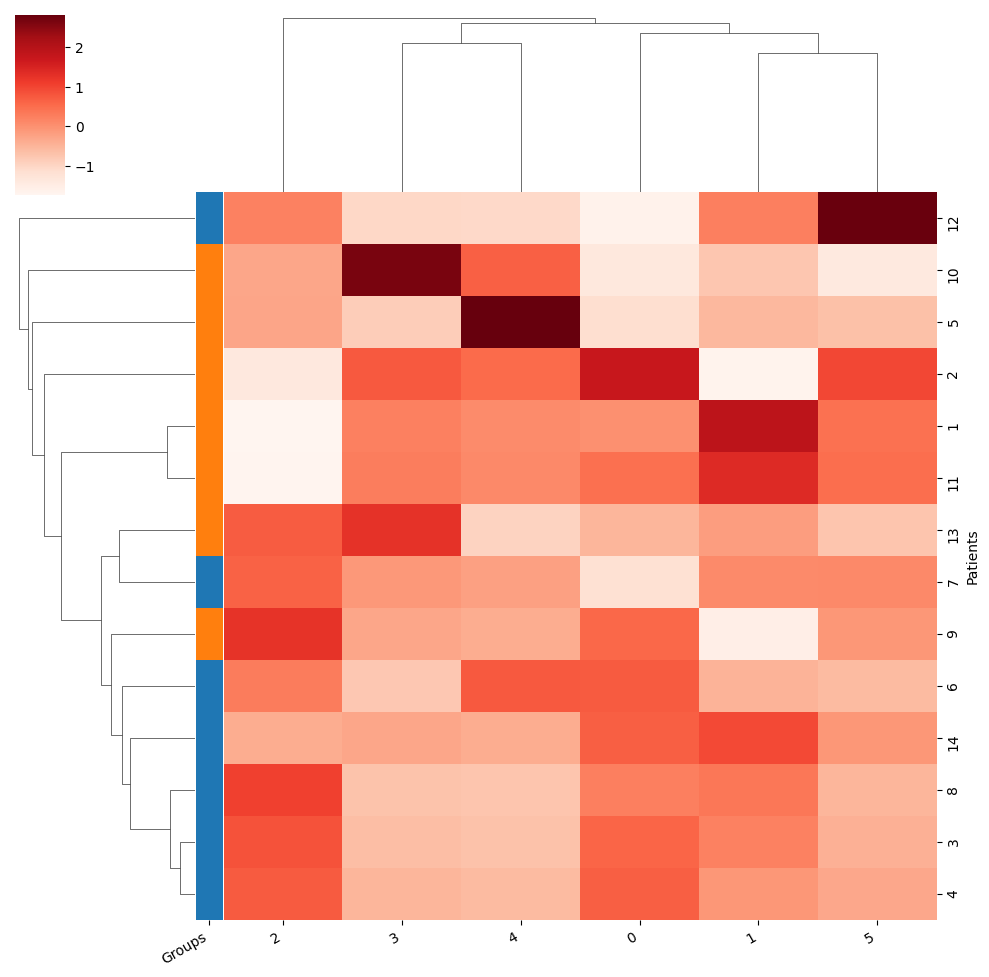

Training took 2.422s


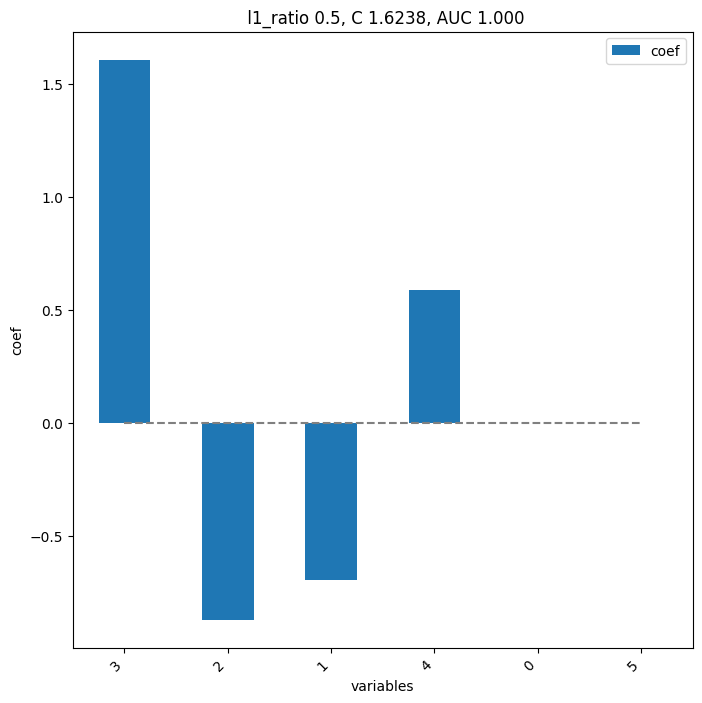

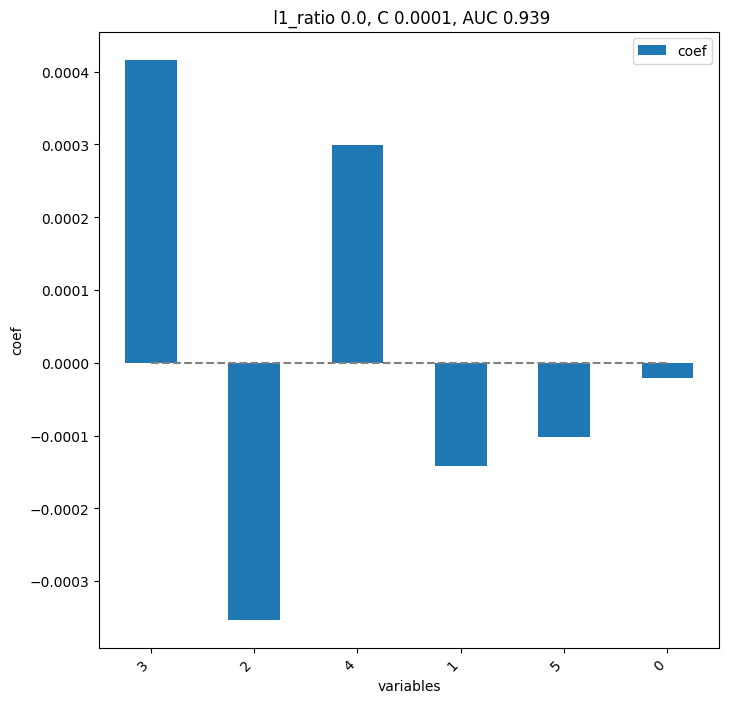

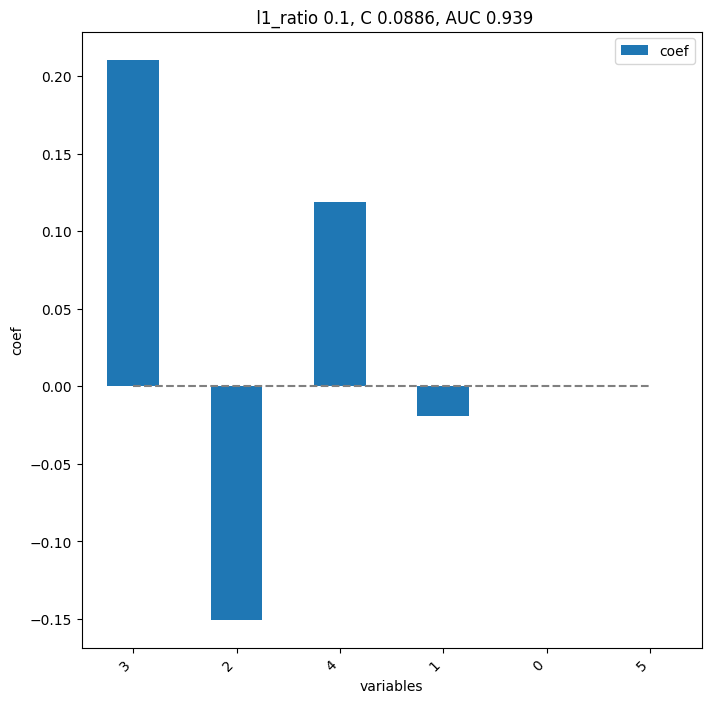

       pval  pval_corr
3  0.037879   0.227273
2  0.164918   0.329837
4  0.164918   0.329837
1  0.259324   0.388986
0  0.620047   0.744056
5  0.804779   0.804779


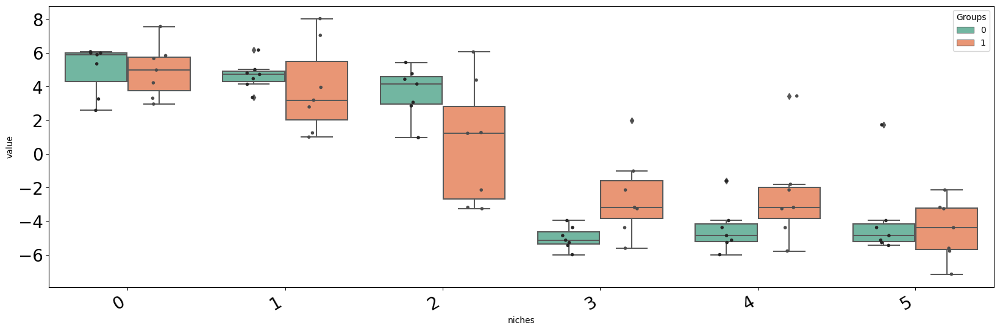

Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


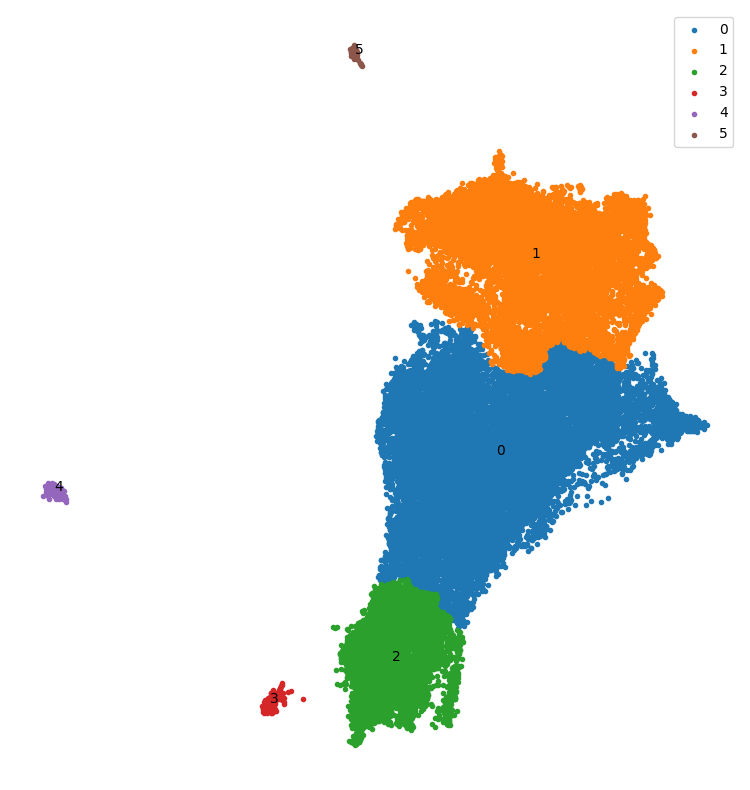

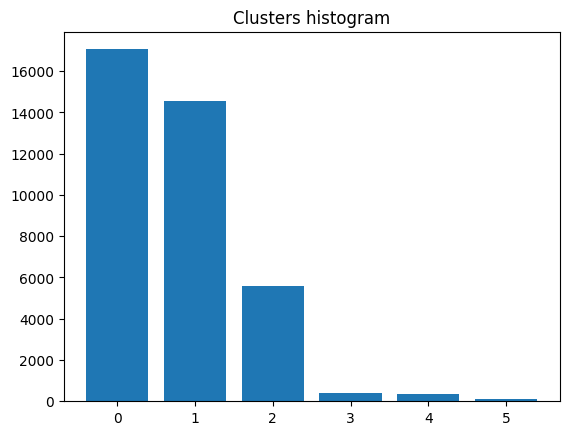

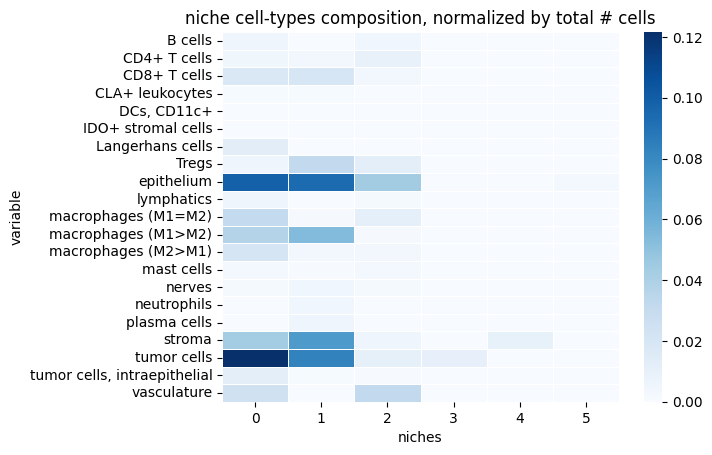

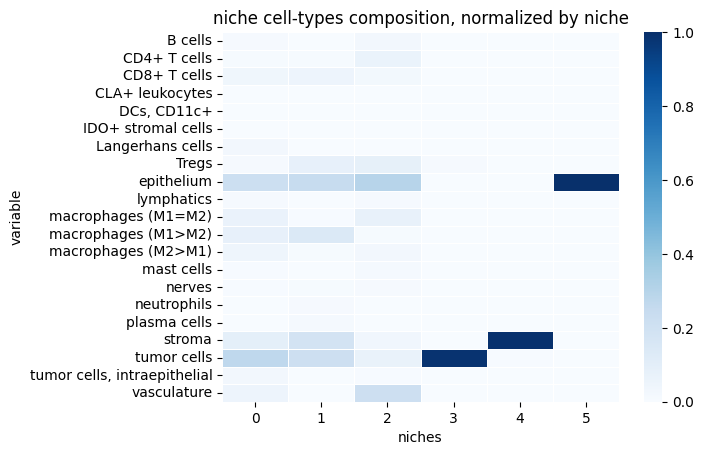

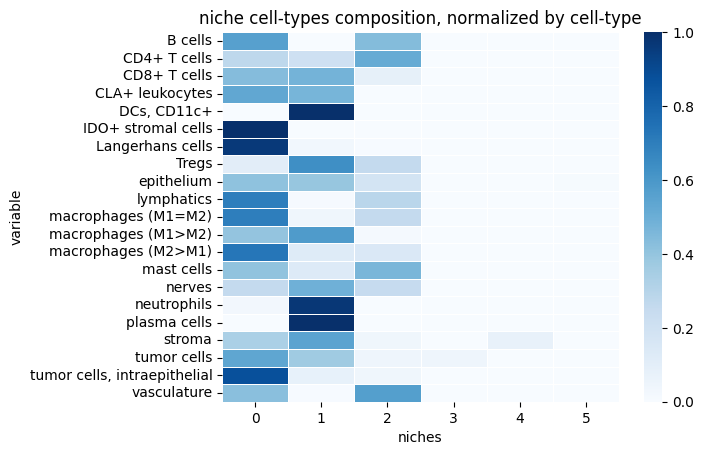

reducer_type-umap_n_neighbors-75_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.01_normalize-clr


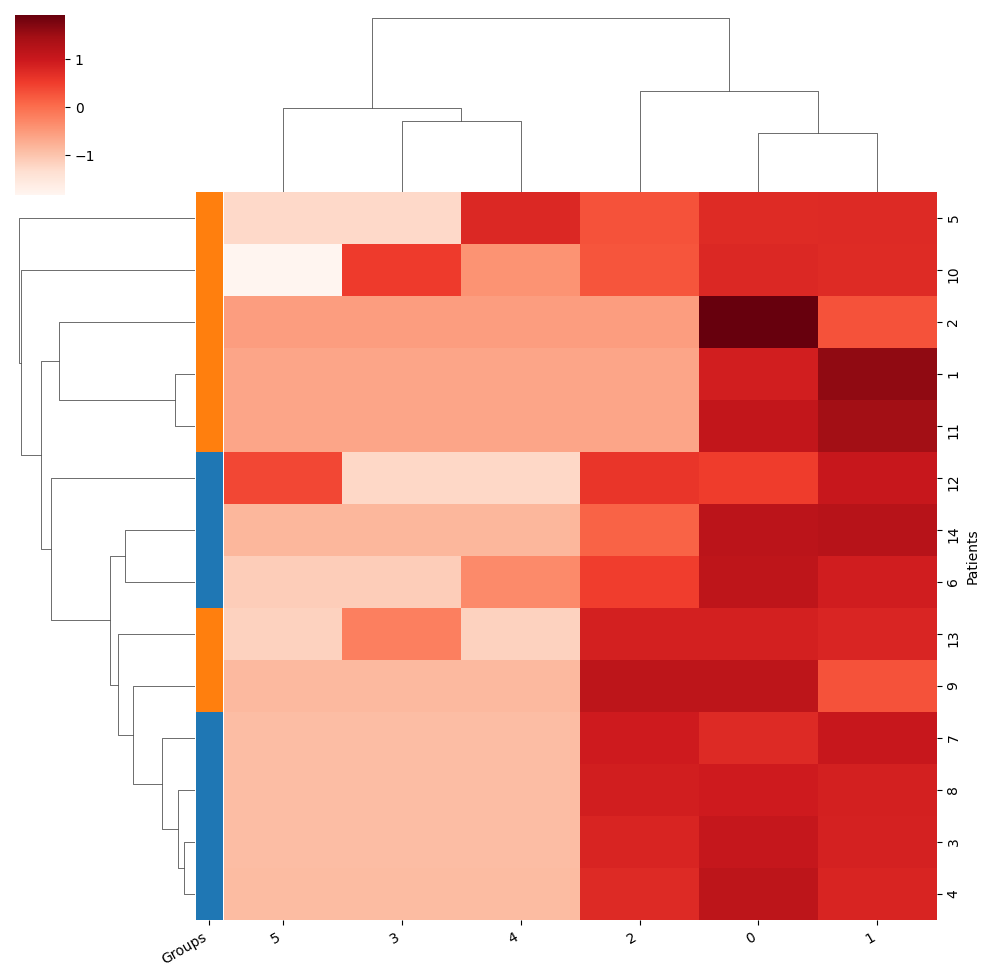

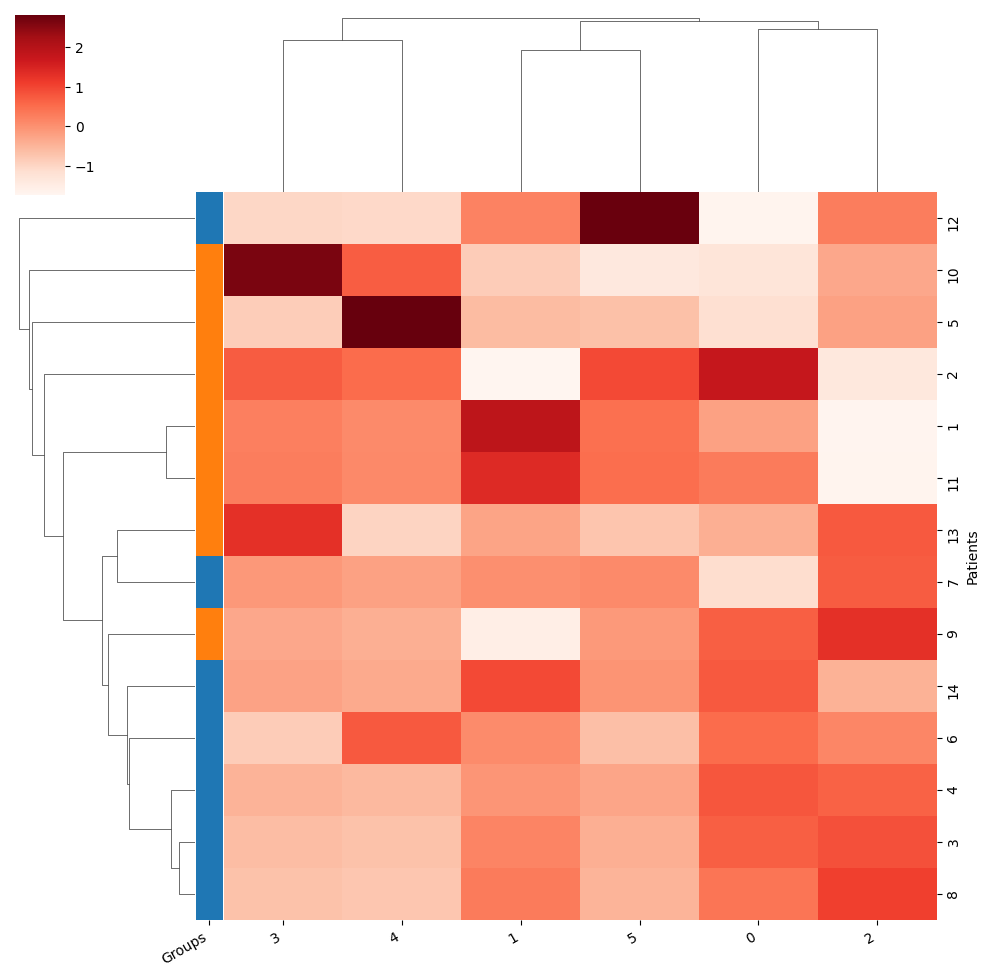

Training took 2.410s


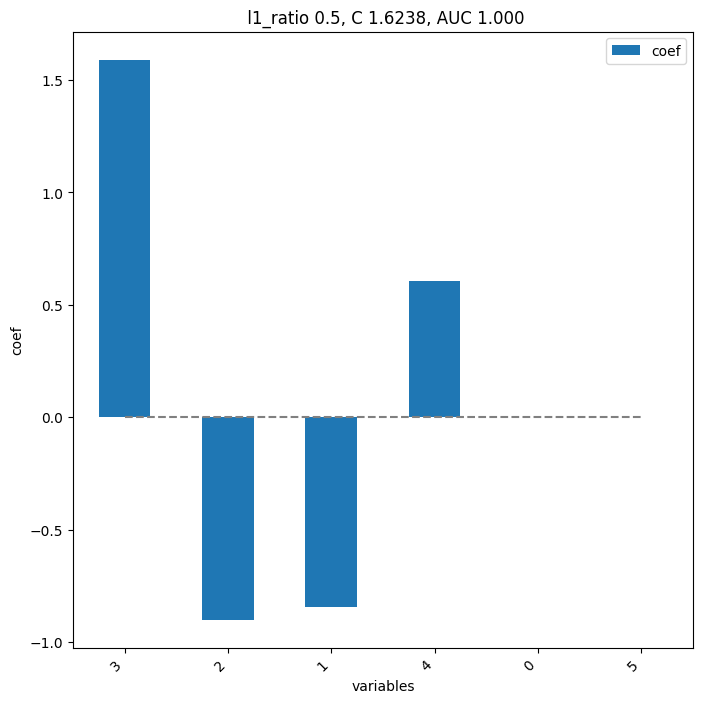

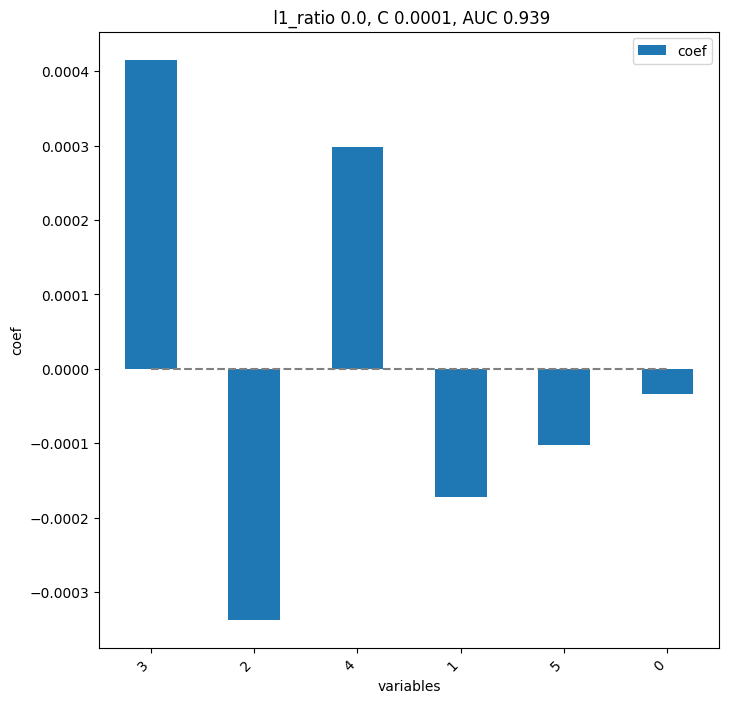

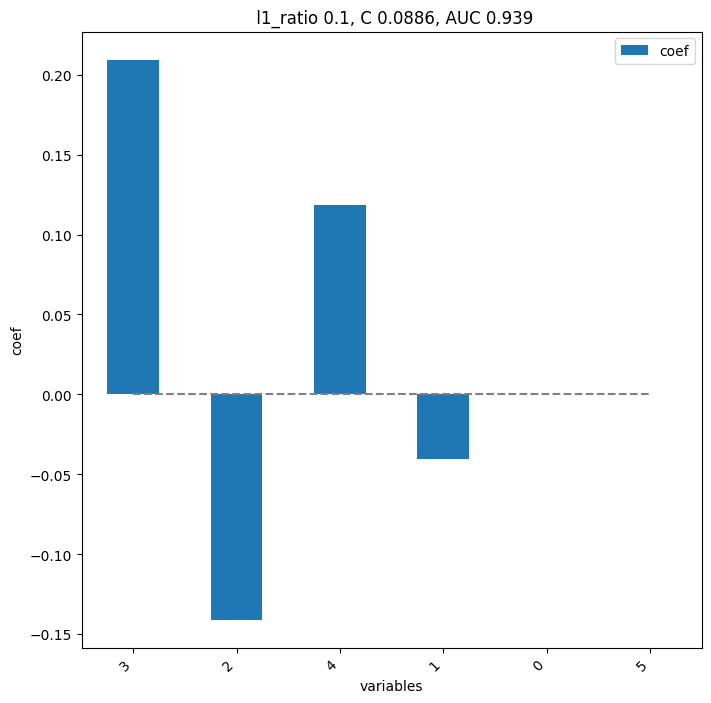

       pval  pval_corr
3  0.037879   0.227273
4  0.164918   0.312937
1  0.208625   0.312937
2  0.208625   0.312937
0  0.534965   0.641958
5  0.804779   0.804779


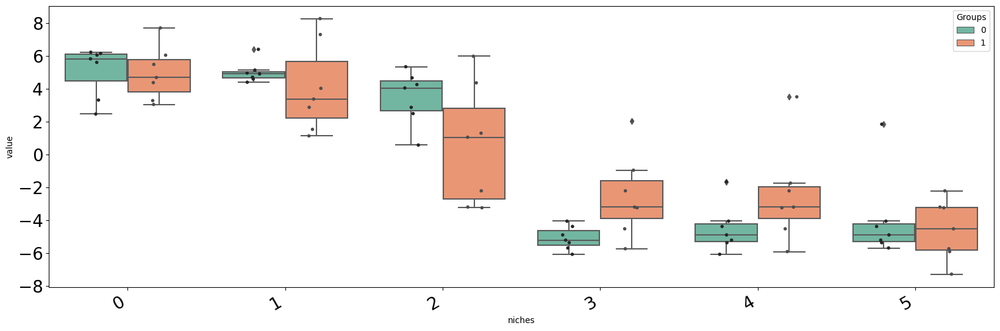

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-100', 'metric-cosine', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-50', 'resolution', 'resolution_parameter-0.1', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 8 clusters
Loading reducer object and reduced coordinates


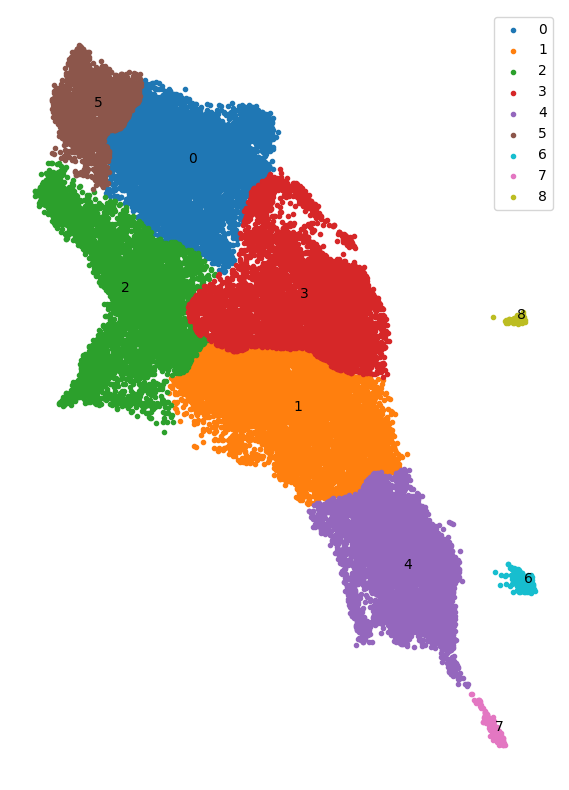

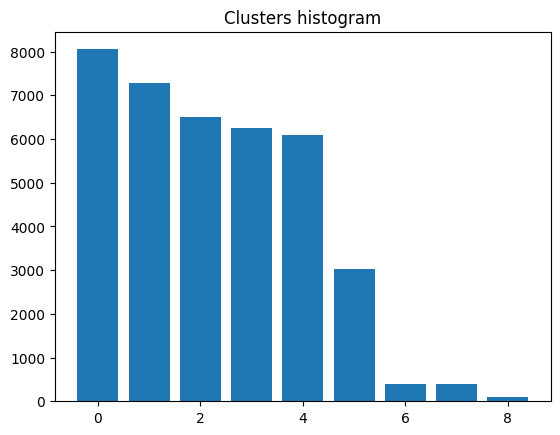

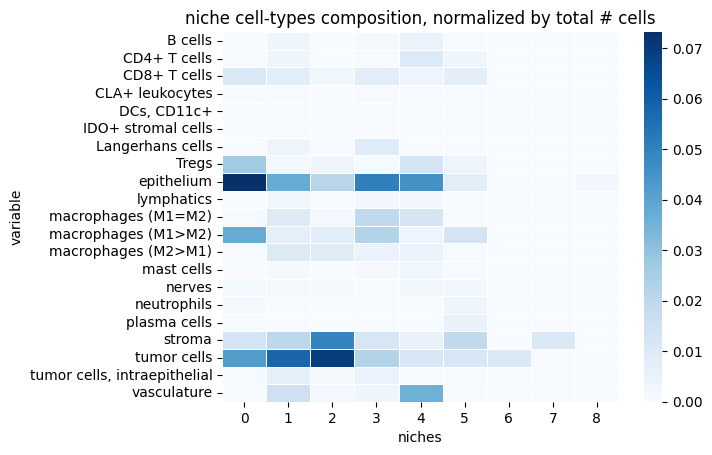

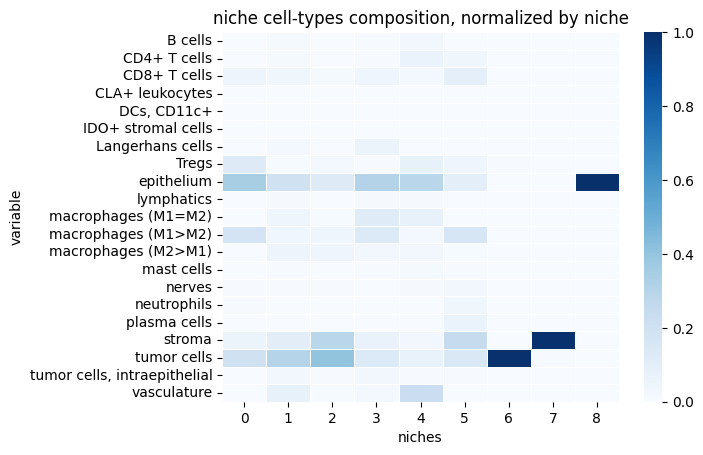

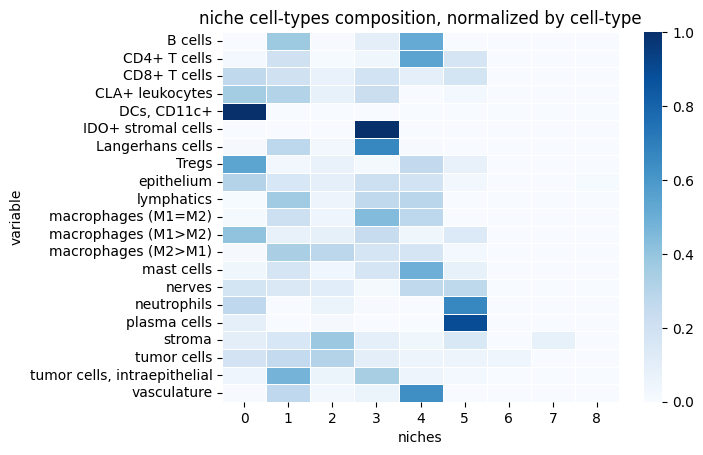

reducer_type-umap_n_neighbors-100_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr


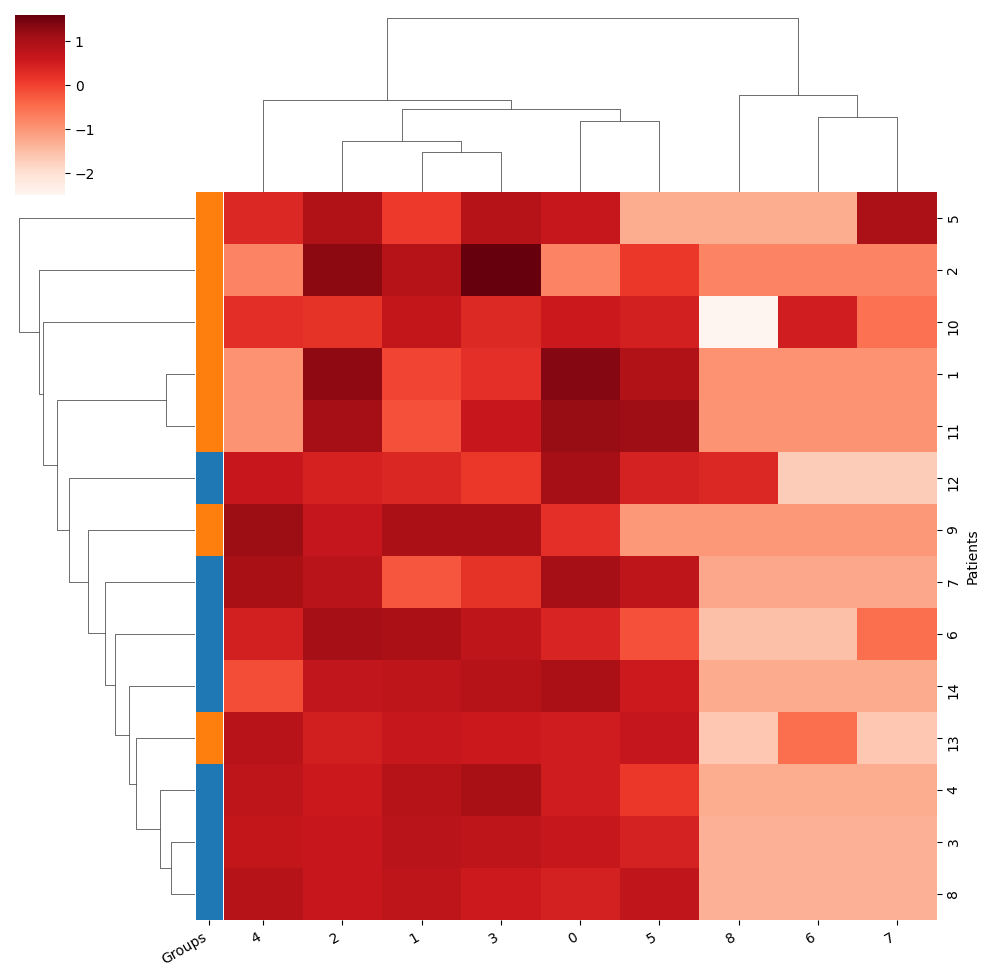

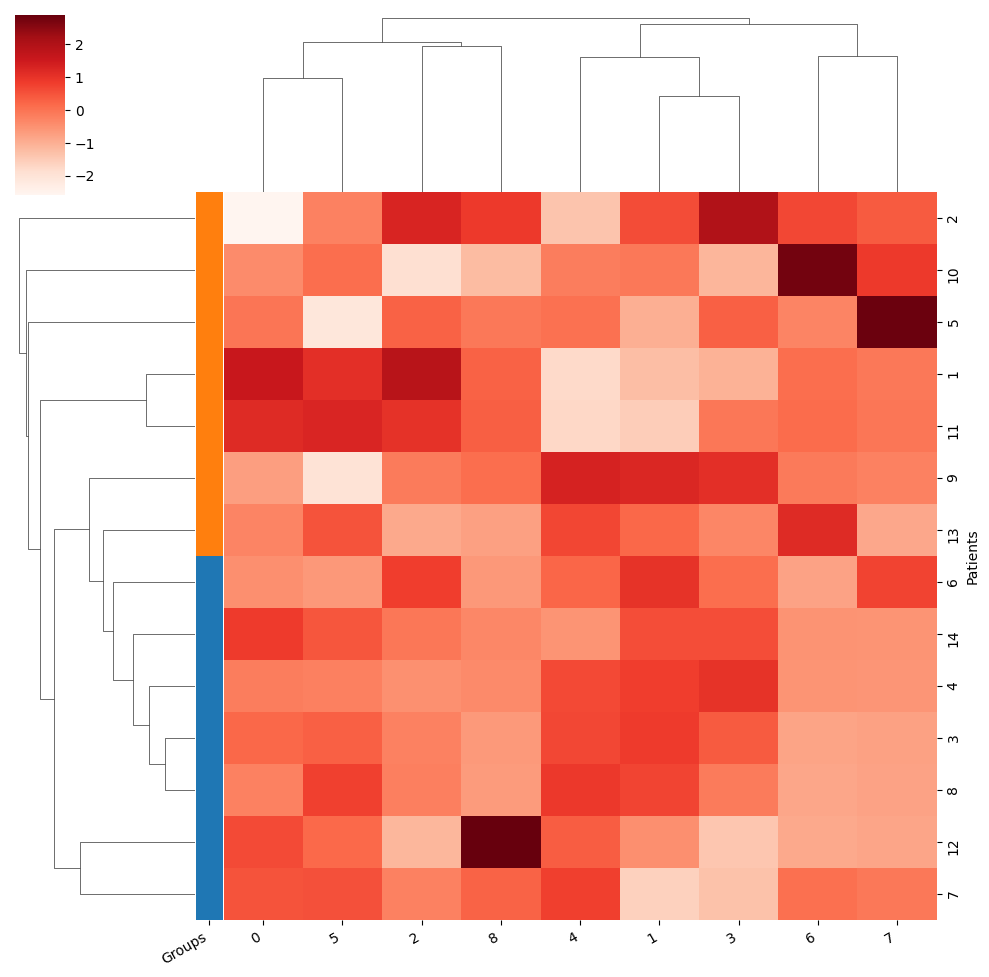

Training took 2.405s


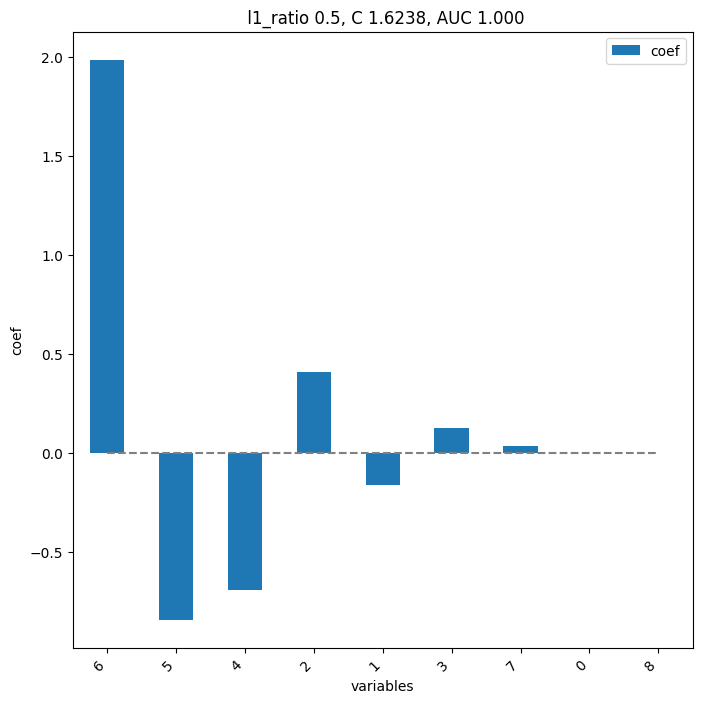

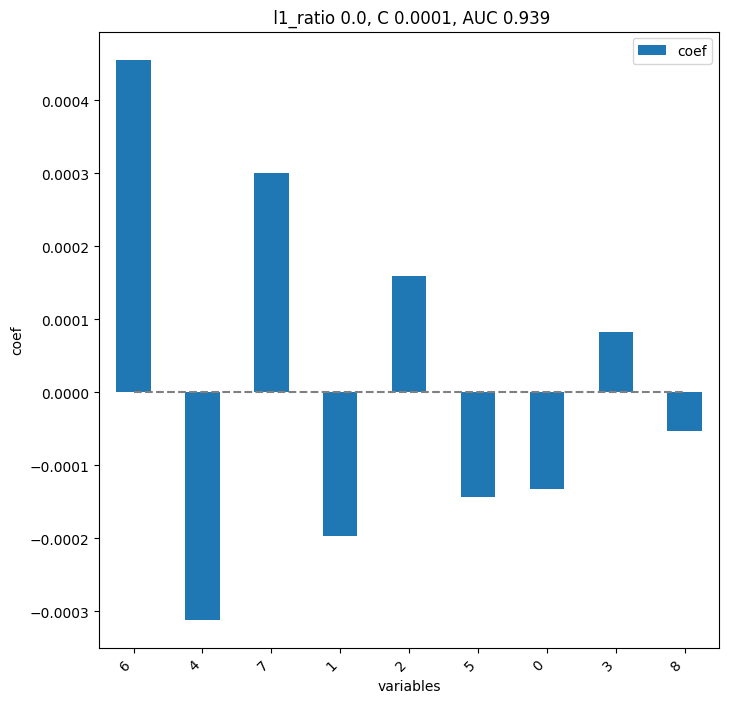

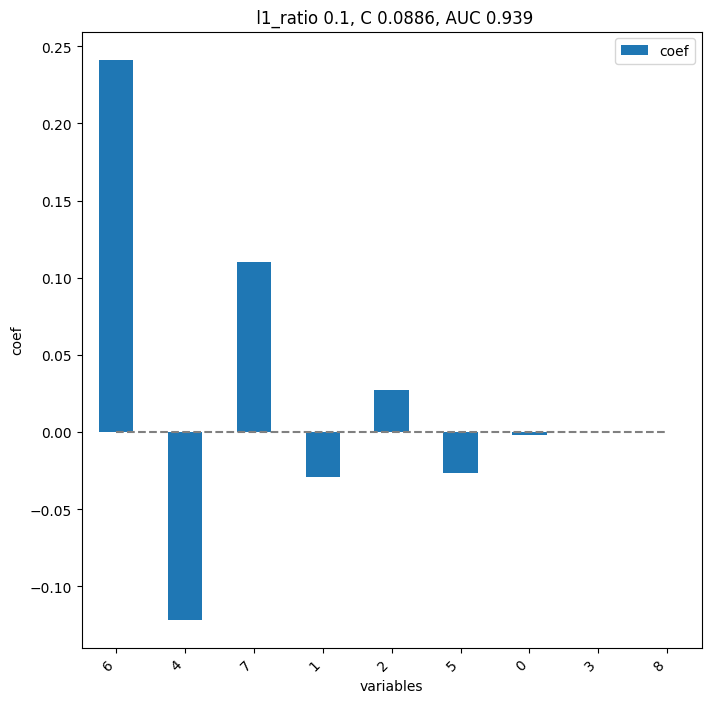

       pval  pval_corr
6  0.002331   0.020979
7  0.128205   0.576923
4  0.208625   0.625874
2  0.317599   0.689161
1  0.382867   0.689161
0  0.534965   0.802448
8  0.710373   0.804779
3  0.804779   0.804779
5  0.804779   0.804779


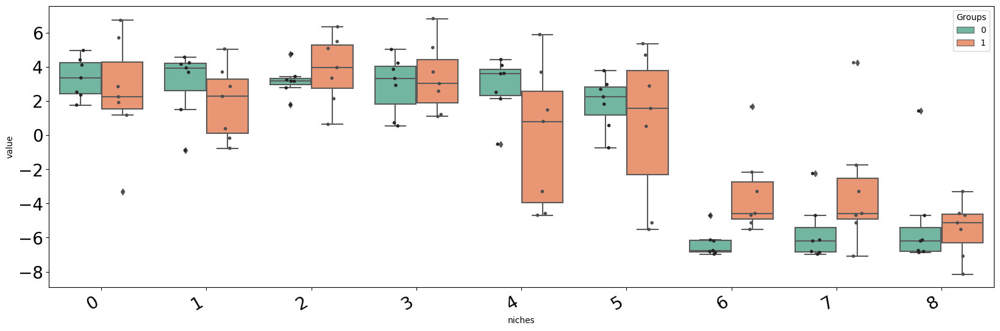

Loading clusterer object and cluster labels
There are 13 clusters
Loading reducer object and reduced coordinates


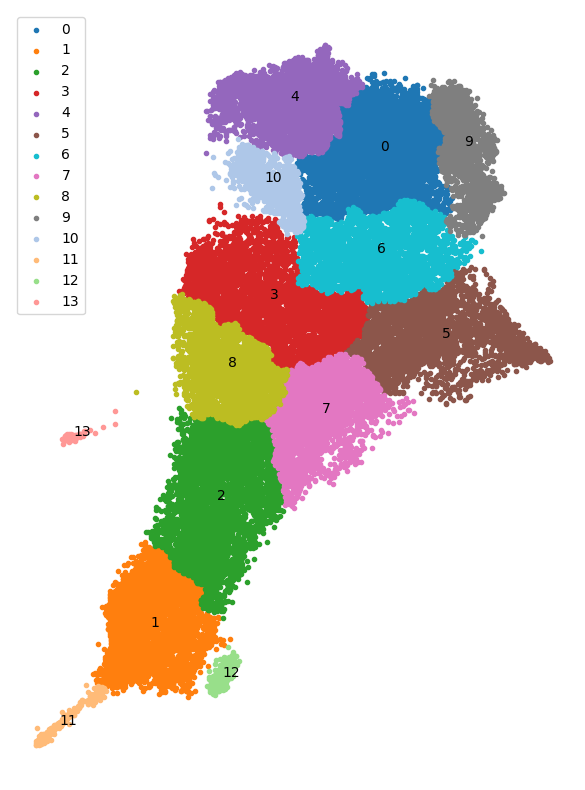

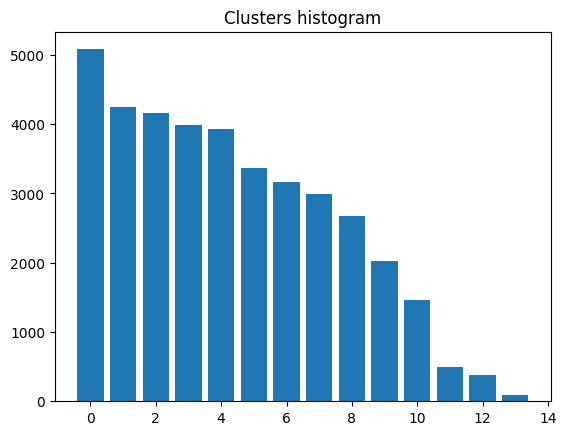

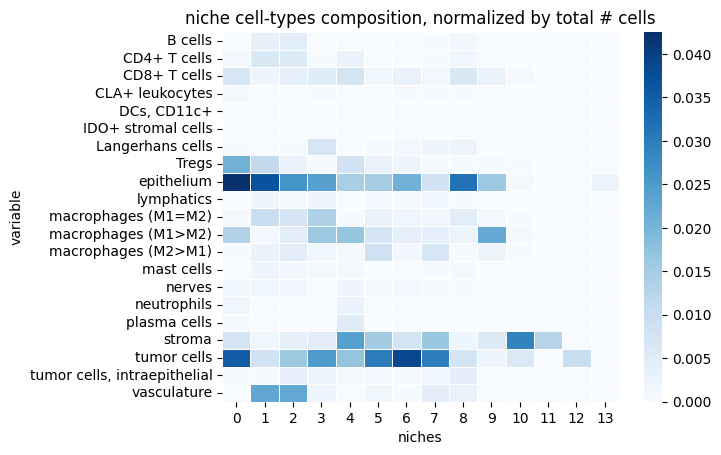

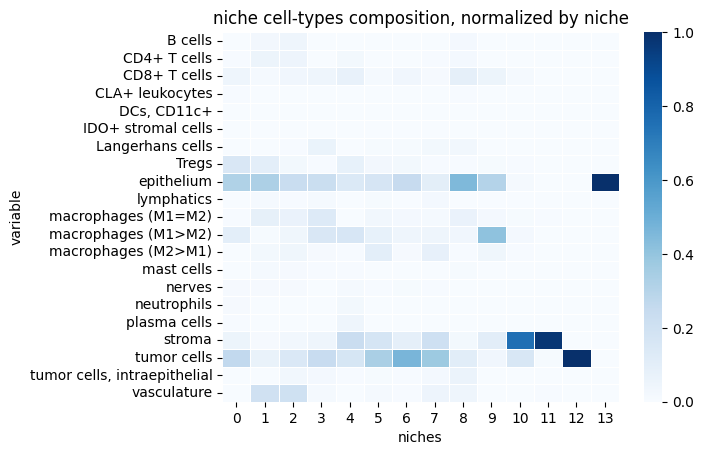

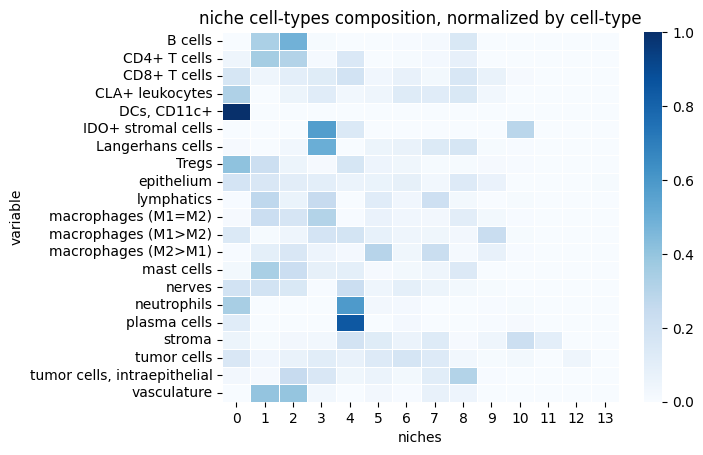

reducer_type-umap_n_neighbors-200_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr


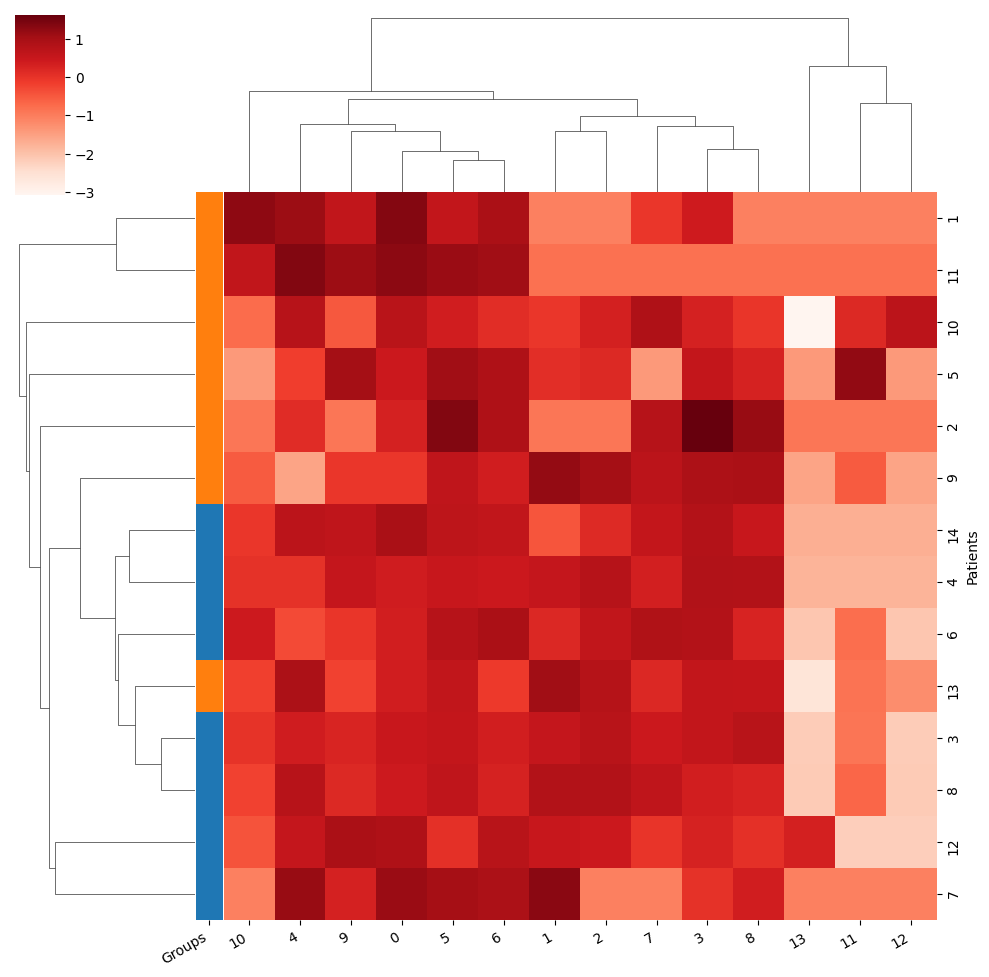

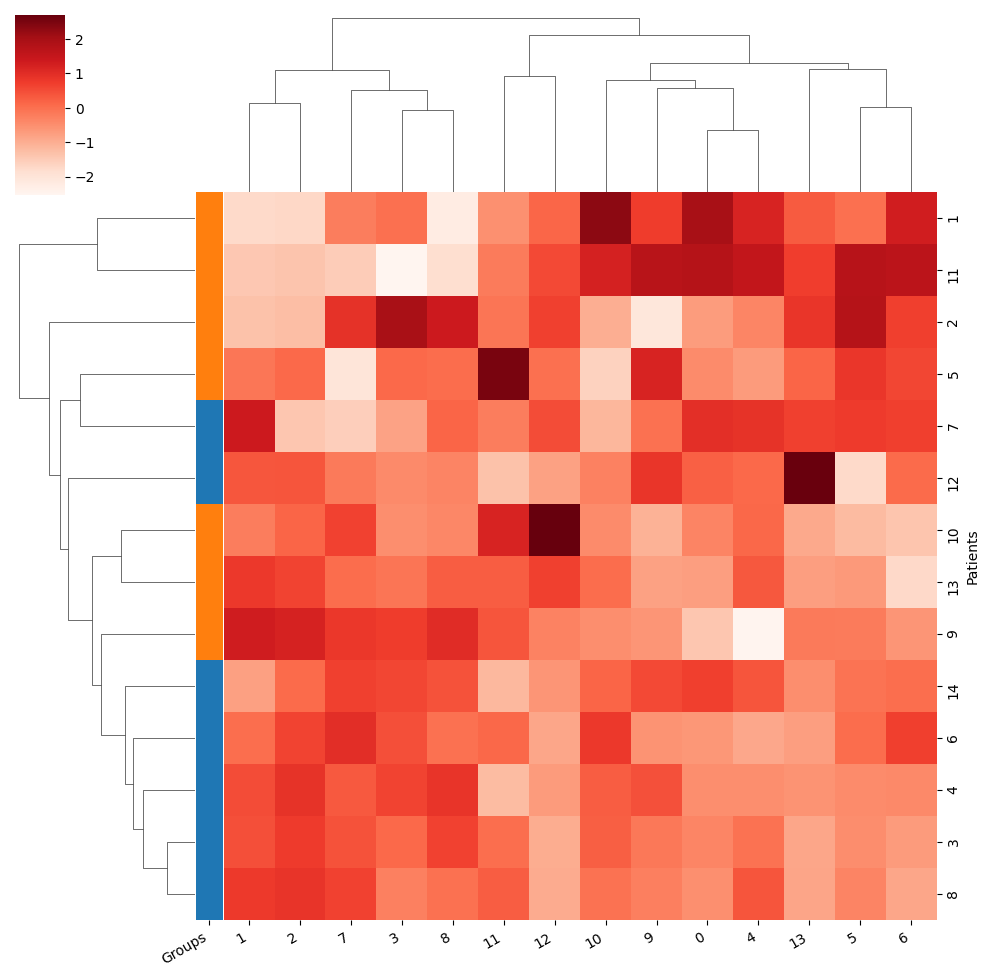

Training took 2.435s


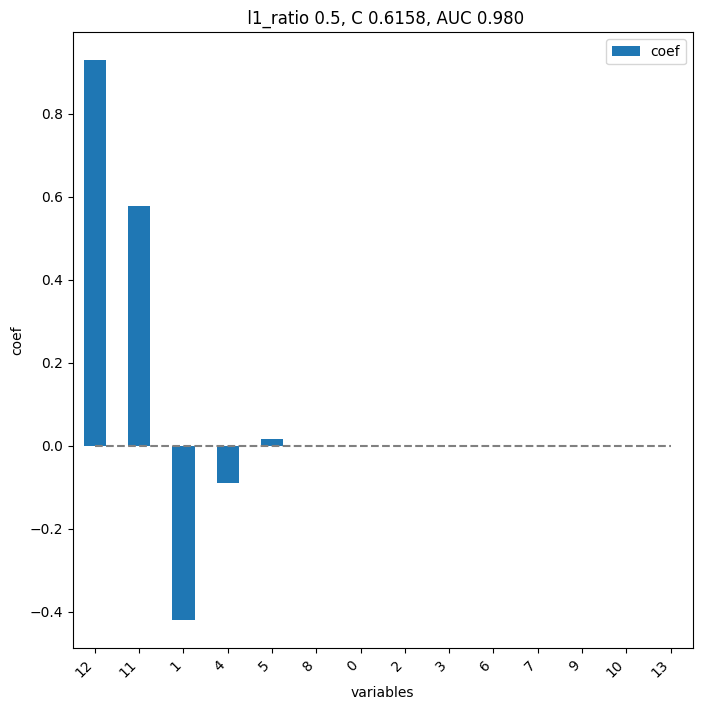

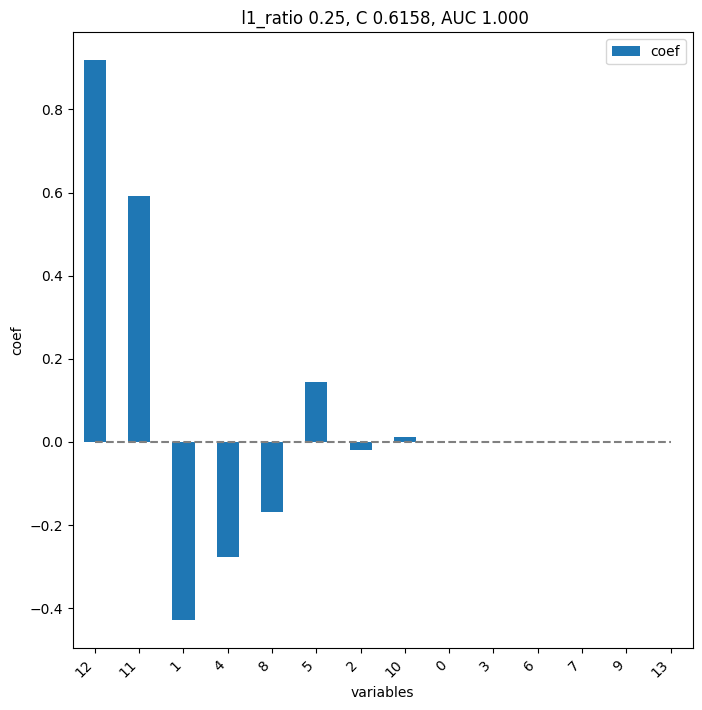

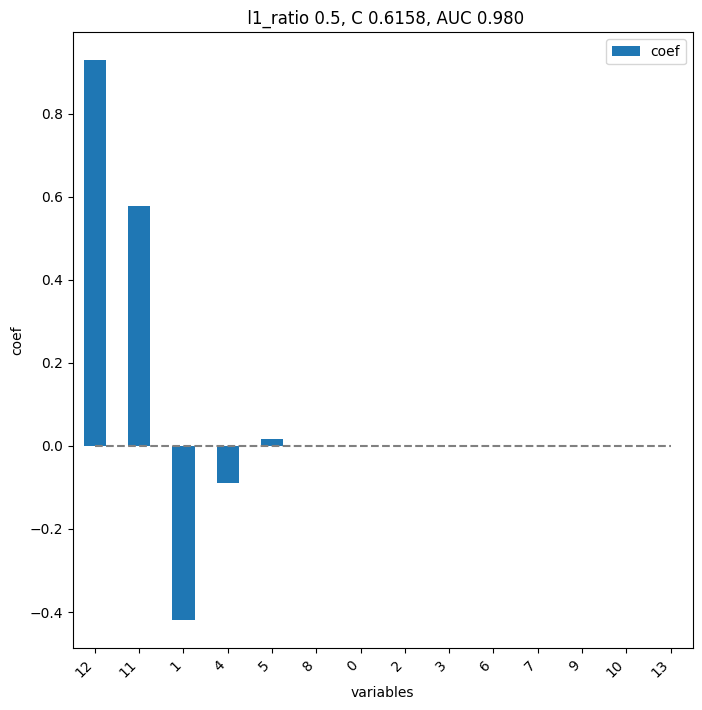

        pval  pval_corr
12  0.004079   0.057110
11  0.097319   0.681235
1   0.208625   0.828768
2   0.382867   0.828768
5   0.382867   0.828768
13  0.534965   0.828768
9   0.620047   0.828768
10  0.620047   0.828768
0   0.710373   0.828768
6   0.710373   0.828768
7   0.710373   0.828768
8   0.710373   0.828768
3   1.000000   1.000000
4   1.000000   1.000000


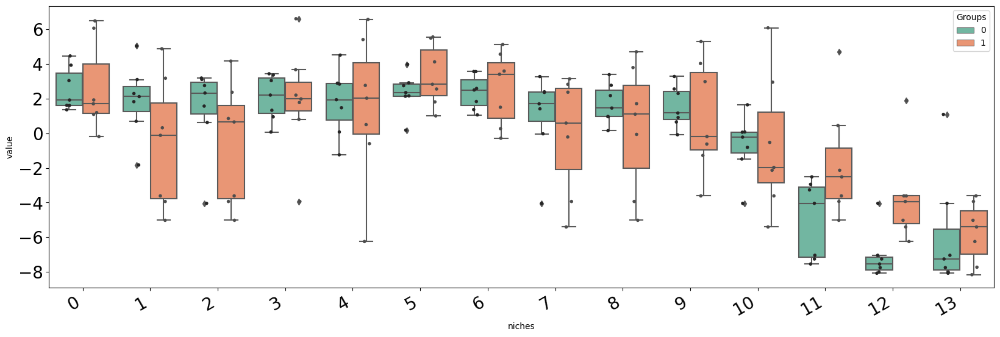

19
['reducer', 'reducer_type-umap', 'n', 'n_neighbors-200', 'metric-manhattan', 'min', 'min_dist-0.0', 'clusterer', 'clusterer_type-leiden', 'dim', 'dim_clust-2', 'k', 'k_cluster-15', 'resolution', 'resolution_parameter-0.1', 'normalize-clr', 'roc', 'roc_auc-1.000', 'col', 'col_zscored']
Loading clusterer object and cluster labels
There are 13 clusters
Loading reducer object and reduced coordinates


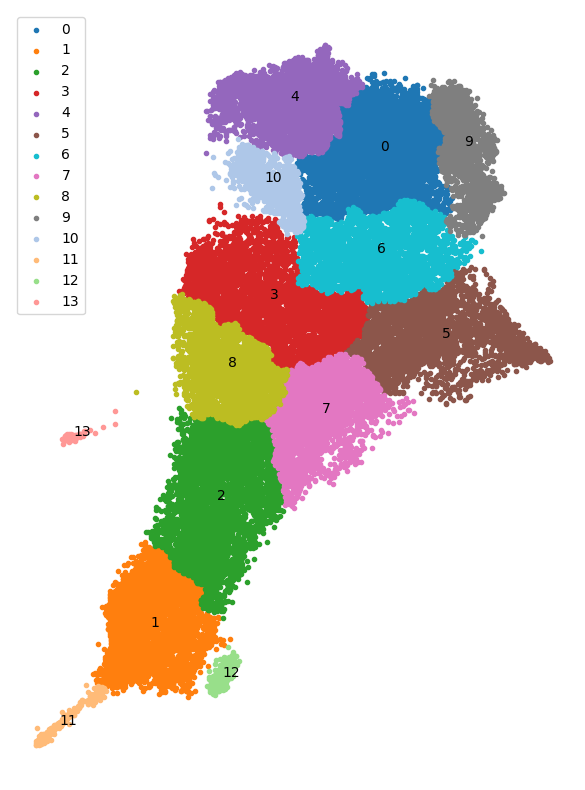

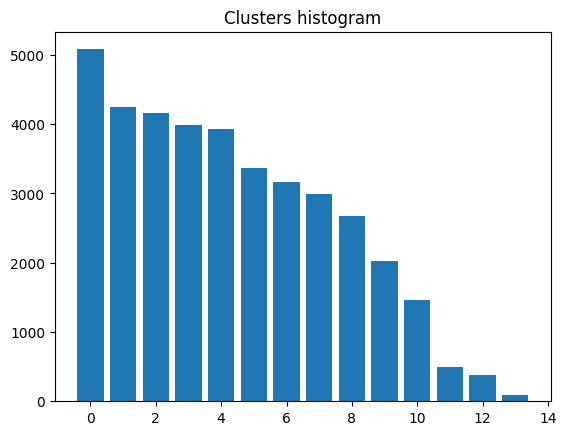

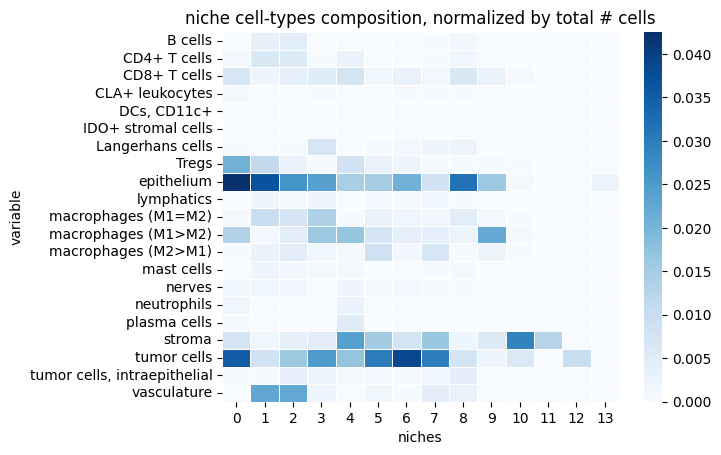

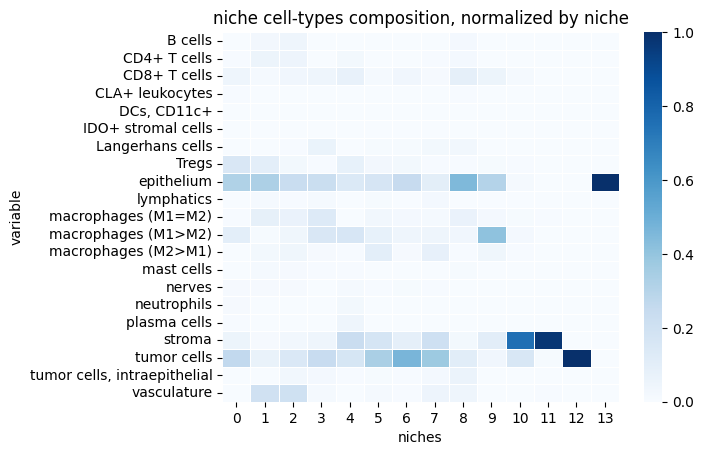

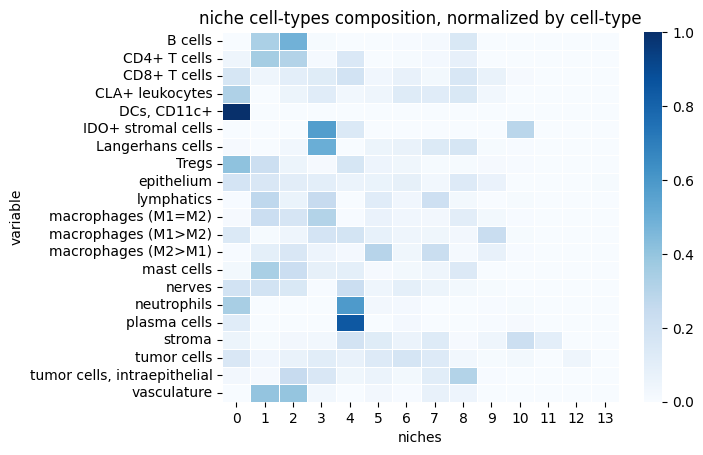

reducer_type-umap_n_neighbors-200_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr


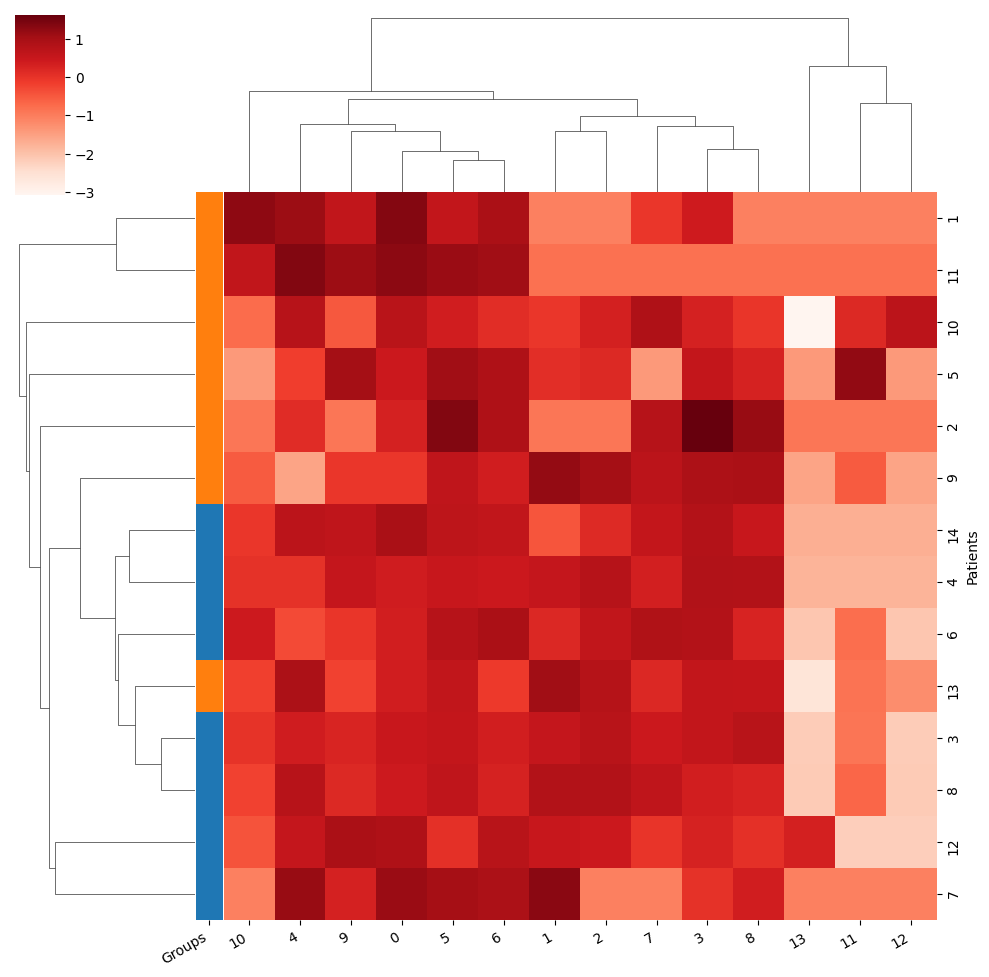

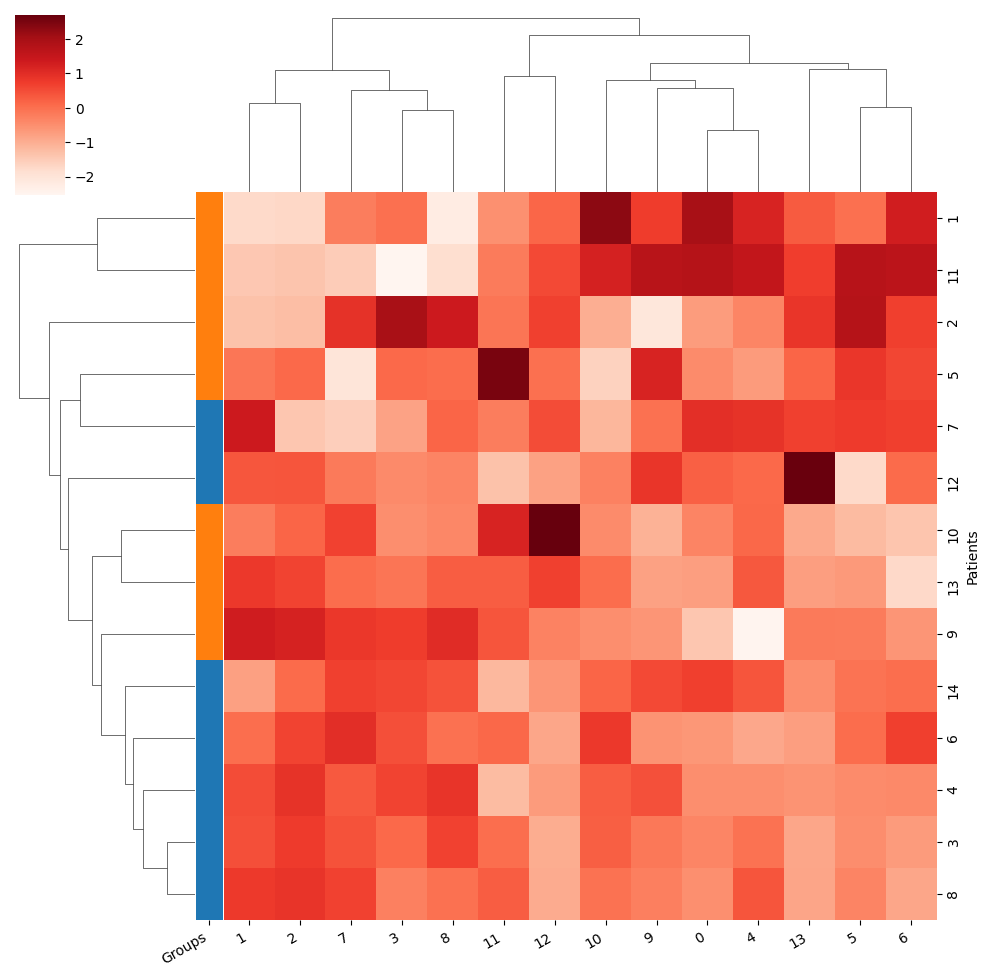

Training took 2.462s


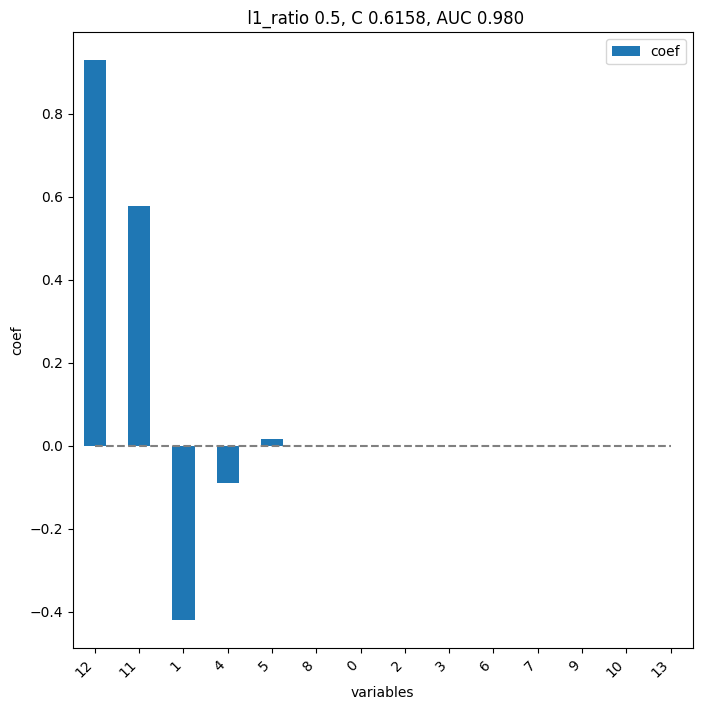

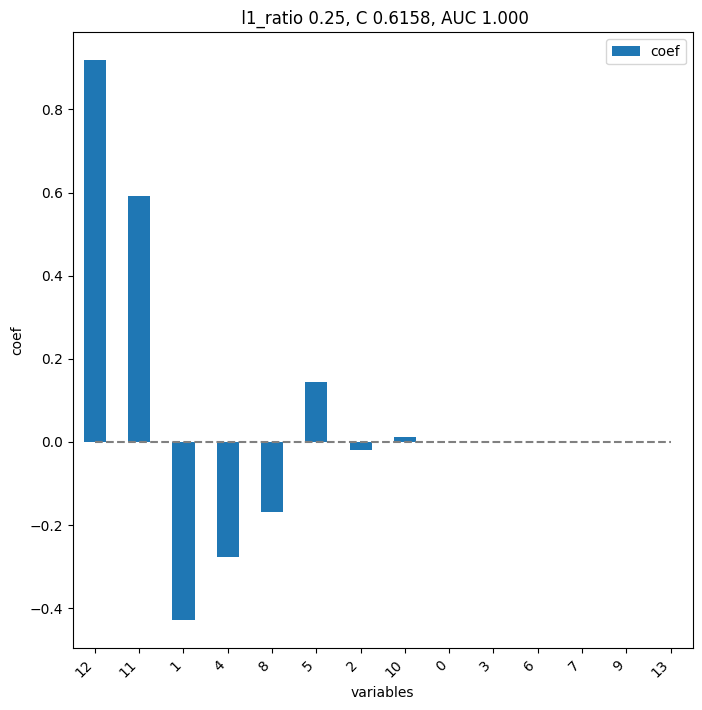

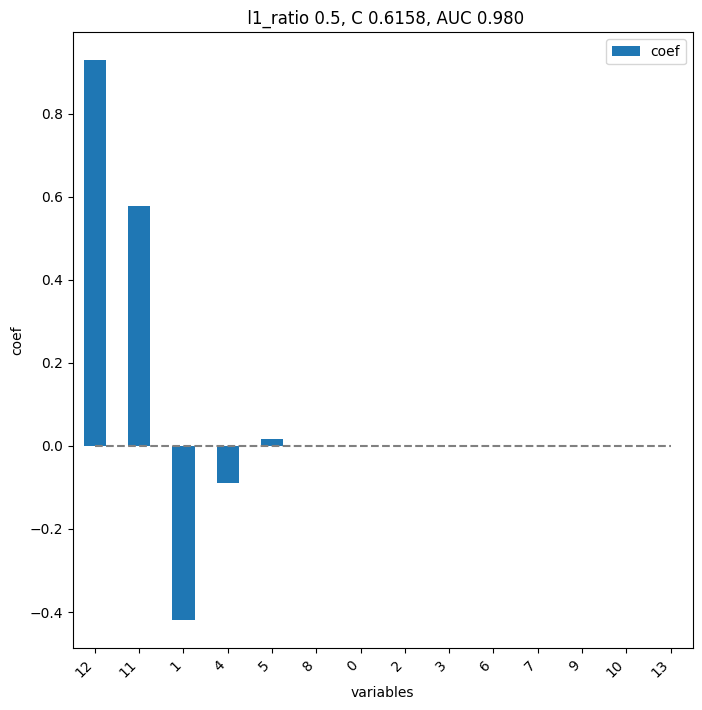

        pval  pval_corr
12  0.004079   0.057110
11  0.097319   0.681235
1   0.208625   0.828768
2   0.382867   0.828768
5   0.382867   0.828768
13  0.534965   0.828768
9   0.620047   0.828768
10  0.620047   0.828768
0   0.710373   0.828768
6   0.710373   0.828768
7   0.710373   0.828768
8   0.710373   0.828768
3   1.000000   1.000000
4   1.000000   1.000000


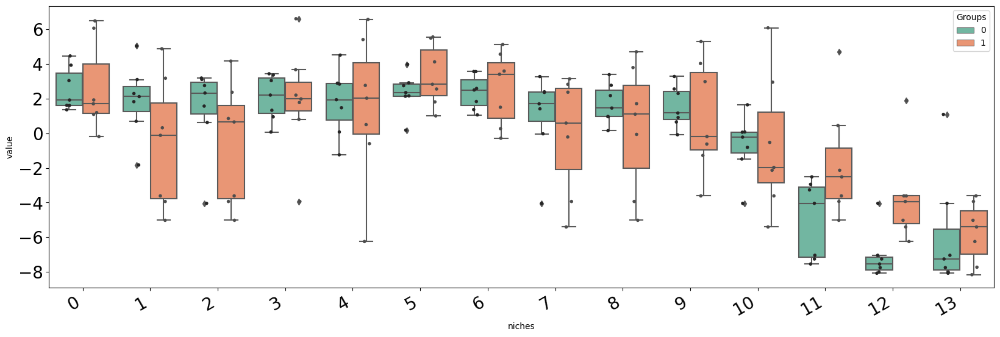

Loading clusterer object and cluster labels
There are 5 clusters
Loading reducer object and reduced coordinates


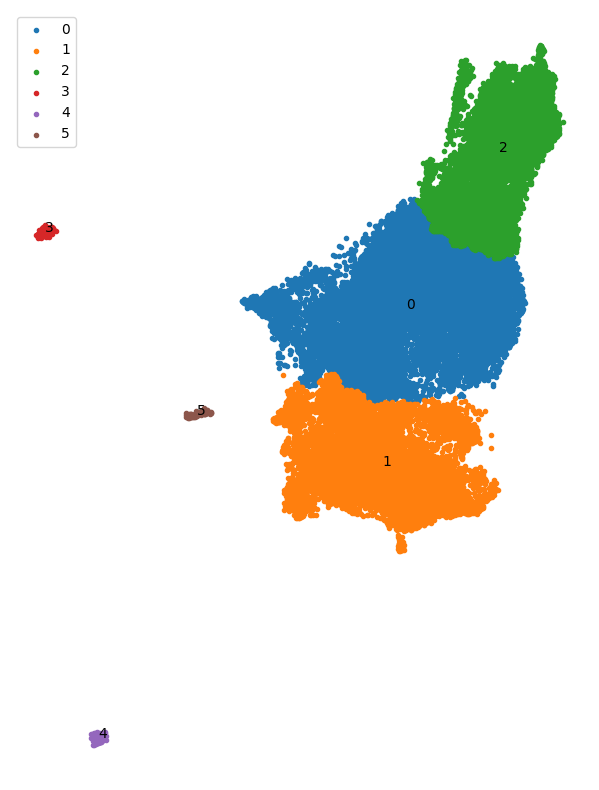

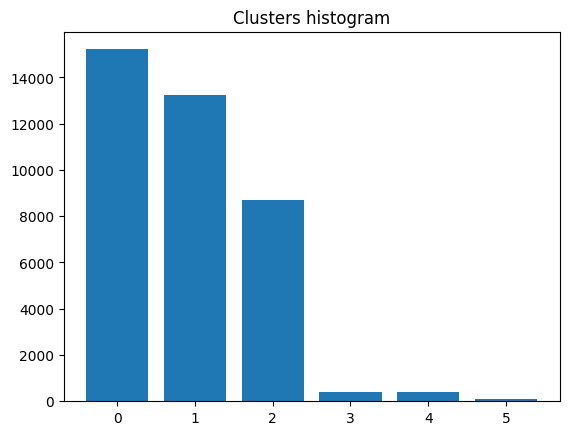

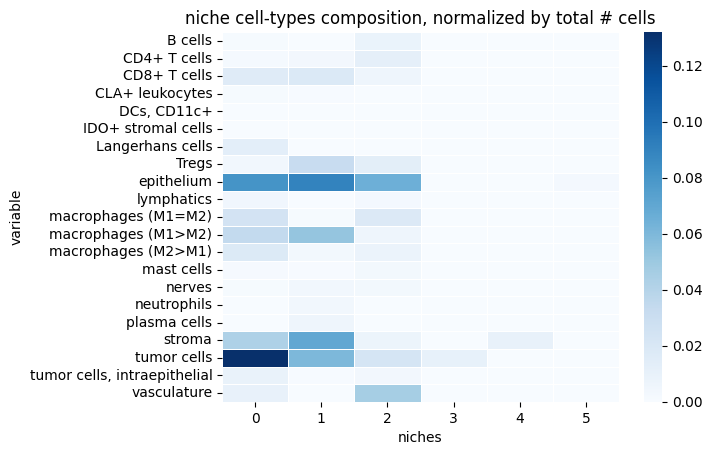

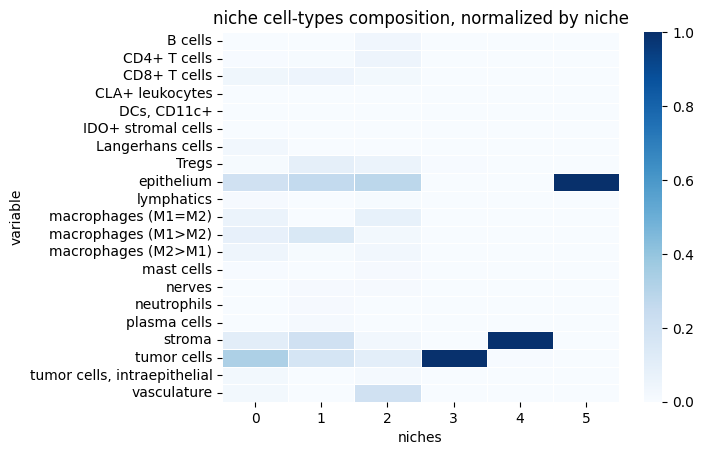

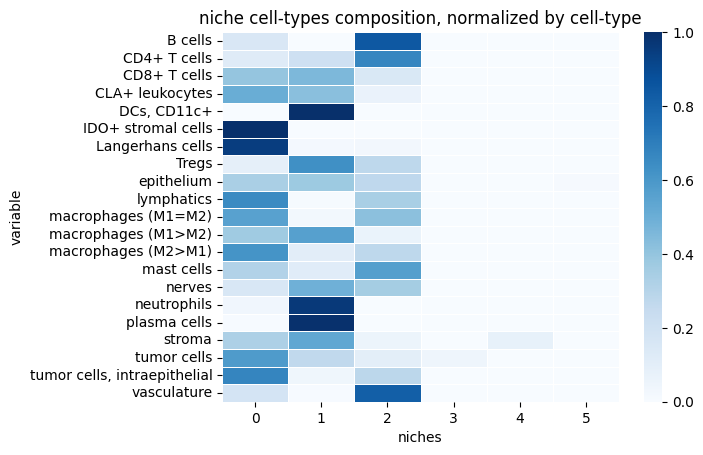

reducer_type-umap_n_neighbors-45_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.03_normalize-clr


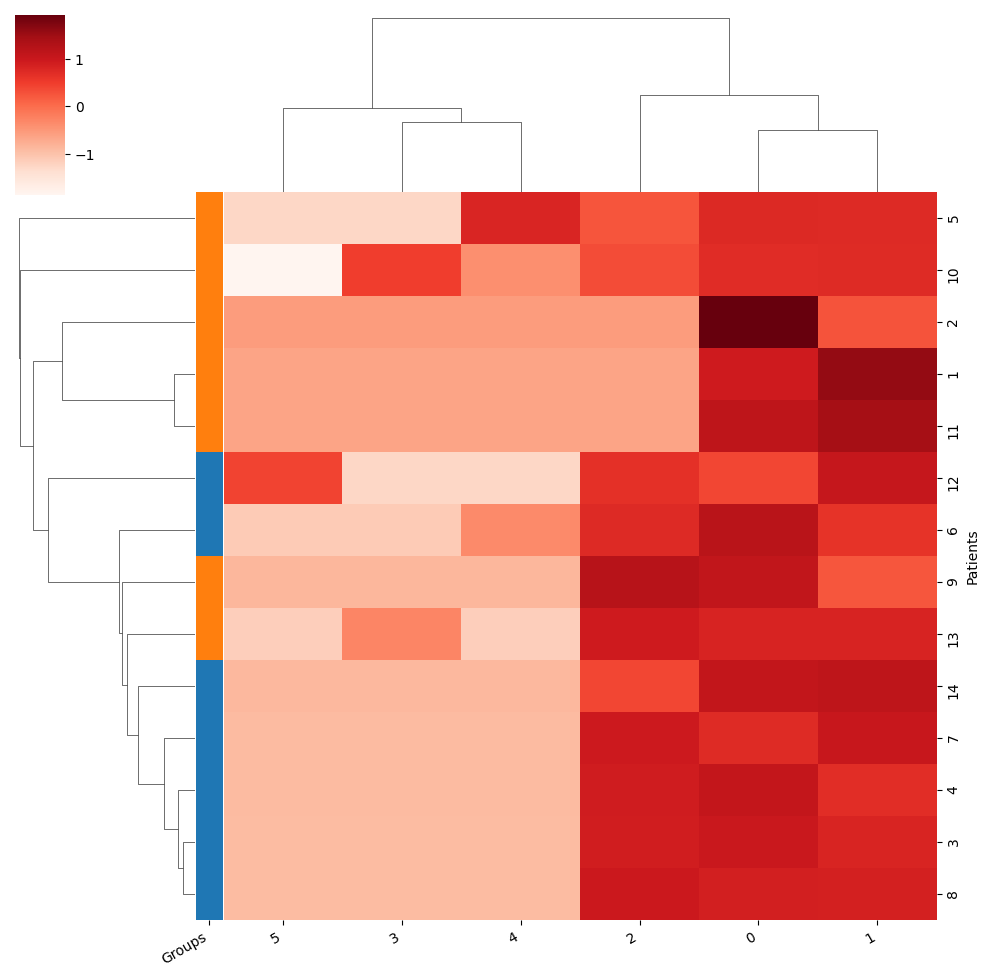

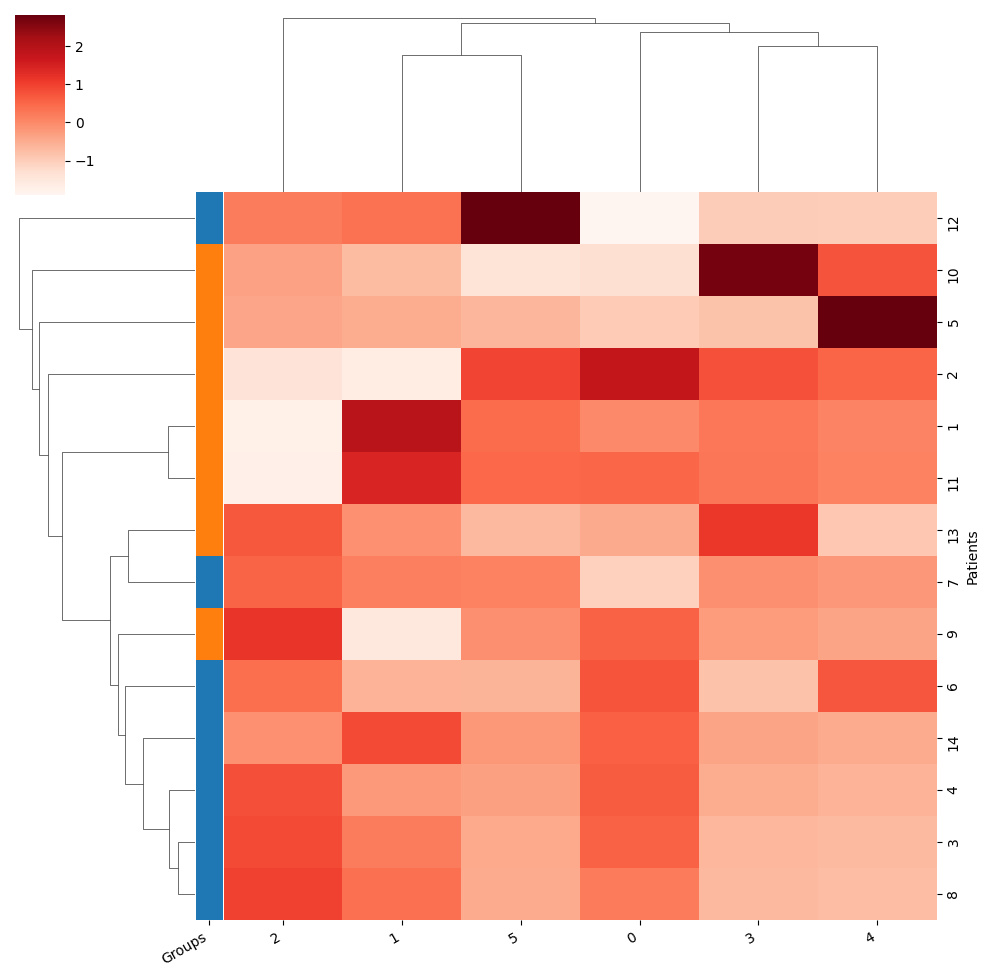

Training took 2.401s


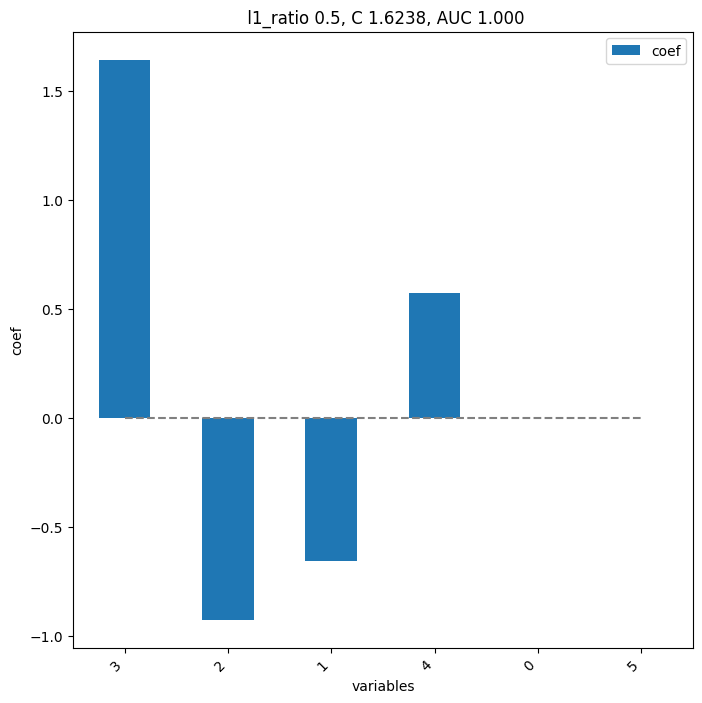

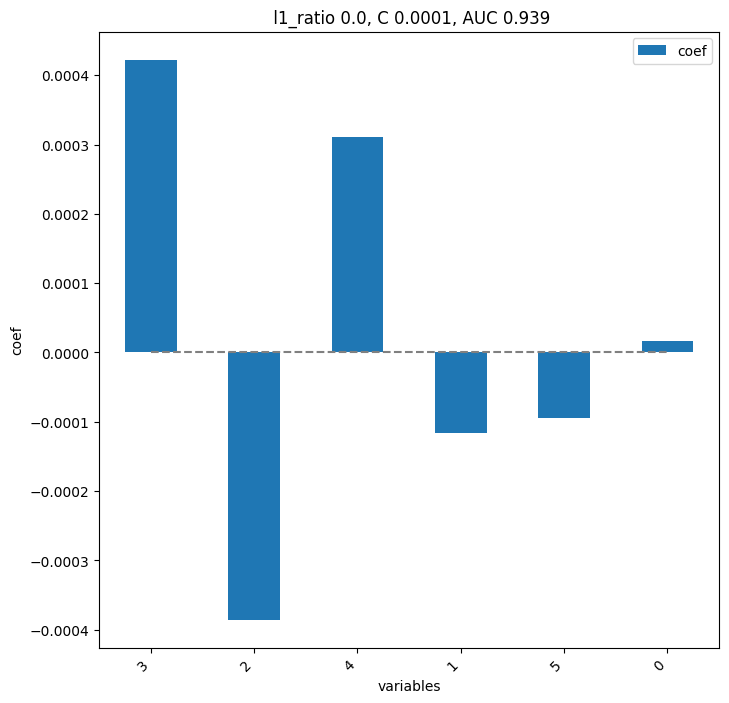

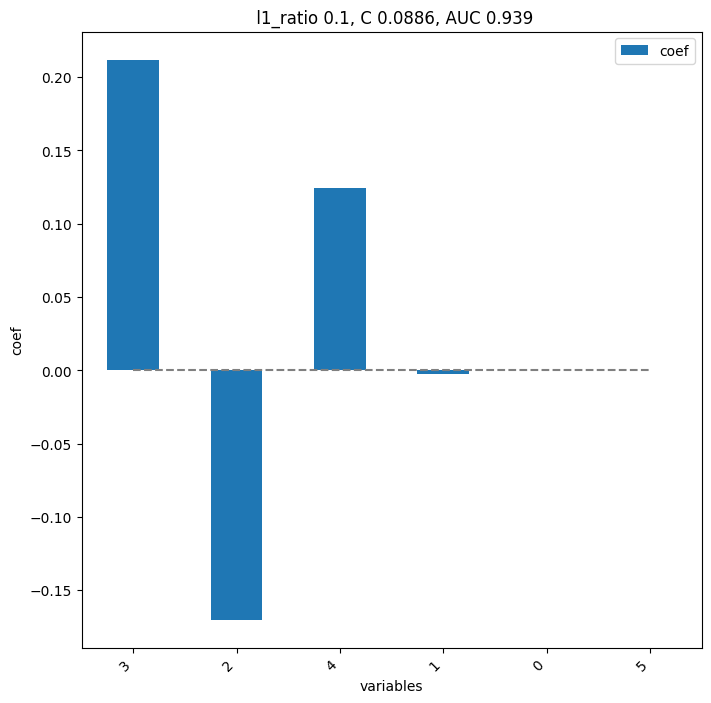

       pval  pval_corr
3  0.026224   0.157343
2  0.097319   0.194639
4  0.097319   0.194639
1  0.382867   0.574301
0  0.620047   0.744056
5  0.901515   0.901515


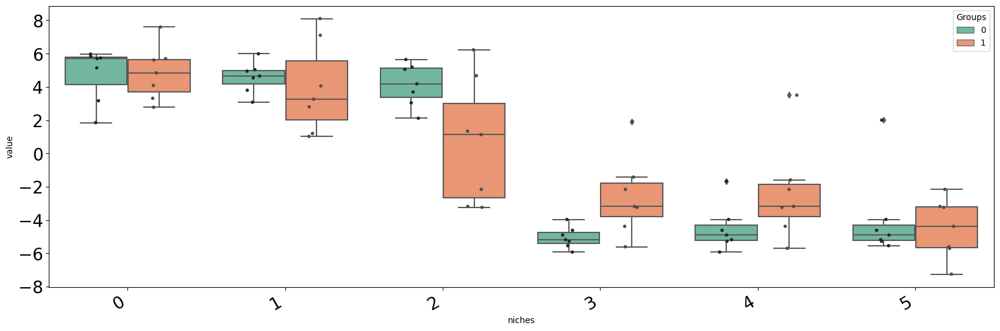

In [62]:
if RUN_LONG:
    for file_name in file_names:
        # extract parameters from file name
        cluster_params, normalize_pred = get_params_from_str(file_name.stem)

        str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
        str_params = str_params + f'_normalize-{normalize_pred}'
        print(str_params)

        cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

        embed_viz, _ = mosna.get_reducer(
            var_aggreg, 
            sof_dir, 
            reducer_type=cluster_params['reducer_type'], 
            n_neighbors=cluster_params['n_neighbors'], 
            metric=cluster_params['metric'],
            )

        mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)
        figname = f"{str_params}_niches_embedding.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        # Niches total counts
        class_id, class_count = np.unique(cluster_labels, return_counts=True)
        plt.bar(class_id, class_count, width=0.8);
        plt.title('Clusters histogram');
        figname = f"{str_params}_niches_total_count.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        # Niches composition
        niches = cluster_labels

        mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
        title = "niche cell-types composition, normalized by total # cells"
        plt.title(title)
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
        title = "niche cell-types composition, normalized by niche"
        plt.title(title)
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
        title = "niche cell-types composition, normalized by cell-type"
        plt.title(title)
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()


        # Make count table of cells in niches per patient with clinical data

        var_aggreg_niches = var_aggreg_samples_info.copy()
        var_aggreg_niches['niche'] = np.array(niches)

        counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize_pred)
        counts.index = counts.index.astype(status.index.dtype)
        exo_vars = counts.columns.tolist()
        df_surv = counts.merge(status, how='inner', on=var_label)

        # Biclustering
        g, d = mosna.plot_heatmap(
            df_surv[exo_vars + [group_col]].reset_index(), 
            obs_labels=var_label, 
            group_var=group_col, 
            groups=[0, 1],
            figsize=(10, 10),
            z_score=False,
            cmap=sns.color_palette("Reds", as_cmap=True),
            return_data=True,
            )
        figname = f"{str_params}_biclustering.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        g, d = mosna.plot_heatmap(
            df_surv[exo_vars + [group_col]].reset_index(), 
            obs_labels=var_label, 
            group_var=group_col, 
            groups=[0, 1],
            figsize=(10, 10),
            z_score=1,
            cmap=sns.color_palette("Reds", as_cmap=True),
            return_data=True,
            )
        figname = f"{str_params}_biclustering_col_zscored.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

        # Logistic regression
        split_train_test = False
        models = mosna.logistic_regression(
            df_surv[exo_vars + [group_col]],
            y_name=group_col,
            col_drop=[var_label],
            cv_train=cv_train, 
            cv_adapt=cv_adapt, 
            cv_max=cv_max,
            plot_coefs=True,
            split_train_test=split_train_test,
            save_plot_figures=True,
            save_dir=dir_save,
            str_prefix=str_params,
            )
        plt.show()

        # p-values
        pvals = mosna.find_DE_markers(
            df_surv[exo_vars + [group_col]], 
            group_ref=1, 
            group_tgt=0, 
            group_var=group_col,
            )
        print(pvals.head(20))

        # Proportion of niches per response group
        fig, ax = mosna.plot_distrib_groups(
            df_surv[exo_vars + [group_col]], 
            group_var=group_col,
            groups=[0, 1], 
            pval_data=None, 
            max_cols=20, 
            multi_ind_to_col=True,
            var_name='niches',
            )
            plt.show()


#### Inspect niches from select NAS parameters

In [43]:
# We select the NAS parameters among:
selected_str_params = [
    'reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr',
    'reducer_type-umap_n_neighbors-100_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr',
    'reducer_type-umap_n_neighbors-45_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr',
]

best_params_dir = Path('../data/processed/CODEX_CTCL/pretreatment_samples_networks_xy_min_size-0_solitary-3/transfo-clr/batch_correction-scanorama_on-patient/select_nas_on-markers_stats-default_order-1')
save_dir = best_params_dir
save_fig = True

reducer_type-umap_n_neighbors-100_metric-manhattan_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr
Loading clusterer object and cluster labels
There are 9 clusters
Loading reducer object and reduced coordinates


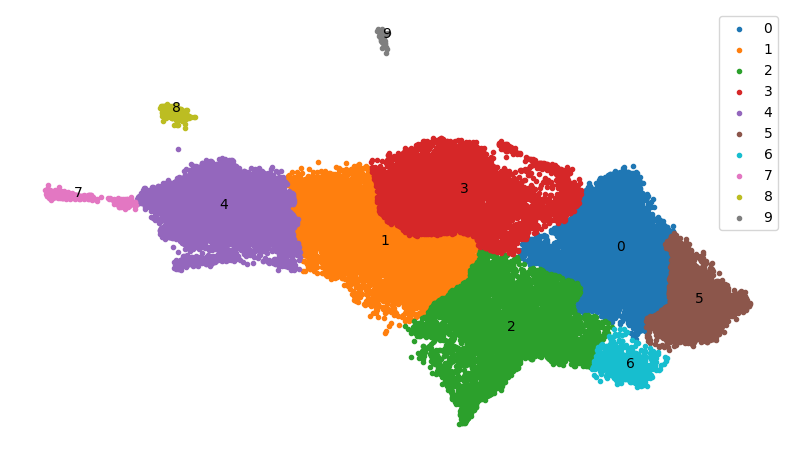

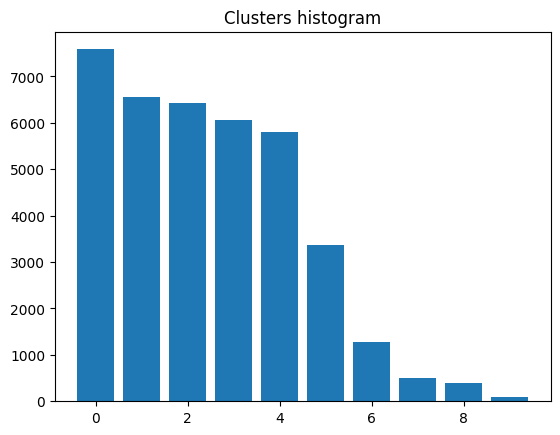

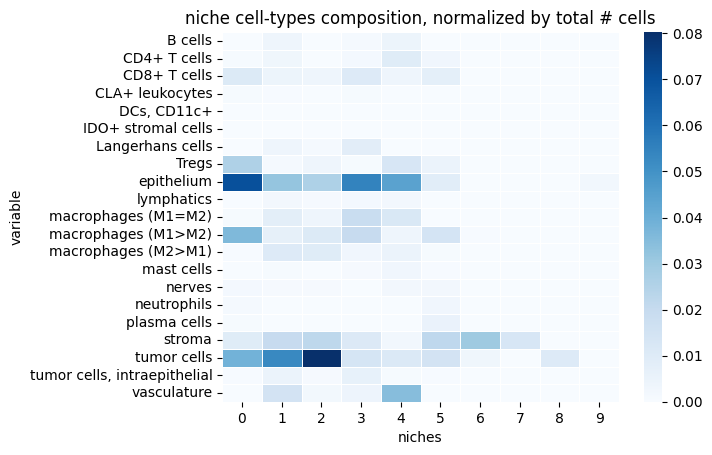

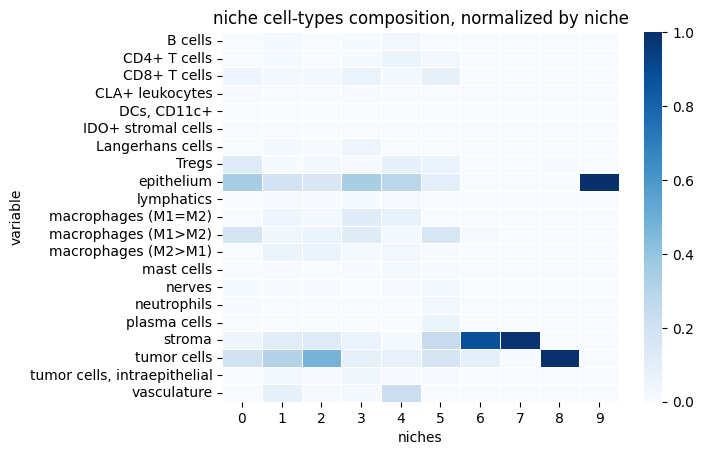

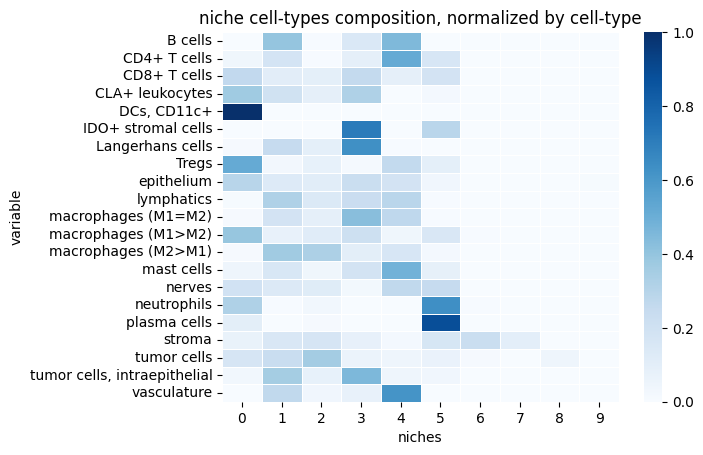

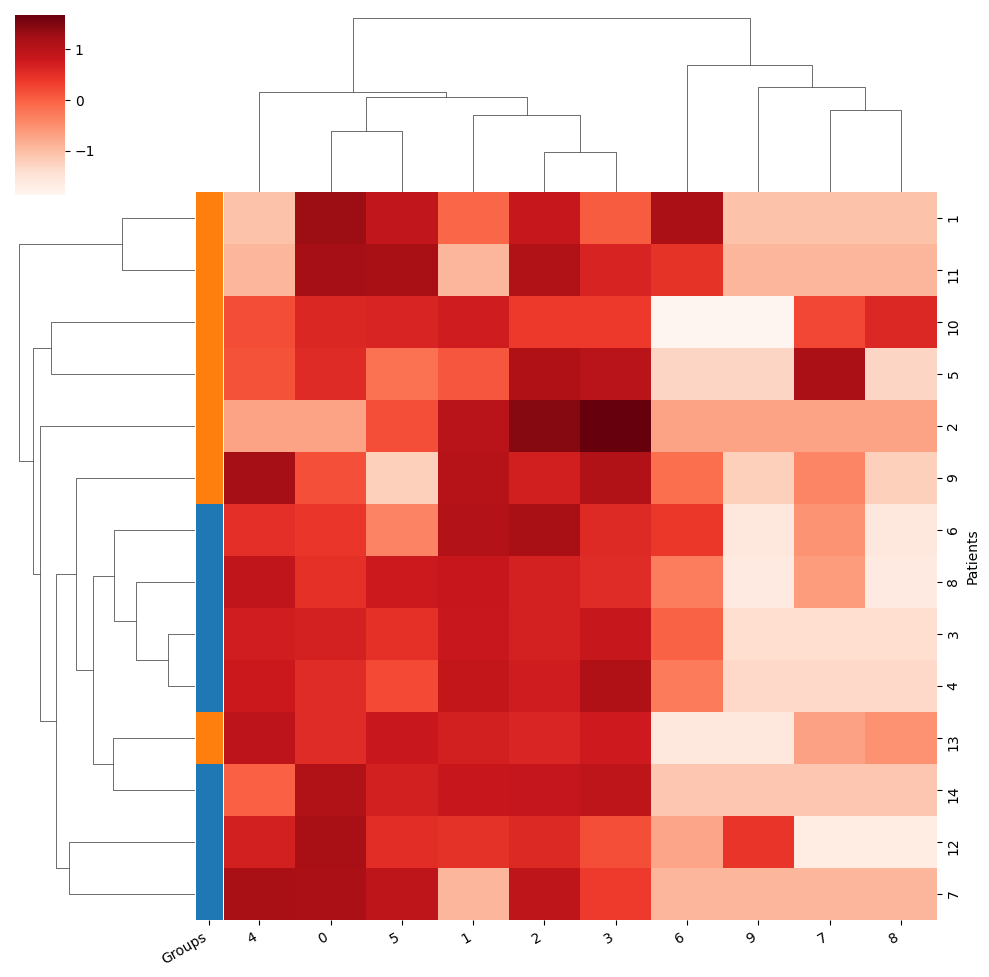

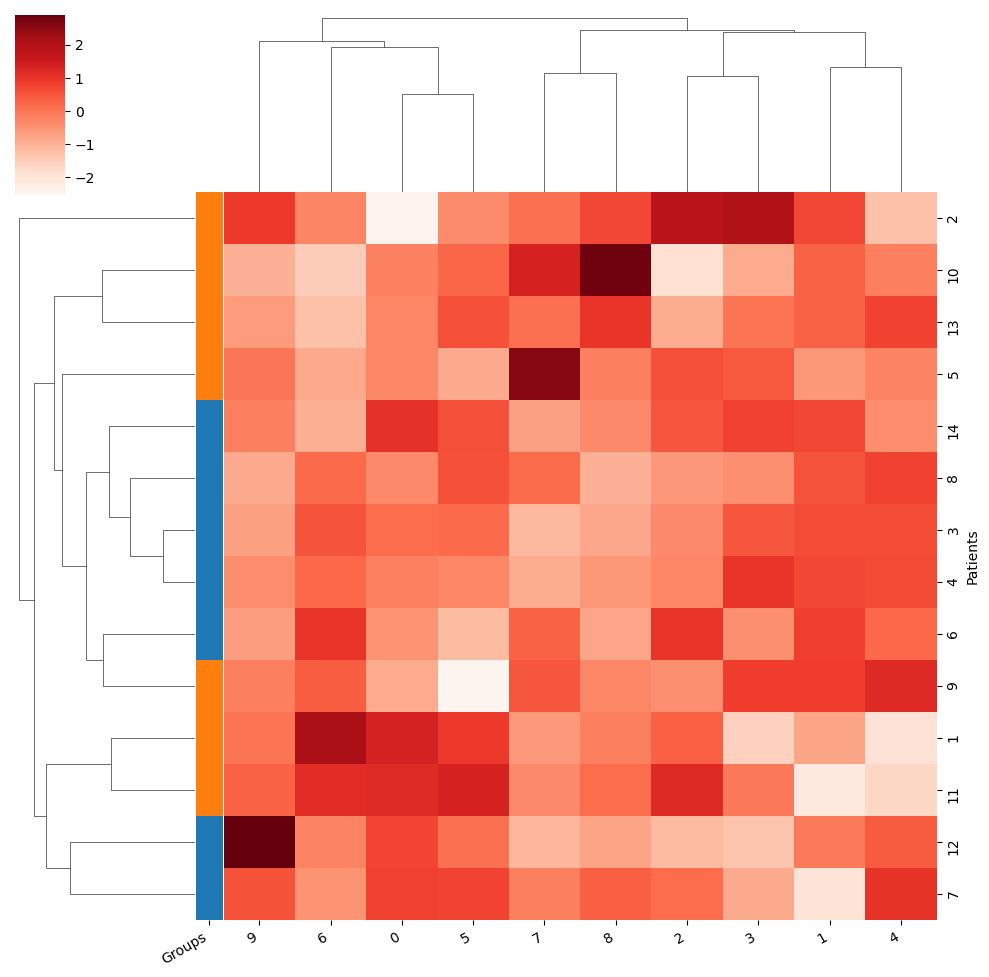

Training took 2.603s


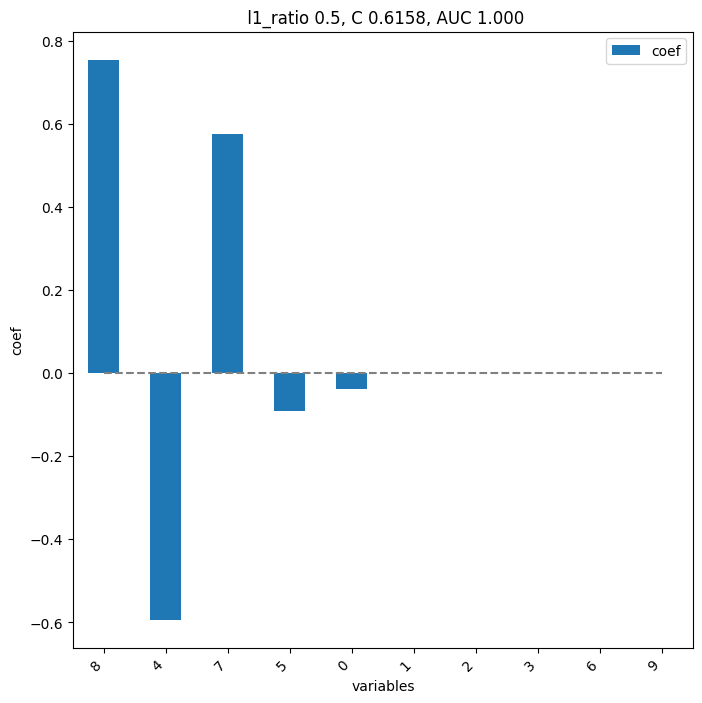

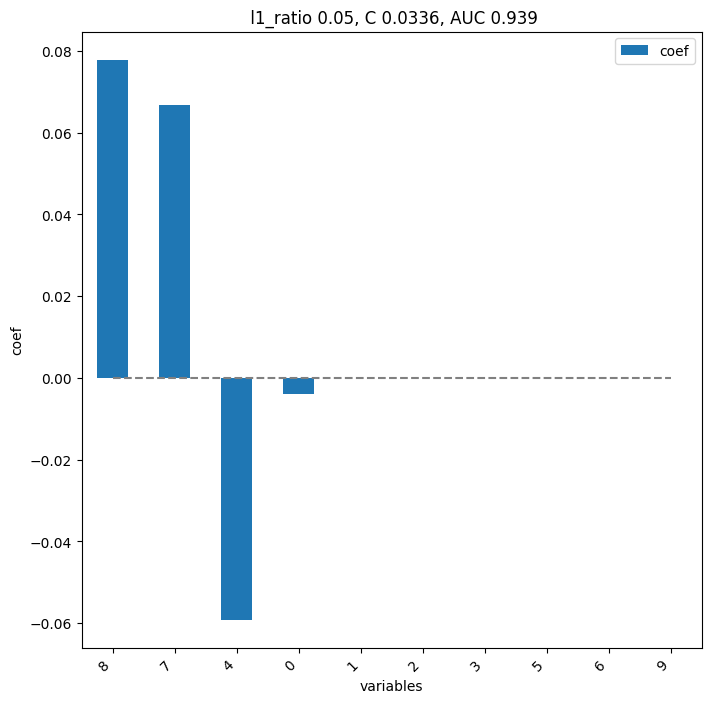

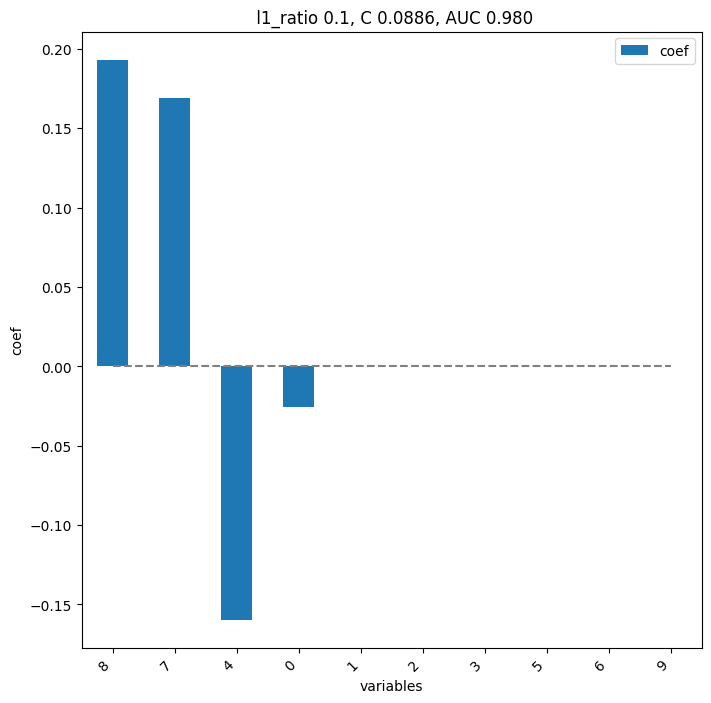

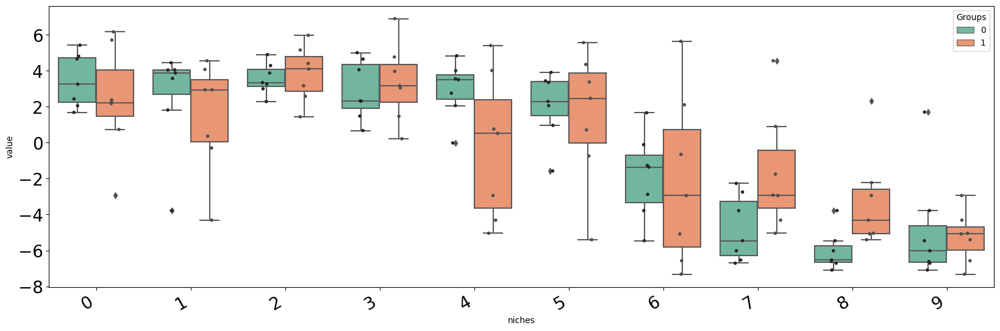

<Figure size 640x480 with 0 Axes>

In [72]:
# Select paramaters
cluster_params, normalize_pred = get_params_from_str(selected_str_params[0])

str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
str_params = str_params + f'_normalize-{normalize_pred}'
print(str_params)

# Load niches data
cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

# Niches embedding
mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)
if save_fig:
    figname = f"{str_params}_niches_embedding.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches total counts
class_id, class_count = np.unique(cluster_labels, return_counts=True)
plt.bar(class_id, class_count, width=0.8);
plt.title('Clusters histogram');
if save_fig:
    figname = f"{str_params}_niches_total_count.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches composition
niches = cluster_labels

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()


# Make count table of cells in niches per patient with clinical data

var_aggreg_niches = var_aggreg_samples_info.copy()
var_aggreg_niches['niche'] = np.array(niches)

counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize_pred)
counts.index = counts.index.astype(status.index.dtype)
exo_vars = counts.columns.tolist()
df_surv = counts.merge(status, how='inner', on=var_label)

# Biclustering
g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=1,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering_col_zscored.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Logistic regression
split_train_test = False
models = mosna.logistic_regression(
    df_surv[exo_vars + [group_col]],
    y_name=group_col,
    col_drop=[var_label],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    plot_coefs=True,
    split_train_test=split_train_test,
    save_plot_figures=save_fig,
    dir_save=save_dir,
    str_prefix=str_params,
    )
plt.show()

# Proportion of niches per response group
fig, ax = mosna.plot_distrib_groups(
    df_surv[exo_vars + [group_col]], 
    group_var=group_col,
    groups=[0, 1], 
    pval_data=None, 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='niches',
    )
plt.show()
if save_fig:
    figname = f"{str_params}_niches_boxplot.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    
# p-values
pvals = mosna.find_DE_markers(
    df_surv[exo_vars + [group_col]], 
    group_ref=1, 
    group_tgt=0, 
    group_var=group_col,
    )

In [73]:
pvals.head(20)

,pval,pval_corr
8,0.006993,0.069930
7,0.072844,0.364219
4,0.259324,0.864413
1,0.534965,1.000000
0,0.620047,1.000000
9,0.620047,1.000000
2,0.710373,1.000000
6,0.804779,1.000000
3,0.901515,1.000000
5,1.000000,1.000000


In [74]:
import seaborn as sns
df_show = df_surv[exo_vars]
if df_show.values.min() >= 0:
    cm = sns.light_palette("green", as_cmap=True)
else:
    cm = sns.diverging_palette(220, 20, as_cmap=True)
    # cm = sns.color_palette("vlag", as_cmap=True)
s = df_show.style.background_gradient(cmap=cm)
s

,0,1,2,3,4,5,6,7,8,9
Patients,,,,,,,,,,
1,6.169745,-0.295362,4.099087,0.215463,-5.045173,4.352228,5.639532,-5.045173,-5.045173,-5.045173
10,2.372413,2.940792,1.439396,1.463206,0.758225,2.465135,-7.323790,0.902119,2.306294,-7.323790
11,5.709252,-4.316971,5.154310,3.047800,-4.316971,5.566676,2.106816,-4.316971,-4.316971,-4.316971
12,4.657550,1.817940,2.287943,0.672808,2.752249,2.059102,-2.882541,-6.533739,-6.533739,1.702427
13,2.218925,2.943729,2.578519,3.166306,4.016515,3.376210,-6.573937,-2.922739,-2.229592,-6.573937
14,5.424759,4.057050,4.288657,4.652050,-0.017658,3.437606,-5.460616,-5.460616,-5.460616,-5.460616
2,-2.943639,4.074855,5.975417,6.904003,-2.943639,0.707559,-2.943639,-2.943639,-2.943639,-2.943639
3,3.254371,3.875220,3.259791,4.057217,3.501854,2.297409,-0.114738,-6.710375,-6.710375,-6.710375
4,2.433867,4.044943,3.340273,5.005728,3.548740,0.962050,-1.271542,-6.021353,-6.021353,-6.021353


Niches 8, 7 and 4 have high importance in predicting response to immunotherapy in all models. They correspond respectively to pure niches of tumor cells, stroma cells, and mixed niche of mostly epithelium, vasculature, tregs, macrophages (M1=M2), termed "EVTM".  
The tumor and stroma niches are associated with response, whereas the EVTM niche is associated with non-response.

Loading reducer object and reduced coordinates


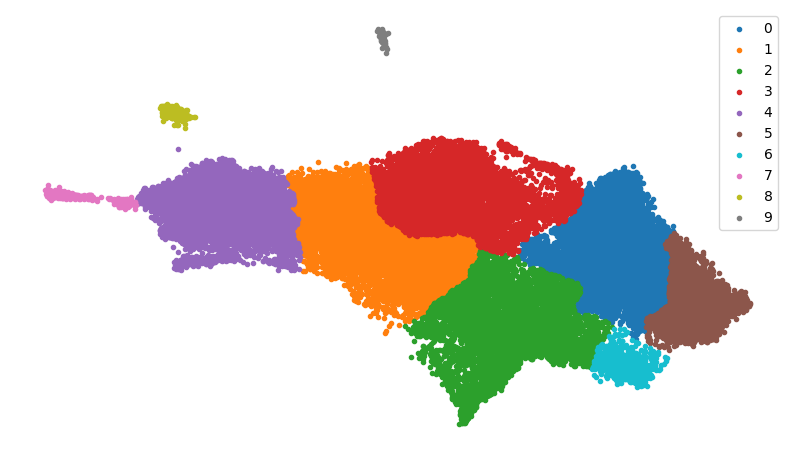

In [78]:
embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels, 
    sof_dir, 
    cluster_params=cluster_params, 
    return_cmap=True,
    extra_str='_no_cluster_id', 
    show_id=False,
    )

In [ ]:
if RUN_LONG:
    save_dir = cluster_dir / 'spatial_networks_niches'
    save_dir.mkdir(parents=True, exist_ok=True)

    # colormap for cell-types
    n_cell_types = obj[pheno_col].unique().size
    # palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
    # palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]
    niche_colors = np.array([niches_color_mapper[x] for x in cluster_labels])
    plots_marker = '.'

    id_level_1 = 'patient'
    id_level_2 = 'sample'
    extension = 'parquet'
    read_fct = pd.read_parquet

    # build index of patients and samples files
    data_index = []
    len_ext = len(extension) + 1
    len_l1 = len(id_level_1) + 1
    len_l2 = len(id_level_2) + 1
    files = nodes_dir.glob(f'nodes_*.{extension}')
    for file in files:
        # parse patient and sample description
        file_name = file.name[6:-len_ext]
        patient_info, sample_info = file_name.split('_')
        patient_id = patient_info[len_l1:]
        sample_id = sample_info[len_l2:]
        # add info to data index
        data_index.append((patient_id, sample_id))

    for data_info in data_index:
        # load nodes and edges of a specific sample
        if len(data_info) == 1:
            str_group = f'{id_level_1}-{data_info[0]}'
        elif len(data_info) == 2:
            str_group = f'{id_level_1}-{data_info[0]}_{id_level_2}-{data_info[1]}'
        nodes = read_fct(nodes_dir / f'nodes_{str_group}.{extension}')
        edges = read_fct(edges_dir / f'edges_{str_group}.{extension}')
        coords = nodes[pos_cols].values
        pairs = edges.values
        # bolean selector among aggregated data
        sample_id = data_info[1]
        select = (var_aggreg_samples_info['sample'] == sample_id).values

        # Big summary plot
        fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
        i = 0
        ty.plot_network(coords, 
                        pairs,
                        labels=nodes[pheno_col], 
                        color_mapper=celltypes_color_mapper, 
                        marker=plots_marker, 
                        size_nodes=size_points*10, 
                        ax=ax[0])
        ax[i].set_title('Spatial map of phenotypes', fontsize=14);

        i += 1
        ax[i].scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*10)
        ax[i].set_title('Spatial map of detected areas', fontsize=14);
        ax[i].set_aspect('equal')

        i += 1
        ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=niche_colors[select], s=size_points);
        ax[i].set_title("Clustering on NAS", fontsize=14);
        ax[i].set_aspect('equal')

        i += 1
        ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=niche_colors, s=size_points);
        ax[i].set_title("Clustering on NAS of all samples", fontsize=14);
        ax[i].set_aspect('equal')
        
        # make plot limits equal
        ax[i-1].set_xlim(ax[i].get_xlim())
        ax[i-1].set_ylim(ax[i].get_ylim())

        suptitle = f"Spatial omics data and detected areas - sample {sample_id}";
        fig.suptitle(suptitle, fontsize=18)

        fig.savefig(save_dir / f'{suptitle}.jpg', bbox_inches='tight', facecolor='white', dpi=600)
        plt.show()


        fig, ax = plt.subplots(figsize=(10, 10))
        ax.scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*10)
        ax.set_title('Spatial map of detected areas', fontsize=14);
        ax.set_aspect('equal')
        fig.savefig(save_dir / f'spatial_niches_sample-{sample_id}_bignodes.jpg', bbox_inches='tight', facecolor='white', dpi=600)
        plt.show()

reducer_type-umap_n_neighbors-100_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-50_resolution_parameter-0.1_normalize-clr
Loading clusterer object and cluster labels


There are 8 clusters
Loading reducer object and reduced coordinates


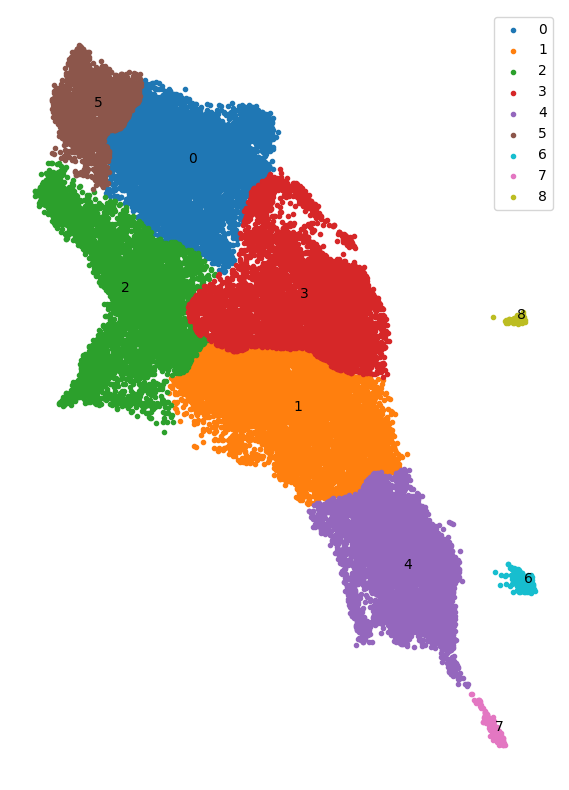

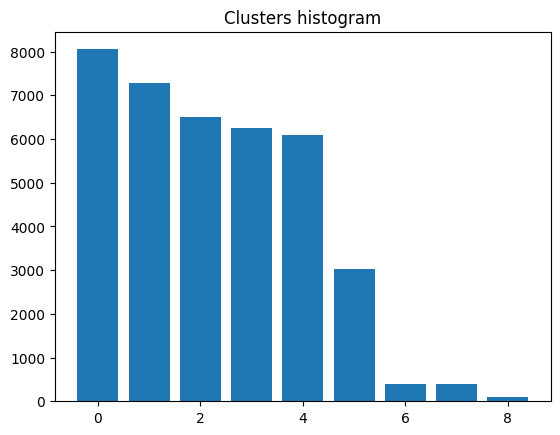

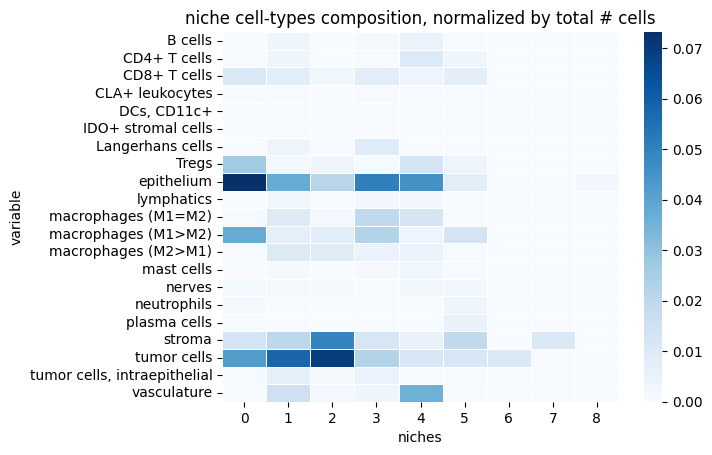

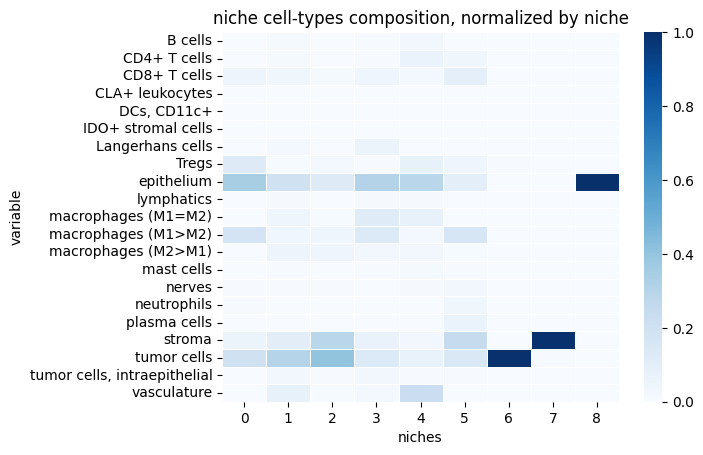

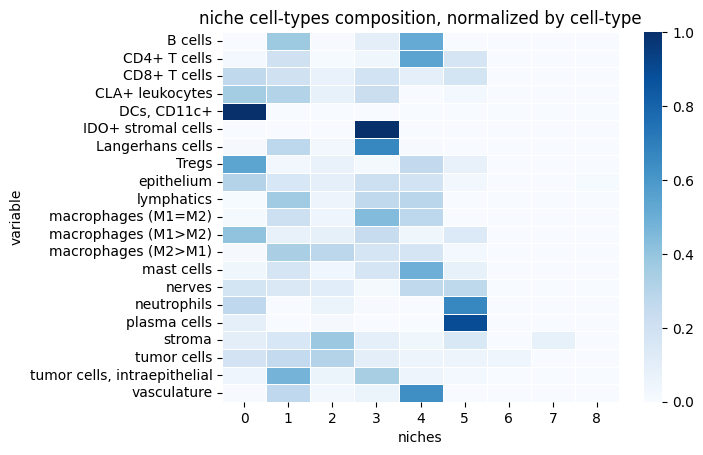

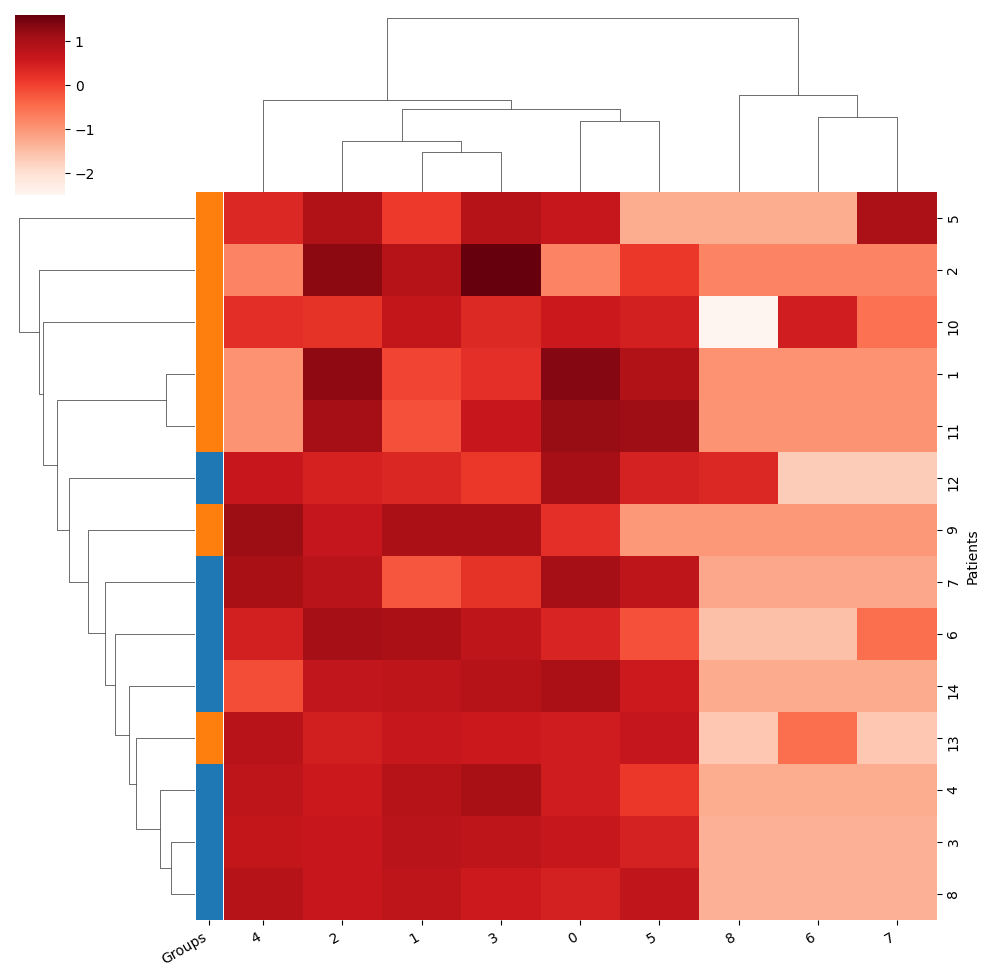

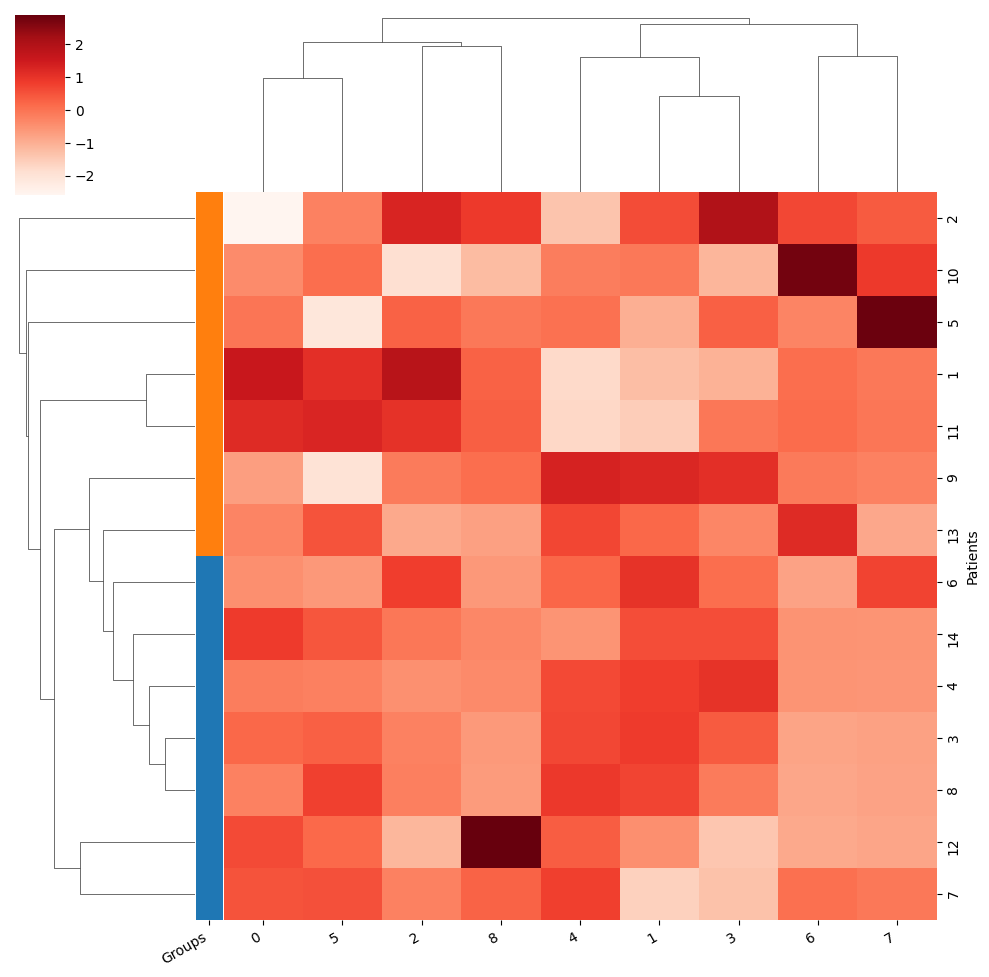

Training took 2.506s


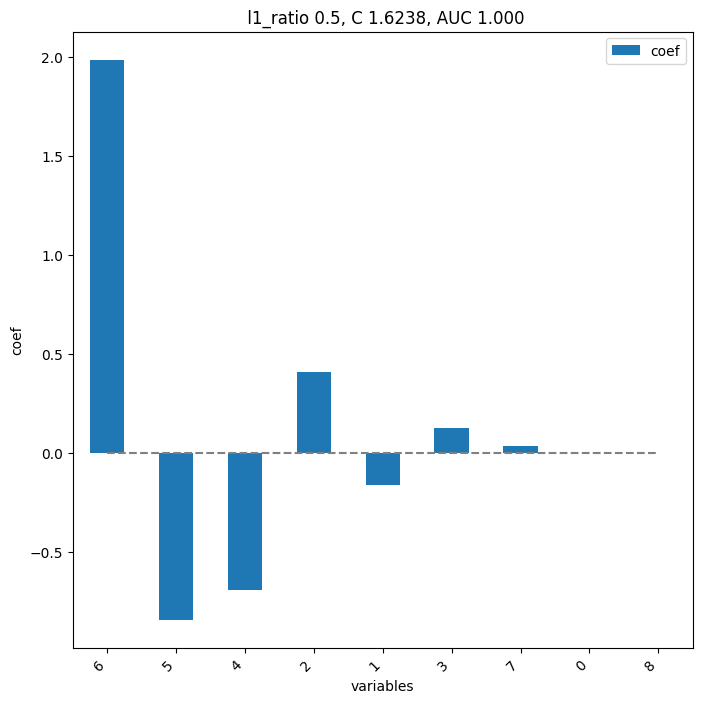

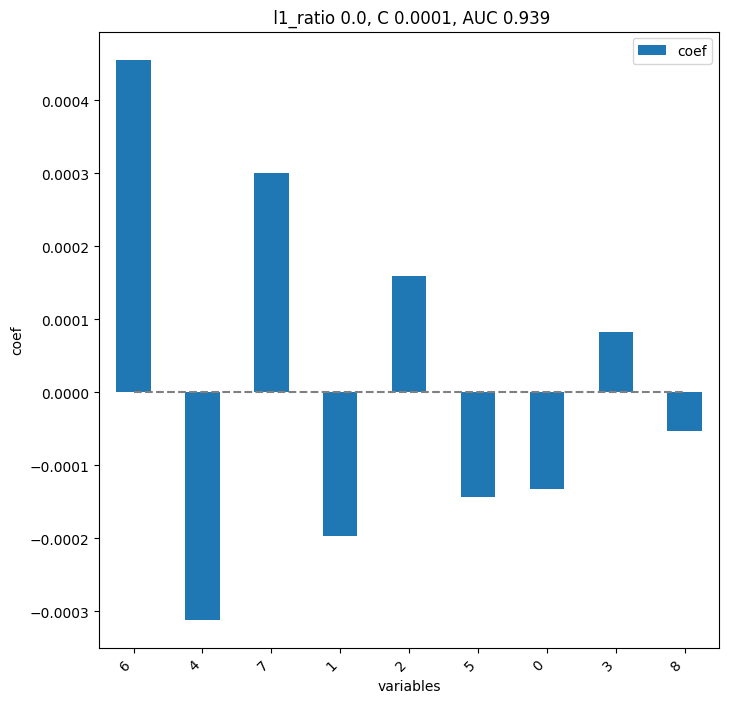

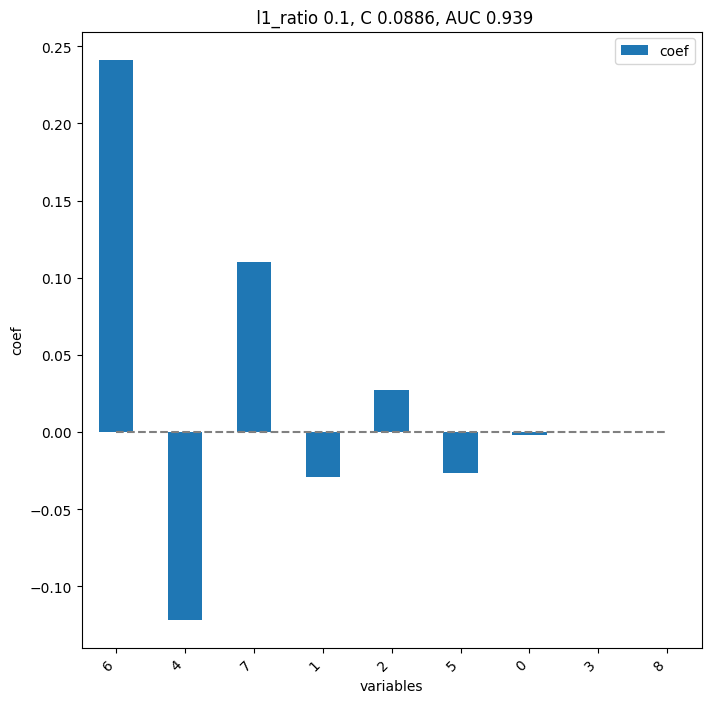

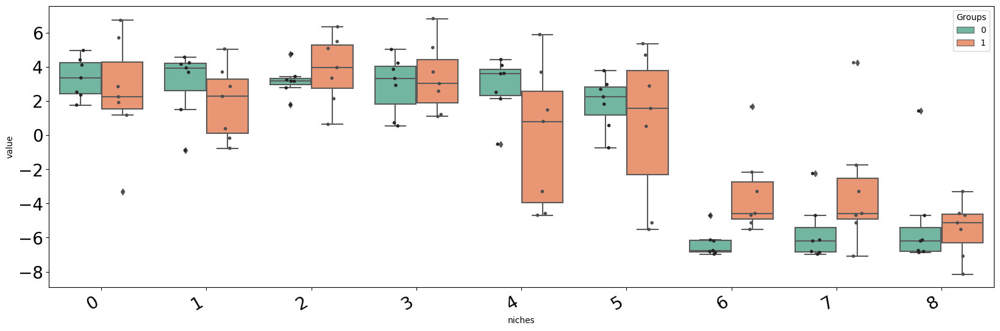

In [119]:
# Select paramaters
cluster_params, normalize_pred = get_params_from_str(selected_str_params[1])

str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
str_params = str_params + f'_normalize-{normalize_pred}'
print(str_params)

# Load niches data
cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

# Niches embedding
mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)
if save_fig:
    figname = f"{str_params}_niches_embedding.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches total counts
class_id, class_count = np.unique(cluster_labels, return_counts=True)
plt.bar(class_id, class_count, width=0.8);
plt.title('Clusters histogram');
if save_fig:
    figname = f"{str_params}_niches_total_count.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches composition
niches = cluster_labels

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()


# Make count table of cells in niches per patient with clinical data

var_aggreg_niches = var_aggreg_samples_info.copy()
var_aggreg_niches['niche'] = np.array(niches)

counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize_pred)
counts.index = counts.index.astype(status.index.dtype)
exo_vars = counts.columns.tolist()
df_surv = counts.merge(status, how='inner', on=var_label)

# Biclustering
g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=1,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering_col_zscored.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Logistic regression
split_train_test = False
models = mosna.logistic_regression(
    df_surv[exo_vars + [group_col]],
    y_name=group_col,
    col_drop=[var_label],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    plot_coefs=True,
    split_train_test=split_train_test,
    save_plot_figures=save_fig,
    dir_save=save_dir,
    str_prefix=str_params,
    )
plt.show()

# Proportion of niches per response group
fig, ax = mosna.plot_distrib_groups(
    df_surv[exo_vars + [group_col]], 
    group_var=group_col,
    groups=[0, 1], 
    pval_data=None, 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='niches',
    )
plt.show()
if save_fig:
    figname = f"{str_params}_niches_boxplot.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    
# p-values
pvals = mosna.find_DE_markers(
    df_surv[exo_vars + [group_col]], 
    group_ref=1, 
    group_tgt=0, 
    group_var=group_col,
    )

In [120]:
pvals.head(20)

,pval,pval_corr
6,0.002331,0.020979
7,0.128205,0.576923
4,0.208625,0.625874
2,0.317599,0.689161
1,0.382867,0.689161
0,0.534965,0.802448
8,0.710373,0.804779
3,0.804779,0.804779
5,0.804779,0.804779


In [121]:
import seaborn as sns
df_show = df_surv[exo_vars]
if df_show.values.min() >= 0:
    cm = sns.light_palette("green", as_cmap=True)
else:
    cm = sns.diverging_palette(220, 20, as_cmap=True)
    # cm = sns.color_palette("vlag", as_cmap=True)
s = df_show.style.background_gradient(cmap=cm)
s

,0,1,2,3,4,5,6,7,8
Patients,,,,,,,,,
1,6.721738,-0.181507,6.343523,1.204787,-4.693642,4.686028,-4.693642,-4.693642,-4.693642
10,1.906377,2.264230,0.629756,1.090029,0.797893,1.560033,1.657865,-1.761122,-8.145059
11,5.694823,-0.771321,5.069320,3.012868,-4.590310,5.355548,-4.590310,-4.590310,-4.590310
12,4.406006,1.492924,1.775786,0.537412,2.504525,1.811377,-6.970455,-6.970455,1.412881
13,2.241901,2.850965,2.131150,2.572017,3.683111,2.874802,-2.172915,-7.090516,-7.090516
14,4.958061,3.677402,3.431730,4.214127,-0.532253,2.679934,-6.143001,-6.143001,-6.143001
2,-3.302367,3.694675,5.479466,6.821070,-3.302367,0.516621,-3.302367,-3.302367,-3.302367
3,3.352307,4.231985,3.160517,3.852606,3.612117,2.243168,-6.817567,-6.817567,-6.817567
4,2.516263,4.152212,2.765917,5.014758,3.589685,0.562862,-6.200565,-6.200565,-6.200565


reducer_type-umap_n_neighbors-45_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr
Loading clusterer object and cluster labels
There are 15 clusters
Loading reducer object and reduced coordinates


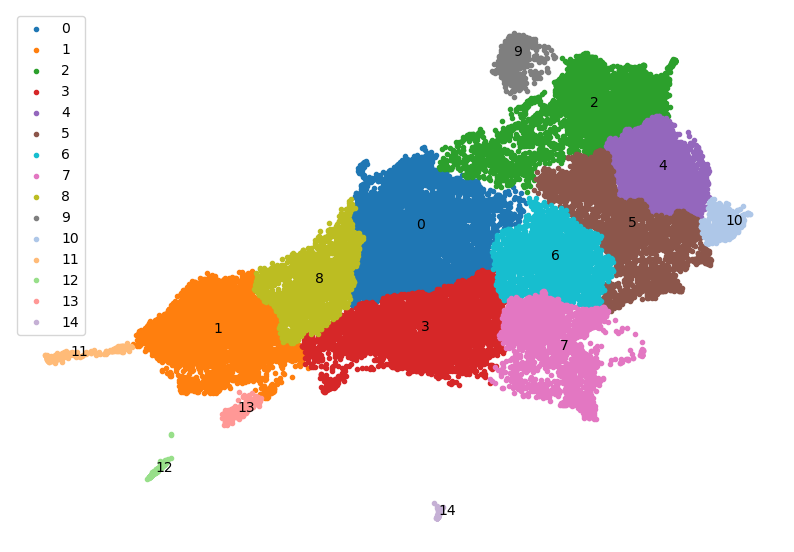

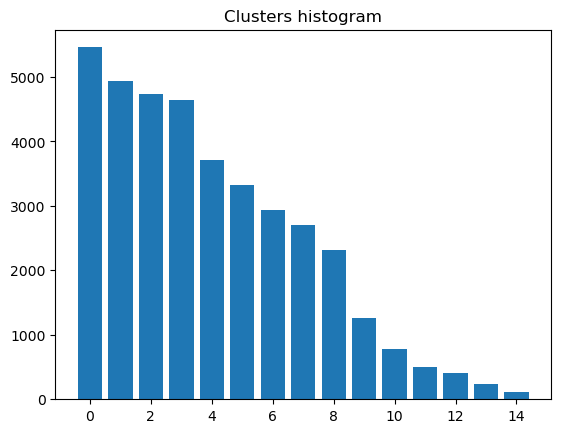

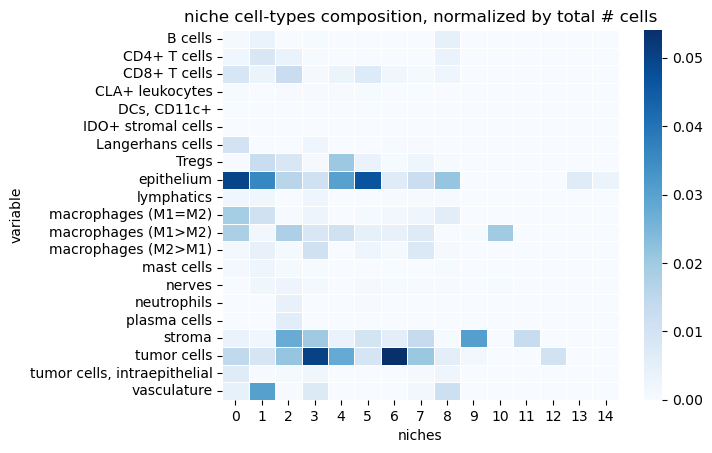

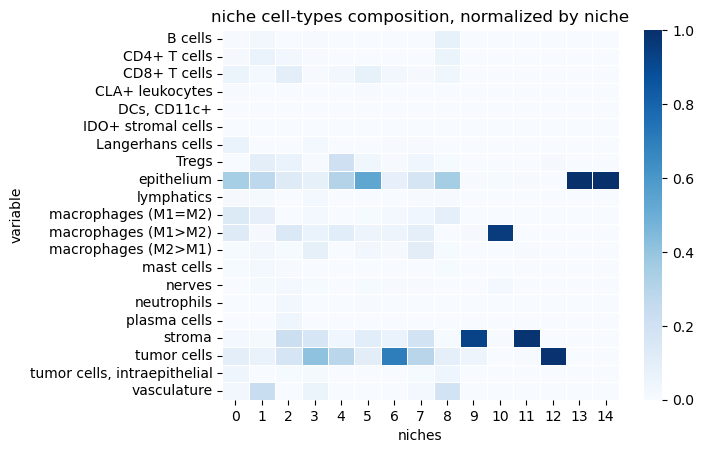

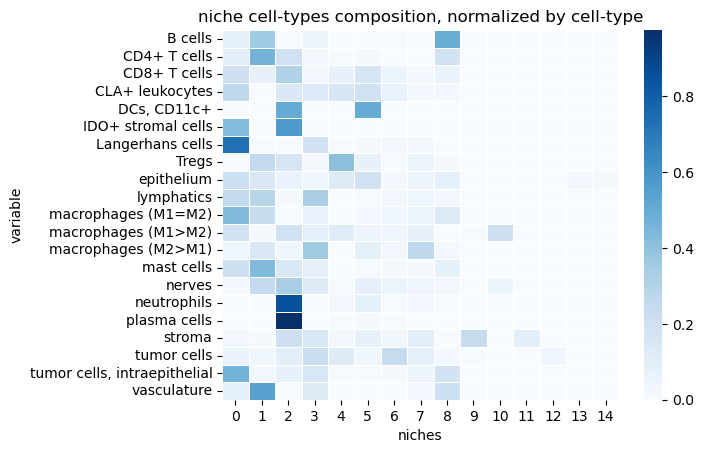

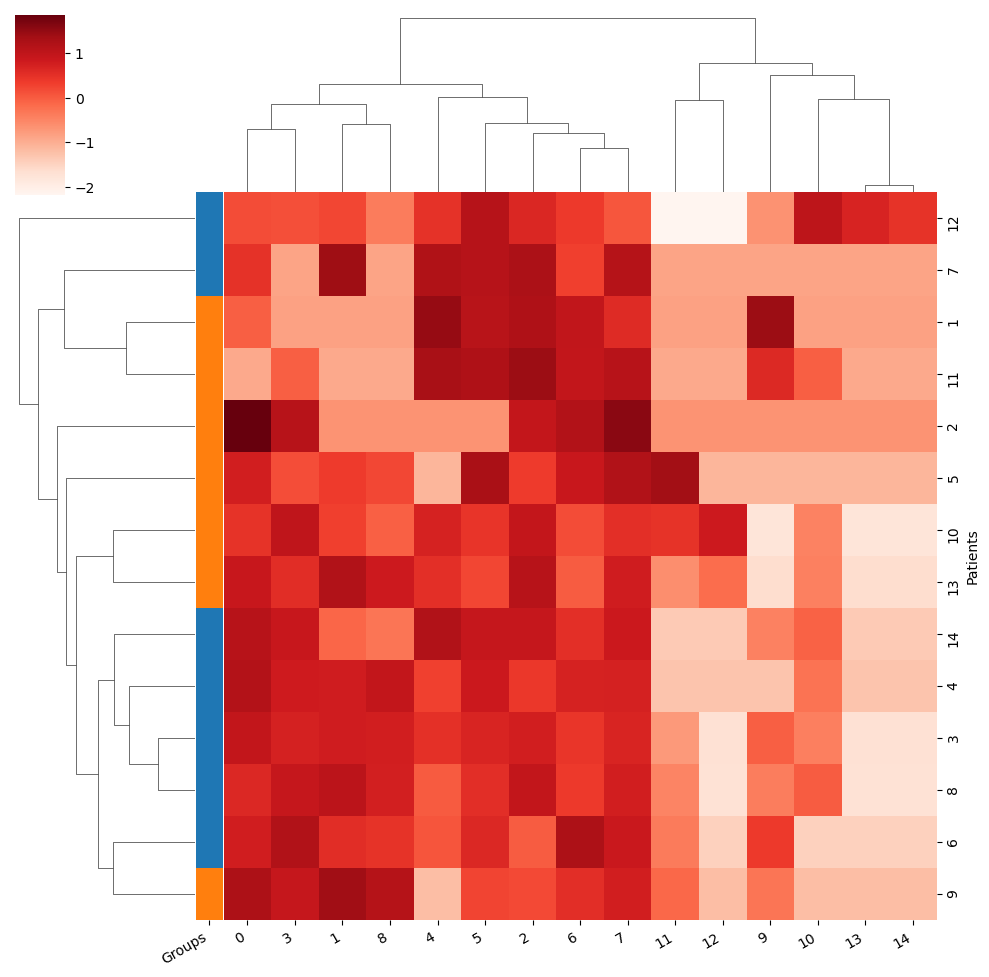

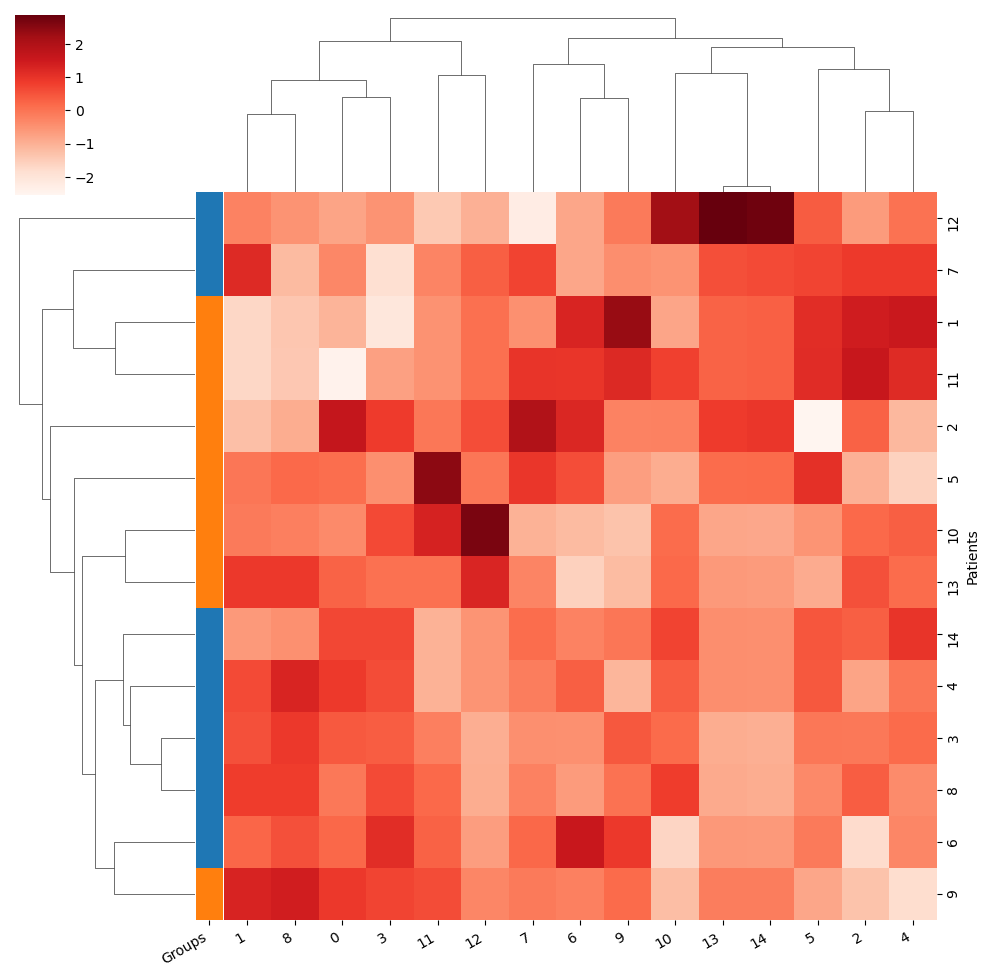

Training took 2.691s


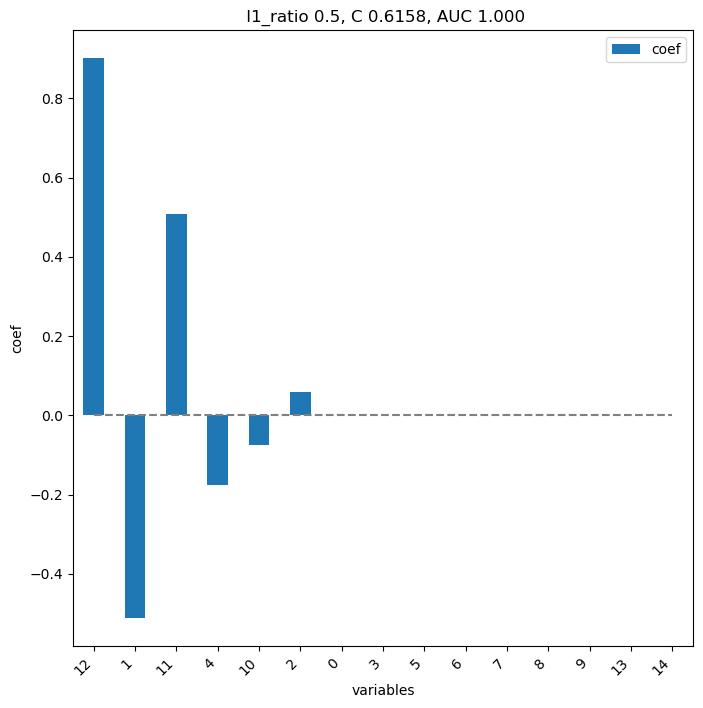

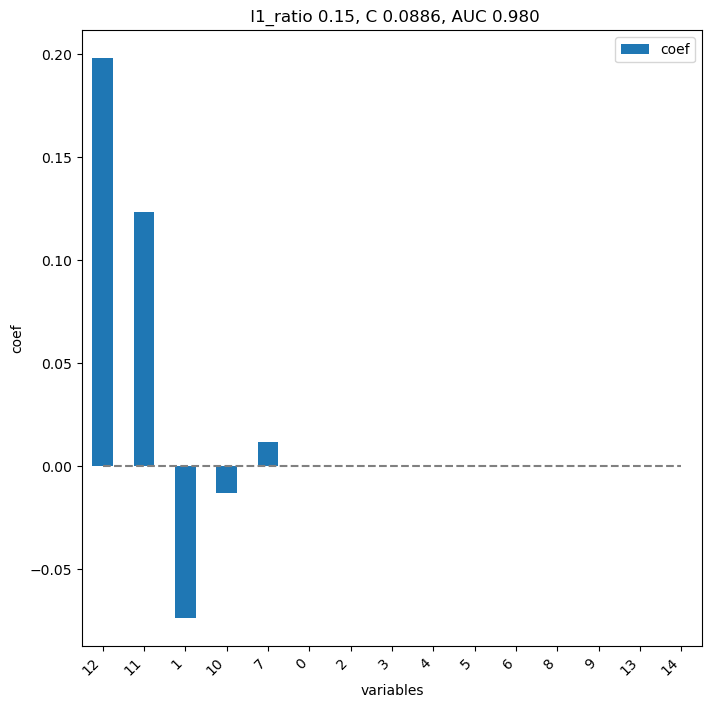

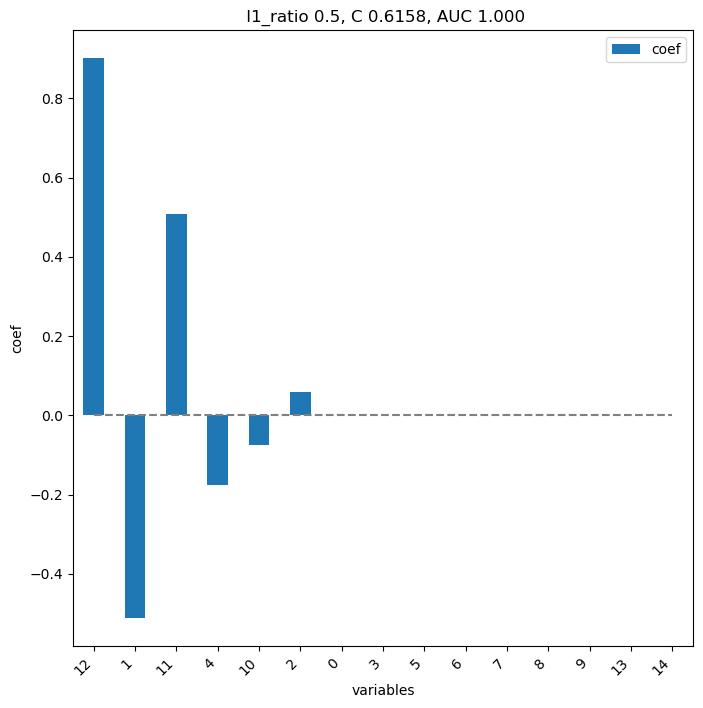

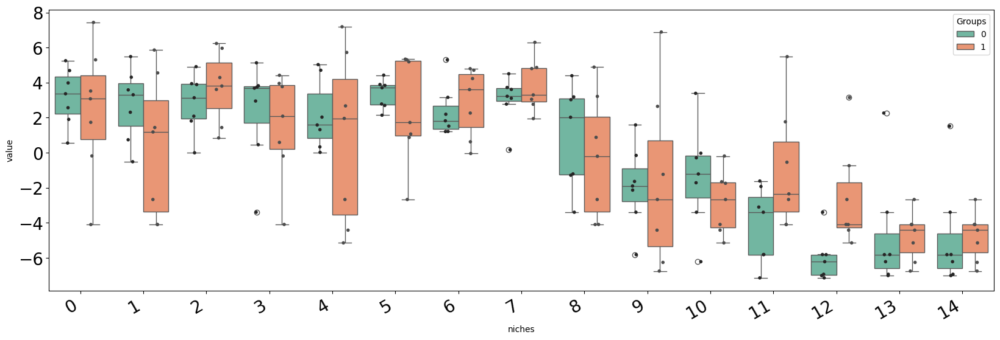

In [47]:
### reexcution ###
reload(mosna)
save_fig = False

# Select paramaters
cluster_params, normalize_pred = get_params_from_str(selected_str_params[2])
cluster_params['n_neighbors'] = int(cluster_params['n_neighbors'])
cluster_params['min_dist'] = float(cluster_params['min_dist'])
cluster_params['dim_clust'] = int(cluster_params['dim_clust'])
cluster_params['k_cluster'] = int(cluster_params['k_cluster'])
cluster_params['resolution_parameter'] = float(cluster_params['resolution_parameter'])

str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
str_params = str_params + f'_normalize-{normalize_pred}'
print(str_params)

# Load niches data
cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

# Niches embedding
mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)
if save_fig:
    figname = f"{str_params}_niches_embedding.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches total counts
class_id, class_count = np.unique(cluster_labels, return_counts=True)
plt.bar(class_id, class_count, width=0.8);
plt.title('Clusters histogram');
if save_fig:
    figname = f"{str_params}_niches_total_count.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches composition
niches = cluster_labels

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()


# Make count table of cells in niches per patient with clinical data

var_aggreg_niches = var_aggreg_samples_info.copy()
var_aggreg_niches['niche'] = np.array(niches)

counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize_pred)
counts.index = counts.index.astype(status.index.dtype)
exo_vars = counts.columns.tolist()
df_surv = counts.merge(status, how='inner', on=var_label)

# Biclustering
g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=1,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering_col_zscored.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Logistic regression
split_train_test = False
models = mosna.logistic_regression(
    df_surv[exo_vars + [group_col]],
    y_name=group_col,
    col_drop=[var_label],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    plot_coefs=True,
    split_train_test=split_train_test,
    save_plot_figures=save_fig,
    dir_save=save_dir,
    save_preds=False,
    str_prefix=str_params,
    )
plt.show()

# Proportion of niches per response group
fig, ax = mosna.plot_distrib_groups(
    df_surv[exo_vars + [group_col]], 
    group_var=group_col,
    groups=[0, 1], 
    pval_data=None, 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='niches',
    )
plt.show()
if save_fig:
    figname = f"{str_params}_niches_boxplot.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    
# p-values
pvals = mosna.find_DE_markers(
    df_surv[exo_vars + [group_col]], 
    group_ref=1, 
    group_tgt=0, 
    group_var=group_col,
    )

In [ ]:
# ORIGINAL
STOP

reducer_type-umap_n_neighbors-45_metric-cosine_min_dist-0.0_clusterer_type-leiden_dim_clust-2_k_cluster-15_resolution_parameter-0.1_normalize-clr
Loading clusterer object and cluster labels


There are 16 clusters
Loading reducer object and reduced coordinates


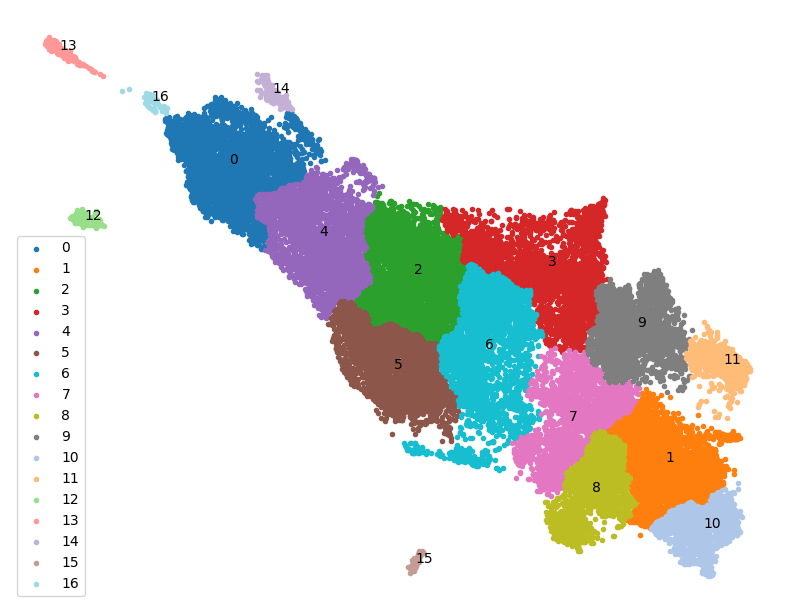

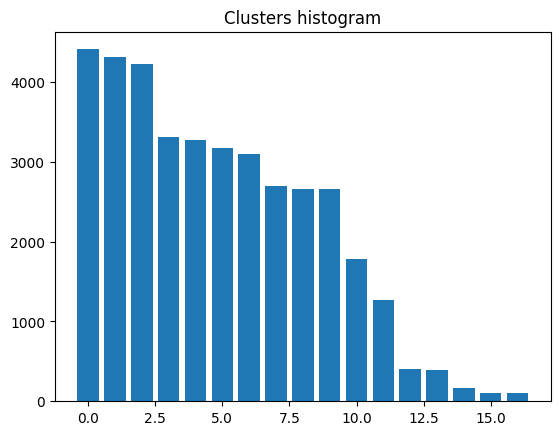

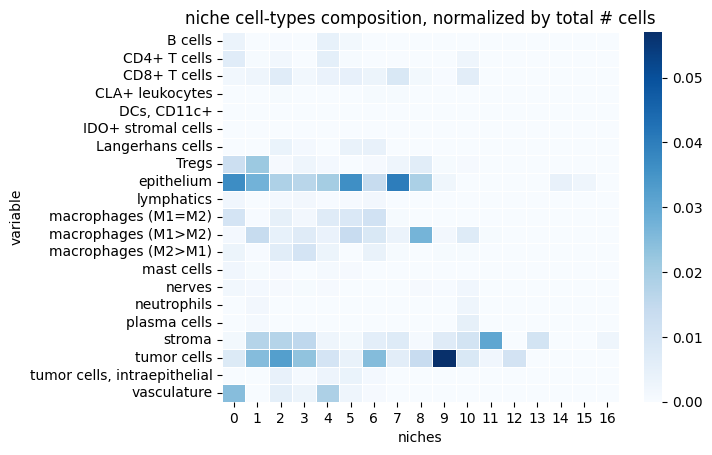

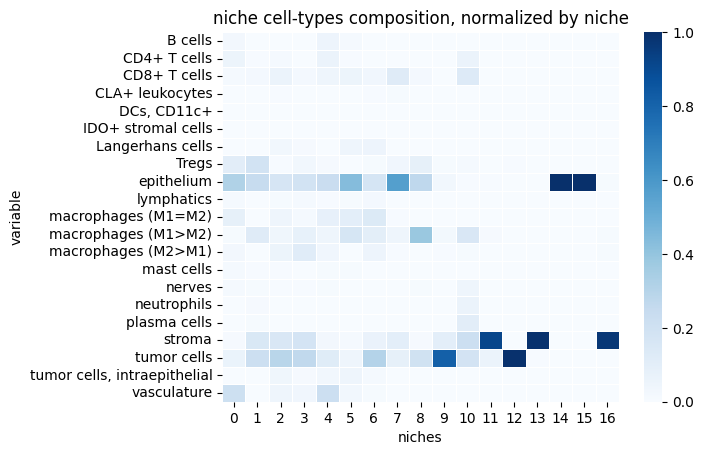

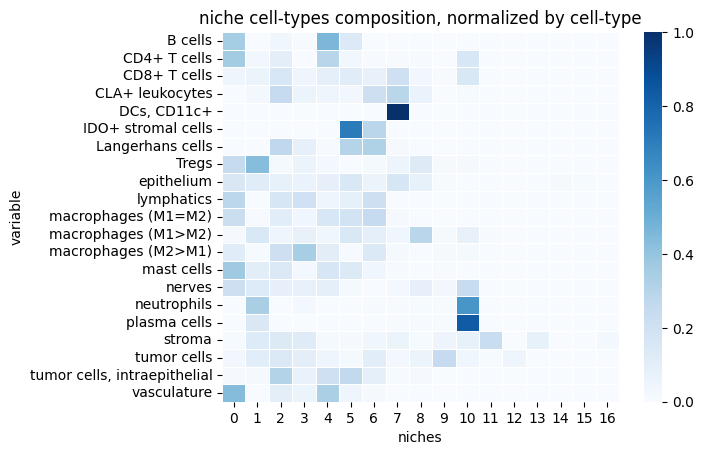

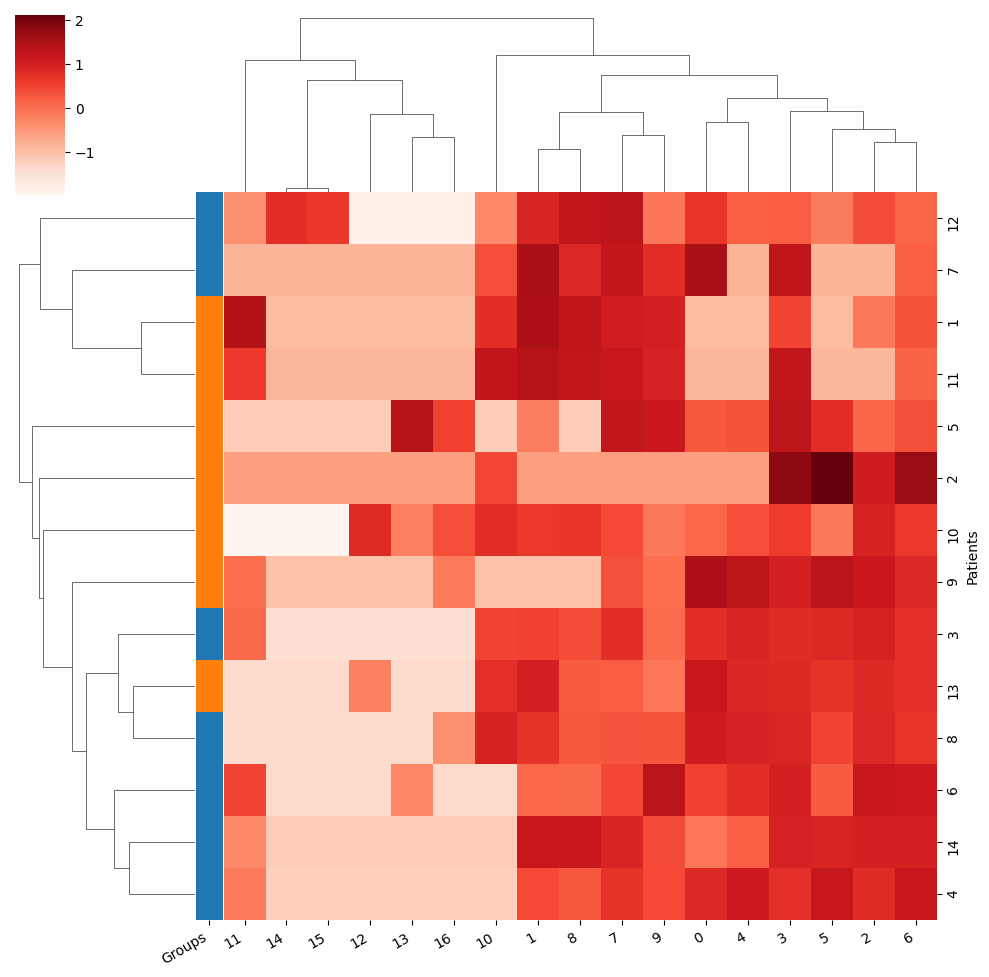

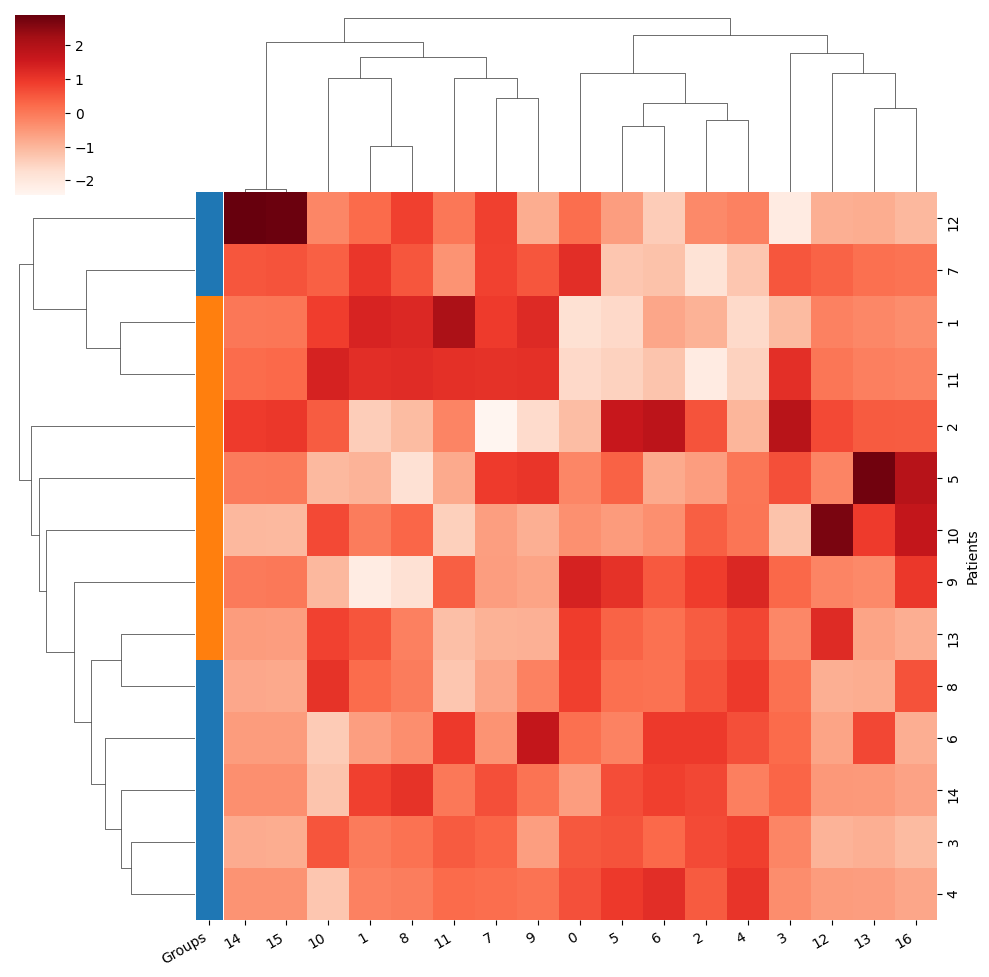

Training took 2.693s


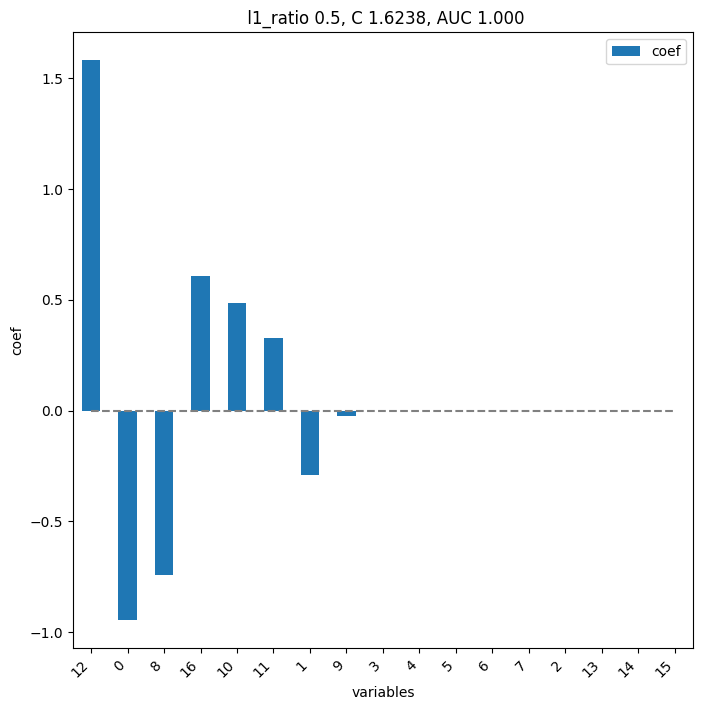

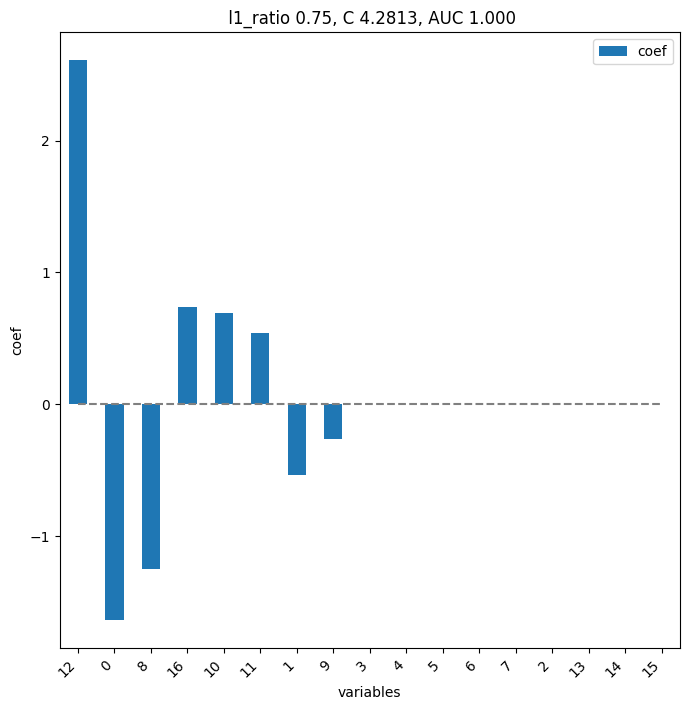

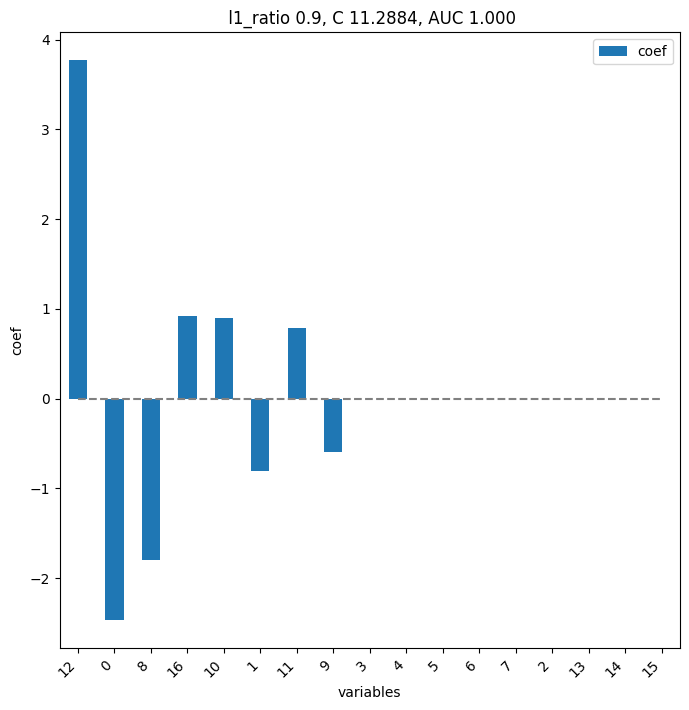

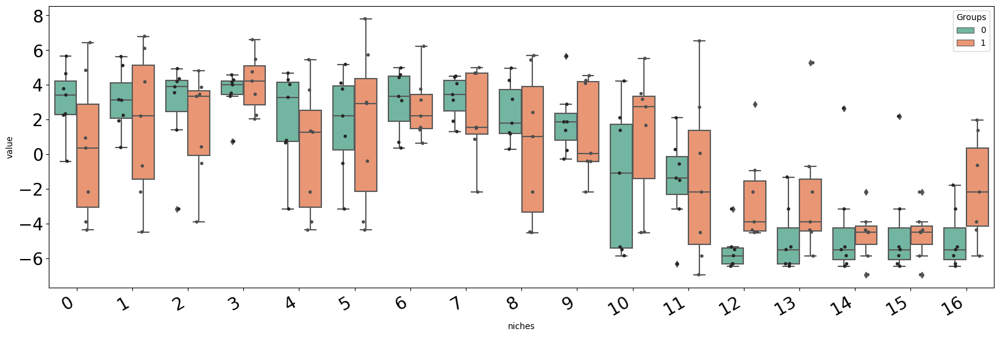

<Figure size 640x480 with 0 Axes>

In [130]:
# Select paramaters
cluster_params, normalize_pred = get_params_from_str(selected_str_params[2])

str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
str_params = str_params + f'_normalize-{normalize_pred}'
print(str_params)

# Load niches data
cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

# Niches embedding
mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)
if save_fig:
    figname = f"{str_params}_niches_embedding.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches total counts
class_id, class_count = np.unique(cluster_labels, return_counts=True)
plt.bar(class_id, class_count, width=0.8);
plt.title('Clusters histogram');
if save_fig:
    figname = f"{str_params}_niches_total_count.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Niches composition
niches = cluster_labels

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
if save_fig:
    figname = f"{str_params}_{title}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()


# Make count table of cells in niches per patient with clinical data

var_aggreg_niches = var_aggreg_samples_info.copy()
var_aggreg_niches['niche'] = np.array(niches)

counts = mosna.make_niches_composition(var_aggreg_niches[predict_key], niches, var_label=var_label, normalize=normalize_pred)
counts.index = counts.index.astype(status.index.dtype)
exo_vars = counts.columns.tolist()
df_surv = counts.merge(status, how='inner', on=var_label)

# Biclustering
g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=False,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

g, d = mosna.plot_heatmap(
    df_surv[exo_vars + [group_col]].reset_index(), 
    obs_labels=var_label, 
    group_var=group_col, 
    groups=[0, 1],
    figsize=(10, 10),
    z_score=1,
    cmap=sns.color_palette("Reds", as_cmap=True),
    return_data=True,
    )
if save_fig:
    figname = f"{str_params}_biclustering_col_zscored.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# Logistic regression
split_train_test = False
models = mosna.logistic_regression(
    df_surv[exo_vars + [group_col]],
    y_name=group_col,
    col_drop=[var_label],
    cv_train=cv_train, 
    cv_adapt=cv_adapt, 
    cv_max=cv_max,
    plot_coefs=True,
    split_train_test=split_train_test,
    save_plot_figures=save_fig,
    dir_save=save_dir,
    str_prefix=str_params,
    )
plt.show()

# Proportion of niches per response group
fig, ax = mosna.plot_distrib_groups(
    df_surv[exo_vars + [group_col]], 
    group_var=group_col,
    groups=[0, 1], 
    pval_data=None, 
    max_cols=20, 
    multi_ind_to_col=True,
    var_name='niches',
    )
plt.show()
if save_fig:
    figname = f"{str_params}_niches_boxplot.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    
# p-values
pvals = mosna.find_DE_markers(
    df_surv[exo_vars + [group_col]], 
    group_ref=1, 
    group_tgt=0, 
    group_var=group_col,
    )

In [131]:
pvals.head(20)

,pval,pval_corr
12,0.006993,0.118881
16,0.072844,0.551476
13,0.097319,0.551476
10,0.164918,0.700903
0,0.259324,0.734751
2,0.259324,0.734751
4,0.455711,0.862596
9,0.534965,0.862596
3,0.534965,0.862596
8,0.534965,0.862596


In [132]:
import seaborn as sns
df_show = df_surv[exo_vars]
if df_show.values.min() >= 0:
    cm = sns.light_palette("green", as_cmap=True)
else:
    cm = sns.diverging_palette(220, 20, as_cmap=True)
    # cm = sns.color_palette("vlag", as_cmap=True)
s = df_show.style.background_gradient(cmap=cm)
s

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
Patients,,,,,,,,,,,,,,,,,
1,-4.373577,6.803063,-0.530614,2.241975,-4.373577,-4.373577,1.548828,4.673393,5.691963,4.531981,3.494738,6.533290,-4.373577,-4.373577,-4.373577,-4.373577,-4.373577
10,0.358595,2.201127,3.335399,2.028658,1.335510,-0.399091,2.201127,1.498029,2.406288,-0.399091,2.733501,-6.950104,2.889311,-0.709246,-6.950104,-6.950104,1.370196
11,-3.903896,6.104485,-3.903896,5.476401,-3.903896,-3.903896,0.632214,4.995313,5.432128,4.256555,5.526316,2.711656,-3.903896,-3.903896,-3.903896,-3.903896,-3.903896
12,2.328124,3.148120,1.395304,0.742979,0.659597,-0.529987,0.357316,4.500451,4.258695,-0.278673,-1.089603,-1.377285,-6.318861,-6.318861,2.654002,2.187542,-6.318861
13,4.838095,4.174678,3.450759,3.459058,3.700220,2.925948,3.123412,0.860492,1.014643,-0.420442,3.168618,-5.872843,-0.931267,-5.872843,-5.872843,-5.872843,-5.872843
14,-0.403694,5.116433,4.352766,4.284592,0.800279,4.099813,4.421950,4.069848,4.966944,1.864990,-5.345269,-1.502306,-5.345269,-5.345269,-5.345269,-5.345269,-5.345269
2,-2.180508,-2.180508,3.859680,6.604098,-2.180508,7.813058,6.226804,-2.180508,-2.180508,-2.180508,1.662456,-2.180508,-2.180508,-2.180508,-2.180508,-2.180508,-2.180508
3,3.415796,2.242522,4.190645,3.520437,4.017343,3.759437,3.335953,3.439494,1.789429,0.215923,2.101209,0.273082,-6.460254,-6.460254,-6.460254,-6.460254,-6.460254
4,3.777435,1.922874,3.548842,3.343302,4.677949,5.179902,4.976613,3.118479,1.172569,1.865716,-5.503608,-0.562032,-5.503608,-5.503608,-5.503608,-5.503608,-5.503608


Niches 16, 11 and 13 are similar, as they are mainly composed of stroma cells, though only niches 16 and 11 are informative of response to therapy. We can notice that niche 11 is made of stroma cells and a little proportion of tumor cells, whereas niche 16 is made of stroma cells only. As niche 13 is also made only of stroma cells, why isn't it selected to model response to therapy? To answer this question, we need to compare niches 16 and 13.

In [133]:
# save_dir = cluster_dir / (clusterer_name + "_spatial_networks_figures")
# save_dir.mkdir(parents=True, exist_ok=True)

# sample_ids = [
#     "reg001",
#     "reg003",
#     "reg005",
#     "reg006",
#     "reg037",
#     "reg040",
#     "reg042",
#     "reg051",
#     "reg054",
#     "reg055",
#     "reg016",
#     "reg058",
#     "reg060",
#     "reg019",
# ]

# # choose colormap
# if nb_clust <= 20:
#     clusters_cmap = sns.color_palette('Paired', 20)
#     cluster_colors = [clusters_cmap[x] if x >= 0
#                       else (0.5, 0.5, 0.5)
#                       for x in cluster_labels]
# else:
#     clusters_cmap = cc.palette["glasbey"]
#     # make color mapper
#     # series to sort by decreasing order
#     uniq = pd.Series(cluster_labels).value_counts().index.astype(int)
#     n_colors = len(clusters_cmap)
#     labels_color_mapper = {x: clusters_cmap[i % n_colors] for i, x in enumerate(uniq)}
#     labels_color_mapper[-1] = (0.5, 0.5, 0.5)
#     cluster_colors = np.array([labels_color_mapper[x] for x in cluster_labels])

# # colormap for cell-types
# n_cell_types = obj[pheno_col].unique().size
# # palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
# palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]

# plots_marker = '.'
# for sample in sample_ids:
#     print("filename: {}".format(sample))
#     select = np.array(obj[sample_col] == sample)

#     # load nodes and edges
#     coords = obj.loc[select, pos_cols].values
#     pairs = edges_all.loc[edges_all[sample_col] == sample, ['source', 'target']].values

#     # Big summary plot
#     fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
#     i = 0
#     ty.plot_network(coords, pairs, labels=obj.loc[select, pheno_col], cmap_nodes=palette, marker=plots_marker, size_nodes=size_points, ax=ax[0])
#     ax[i].set_title('Spatial map of phenotypes', fontsize=14);

#     i += 1
#     ax[i].scatter(coords[:, 0], coords[:, 1], c=cluster_colors[select], marker=plots_marker, s=size_points)
#     ax[i].set_title('Spatial map of detected areas', fontsize=14);
#     ax[i].set_aspect('equal')

#     i += 1
#     ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=cluster_colors[select], s=5);
#     ax[i].set_title("HDBSCAN clustering on NAS", fontsize=14);
#     ax[i].set_aspect('equal')

#     i += 1
#     ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=cluster_colors);
#     ax[i].set_title("HDBSCAN clustering on NAS of all samples", fontsize=14);
#     ax[i].set_aspect('equal')
    
#     # make plot limits equal
#     ax[i-1].set_xlim(ax[i].get_xlim())
#     ax[i-1].set_ylim(ax[i].get_ylim())

#     suptitle = f"Spatial omics data and detected areas - sample {sample}";
#     fig.suptitle(suptitle, fontsize=18)

#     fig.savefig(save_dir / suptitle, bbox_inches='tight', facecolor='white', dpi=300)

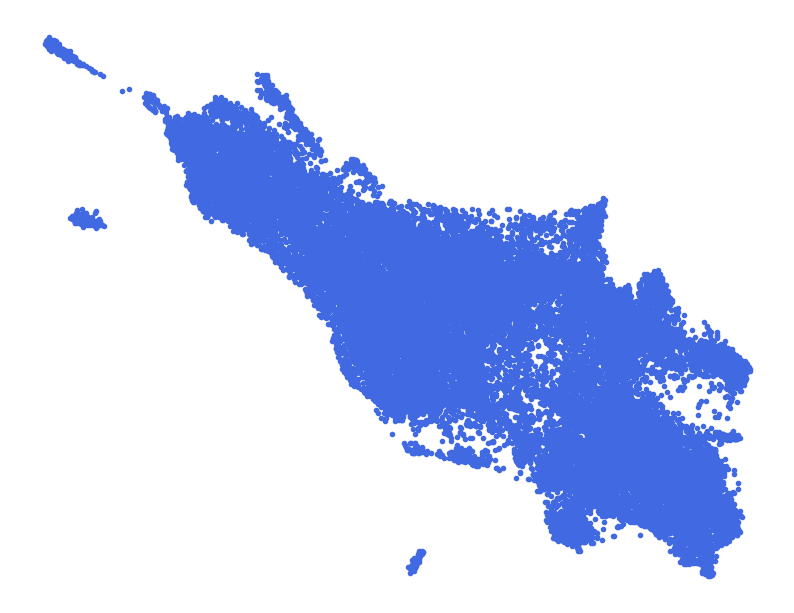

In [126]:
fig, ax = mosna.plot_clusters(embed_viz, save_dir=sof_dir, extra_str='_no_clustering', show_id=False, cluster_params=cluster_params, return_cmap=False)

Loading reducer object and reduced coordinates


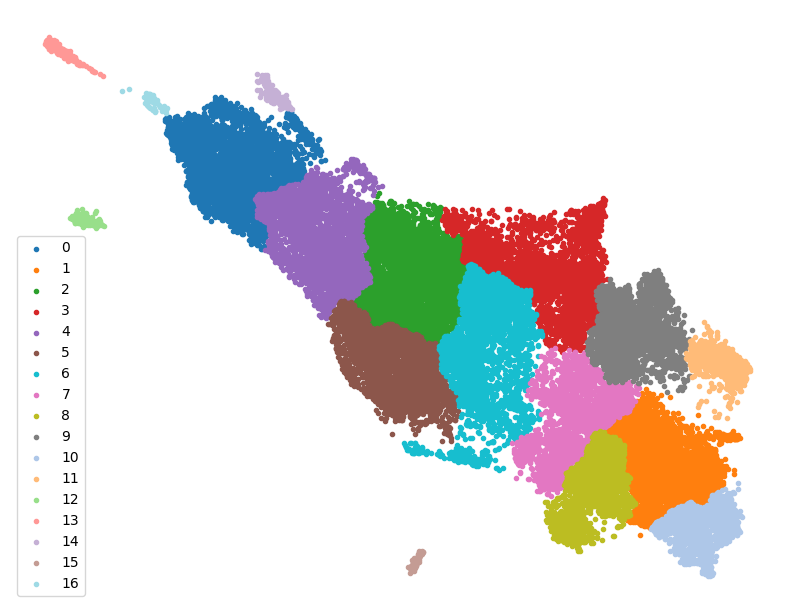

In [46]:
embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels, 
    sof_dir, 
    cluster_params=cluster_params, 
    return_cmap=True,
    extra_str='_no_cluster_id', 
    show_id=False,
    )

In [ ]:
save_dir = cluster_dir / 'spatial_networks_niches'
save_dir.mkdir(parents=True, exist_ok=True)

# colormap for cell-types
n_cell_types = obj[pheno_col].unique().size
# palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
# palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]
niche_colors = np.array([niches_color_mapper[x] for x in cluster_labels])
plots_marker = '.'

id_level_1 = 'patient'
id_level_2 = 'sample'
extension = 'parquet'
read_fct = pd.read_parquet

# build index of patients and samples files
data_index = []
len_ext = len(extension) + 1
len_l1 = len(id_level_1) + 1
len_l2 = len(id_level_2) + 1
files = nodes_dir.glob(f'nodes_*.{extension}')
for file in files:
    # parse patient and sample description
    file_name = file.name[6:-len_ext]
    patient_info, sample_info = file_name.split('_')
    patient_id = patient_info[len_l1:]
    sample_id = sample_info[len_l2:]
    # add info to data index
    data_index.append((patient_id, sample_id))

for data_info in data_index:
    # load nodes and edges of a specific sample
    if len(data_info) == 1:
        str_group = f'{id_level_1}-{data_info[0]}'
    elif len(data_info) == 2:
        str_group = f'{id_level_1}-{data_info[0]}_{id_level_2}-{data_info[1]}'
    nodes = read_fct(nodes_dir / f'nodes_{str_group}.{extension}')
    edges = read_fct(edges_dir / f'edges_{str_group}.{extension}')
    coords = nodes[pos_cols].values
    pairs = edges.values
    # bolean selector among aggregated data
    sample_id = data_info[1]
    select = (var_aggreg_samples_info['sample'] == sample_id).values

    # Big summary plot
    fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
    i = 0
    ty.plot_network(coords, 
                    pairs,
                    labels=nodes[pheno_col], 
                    color_mapper=celltypes_color_mapper, 
                    marker=plots_marker, 
                    size_nodes=size_points*10, 
                    ax=ax[0])
    ax[i].set_title('Spatial map of phenotypes', fontsize=14);

    i += 1
    ax[i].scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*10)
    ax[i].set_title('Spatial map of detected areas', fontsize=14);
    ax[i].set_aspect('equal')

    i += 1
    ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=niche_colors[select], s=size_points);
    ax[i].set_title("Clustering on NAS", fontsize=14);
    ax[i].set_aspect('equal')

    i += 1
    ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=niche_colors, s=size_points);
    ax[i].set_title("Clustering on NAS of all samples", fontsize=14);
    ax[i].set_aspect('equal')
    
    # make plot limits equal
    ax[i-1].set_xlim(ax[i].get_xlim())
    ax[i-1].set_ylim(ax[i].get_ylim())

    suptitle = f"Spatial omics data and detected areas - sample {sample_id}";
    fig.suptitle(suptitle, fontsize=18)

    fig.savefig(save_dir / f'{suptitle}.jpg', bbox_inches='tight', facecolor='white', dpi=600)
    plt.show()


    fig, ax = plt.subplots(figsize=(10, 10))
    ax.scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*10)
    ax.set_title('Spatial map of detected areas', fontsize=14);
    ax.set_aspect('equal')
    fig.savefig(save_dir / f'spatial_niches_sample-{sample_id}_bignodes.jpg', bbox_inches='tight', facecolor='white', dpi=600)
    plt.show()

across all models, predictive niches are:
  - pure tumor
  - pure stroma
  - EVTM: epithelium, vasculature, tregs, macrophages (M1=M2)
  - ETMTS: epithelium, tregs, M1, tumor, stroma
across models EVTM and ETLTS are exclusive, one is enough for prediction, and with contrary effect on response.

### Differential niche analysis

Niches 11 and 13 are apparently made of the same unique cell type: stroma cells. What are the differences between these niches?  

Loading reducer object and reduced coordinates


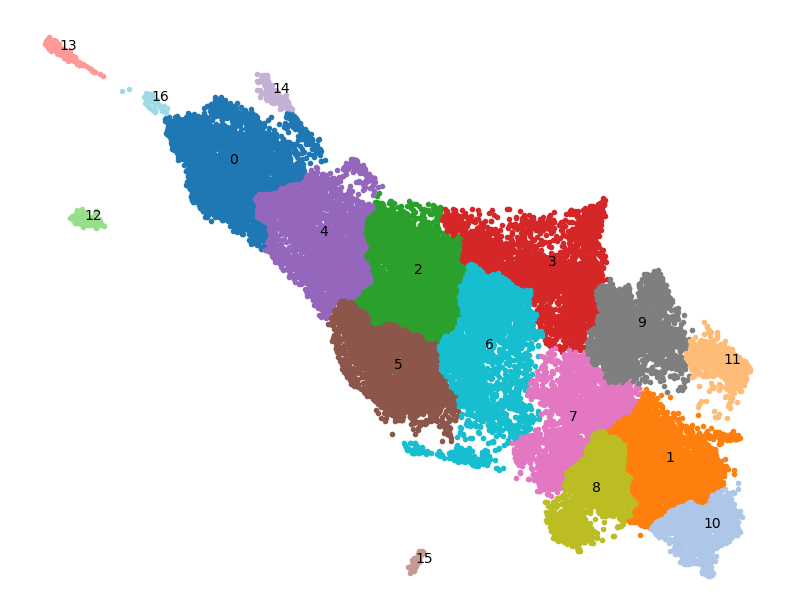

In [134]:
embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels, 
    cluster_params=cluster_params, 
    return_cmap=True,
    show_id=True,
    legend=False
    )

Text(0.5, 1.0, 'niche cell-types composition, normalized by niche')

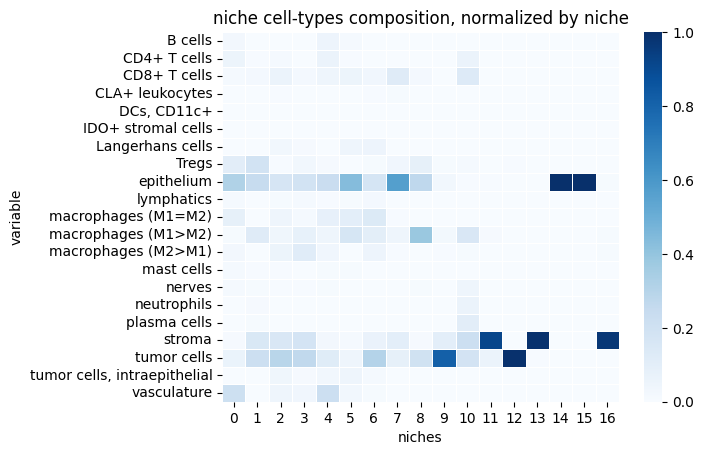

In [135]:
# as a reminder:
mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
plt.title("niche cell-types composition, normalized by niche")

#### Differences in cell types composition

In [136]:
niche_compo = mosna.make_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')

In [137]:
import seaborn as sns
df_show = niche_compo[[11, 13, 16]]
if df_show.values.min() >= 0:
    cm = sns.light_palette("green", as_cmap=True)
else:
    cm = sns.diverging_palette(220, 20, as_cmap=True)
    # cm = sns.color_palette("vlag", as_cmap=True)
s = df_show.style.background_gradient(cmap=cm)
s

niches,11,13,16
cell-types,,,
B cells,0.000000,0.000000,0.000000
CD4+ T cells,0.000000,0.000000,0.000000
CD8+ T cells,0.000000,0.000000,0.000000
CLA+ leukocytes,0.000000,0.000000,0.000000
"DCs, CD11c+",0.000000,0.000000,0.000000
IDO+ stromal cells,0.000000,0.000000,0.000000
Langerhans cells,0.000000,0.000000,0.000000
Tregs,0.000786,0.000000,0.000000
epithelium,0.004713,0.000000,0.009524


### Differences in aggregation statistics

In [138]:
var_aggreg_niches = var_aggreg.copy()
var_aggreg_niches['niche'] = niches

In [153]:
pvals = mosna.find_DE_markers(
    var_aggreg_niches, 
    group_ref=16, 
    group_tgt=13, 
    group_var='niche',
    )
pvals.head(10)

,pval,pval_corr
CD69 mean,3.754754e-54,4.280419e-52
MUC-1 mean,3.207939e-50,1.828525e-48
EGFR mean,9.740530e-44,3.701402e-42
CD163 std,1.453617e-43,4.142809e-42
Ki-67 mean,6.624367e-39,1.510356e-37
CD164 mean,4.816696e-38,9.151723e-37
CD11c mean,7.640553e-37,1.244319e-35
Vimentin mean,1.178947e-36,1.679999e-35
PD-L1 std,5.672421e-36,7.185066e-35
CD38 mean,1.524009e-35,1.737370e-34


There are 102 significant variables in `pval_corr`


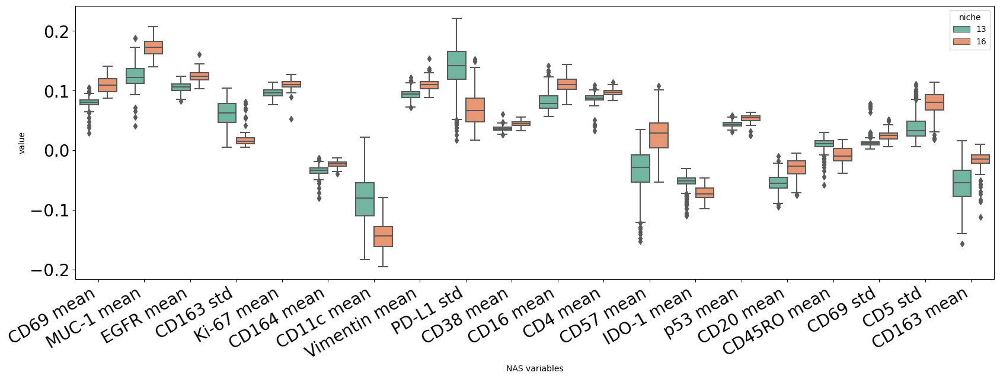

In [141]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    var_aggreg_niches, 
    group_var='niche',
    groups=[16, 13], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    add_points=False,
    )
figname = f"comparison of NAS variables between niches 16 and 13.jpg"
plt.savefig(cluster_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)

#### Extract a single cell type for comparison

We've seen that niches 13 and 16 are slightly different in cell types composition.  
What fi we compare the same cell type between groups? The amount of tumor cells in niche 13 is so low that differences should be due to a different environment (chemokines, mechanics, ...) and not direct signaling.

In [142]:
select = cell_types == 'stroma'
single_pheno_niches = var_aggreg_niches.loc[select, :]

In [154]:
pvals = mosna.find_DE_markers(
    single_pheno_niches, 
    group_ref=16, 
    group_tgt=13, 
    group_var='niche',
    )
pvals.head(10)

,pval,pval_corr
CD69 mean,4.611678e-53,5.257313e-51
MUC-1 mean,6.644503e-49,3.787367e-47
CD163 std,1.211288e-42,4.602893e-41
EGFR mean,2.315610e-42,6.599489e-41
CD164 mean,2.251752e-38,5.133994e-37
Ki-67 mean,1.250449e-37,2.375852e-36
p53 mean,8.478759e-37,1.380827e-35
CD11c mean,1.388259e-35,1.978269e-34
Vimentin mean,2.811828e-35,3.561648e-34
CD38 mean,7.498478e-35,8.548265e-34


There are 102 significant variables in `pval_corr`


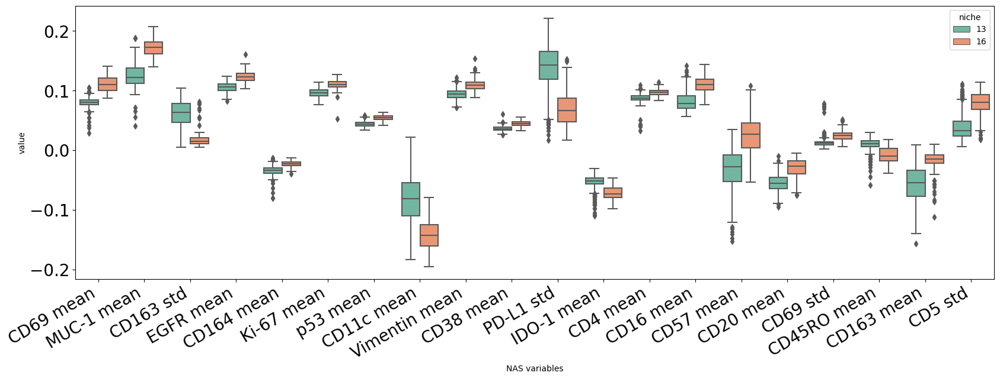

In [144]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    single_pheno_niches, 
    group_var='niche',
    groups=[16, 13], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    add_points=False,
    )
figname = f"comparison of NAS variables between niches 16 and 13 - stroma cells only.jpg"
plt.savefig(cluster_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)

### Differences in raw marker levels

In [147]:
aggreg_vars = marker_cols

In [148]:
markers_niches = obj[aggreg_vars].copy()
markers_niches['niche'] = niches

In [155]:
pvals = mosna.find_DE_markers(
    markers_niches, 
    group_ref=16, 
    group_tgt=13, 
    group_var='niche',
    )
pvals.head(10)

,pval,pval_corr
CD57,8.473347e-20,4.829808e-18
BCL-2,3.898819e-19,7.992422e-18
CCR6,4.206538e-19,7.992422e-18
PD-L1,6.340212e-17,9.034802e-16
CD8,2.665806e-14,3.039019e-13
MMP12,1.247690e-11,1.185305e-10
CD45RO,2.007935e-11,1.635033e-10
CD34,2.233850e-10,1.547578e-09
CD69,2.443544e-10,1.547578e-09
CD56,4.490674e-10,2.559684e-09


There are 35 significant variables in `pval_corr`


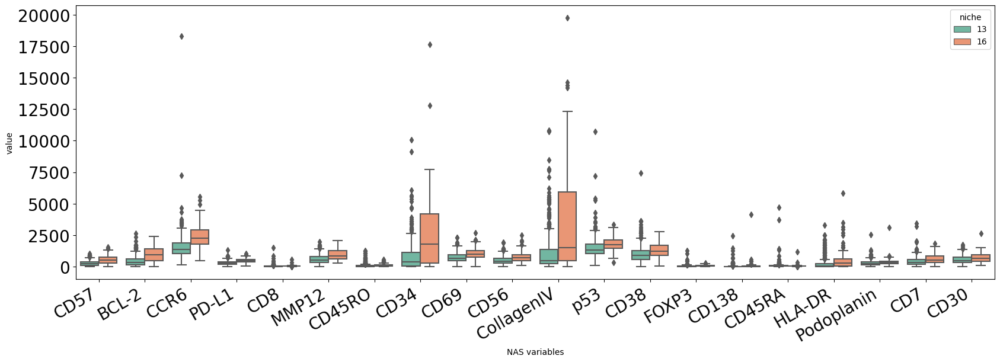

In [157]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    markers_niches, 
    group_var='niche',
    groups=[16, 13], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    add_points=False,
    )
figname = f"comparison of raw markers between niches 16 and 13.jpg"
plt.savefig(cluster_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)

#### select stroma cells only

In [158]:
select = cell_types == 'stroma'
single_pheno_niches_raw = markers_niches.loc[select, :]

In [159]:
pvals = mosna.find_DE_markers(
    single_pheno_niches_raw, 
    group_ref=16, 
    group_tgt=13, 
    group_var='niche',
    )
pvals.head(10)

,pval,pval_corr
CD57,4.214546e-20,2.335874e-18
BCL-2,8.196049e-20,2.335874e-18
CCR6,5.387411e-19,1.023608e-17
PD-L1,3.525450e-16,5.023766e-15
CD8,1.205868e-15,1.374690e-14
CD45RO,5.927010e-12,5.630659e-11
MMP12,1.185957e-11,9.657079e-11
CD34,8.829877e-11,6.291288e-10
CollagenIV,1.860349e-10,1.178221e-09
CD69,3.505432e-10,1.998096e-09


There are 35 significant variables in `pval_corr`


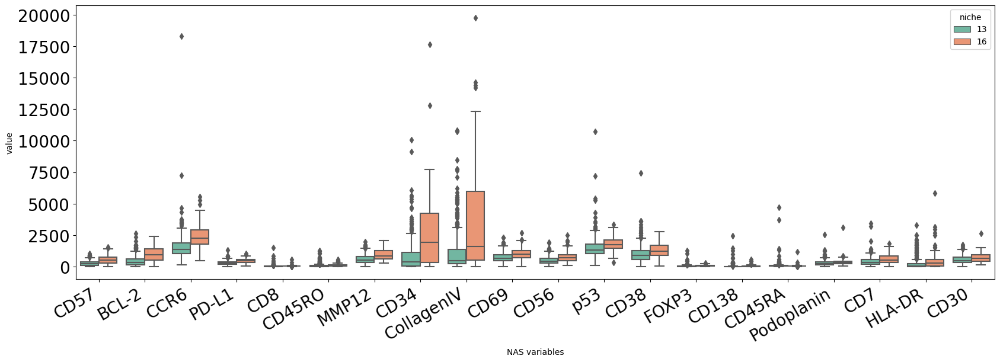

In [160]:
# DE analysis
fig, ax = mosna.plot_distrib_groups(
    single_pheno_niches_raw, 
    group_var='niche',
    groups=[16, 13], 
    pval_data=pvals, 
    pval_col='pval_corr', 
    max_cols=20, 
    multi_ind_to_col=False,
    var_name='NAS variables',
    add_points=False,
    )
figname = f"comparison of raw markers between niches 16 and 13 - stroma cells only.jpg"
plt.savefig(cluster_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)

## On markers, order 2

## On markers, order 3